## Import libraries

In [1]:
# Python libraries
import os
import sys
import pandas as pd # for data manipulation
import numpy as np # for data manipulation
import tensorflow as tf
from sklearn.model_selection import train_test_split
from datetime import datetime
import time

# Plotting
import matplotlib.pyplot as plt

# To enable LaTeX and select a font
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "sans-serif",
    "font.sans-serif": "Helvetica",
})

# Using ipynb import functions defined in other nb
sys.path.append("myfun/")
from ipynb.fs.defs.myfun_load_dataset import *
from ipynb.fs.full.myfun_model_nn import *
from ipynb.fs.defs.myfun_plot import *

2024-02-08 19:48:33.705842: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-08 19:48:33.705869: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-08 19:48:33.706940: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-02-08 19:48:33.713298: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-02-08 19:48:34.537073: W tensorflow/compiler/tf2

## Data Acquisition

In [2]:
# Load the dataset
par_dir = os.path.dirname(os.getcwd()) # parent dir
dir_name = par_dir + "/NN-interaction"

In [3]:
processed_flag = 'pre'
# load the data
_, dflist = load_dataset(dir_name, processed_flag)
dataset = dflist

print(f"In this dataset we have {np.sum([d.shape[0] for d in dataset])} scenes")

In this dataset we have 671 scenes


## Params

In [4]:
DOE =[1,2,2,1] #Design of experiment

In [5]:
v0 = 30
NUM_ITER = 500
LEARNING_RATE_v0 = 0.5
test = 0.9

plot_flag = True
flag_save = True

----------------------------------------------------------------------------------------------------
Analyzing 10 dfs. NN structure: 1-2-2-1
****************************************************************************************************
Analyzing 1/10 dfs.
In DataFrame n.1 we have 109 scenes.
    To train the model we use 10 scenes, the remaining 99 to test the model.

Training step. (10 scenes)
DataFrame n.1. Scene n.1/10
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [531.64,533.24]


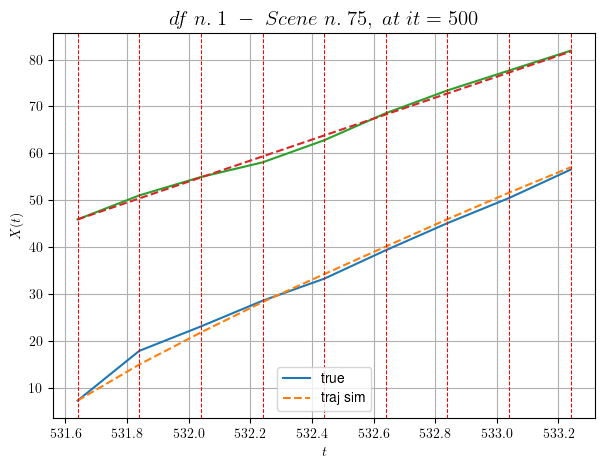

----------------------------------------------------------------------------------------------------
        For scene 1/10:
        * After LR finder: LR_NN=5e-05 with mse=26.856127005214653 at it=24
        * v0 = 22.382648405902955
        * MSE = 0.9836946708561654
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.2/10
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [148.04,148.44]


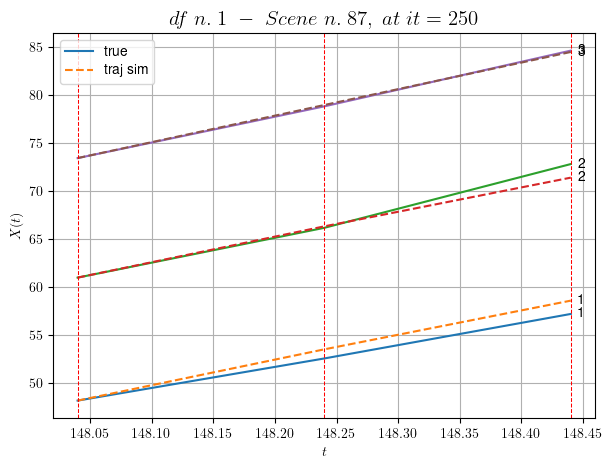

----------------------------------------------------------------------------------------------------
        For scene 2/10:
        * After LR finder: LR_NN=0.005 with mse=0.6583843847921212 at it=24
        * v0 = 27.622169692475982
        * MSE = 0.539439068732715
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.3/10
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [23.64,24.64]


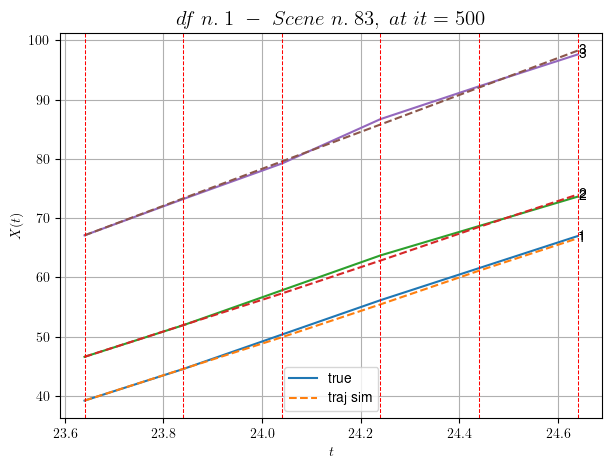

----------------------------------------------------------------------------------------------------
        For scene 3/10:
        * After LR finder: LR_NN=0.01 with mse=0.3478180664073942 at it=24
        * v0 = 31.184420565840114
        * MSE = 0.19270621565157206
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.4/10
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [159.84,160.64]


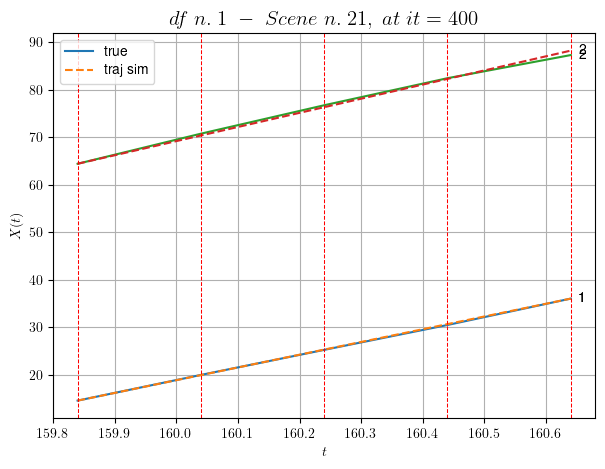

----------------------------------------------------------------------------------------------------
        For scene 4/10:
        * After LR finder: LR_NN=0.0001 with mse=0.14980055386206148 at it=24
        * v0 = 29.799065415932866
        * MSE = 0.1252556785582217
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.5/10
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [429.24,429.84]


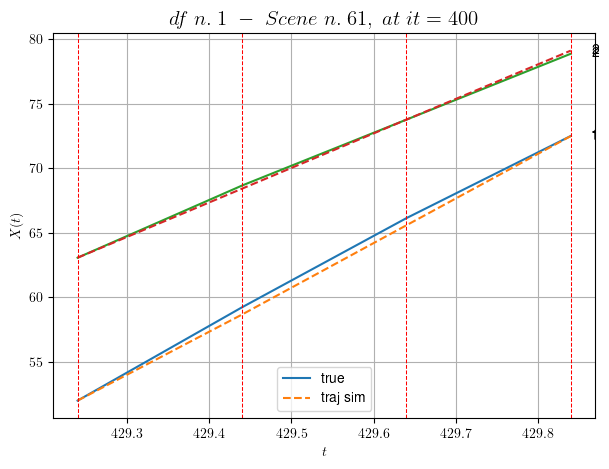

----------------------------------------------------------------------------------------------------
        For scene 5/10:
        * After LR finder: LR_NN=0.005 with mse=0.9262165624632438 at it=24
        * v0 = 26.764923518891287
        * MSE = 0.09116985738732297
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.6/10
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [489.04,489.84]


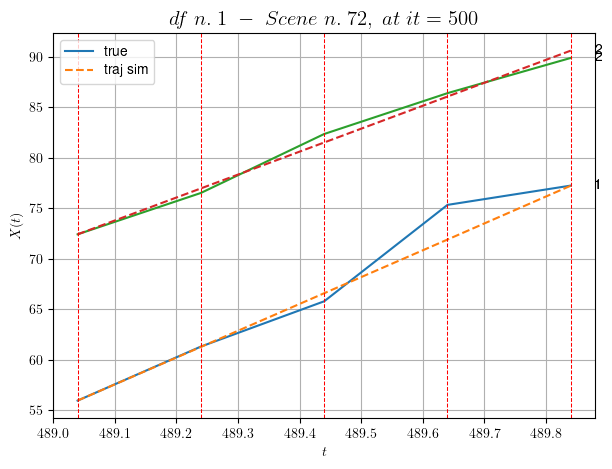

----------------------------------------------------------------------------------------------------
        For scene 6/10:
        * After LR finder: LR_NN=0.0001 with mse=7.5875005125729444 at it=24
        * v0 = 22.729734196719683
        * MSE = 1.2794098553325624
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.7/10
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [116.04,117.04]


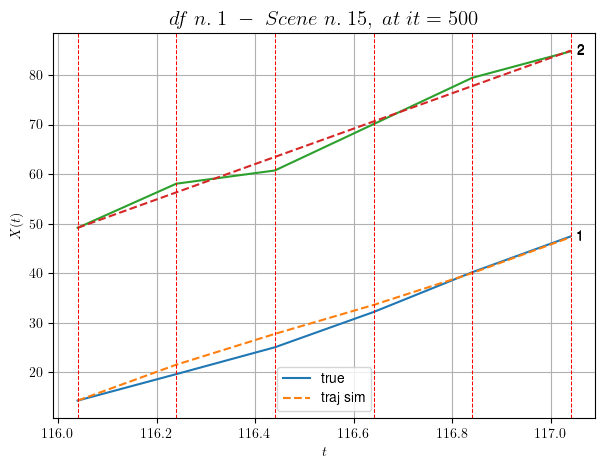

----------------------------------------------------------------------------------------------------
        For scene 7/10:
        * After LR finder: LR_NN=0.01 with mse=7.746646727867318 at it=24
        * v0 = 35.754459494762024
        * MSE = 1.6071055846758036
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.8/10
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [253.64,254.04]


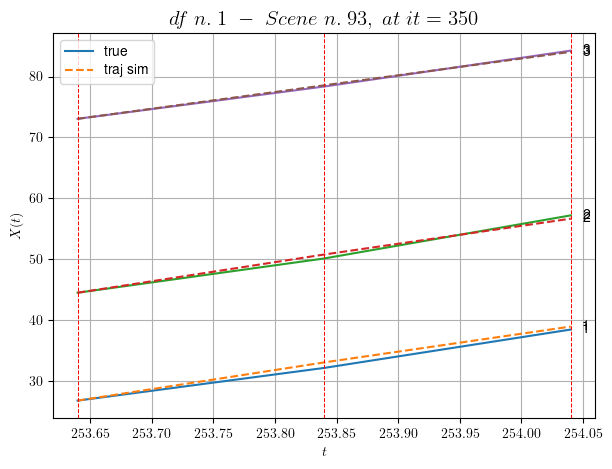

----------------------------------------------------------------------------------------------------
        For scene 8/10:
        * After LR finder: LR_NN=0.005 with mse=0.347426537822417 at it=24
        * v0 = 27.474897828443595
        * MSE = 0.20608347473173652
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.9/10
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [358.84,359.64]


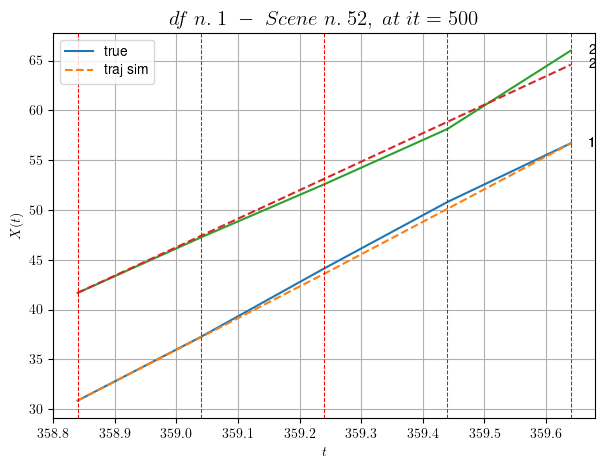

----------------------------------------------------------------------------------------------------
        For scene 9/10:
        * After LR finder: LR_NN=0.005 with mse=0.5222561703165058 at it=24
        * v0 = 28.626441976920418
        * MSE = 0.3621675207351854
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.10/10
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [495.84,496.24]


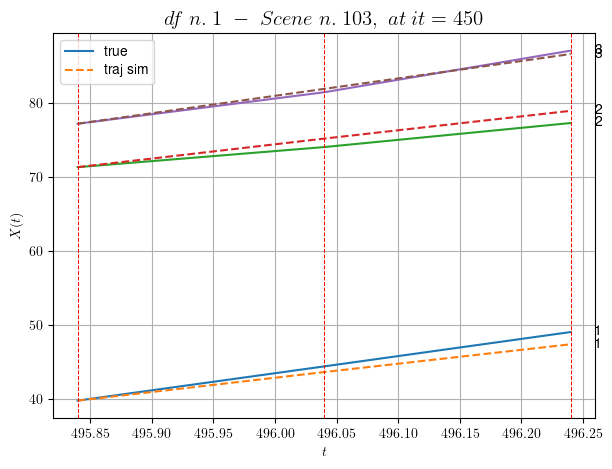

----------------------------------------------------------------------------------------------------
        For scene 10/10:
        * After LR finder: LR_NN=0.01 with mse=1.649776967242761 at it=24
        * v0 = 23.563094778662812
        * MSE = 0.8625875403562008
        * iterations = 450
----------------------------------------------------------------------------------------------------


MSE train: 0.6249619467017486
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (99 scenes)
DataFrame n.1. Scene n.1/99


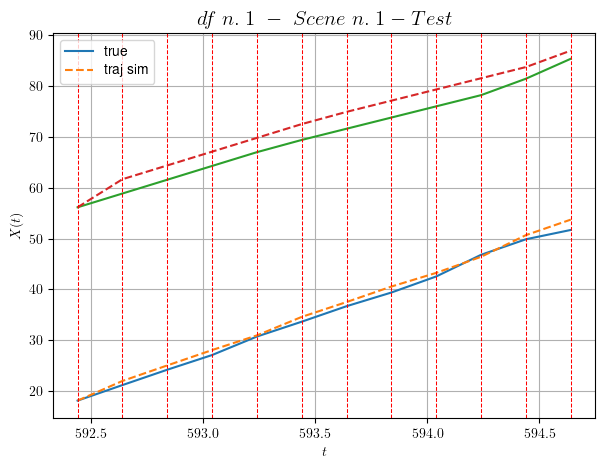

        For scene 1/99:
        * MSE = 4.327457632135184
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.2/99


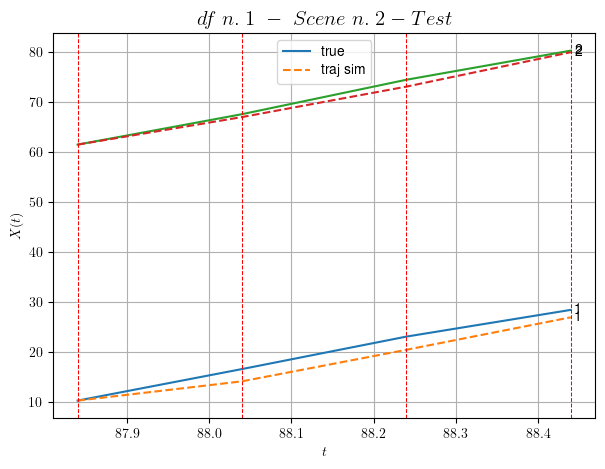

        For scene 2/99:
        * MSE = 2.1956214182038383
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.3/99


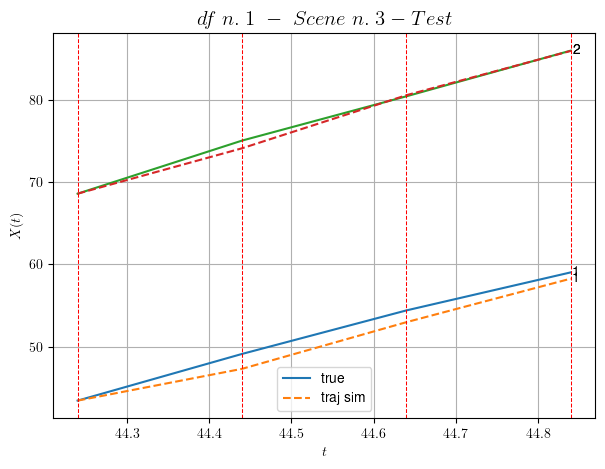

        For scene 3/99:
        * MSE = 0.849441753248805
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.4/99


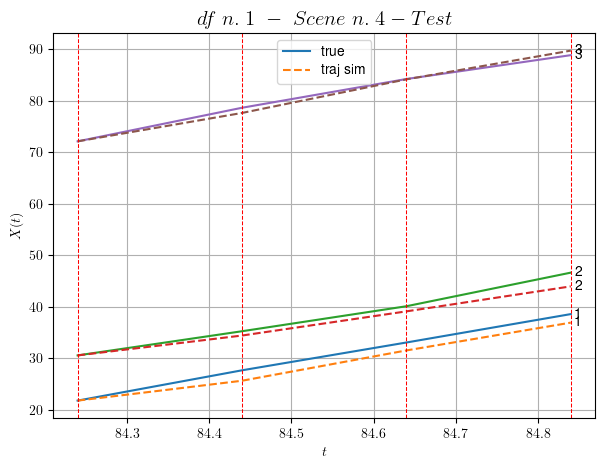

        For scene 4/99:
        * MSE = 1.6538863897173435
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.5/99


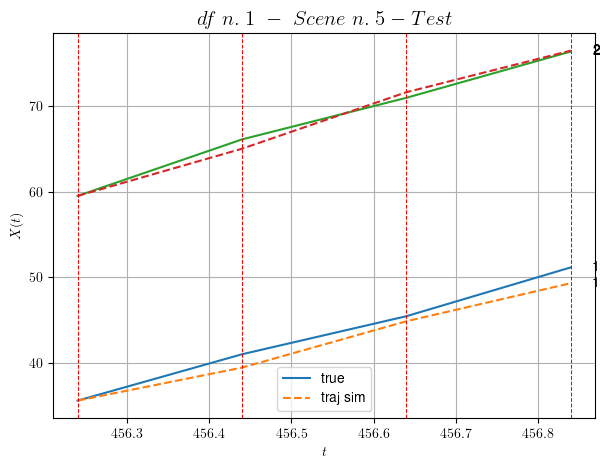

        For scene 5/99:
        * MSE = 0.9773971907661321
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.6/99


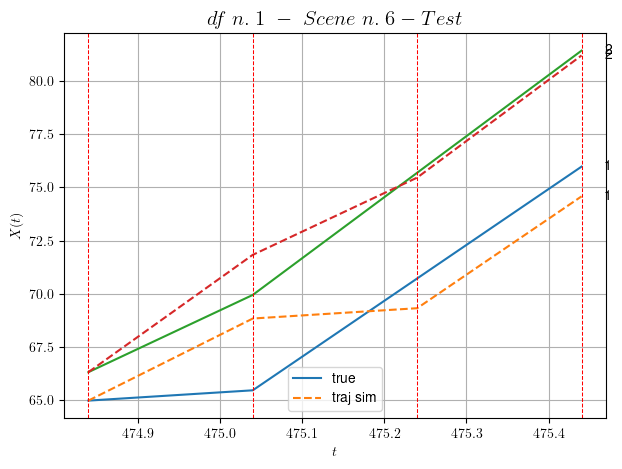

        For scene 6/99:
        * MSE = 2.371849139538674
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.7/99


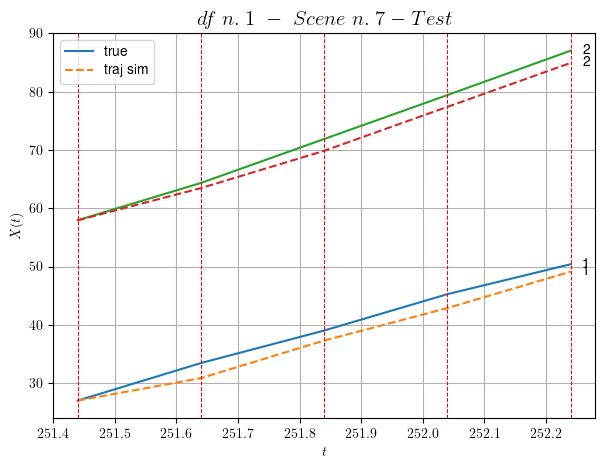

        For scene 7/99:
        * MSE = 3.028247213832359
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.8/99


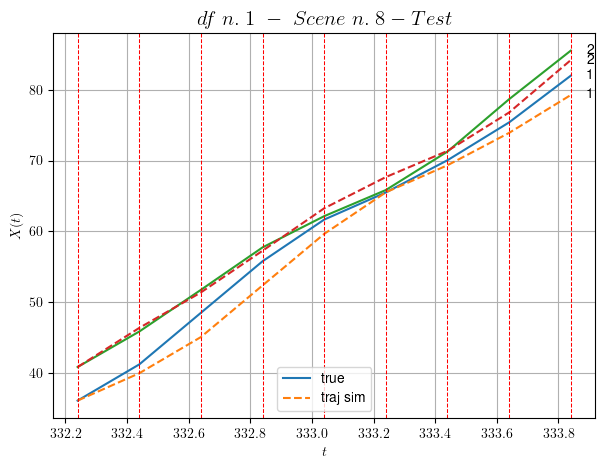

        For scene 8/99:
        * MSE = 2.755948003803563
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.9/99


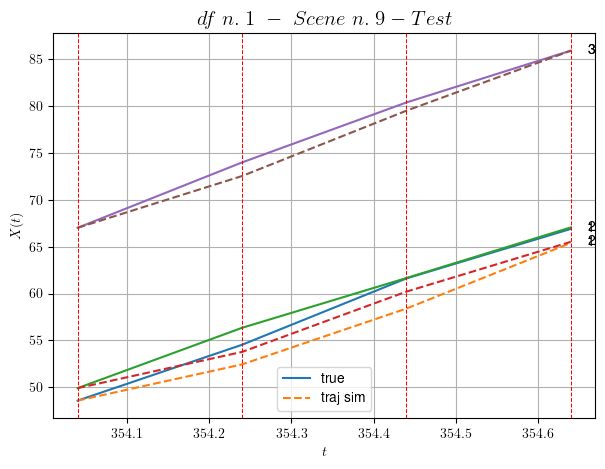

        For scene 9/99:
        * MSE = 2.5756212954142295
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.10/99


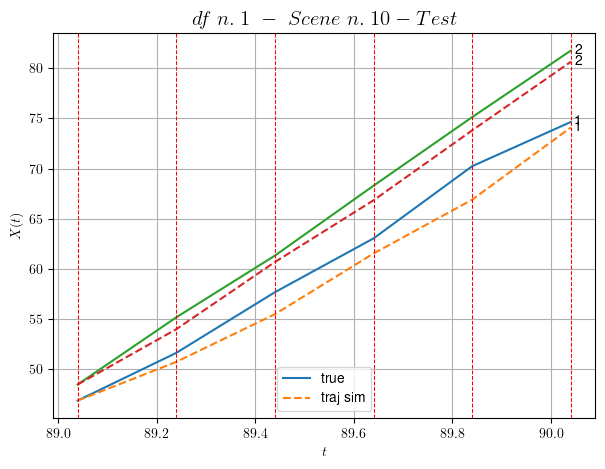

        For scene 10/99:
        * MSE = 2.1883112104765514
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.11/99


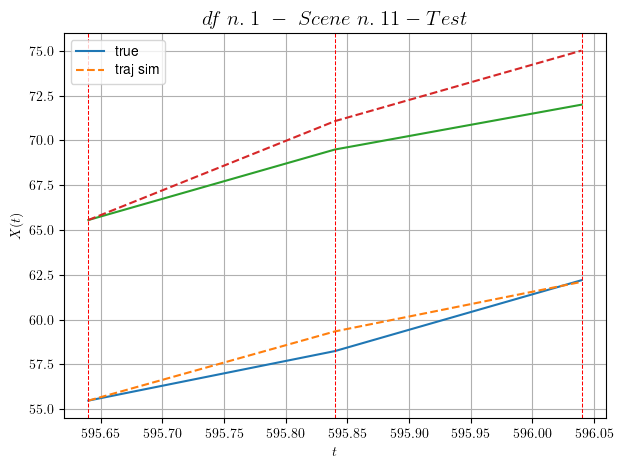

        For scene 11/99:
        * MSE = 2.135934491124219
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.12/99


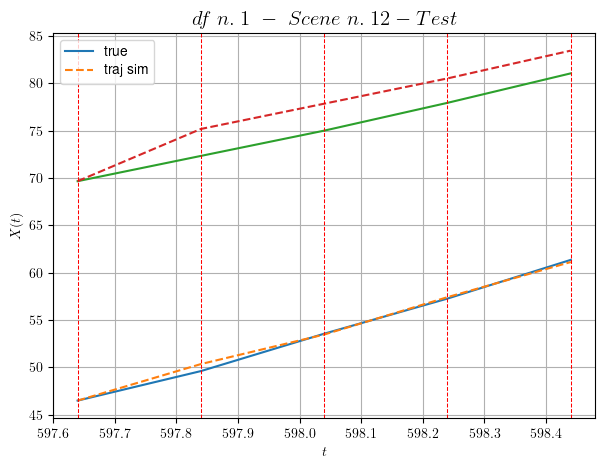

        For scene 12/99:
        * MSE = 2.9284946925280377
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.13/99


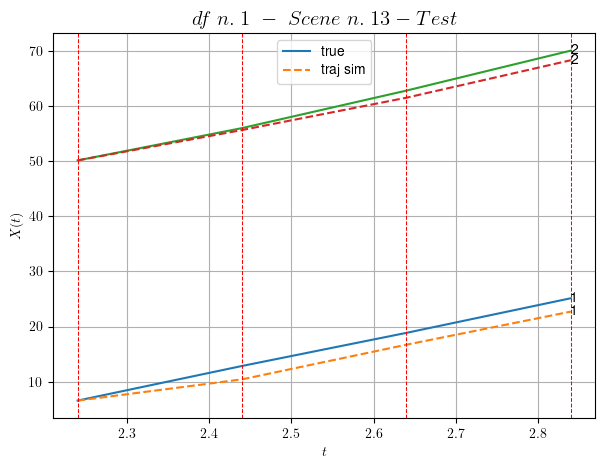

        For scene 13/99:
        * MSE = 2.6599463189388732
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.14/99


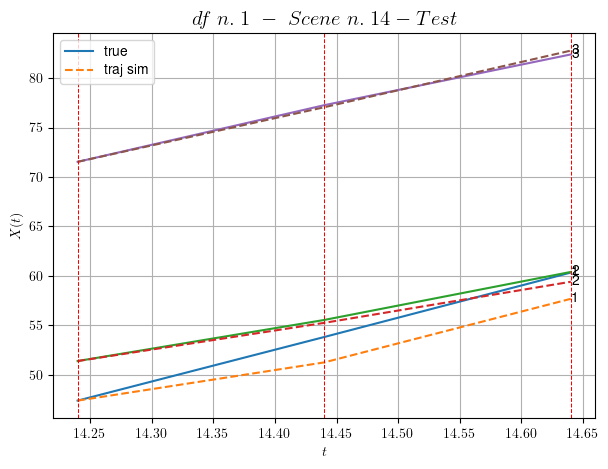

        For scene 14/99:
        * MSE = 1.6551284343518924
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.15/99


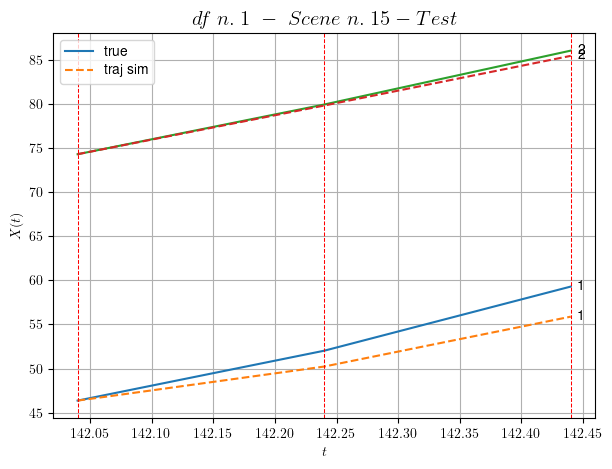

        For scene 15/99:
        * MSE = 2.5369668659897084
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.16/99


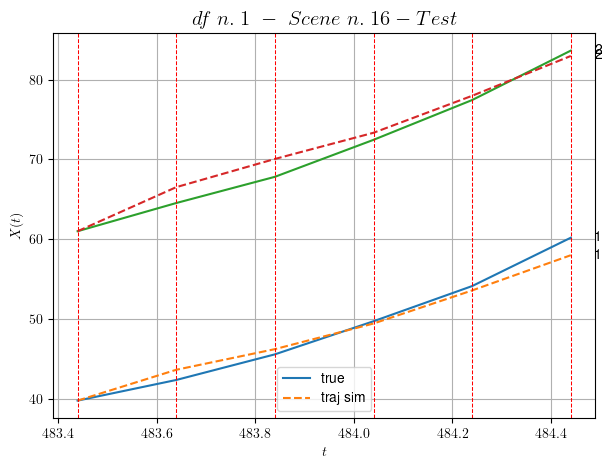

        For scene 16/99:
        * MSE = 1.4760621877491276
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.17/99


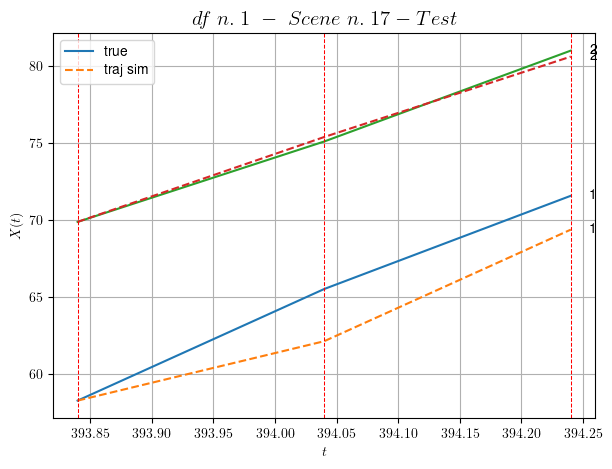

        For scene 17/99:
        * MSE = 2.765343255408119
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.18/99


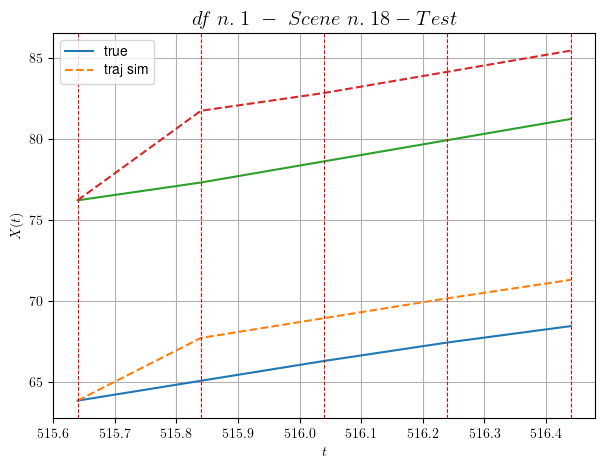

        For scene 18/99:
        * MSE = 10.22714423454631
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.19/99


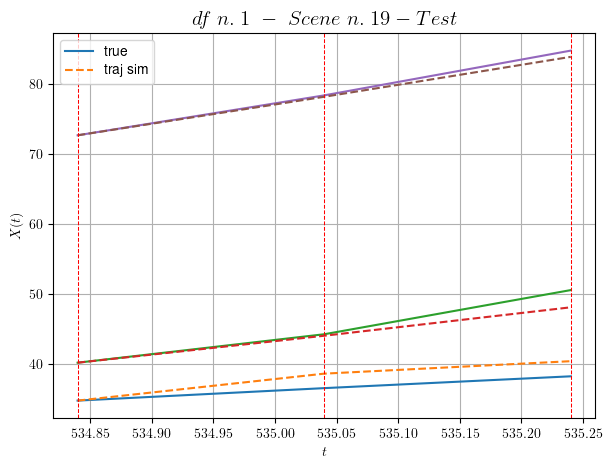

        For scene 19/99:
        * MSE = 1.7740490416880508
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.20/99


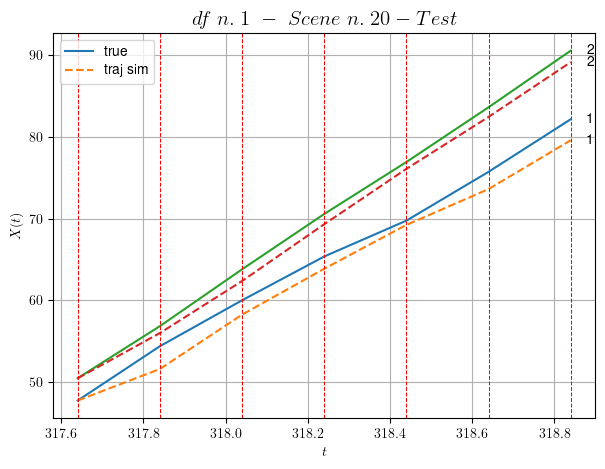

        For scene 20/99:
        * MSE = 2.344835216501476
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.21/99


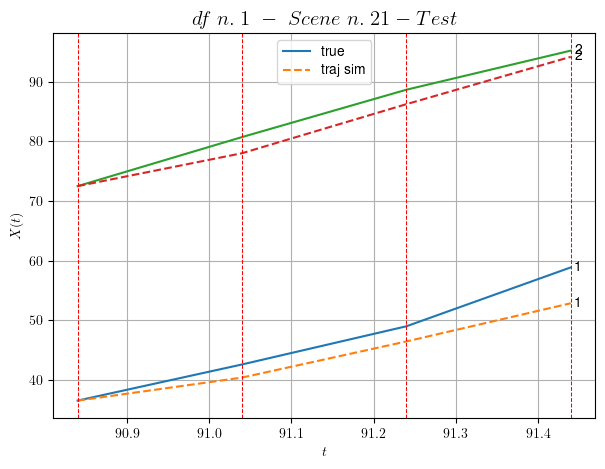

        For scene 21/99:
        * MSE = 7.715941643930703
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.22/99


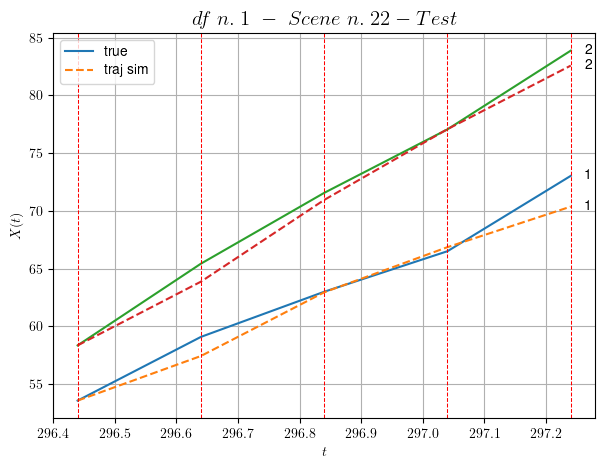

        For scene 22/99:
        * MSE = 1.4442360278822741
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.23/99


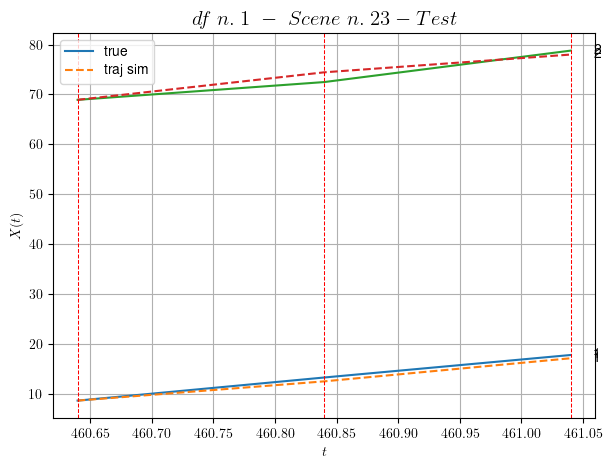

        For scene 23/99:
        * MSE = 0.9107317093452816
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.24/99


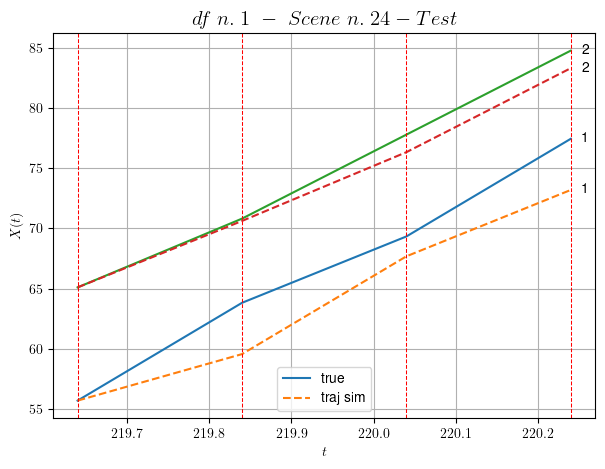

        For scene 24/99:
        * MSE = 5.400697527167342
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.25/99


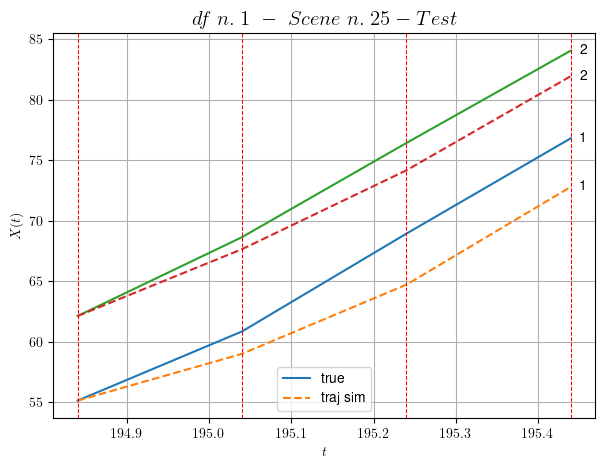

        For scene 25/99:
        * MSE = 5.978061399334391
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.26/99


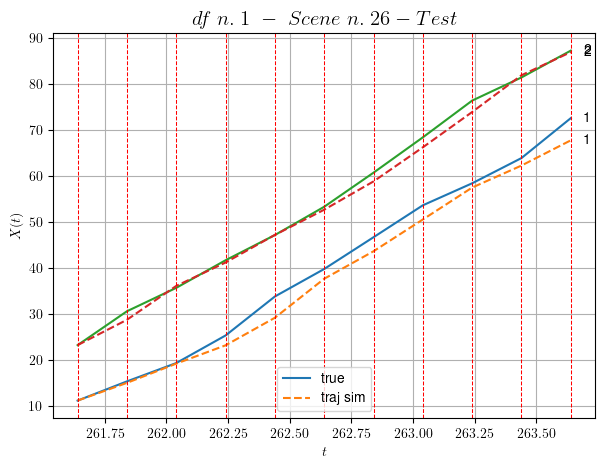

        For scene 26/99:
        * MSE = 4.340152425523162
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.27/99


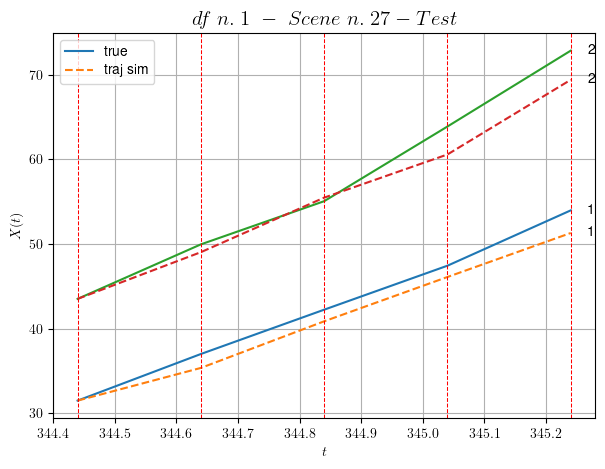

        For scene 27/99:
        * MSE = 3.7303636189655447
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.28/99


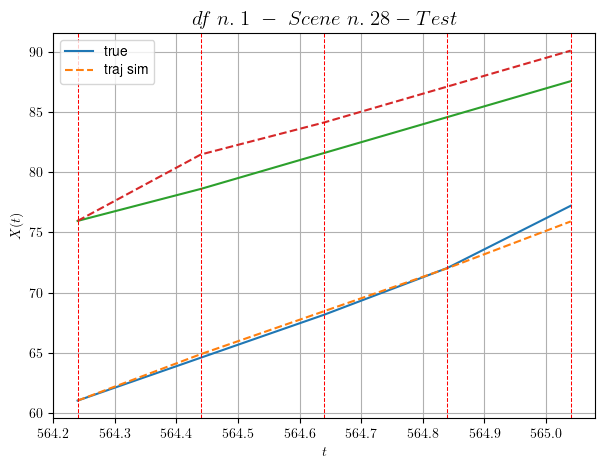

        For scene 28/99:
        * MSE = 2.932513865471366
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.29/99


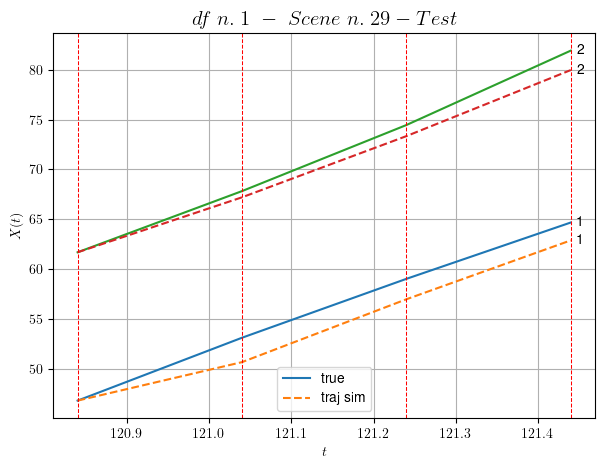

        For scene 29/99:
        * MSE = 2.355166827134184
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.30/99


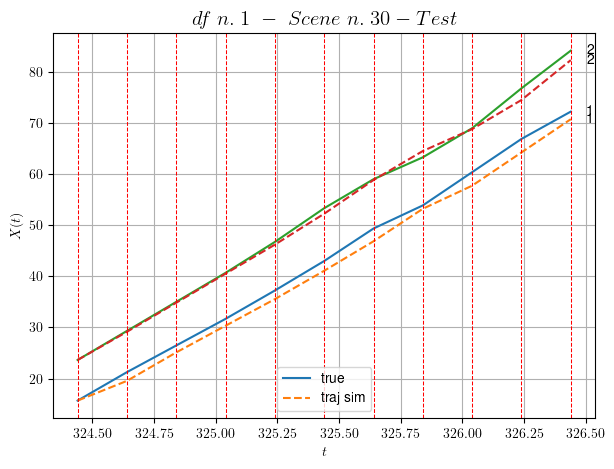

        For scene 30/99:
        * MSE = 2.1690355690536958
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.31/99


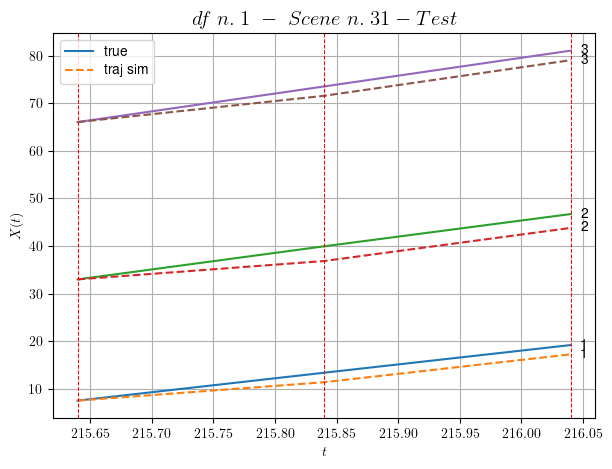

        For scene 31/99:
        * MSE = 3.740918326224218
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.32/99


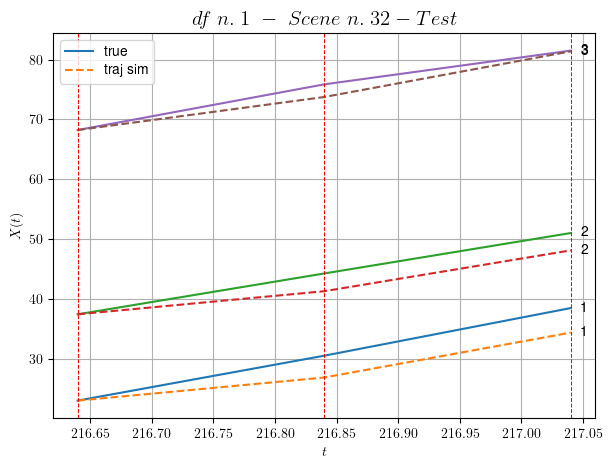

        For scene 32/99:
        * MSE = 5.758241754153719
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.33/99


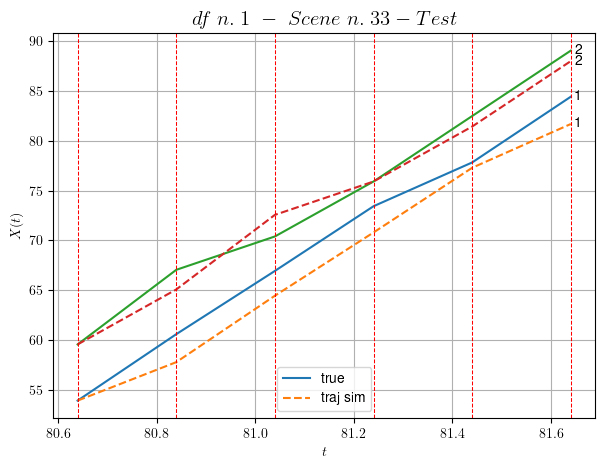

        For scene 33/99:
        * MSE = 3.302297420301039
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.34/99


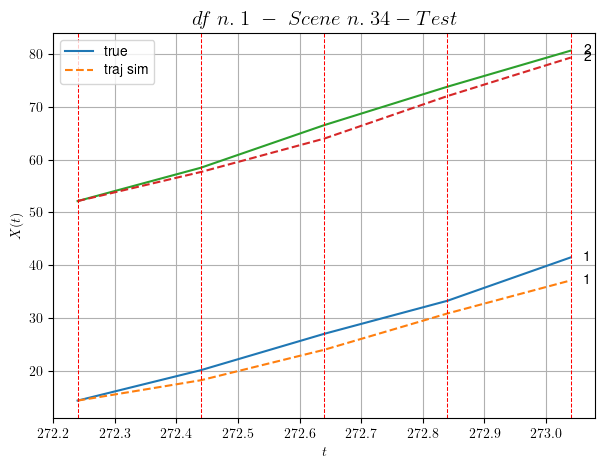

        For scene 34/99:
        * MSE = 4.969168728771934
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.35/99


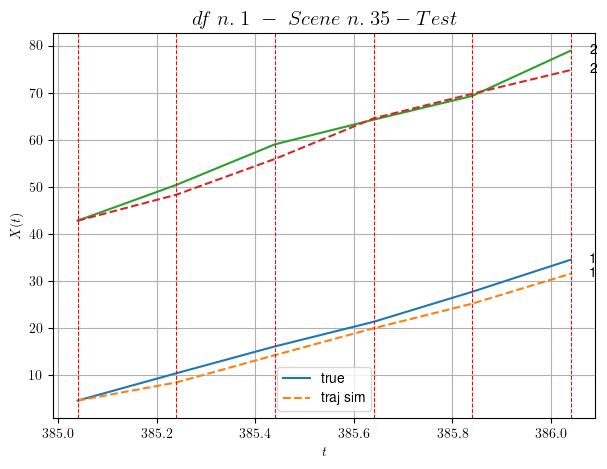

        For scene 35/99:
        * MSE = 4.635173129642087
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.36/99


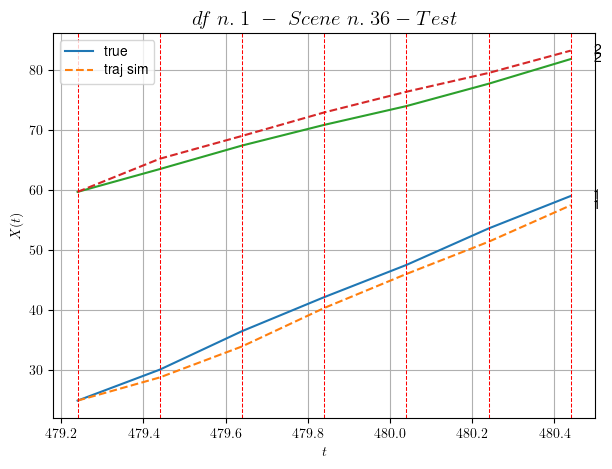

        For scene 36/99:
        * MSE = 2.9798463086867564
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.37/99


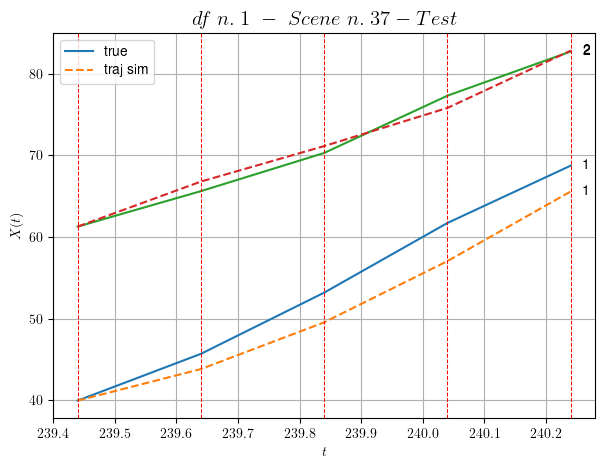

        For scene 37/99:
        * MSE = 5.2881814855702665
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.38/99


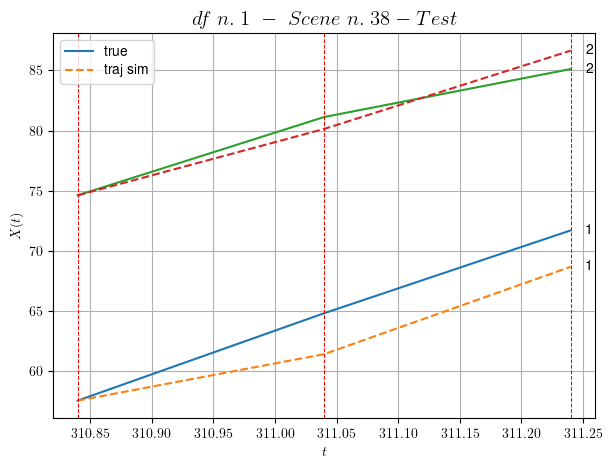

        For scene 38/99:
        * MSE = 4.00793822510519
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.39/99


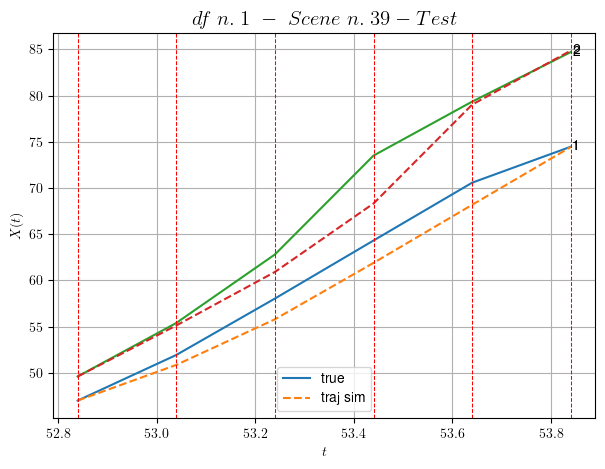

        For scene 39/99:
        * MSE = 4.035680111782094
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.40/99


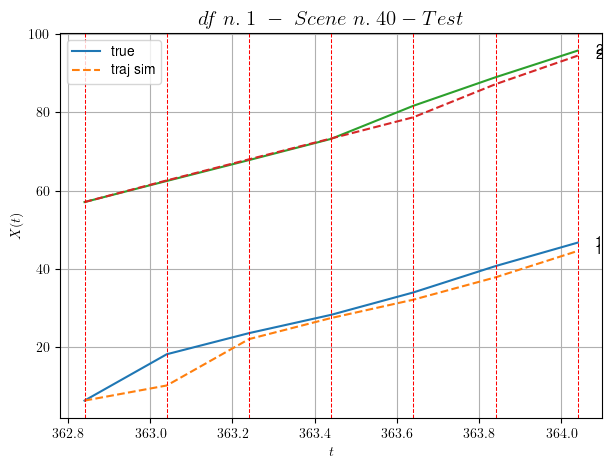

        For scene 40/99:
        * MSE = 6.867934557080941
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.41/99


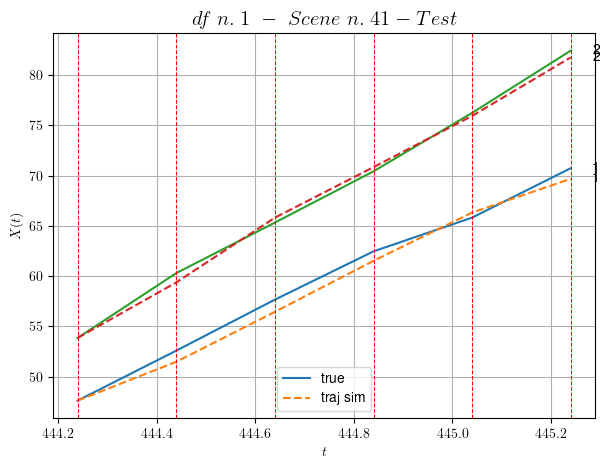

        For scene 41/99:
        * MSE = 0.5657460495719566
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.42/99


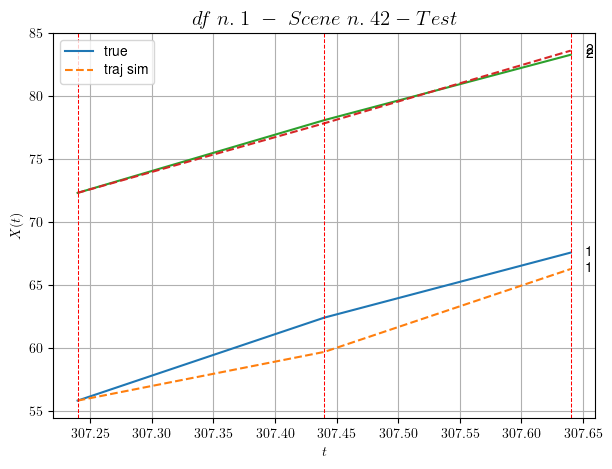

        For scene 42/99:
        * MSE = 1.542516652631207
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.43/99


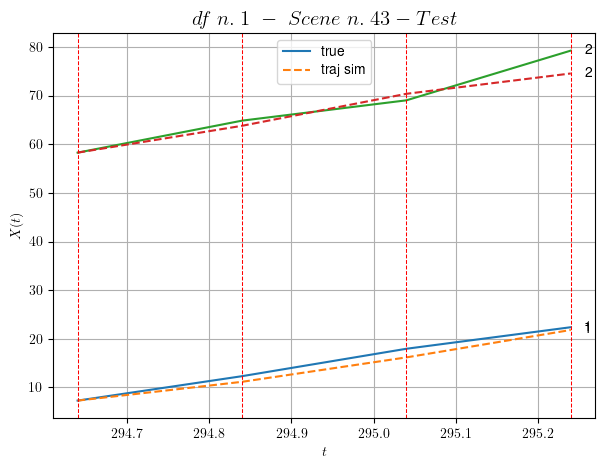

        For scene 43/99:
        * MSE = 3.7223111016297556
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.44/99


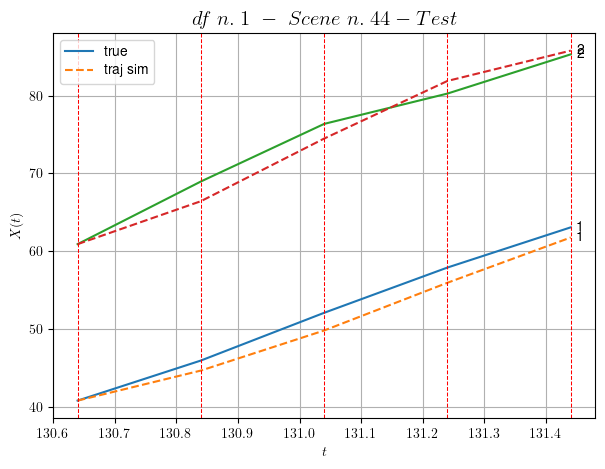

        For scene 44/99:
        * MSE = 2.5161771269057285
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.45/99


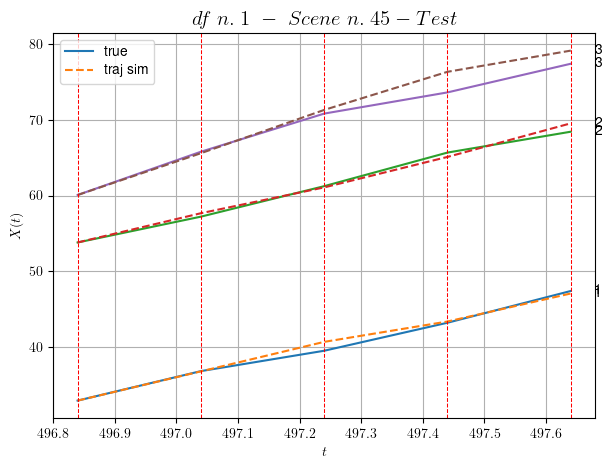

        For scene 45/99:
        * MSE = 0.931303307445015
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.46/99


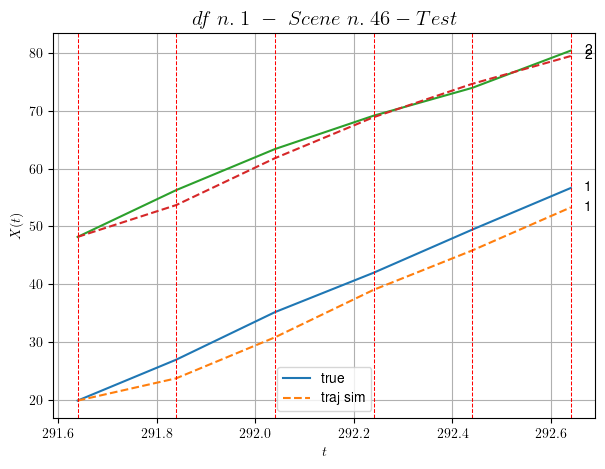

        For scene 46/99:
        * MSE = 6.088786485844479
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.47/99


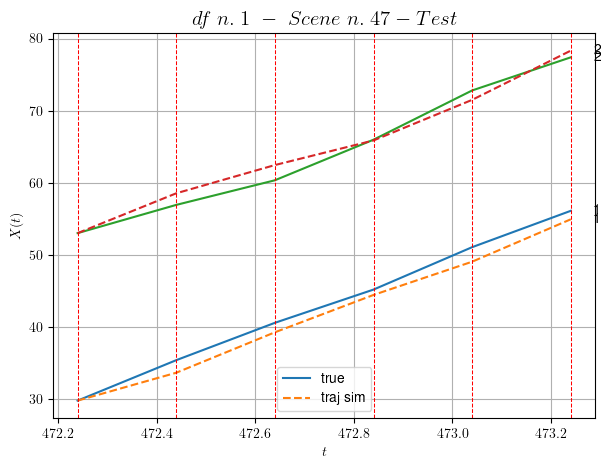

        For scene 47/99:
        * MSE = 1.6944751200649224
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.48/99


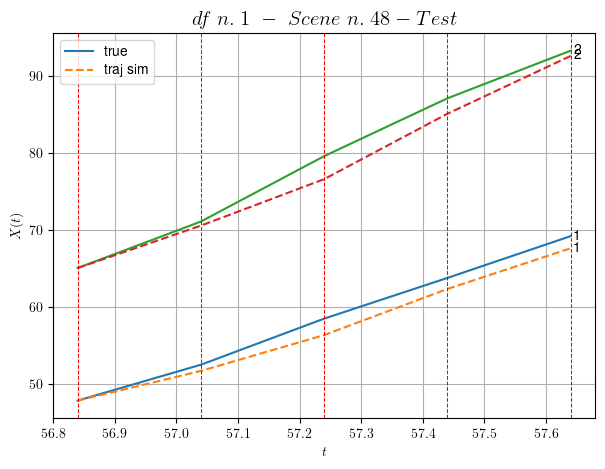

        For scene 48/99:
        * MSE = 2.353080786708177
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.49/99


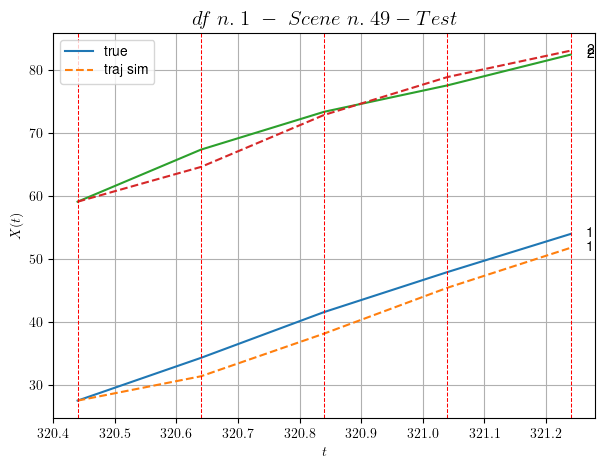

        For scene 49/99:
        * MSE = 4.120935307864842
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.50/99


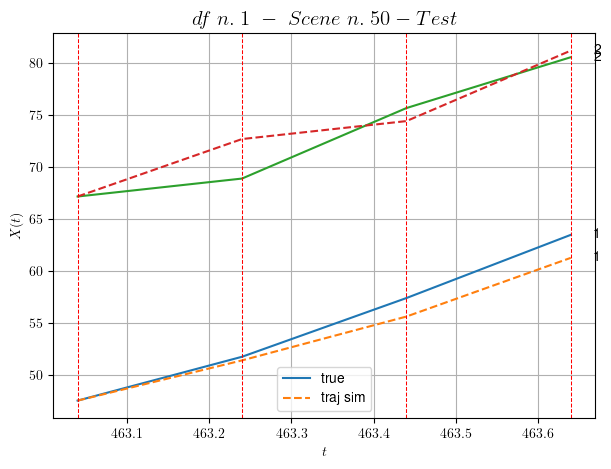

        For scene 50/99:
        * MSE = 3.0647805350006183
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.51/99


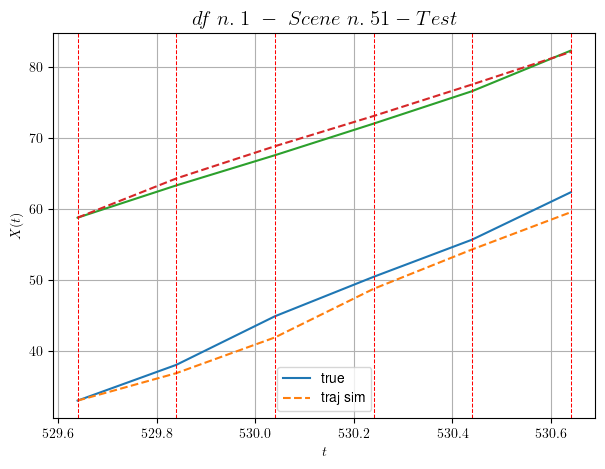

        For scene 51/99:
        * MSE = 2.293797369649308
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.52/99


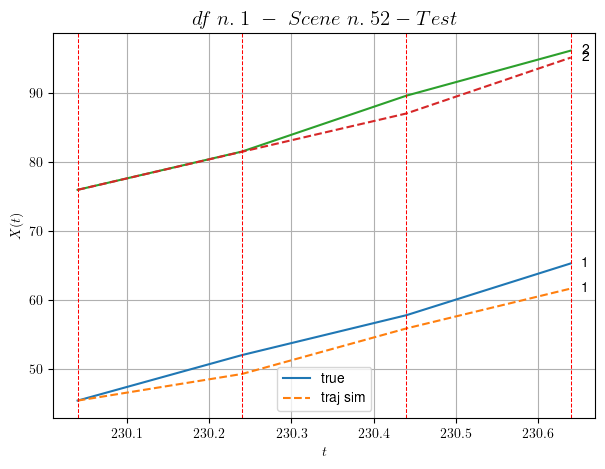

        For scene 52/99:
        * MSE = 4.015591096828911
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.53/99


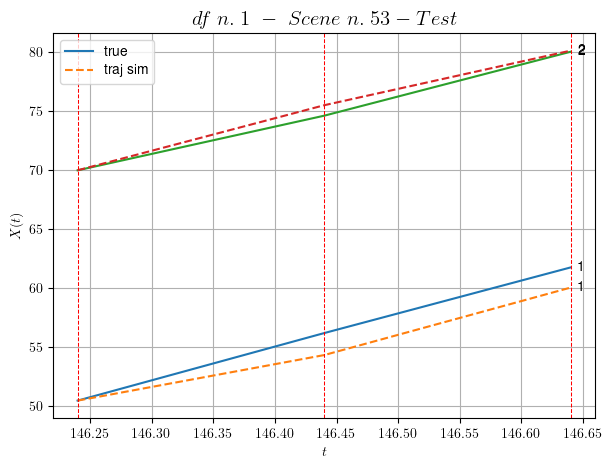

        For scene 53/99:
        * MSE = 1.1988669063099233
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.54/99


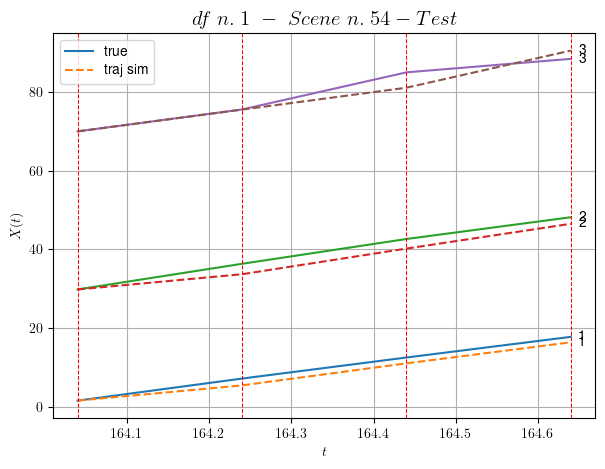

        For scene 54/99:
        * MSE = 3.5186609230587744
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.55/99


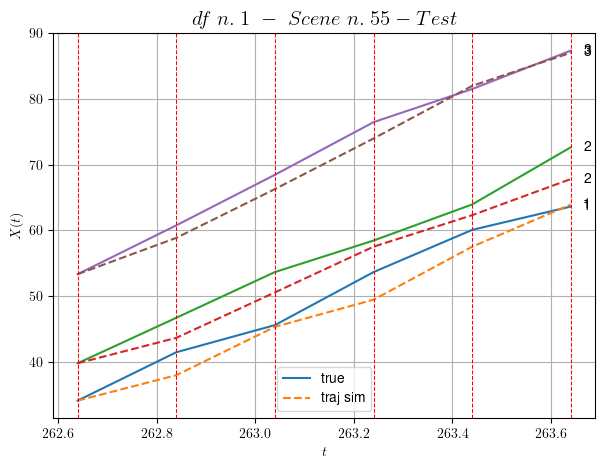

        For scene 55/99:
        * MSE = 5.394359646049803
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.56/99


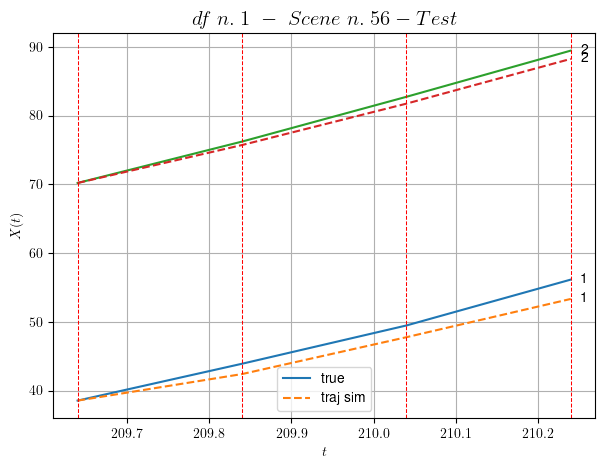

        For scene 56/99:
        * MSE = 1.971289302188128
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.57/99


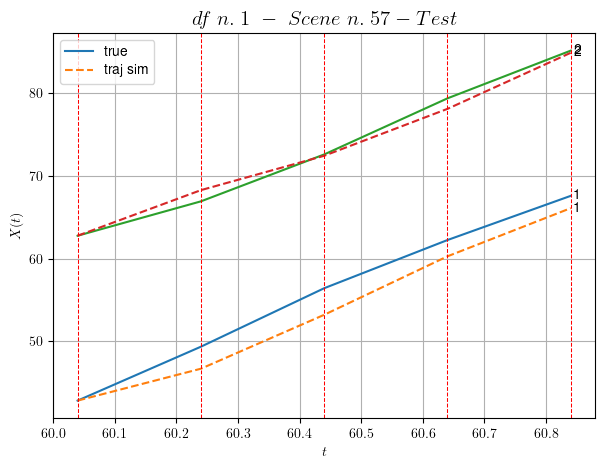

        For scene 57/99:
        * MSE = 2.7103581293645798
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.58/99


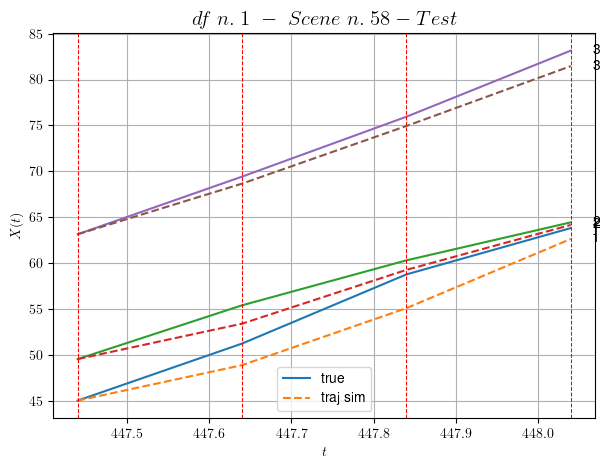

        For scene 58/99:
        * MSE = 2.5061903051390364
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.59/99


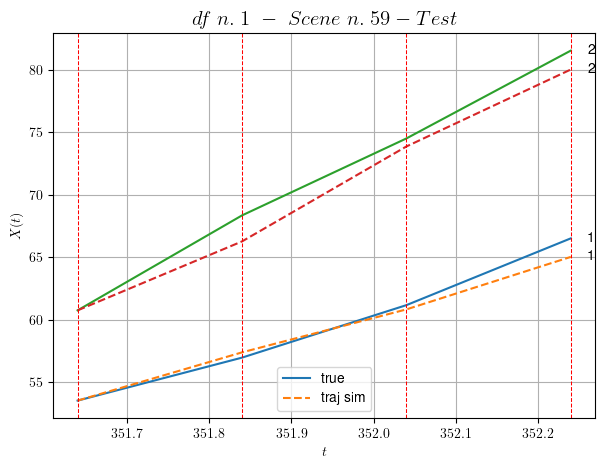

        For scene 59/99:
        * MSE = 1.1918231084868234
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.60/99


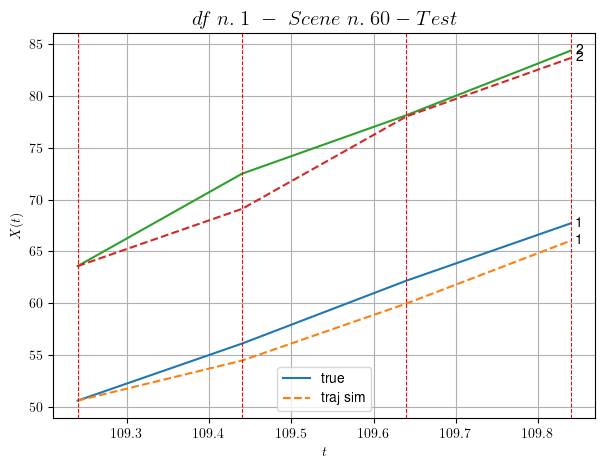

        For scene 60/99:
        * MSE = 2.795464368619232
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.61/99


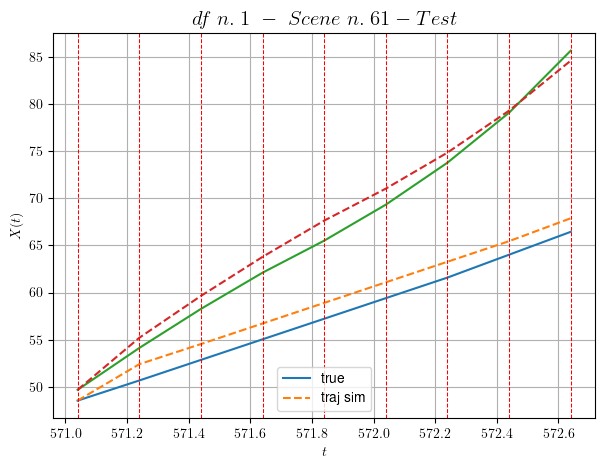

        For scene 61/99:
        * MSE = 2.0433574936529793
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.62/99


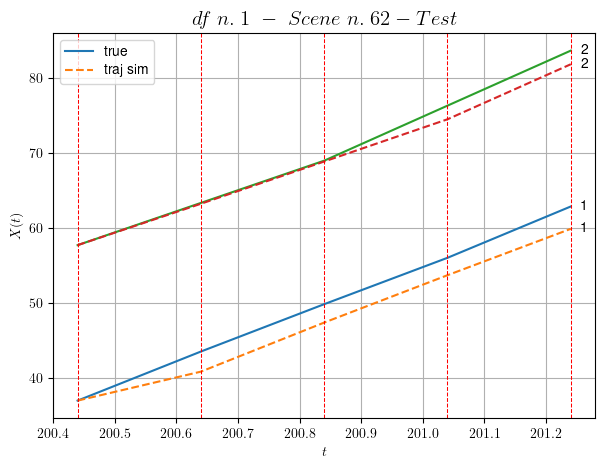

        For scene 62/99:
        * MSE = 3.4101634458579437
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.63/99


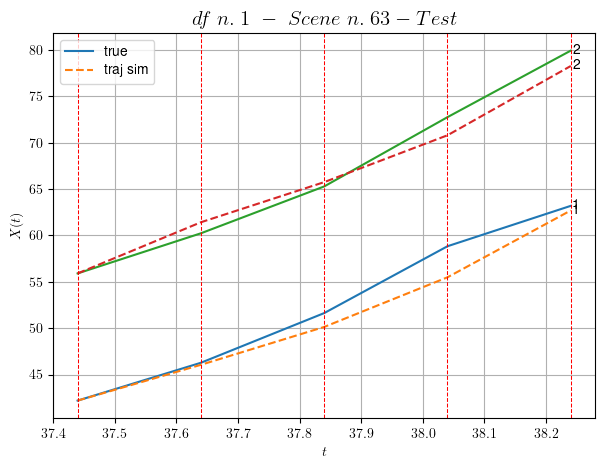

        For scene 63/99:
        * MSE = 2.192907961556925
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.64/99


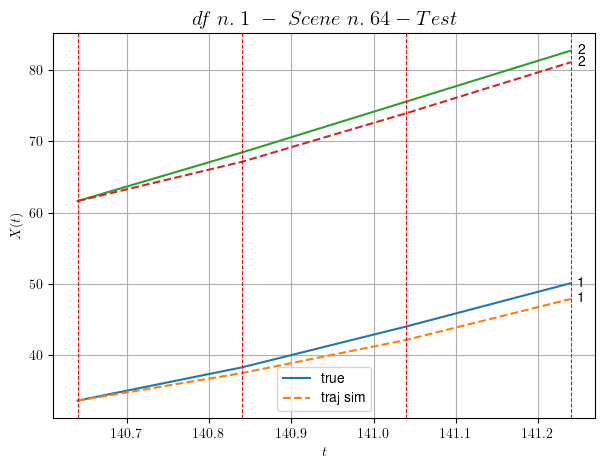

        For scene 64/99:
        * MSE = 2.014742934477749
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.65/99


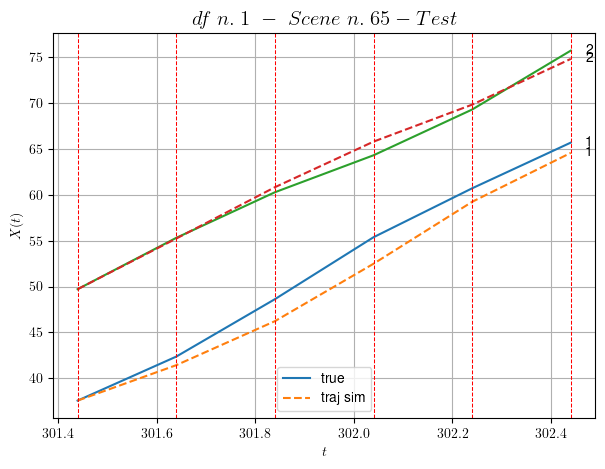

        For scene 65/99:
        * MSE = 1.8337247571574957
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.66/99


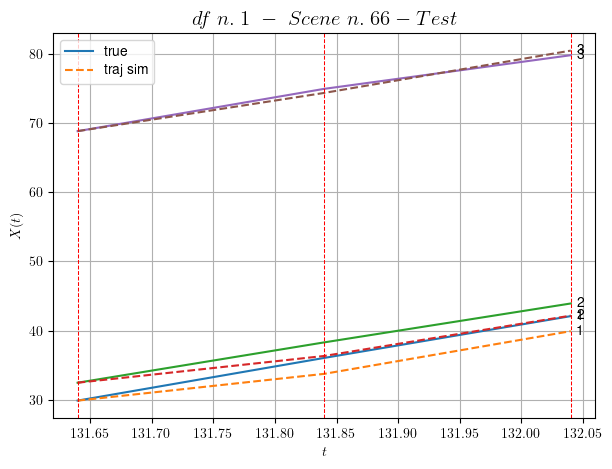

        For scene 66/99:
        * MSE = 1.966579304636489
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.67/99


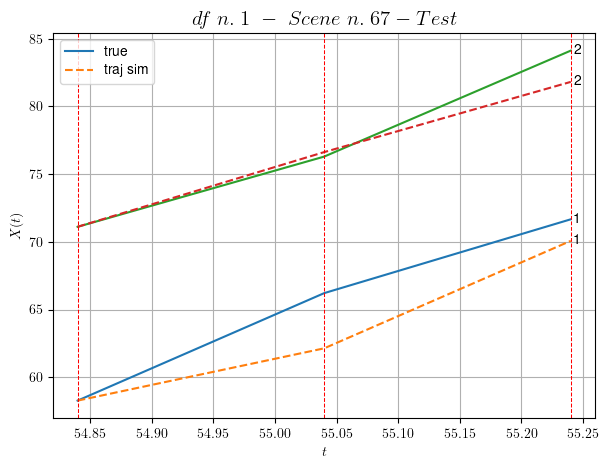

        For scene 67/99:
        * MSE = 4.099416980683797
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.68/99


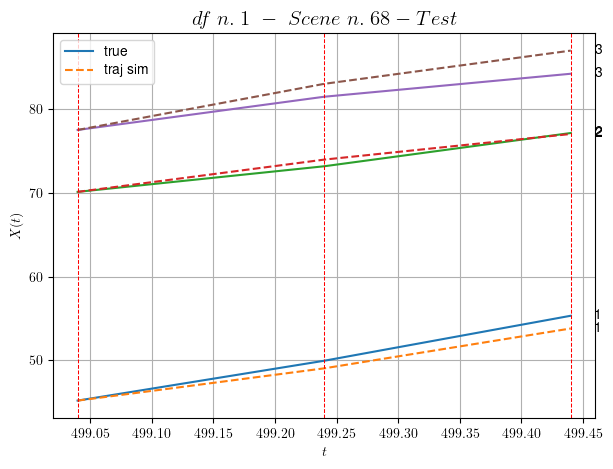

        For scene 68/99:
        * MSE = 1.5368257077268417
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.69/99


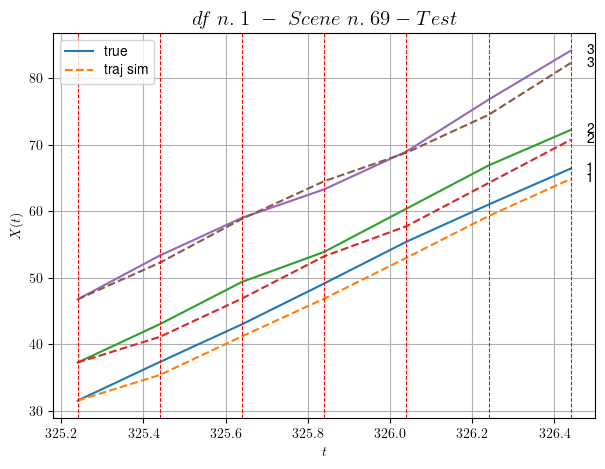

        For scene 69/99:
        * MSE = 2.9289315232231403
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.70/99


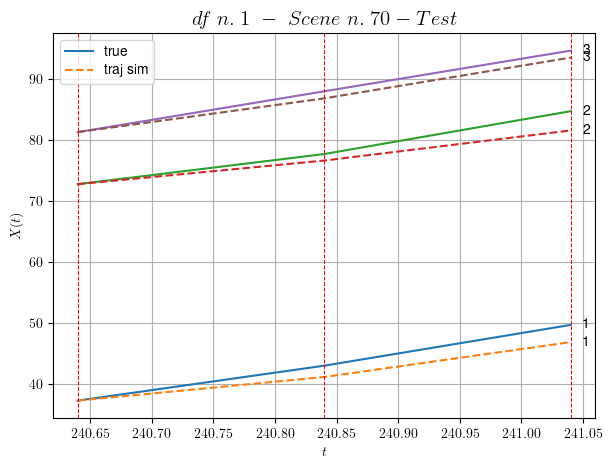

        For scene 70/99:
        * MSE = 2.780062317811278
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.71/99


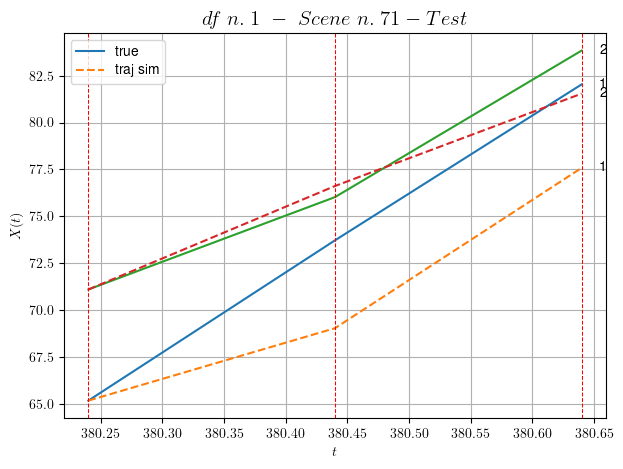

        For scene 71/99:
        * MSE = 7.90185393729115
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.72/99


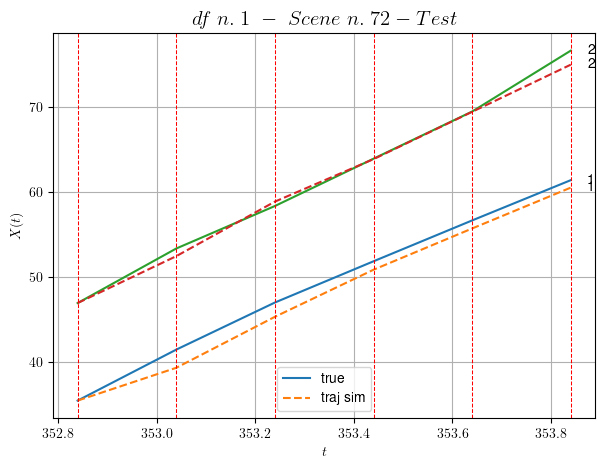

        For scene 72/99:
        * MSE = 1.156325681376669
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.73/99


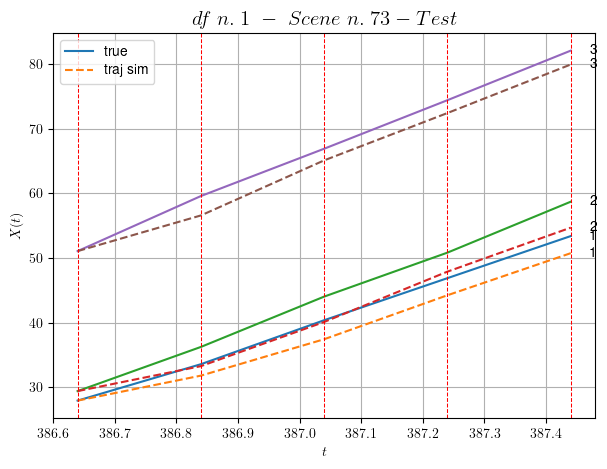

        For scene 73/99:
        * MSE = 6.36288071733606
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.74/99


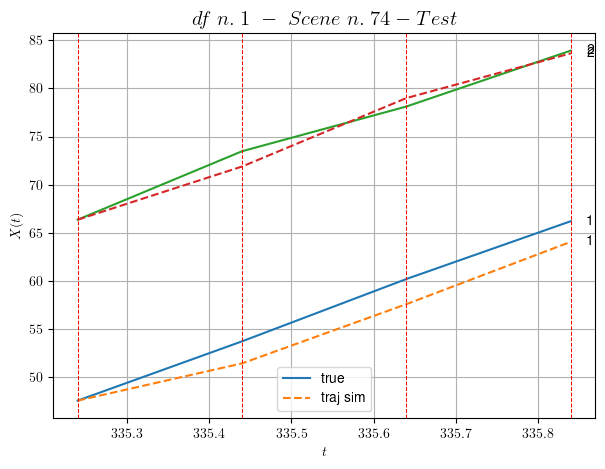

        For scene 74/99:
        * MSE = 2.4987784040090655
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.75/99


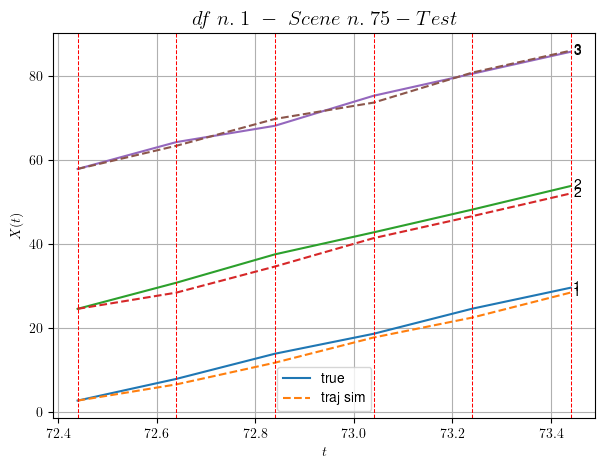

        For scene 75/99:
        * MSE = 2.2546729645392496
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.76/99


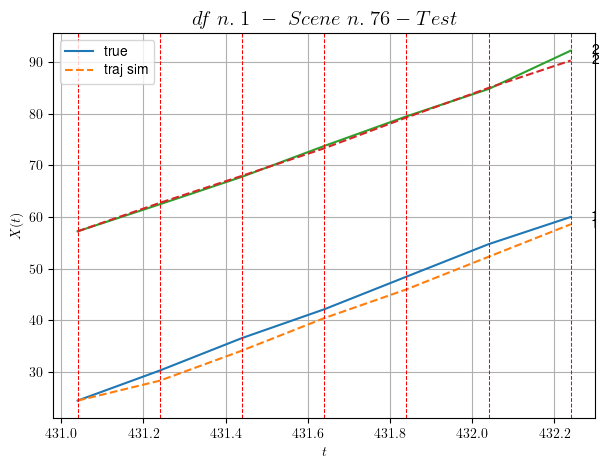

        For scene 76/99:
        * MSE = 2.200893490061418
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.77/99


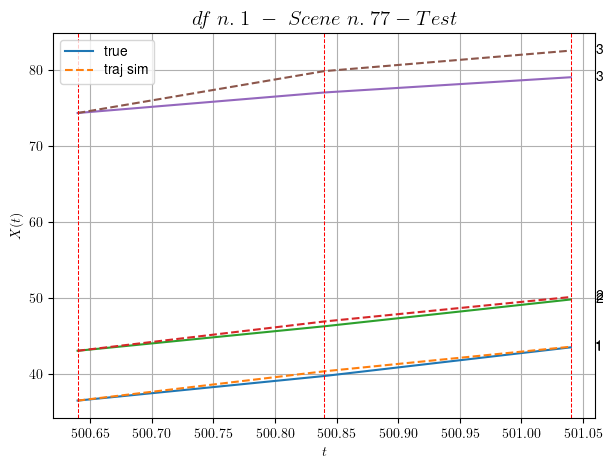

        For scene 77/99:
        * MSE = 2.3476359425010114
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.78/99


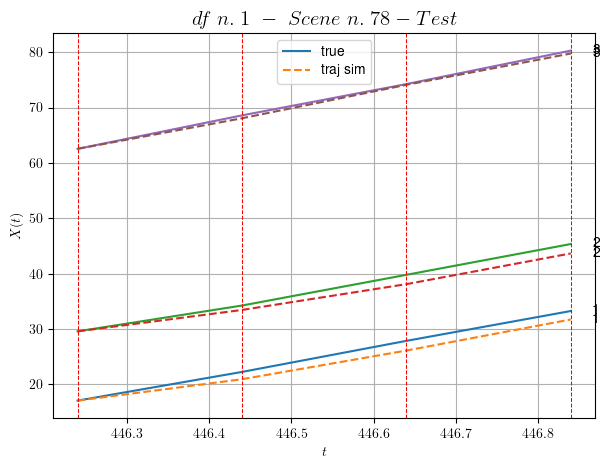

        For scene 78/99:
        * MSE = 1.1703248910436508
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.79/99


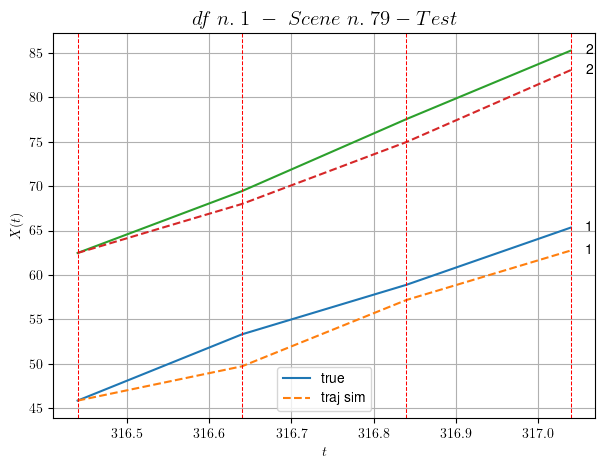

        For scene 79/99:
        * MSE = 4.509471183731984
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.80/99


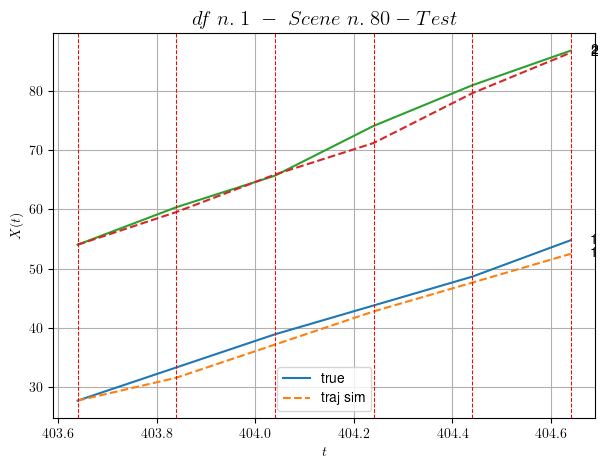

        For scene 80/99:
        * MSE = 2.0217836909652265
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.81/99


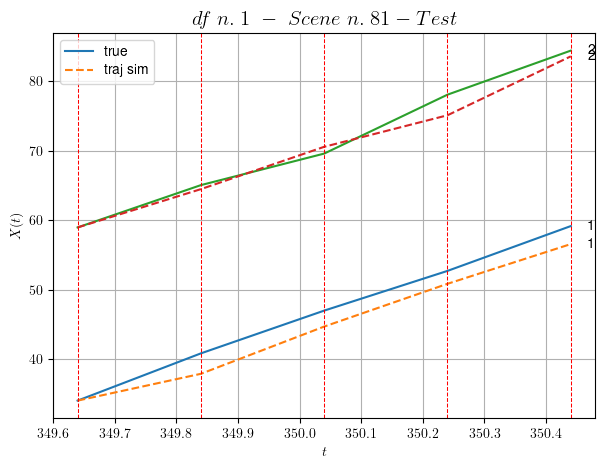

        For scene 81/99:
        * MSE = 3.489773108234524
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.82/99


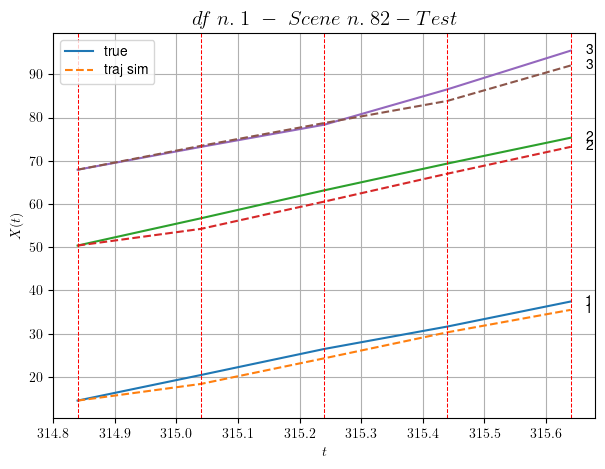

        For scene 82/99:
        * MSE = 3.7570583890401843
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.83/99


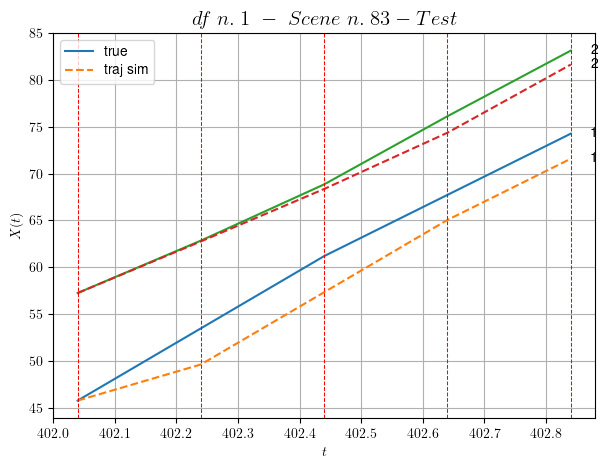

        For scene 83/99:
        * MSE = 4.971864888897366
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.84/99


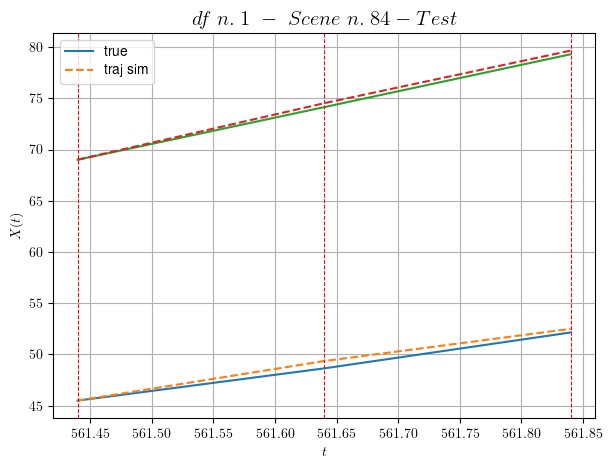

        For scene 84/99:
        * MSE = 0.15074768624738993
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.85/99


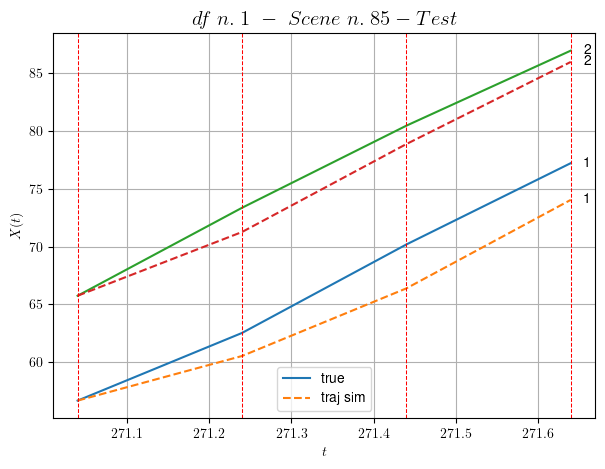

        For scene 85/99:
        * MSE = 4.550982007793152
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.86/99


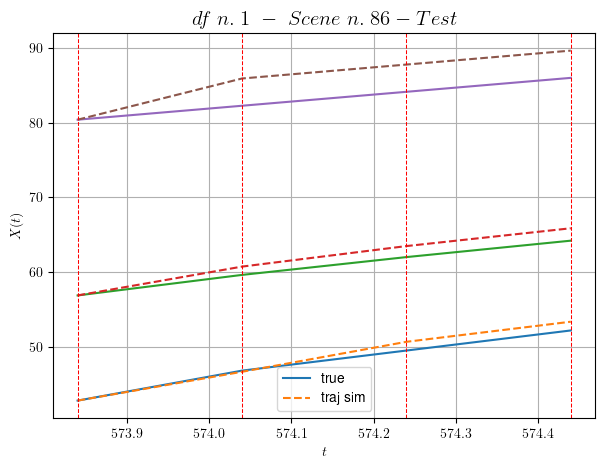

        For scene 86/99:
        * MSE = 4.076413897192936
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.87/99


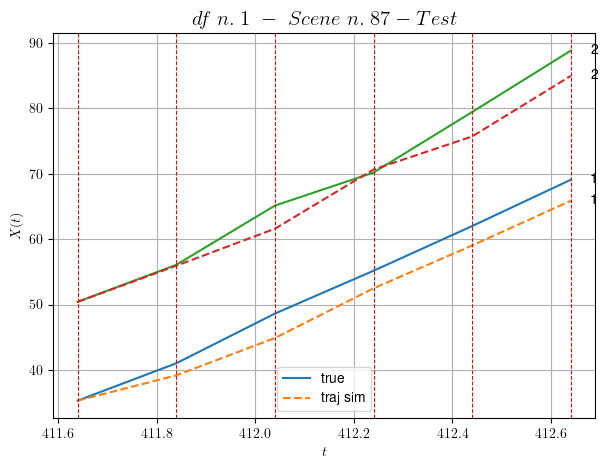

        For scene 87/99:
        * MSE = 7.122122909914263
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.88/99


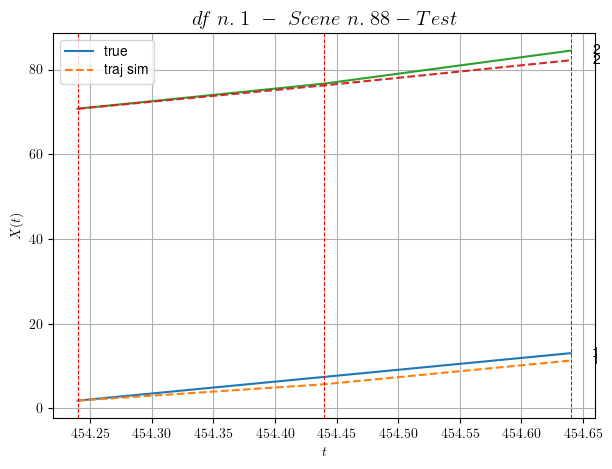

        For scene 88/99:
        * MSE = 1.902675034032539
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.89/99


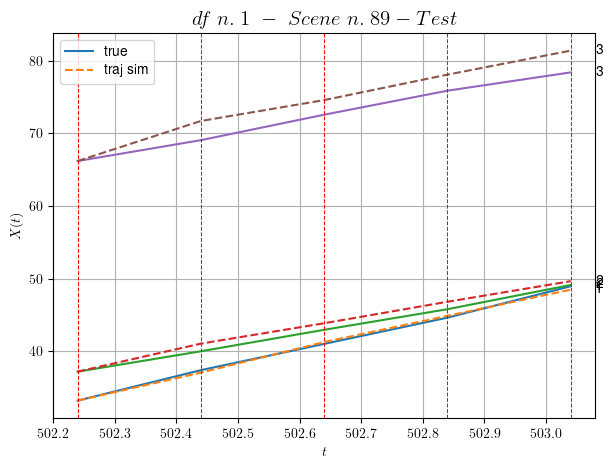

        For scene 89/99:
        * MSE = 1.906467745130638
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.90/99


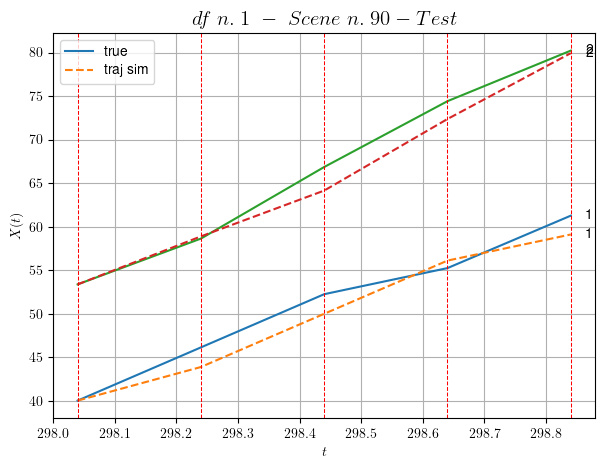

        For scene 90/99:
        * MSE = 2.726799741834423
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.91/99


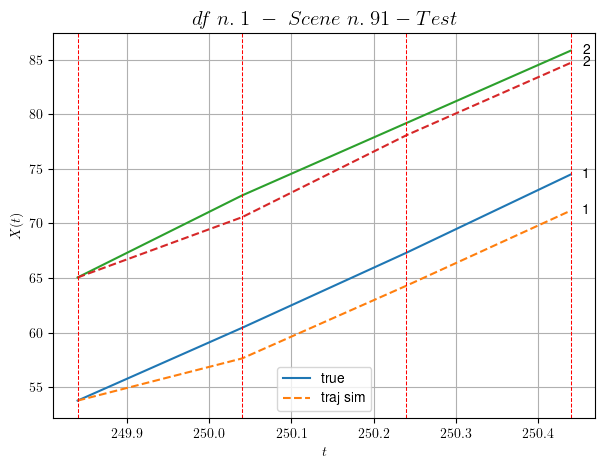

        For scene 91/99:
        * MSE = 4.3023093755716095
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.92/99


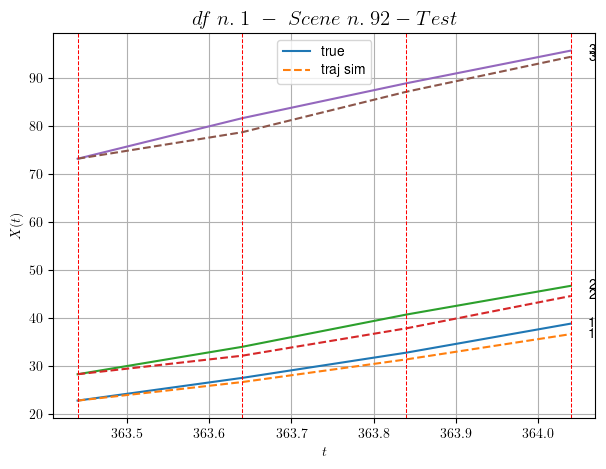

        For scene 92/99:
        * MSE = 3.0867059713190543
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.93/99


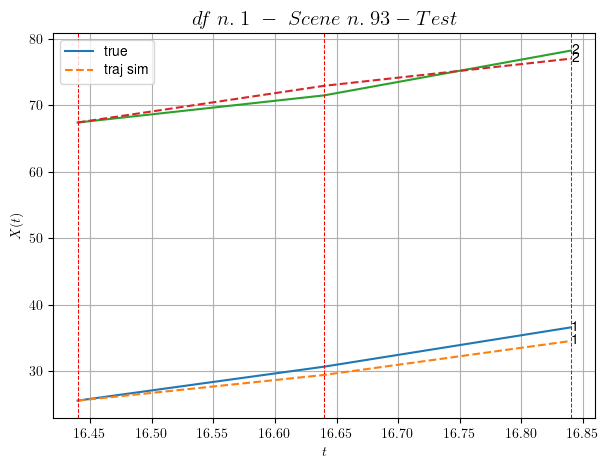

        For scene 93/99:
        * MSE = 1.5446292088661113
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.94/99


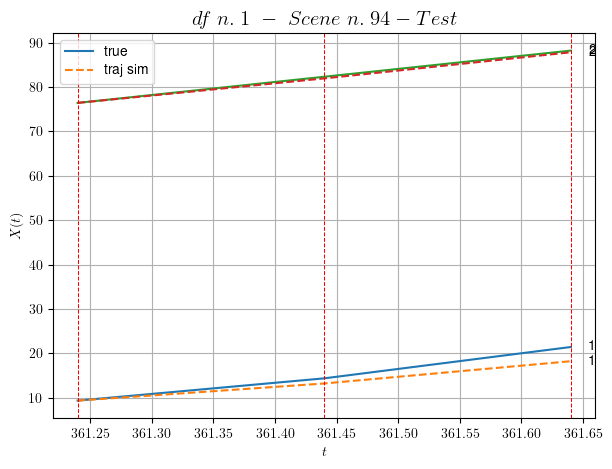

        For scene 94/99:
        * MSE = 1.9766696204907352
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.95/99


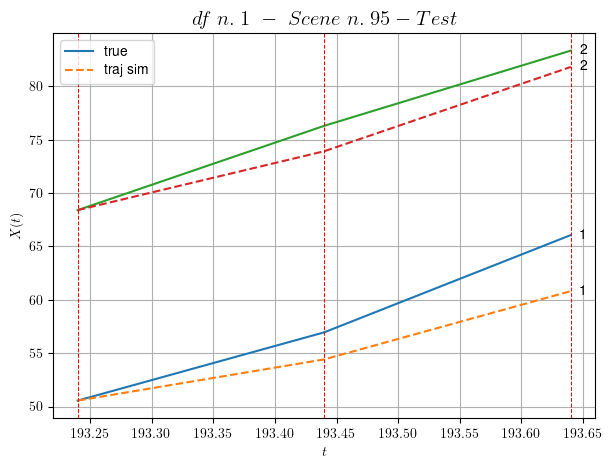

        For scene 95/99:
        * MSE = 7.0090443710540375
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.96/99


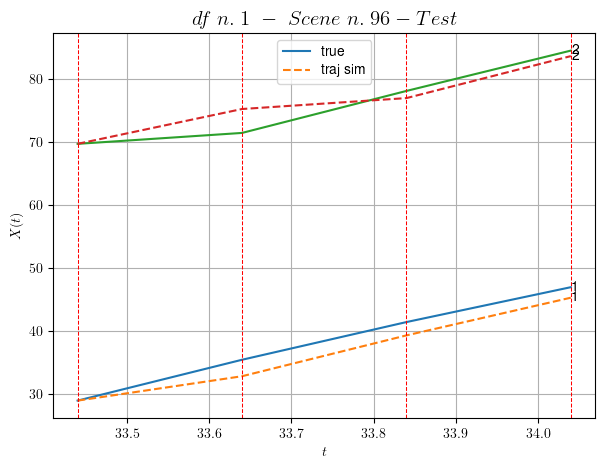

        For scene 96/99:
        * MSE = 3.803186856535763
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.97/99


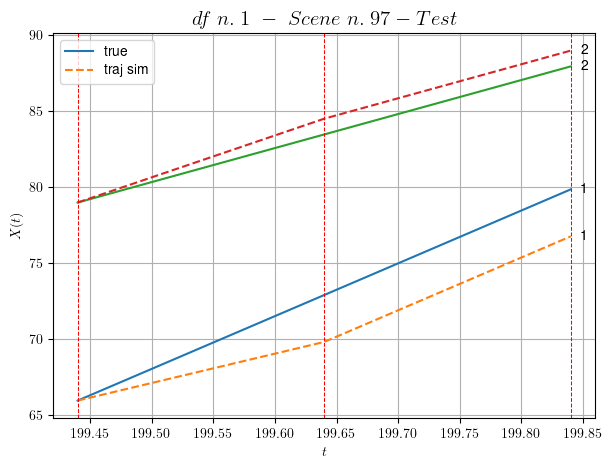

        For scene 97/99:
        * MSE = 3.54213801470743
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.98/99


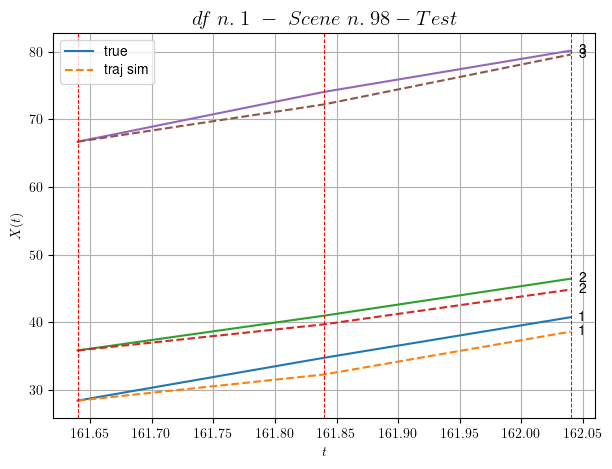

        For scene 98/99:
        * MSE = 2.0648912752012367
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.99/99


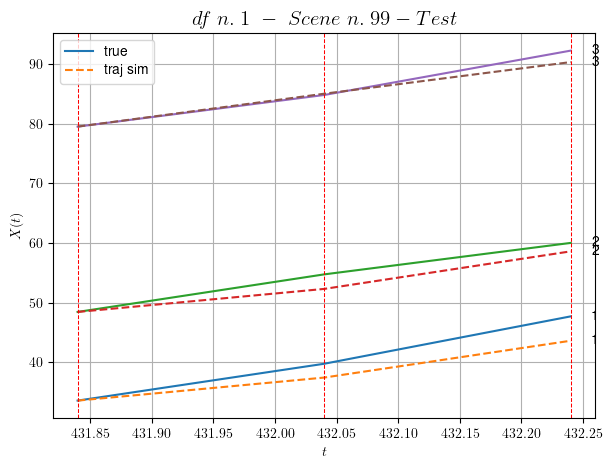

        For scene 99/99:
        * MSE = 3.747552132083987
----------------------------------------------------------------------------------------------------


MSE test: 3.163129755961994

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.6249619467017486
          * MSE test: 3.163129755961994
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 2/10 dfs.
In DataFrame n.2 we have 69 scenes.
    To train the model we use 6 scenes, the remaining 63 to test the model.

Training step. (6 scenes)
DataFrame n.2. Scene n.1/6
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [52.76,53.56]


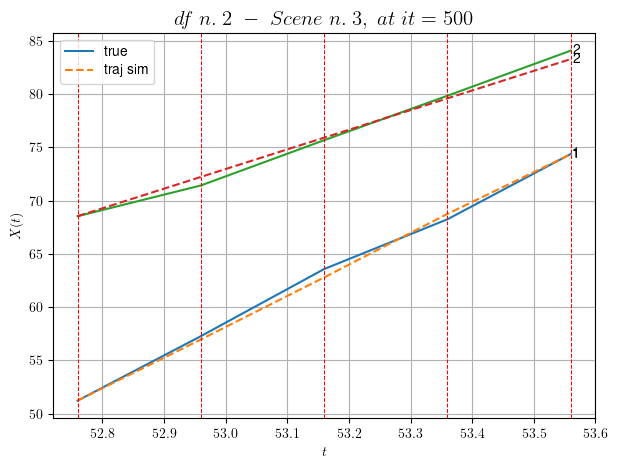

----------------------------------------------------------------------------------------------------
        For scene 1/6:
        * After LR finder: LR_NN=0.005 with mse=15.088848379577728 at it=24
        * v0 = 18.434937295304415
        * MSE = 0.2305348091797187
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.2/6
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [250.16,250.96]


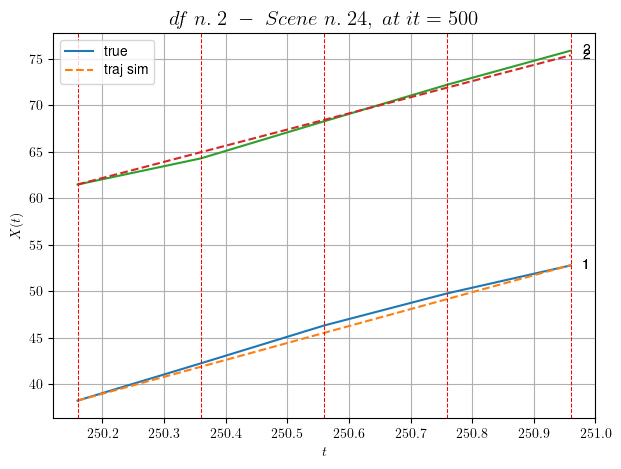

----------------------------------------------------------------------------------------------------
        For scene 2/6:
        * After LR finder: LR_NN=5e-05 with mse=18.359847854058415 at it=24
        * v0 = 17.36451537391297
        * MSE = 0.150293559675722
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.3/6
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [223.16,223.56]


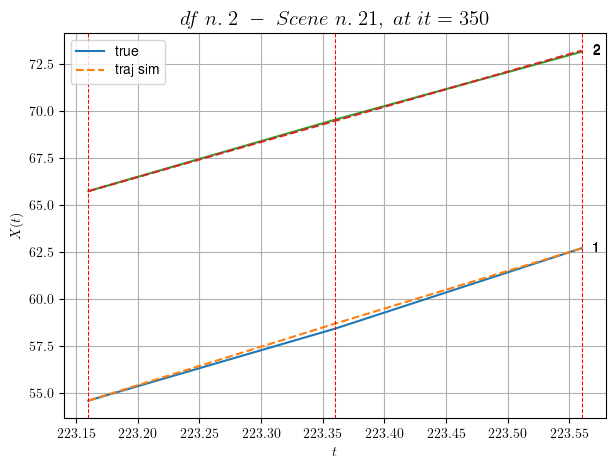

----------------------------------------------------------------------------------------------------
        For scene 3/6:
        * After LR finder: LR_NN=0.005 with mse=4.318531860090955 at it=24
        * v0 = 18.698370395223144
        * MSE = 0.013212547467885813
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.4/6
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [442.76,443.76]


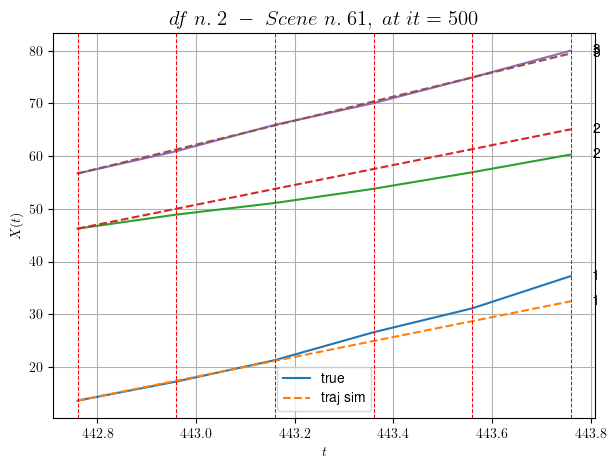

----------------------------------------------------------------------------------------------------
        For scene 4/6:
        * After LR finder: LR_NN=5e-05 with mse=8.538302546830955 at it=24
        * v0 = 22.775896802505514
        * MSE = 5.368553619419985
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.5/6
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [198.16,200.16]


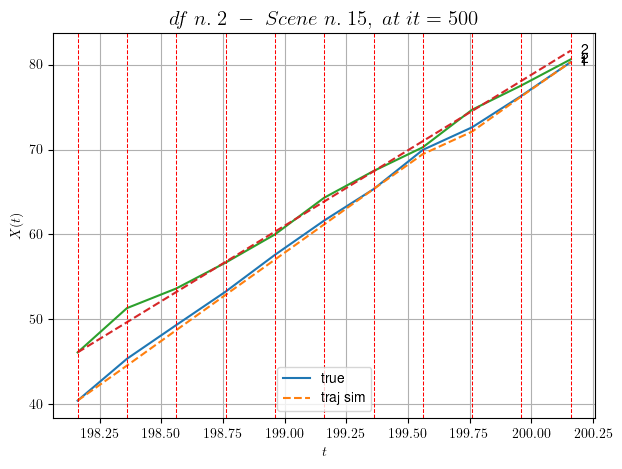

----------------------------------------------------------------------------------------------------
        For scene 5/6:
        * After LR finder: LR_NN=0.005 with mse=108.70952136003727 at it=24
        * v0 = 17.756279251512968
        * MSE = 0.32535604368338156
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.6/6
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [86.16,86.96]


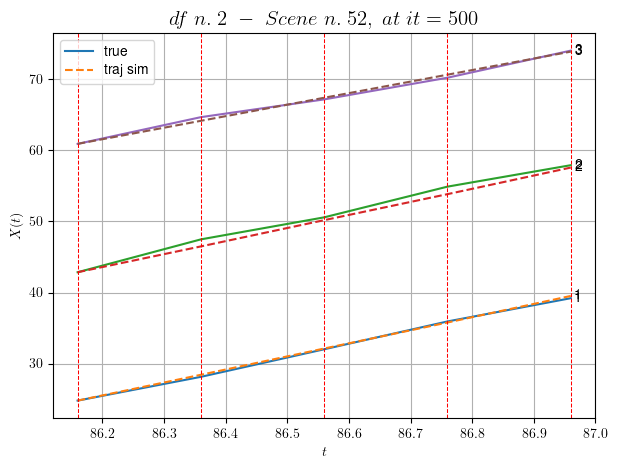

----------------------------------------------------------------------------------------------------
        For scene 6/6:
        * After LR finder: LR_NN=0.005 with mse=15.630070804206502 at it=24
        * v0 = 16.235330060145785
        * MSE = 0.20663947569886132
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 1.0490983425209257
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (63 scenes)
DataFrame n.2. Scene n.1/63


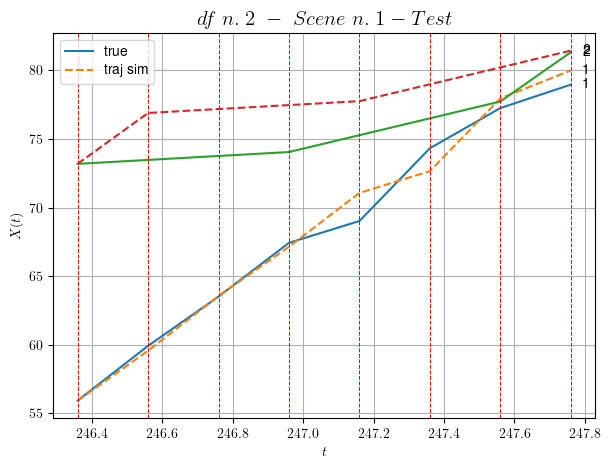

        For scene 1/63:
        * MSE = 3.895660507005732
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.2/63


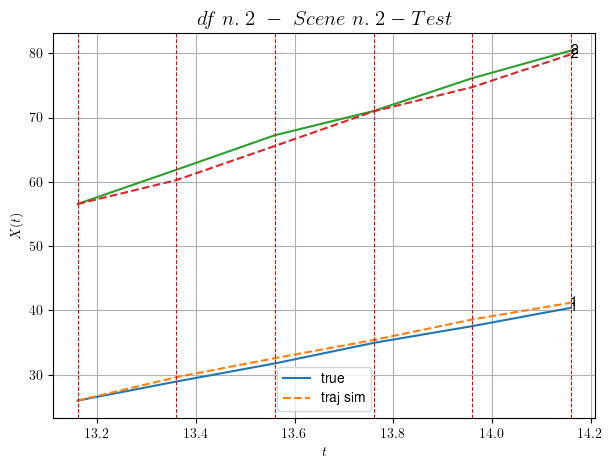

        For scene 2/63:
        * MSE = 0.888018672626154
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.3/63


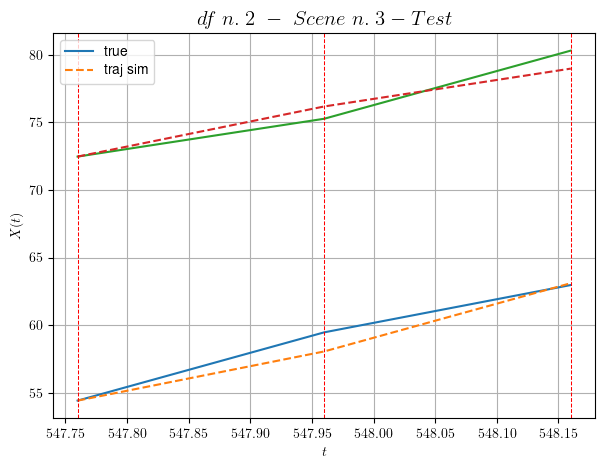

        For scene 3/63:
        * MSE = 0.7691876639913093
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.4/63


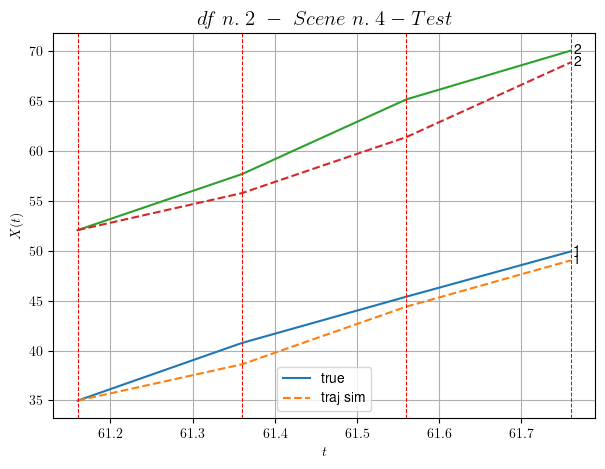

        For scene 4/63:
        * MSE = 3.2075680556337156
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.5/63


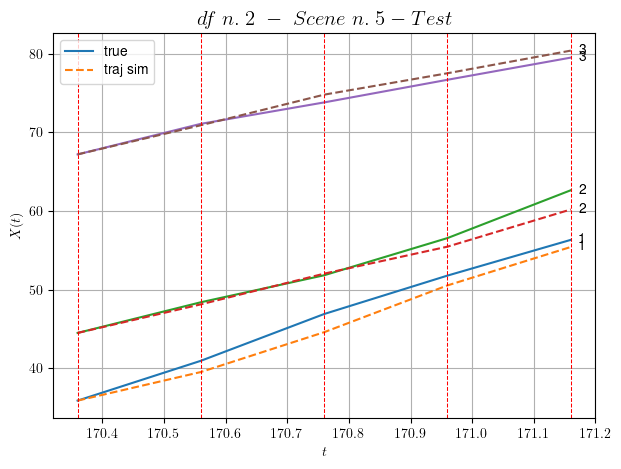

        For scene 5/63:
        * MSE = 1.3024850100452847
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.6/63


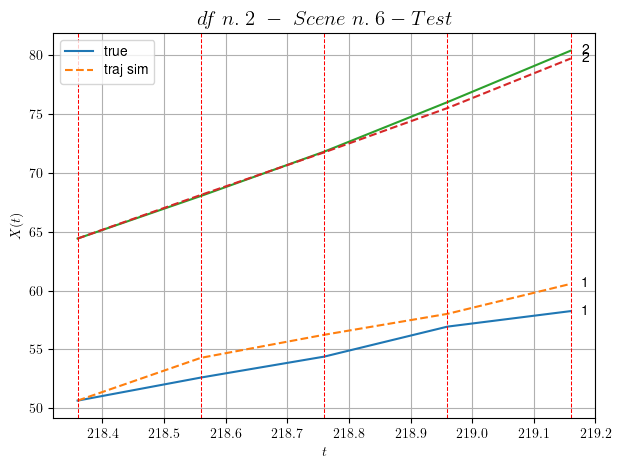

        For scene 6/63:
        * MSE = 1.352289175556022
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.7/63


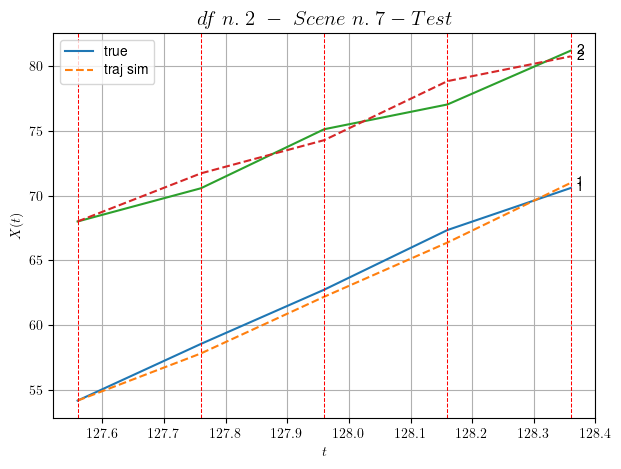

        For scene 7/63:
        * MSE = 0.7375992548060338
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.8/63


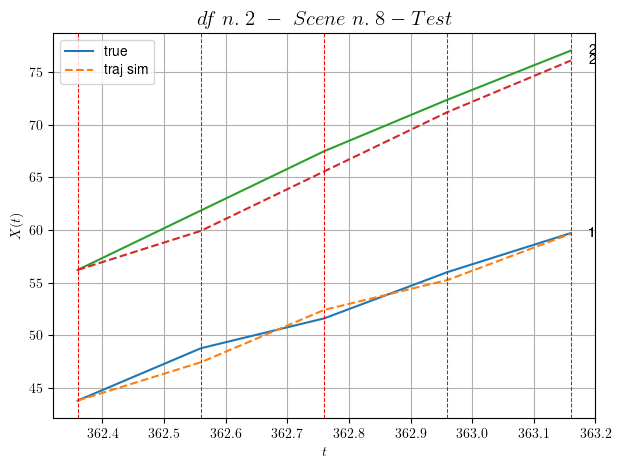

        For scene 8/63:
        * MSE = 1.2674271696635657
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.9/63


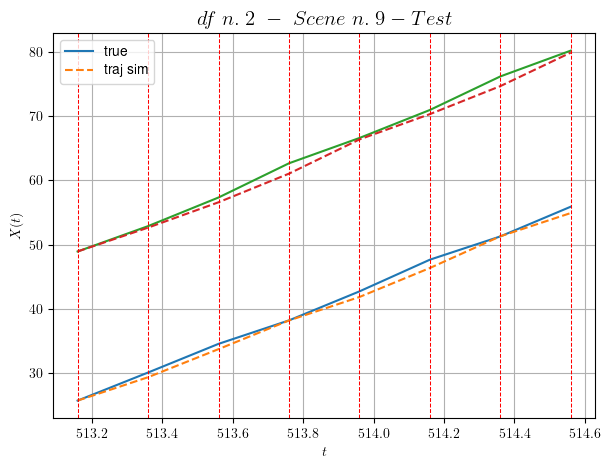

        For scene 9/63:
        * MSE = 0.6652363930944356
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.10/63


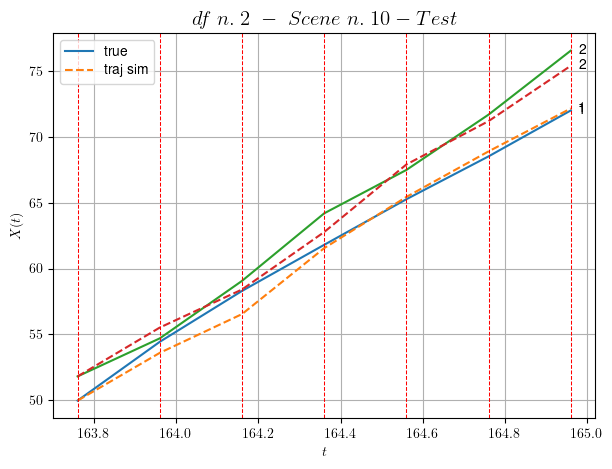

        For scene 10/63:
        * MSE = 0.6368418947176009
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.11/63


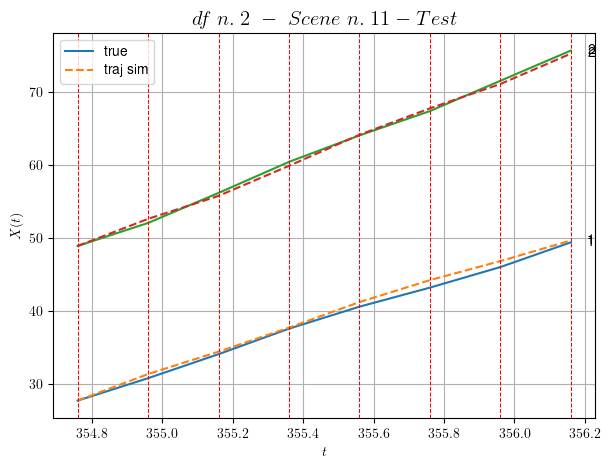

        For scene 11/63:
        * MSE = 0.2462368417251523
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.12/63


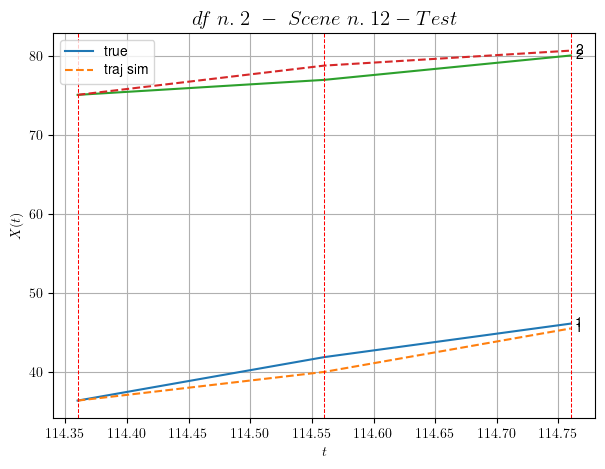

        For scene 12/63:
        * MSE = 1.2576297191350467
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.13/63


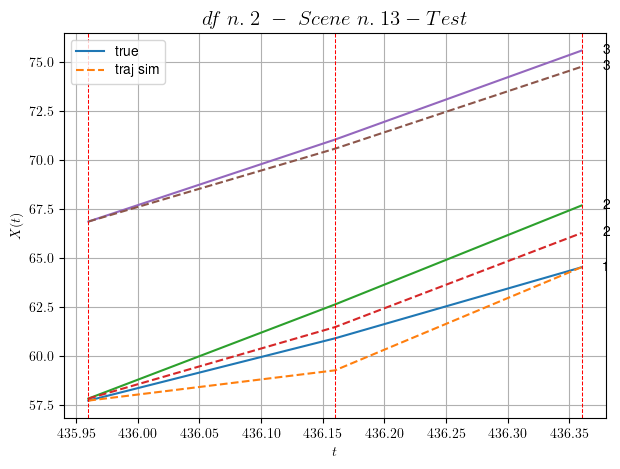

        For scene 13/63:
        * MSE = 0.7600385052097235
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.14/63


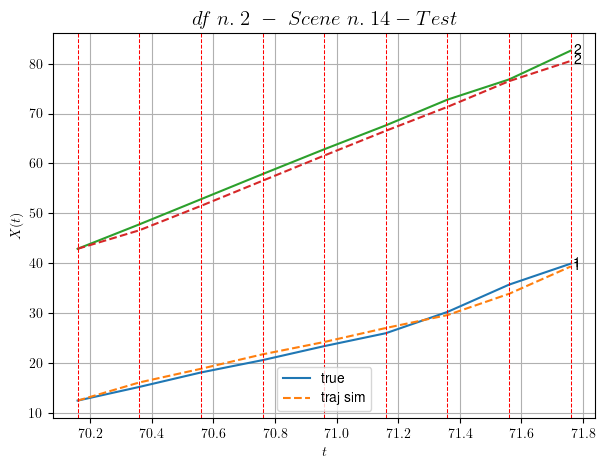

        For scene 14/63:
        * MSE = 1.267682804324854
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.15/63


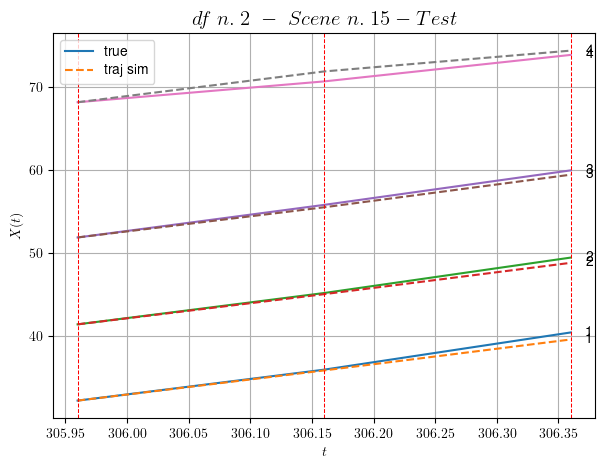

        For scene 15/63:
        * MSE = 0.2670346406060851
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.16/63


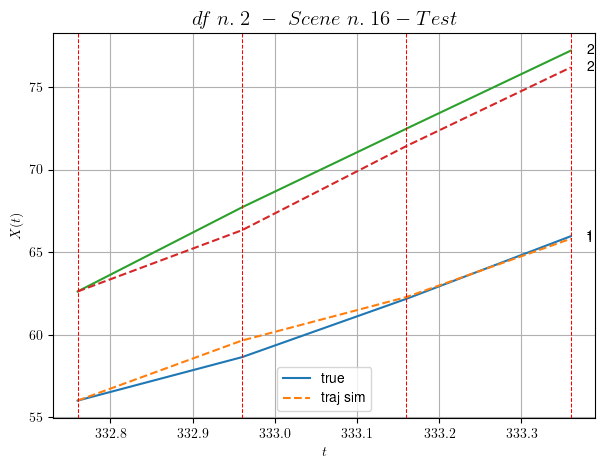

        For scene 16/63:
        * MSE = 0.6382402423876838
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.17/63


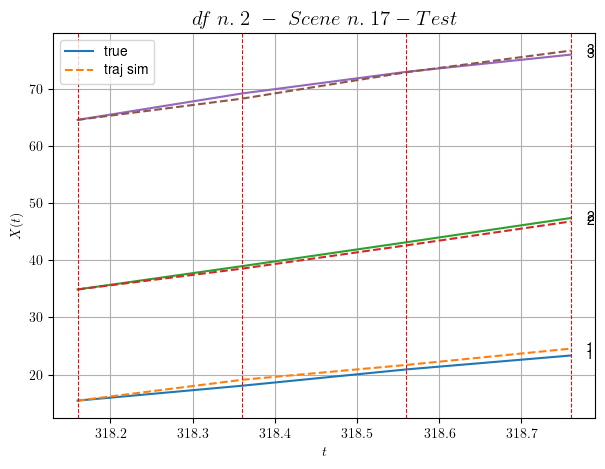

        For scene 17/63:
        * MSE = 0.44186033434713784
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.18/63


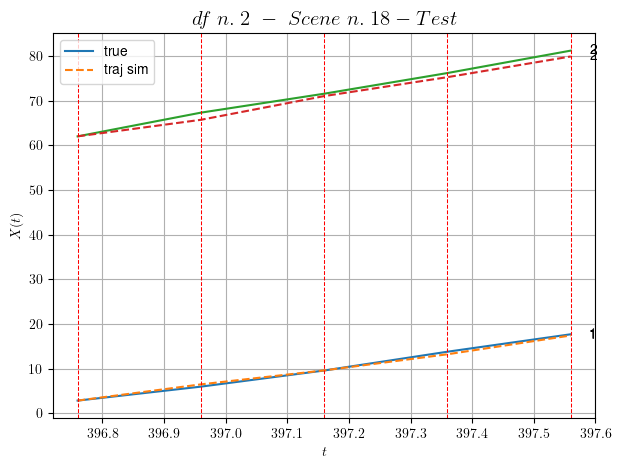

        For scene 18/63:
        * MSE = 0.6074928667677469
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.19/63


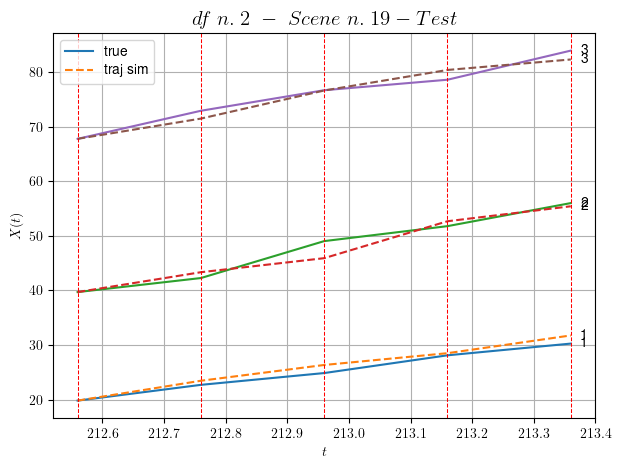

        For scene 19/63:
        * MSE = 1.6696750305282588
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.20/63


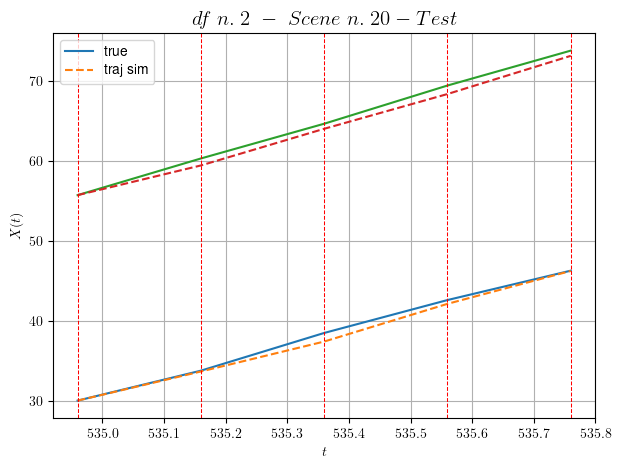

        For scene 20/63:
        * MSE = 0.4096794545809376
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.21/63


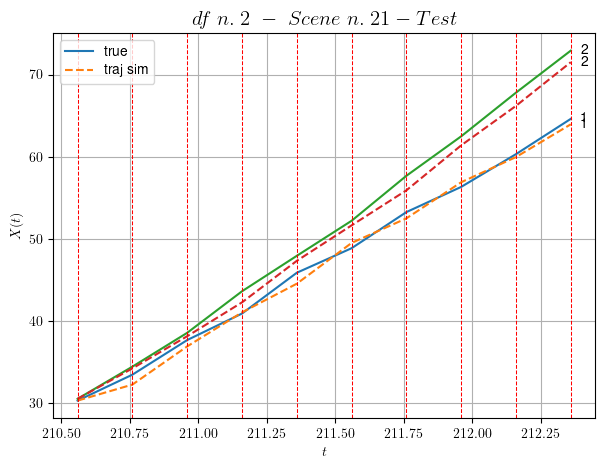

        For scene 21/63:
        * MSE = 0.8703061014775737
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.22/63


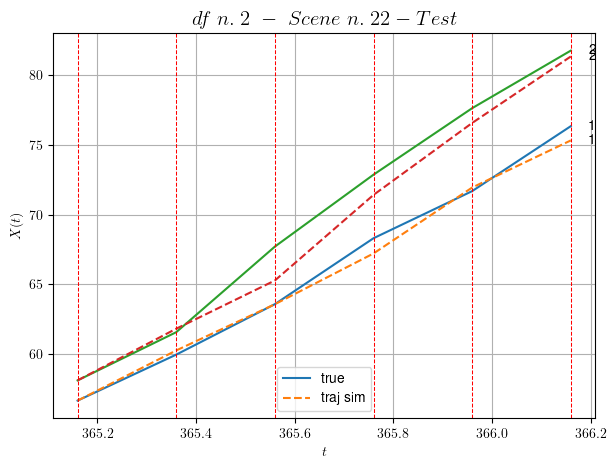

        For scene 22/63:
        * MSE = 0.982114450385051
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.23/63


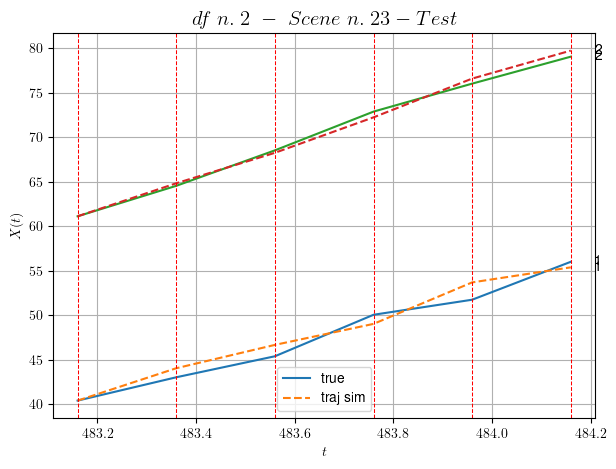

        For scene 23/63:
        * MSE = 0.7704739006252745
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.24/63


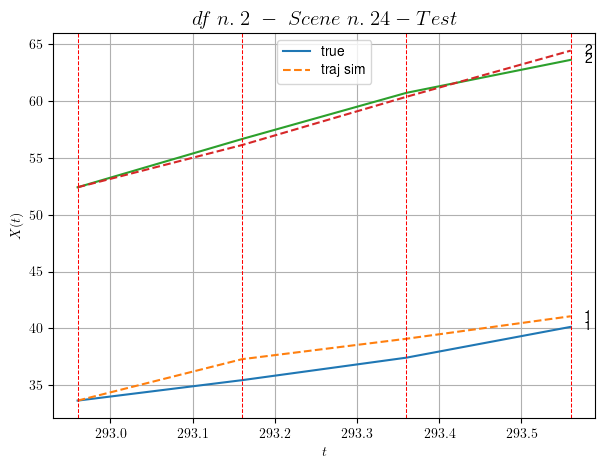

        For scene 24/63:
        * MSE = 1.009367227467084
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.25/63


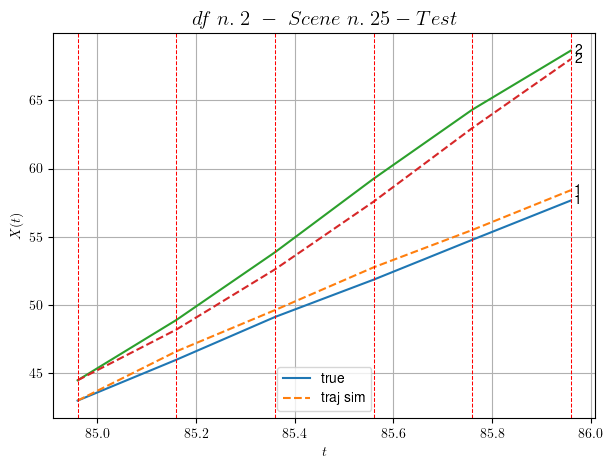

        For scene 25/63:
        * MSE = 0.8010617758513628
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.26/63


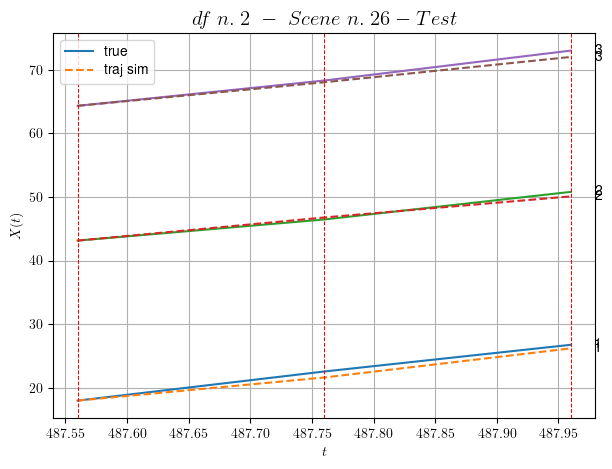

        For scene 26/63:
        * MSE = 0.31907559671861657
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.27/63


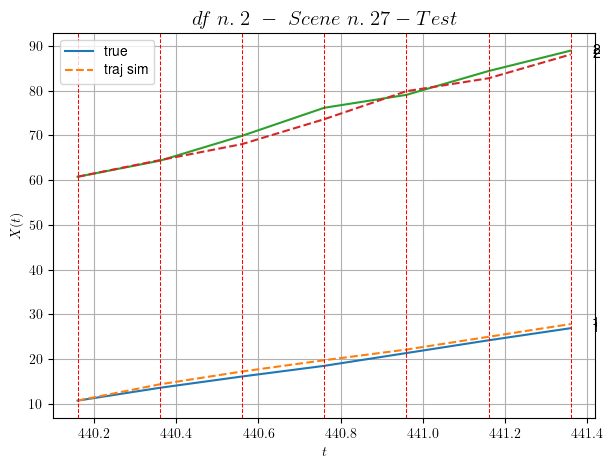

        For scene 27/63:
        * MSE = 1.3902353650745949
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.28/63


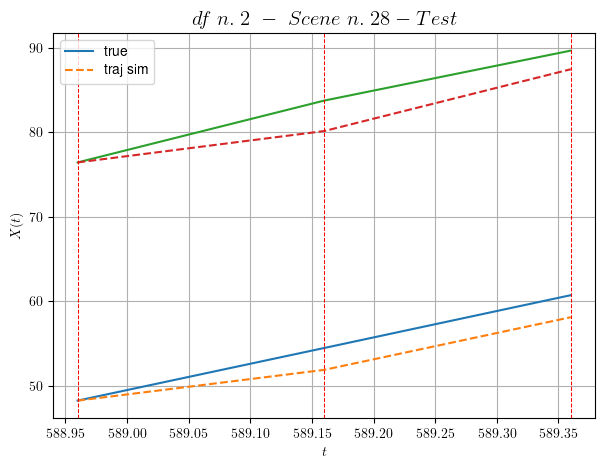

        For scene 28/63:
        * MSE = 5.219388265243093
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.29/63


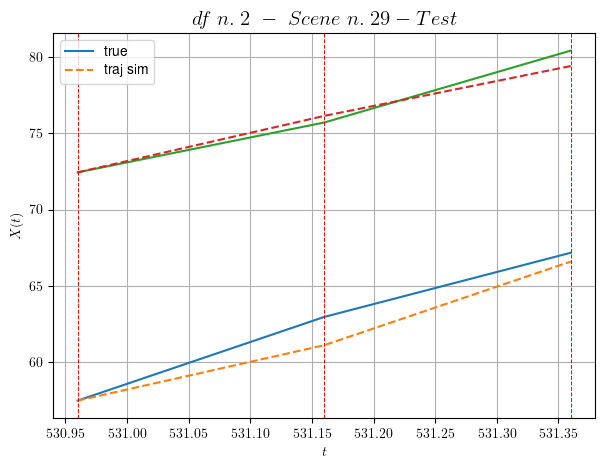

        For scene 29/63:
        * MSE = 0.8336386963560434
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.30/63


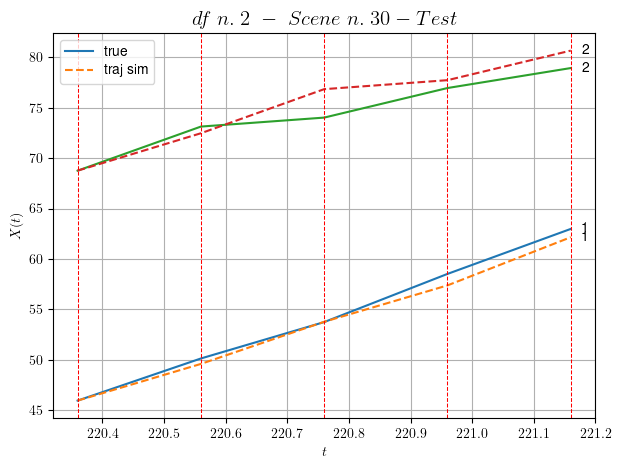

        For scene 30/63:
        * MSE = 1.4239983989196392
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.31/63


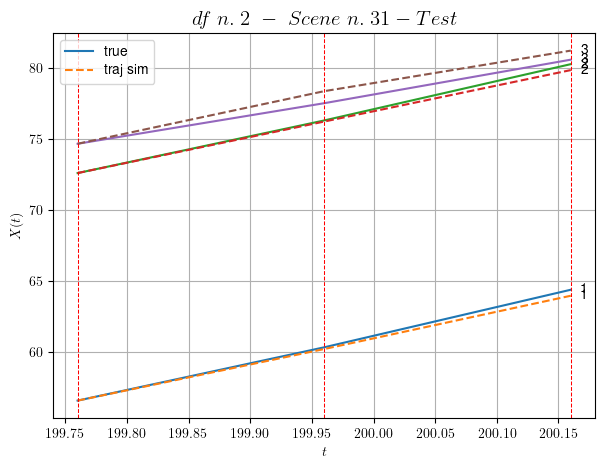

        For scene 31/63:
        * MSE = 0.16696093217214514
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.32/63


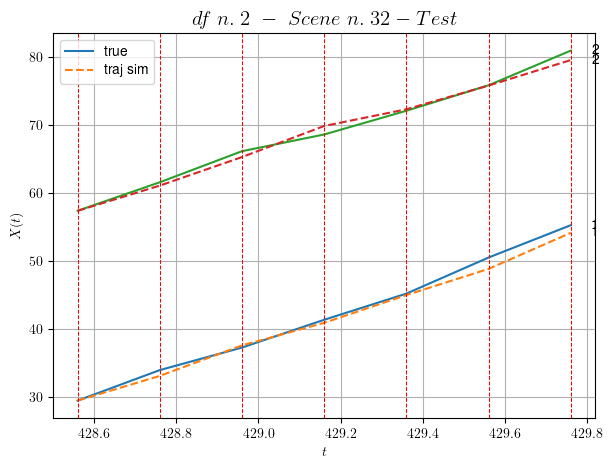

        For scene 32/63:
        * MSE = 0.6896792948890871
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.33/63


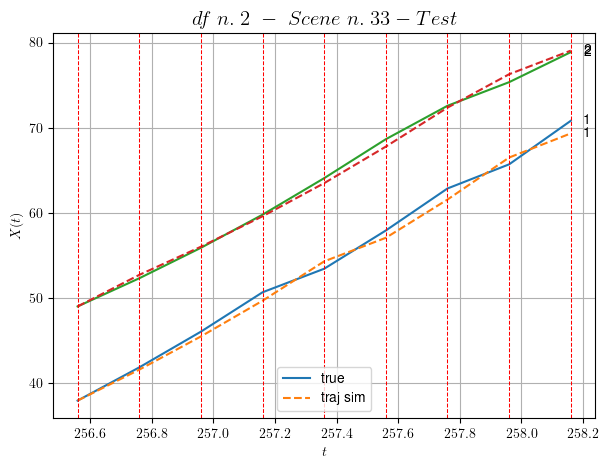

        For scene 33/63:
        * MSE = 0.5363910180024176
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.34/63


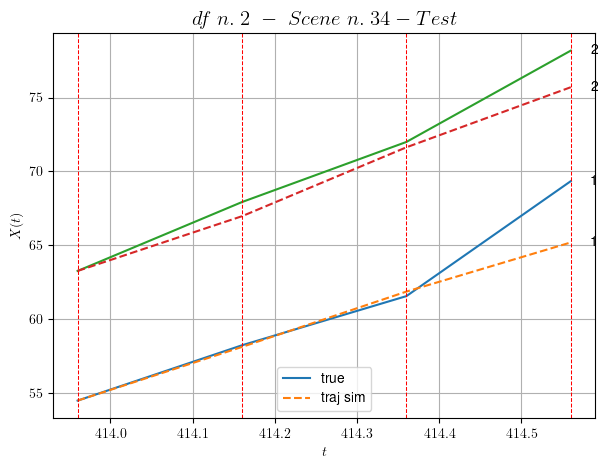

        For scene 34/63:
        * MSE = 3.0702639346265075
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.35/63


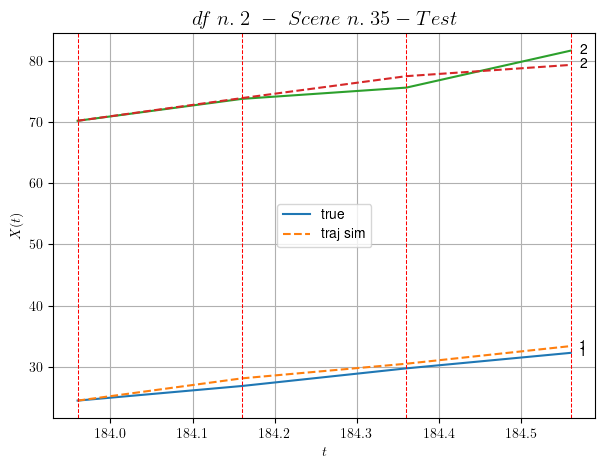

        For scene 35/63:
        * MSE = 1.537490055130227
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.36/63


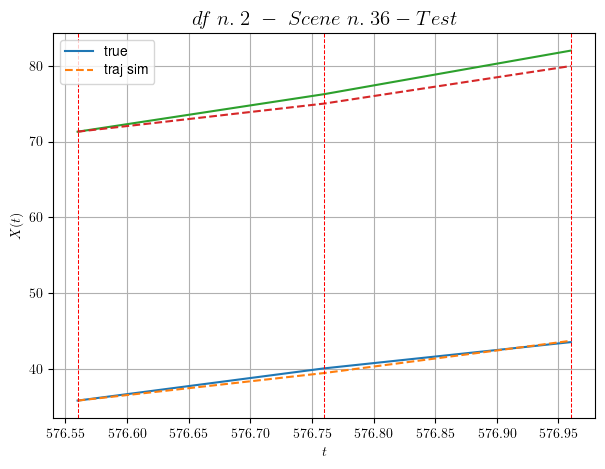

        For scene 36/63:
        * MSE = 1.0128978083179583
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.37/63


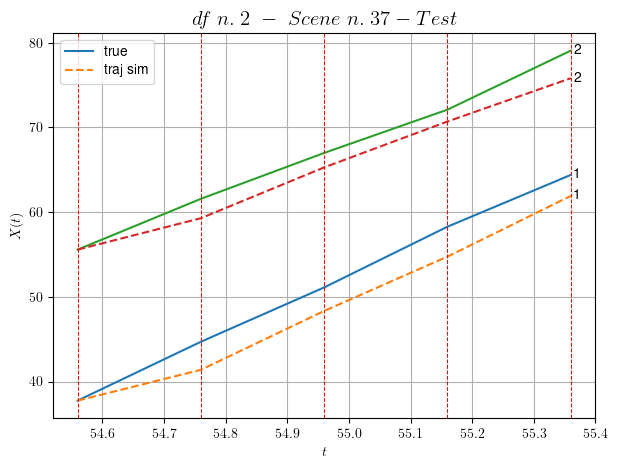

        For scene 37/63:
        * MSE = 5.799076687187776
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.38/63


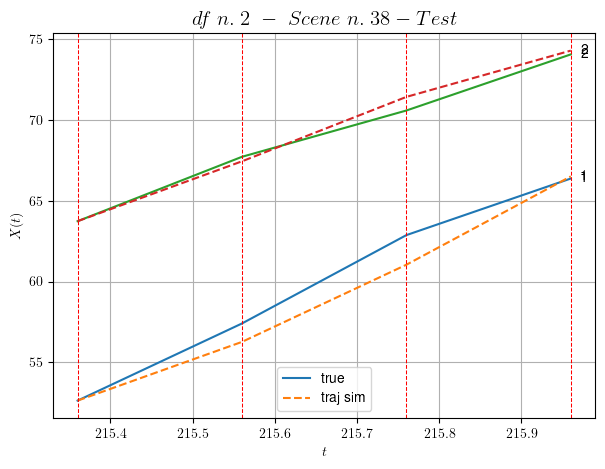

        For scene 38/63:
        * MSE = 0.6905457356352417
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.39/63


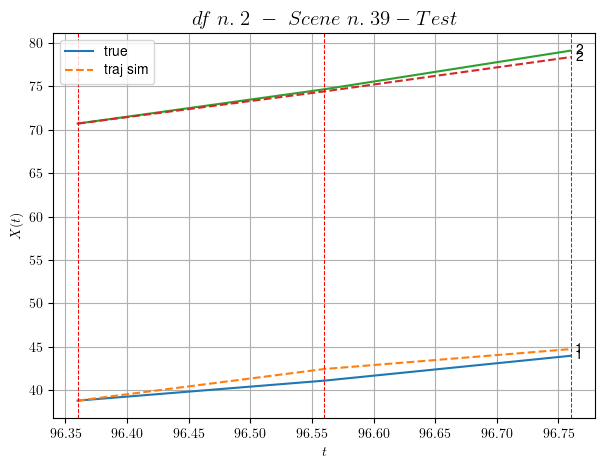

        For scene 39/63:
        * MSE = 0.5006115550236543
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.40/63


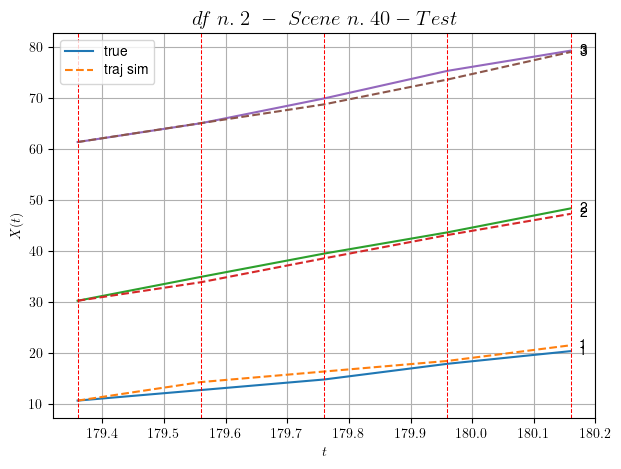

        For scene 40/63:
        * MSE = 0.9490961524489693
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.41/63


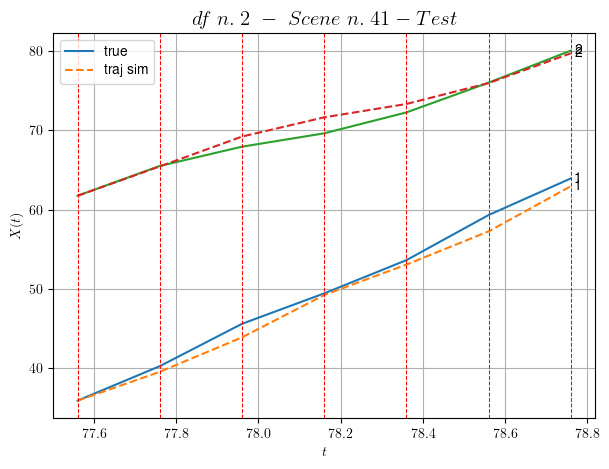

        For scene 41/63:
        * MSE = 1.1443627346192389
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.42/63


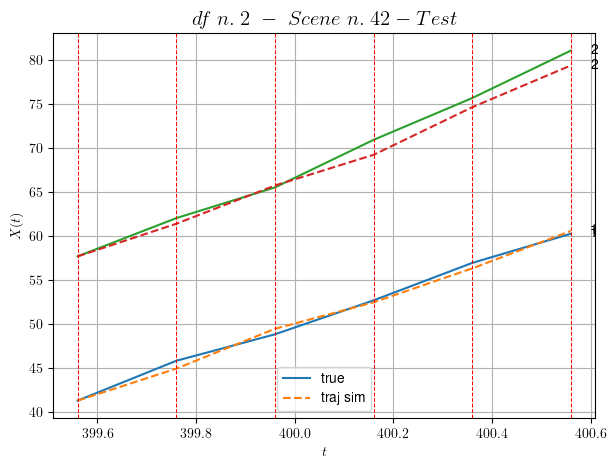

        For scene 42/63:
        * MSE = 0.7533073381274754
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.43/63


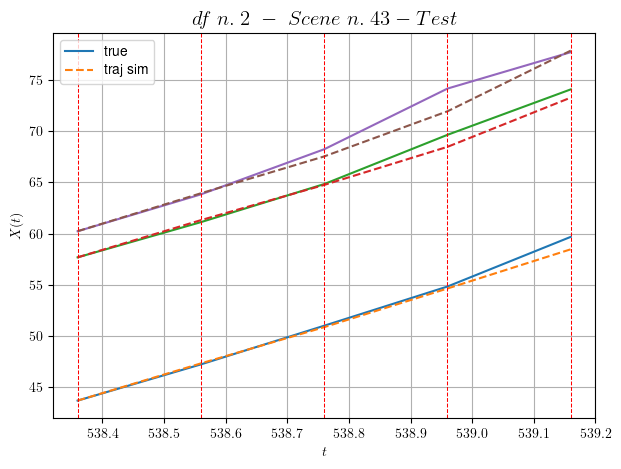

        For scene 43/63:
        * MSE = 0.6042738963009456
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.44/63


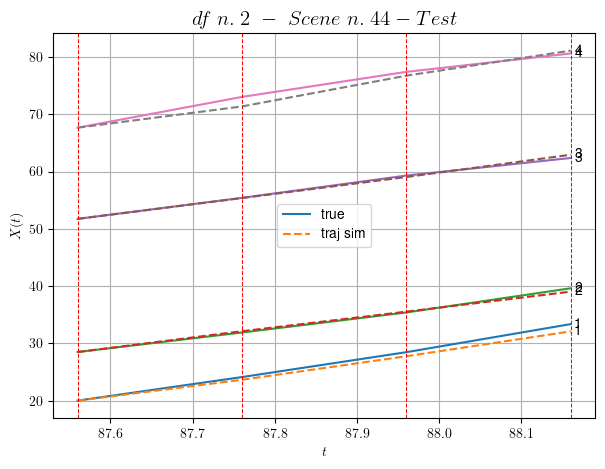

        For scene 44/63:
        * MSE = 0.4113912471381379
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.45/63


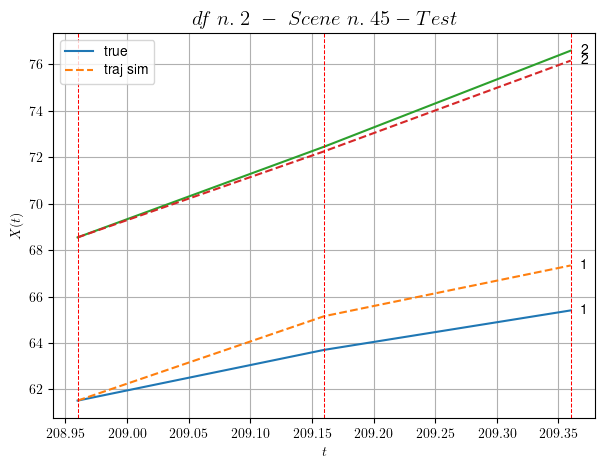

        For scene 45/63:
        * MSE = 1.0134758731199829
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.46/63


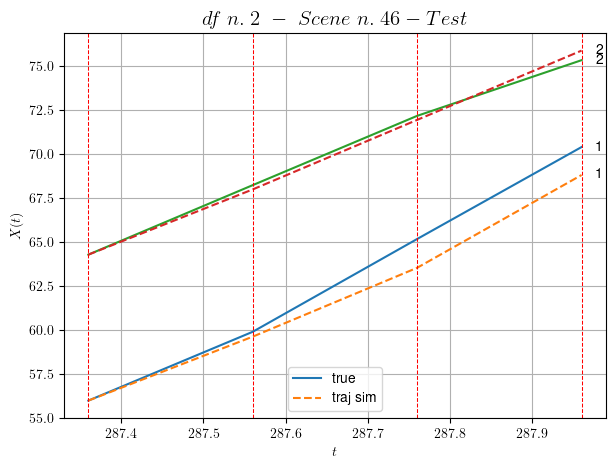

        For scene 46/63:
        * MSE = 0.7115846760389368
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.47/63


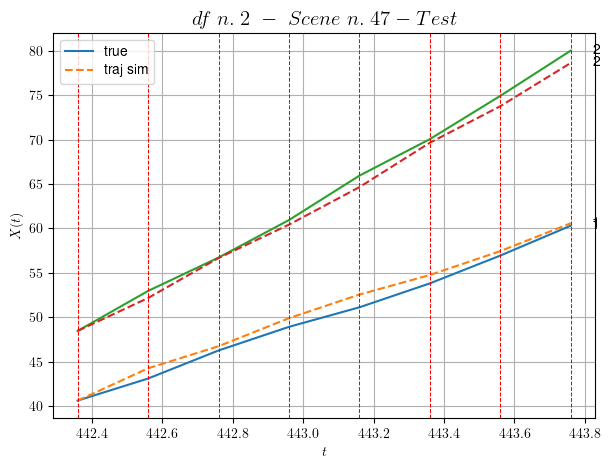

        For scene 47/63:
        * MSE = 0.7370095368081127
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.48/63


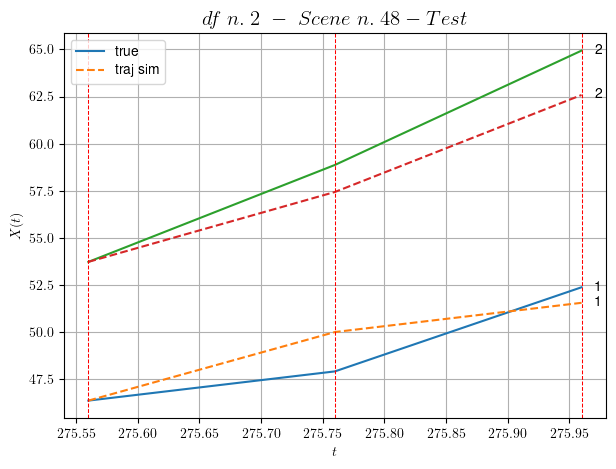

        For scene 48/63:
        * MSE = 2.104780888445635
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.49/63


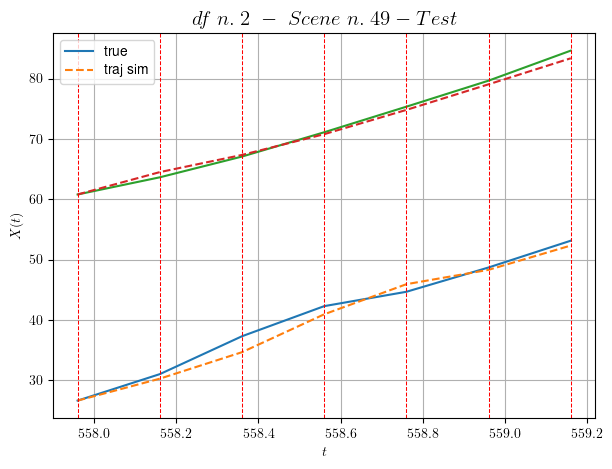

        For scene 49/63:
        * MSE = 1.0675078256423691
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.50/63


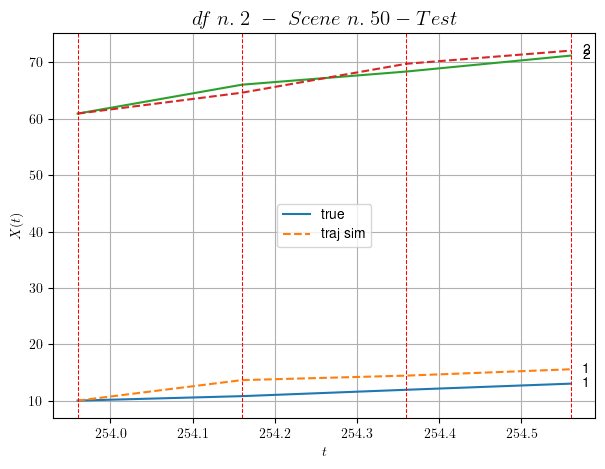

        For scene 50/63:
        * MSE = 3.1960568326096017
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.51/63


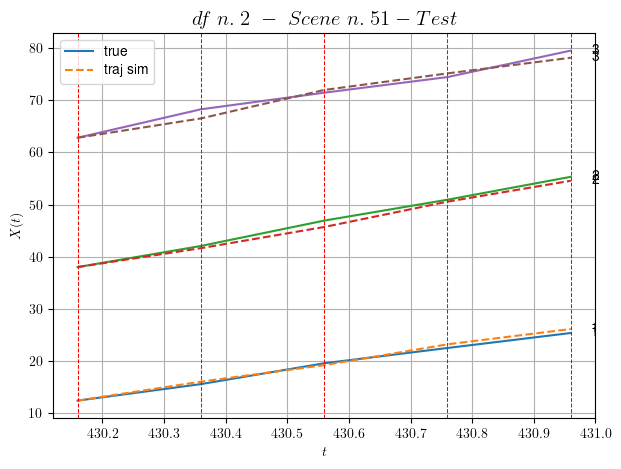

        For scene 51/63:
        * MSE = 0.6353732940125919
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.52/63


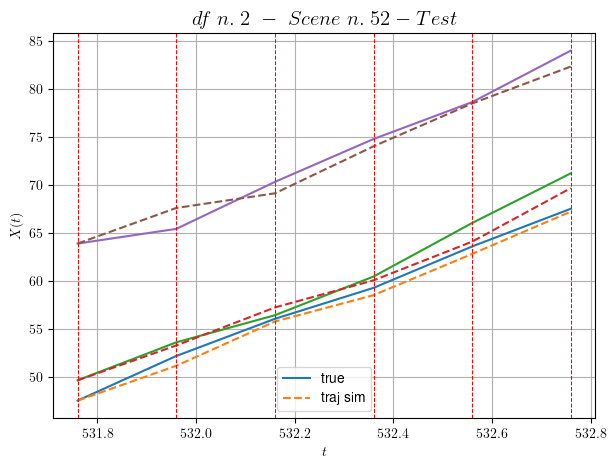

        For scene 52/63:
        * MSE = 1.0559105785845677
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.53/63


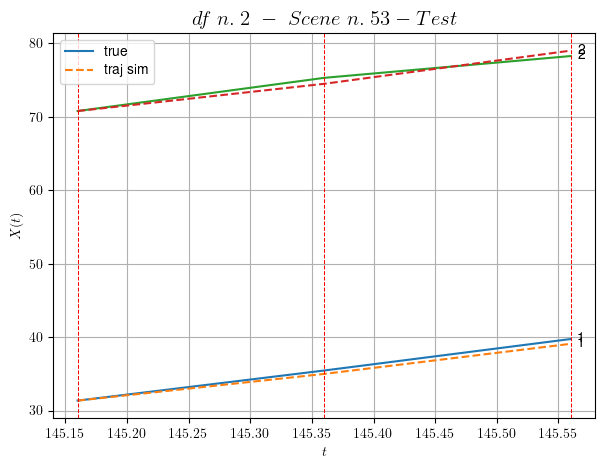

        For scene 53/63:
        * MSE = 0.3075156585104599
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.54/63


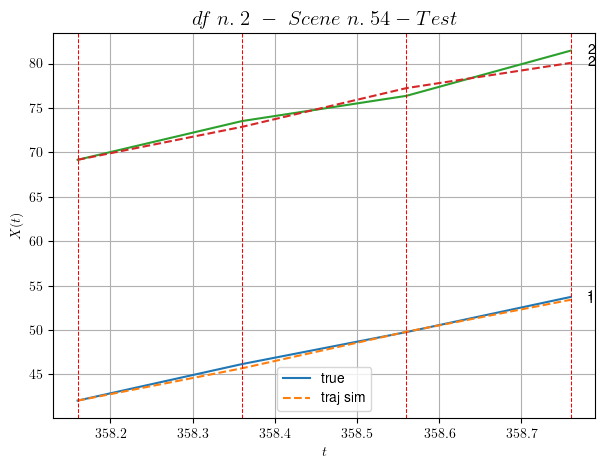

        For scene 54/63:
        * MSE = 0.4271709787996585
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.55/63


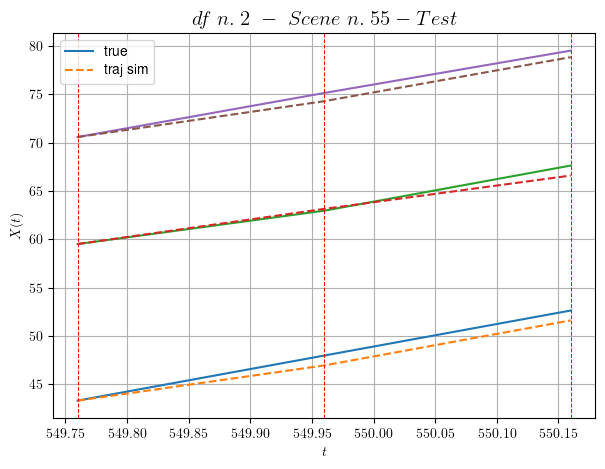

        For scene 55/63:
        * MSE = 0.4857221796723727
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.56/63


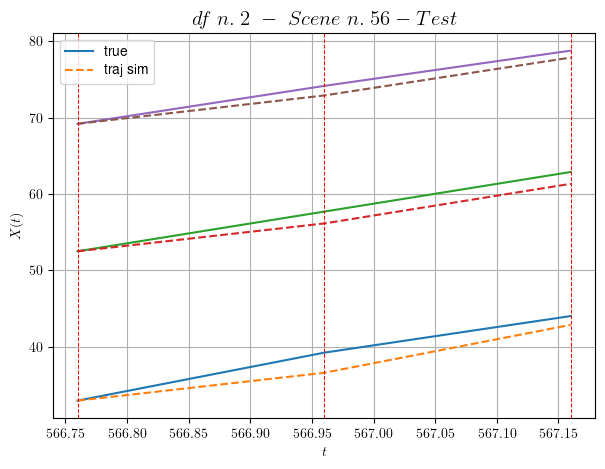

        For scene 56/63:
        * MSE = 1.7158875236464055
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.57/63


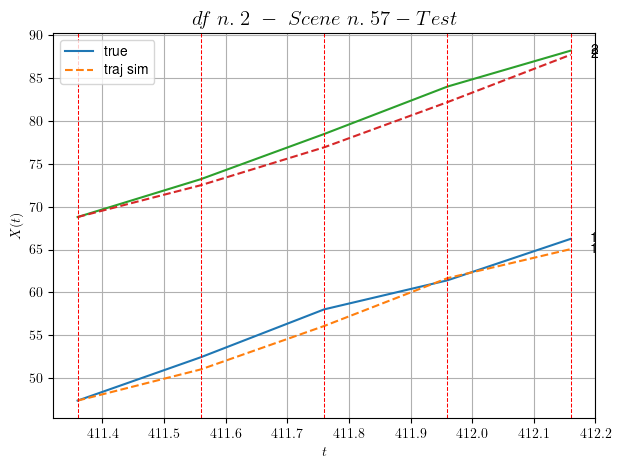

        For scene 57/63:
        * MSE = 1.3683789472947092
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.58/63


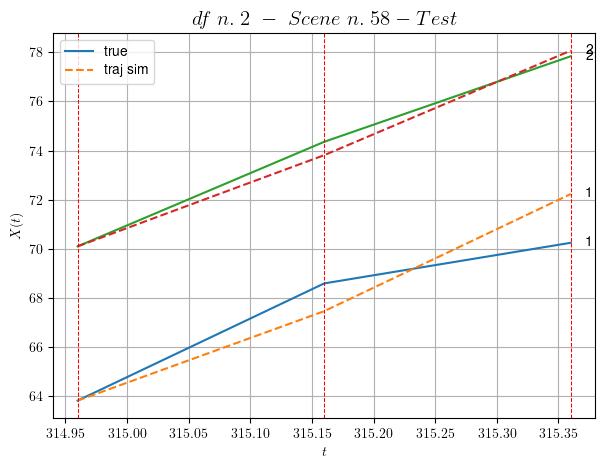

        For scene 58/63:
        * MSE = 0.9269487993707861
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.59/63


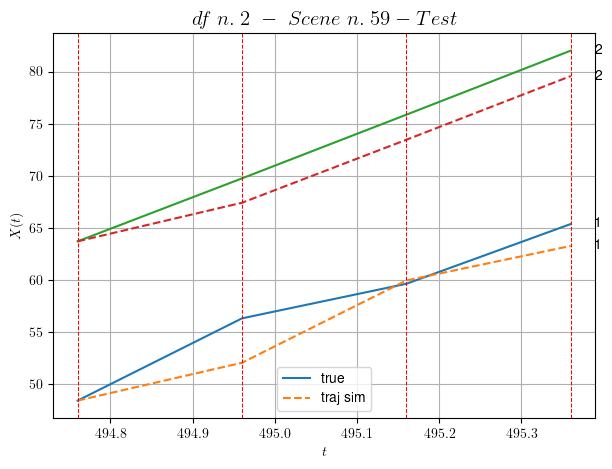

        For scene 59/63:
        * MSE = 4.993188377376589
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.60/63


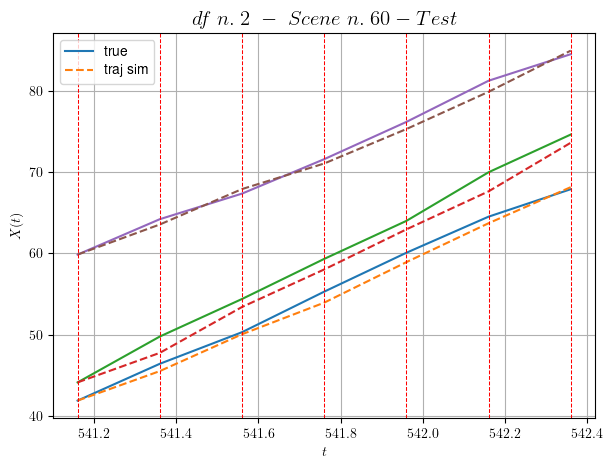

        For scene 60/63:
        * MSE = 1.0929728042260558
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.61/63


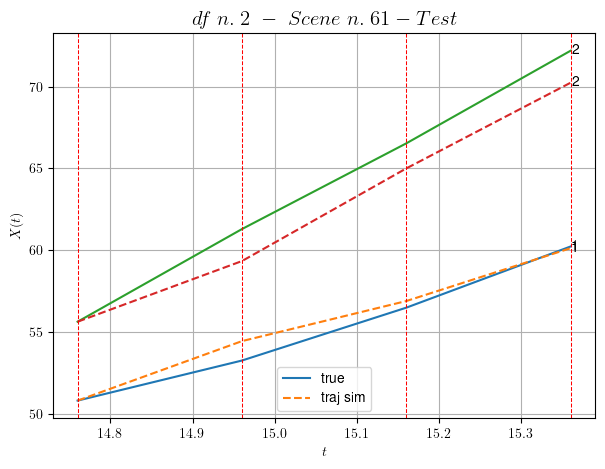

        For scene 61/63:
        * MSE = 1.4472720074790417
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.62/63


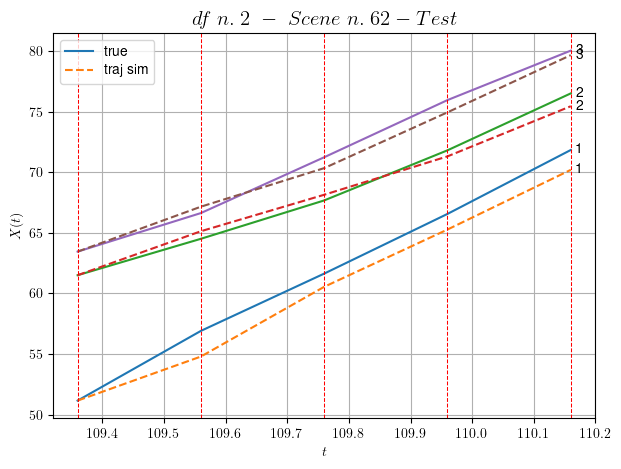

        For scene 62/63:
        * MSE = 0.9500241416498468
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.63/63


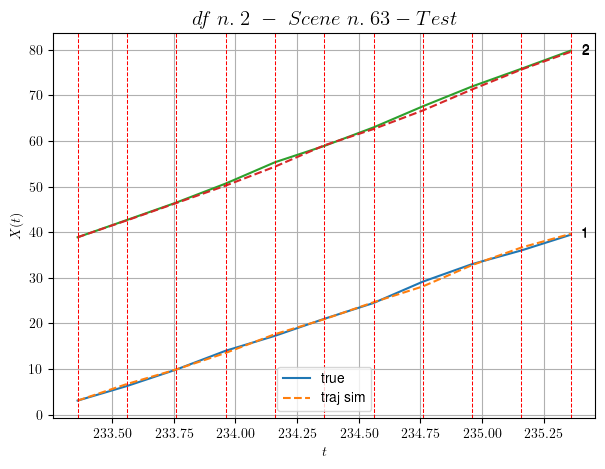

        For scene 63/63:
        * MSE = 0.21949111457281667
----------------------------------------------------------------------------------------------------


MSE test: 1.2417486419420818

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 1.0490983425209257
          * MSE test: 1.2417486419420818
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 3/10 dfs.
In DataFrame n.3 we have 90 scenes.
    To train the model we use 9 scenes, the remaining 81 to test the model.

Training step. (9 scenes)
DataFrame n.3. Scene n.1/9
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [436.16,437.56]


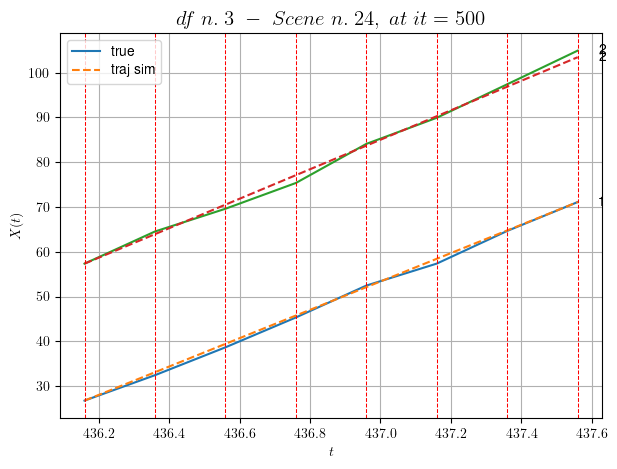

----------------------------------------------------------------------------------------------------
        For scene 1/9:
        * After LR finder: LR_NN=5e-05 with mse=4.084357141932415 at it=24
        * v0 = 32.92393930276486
        * MSE = 0.5646031710560512
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.2/9
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [170.36,170.76]


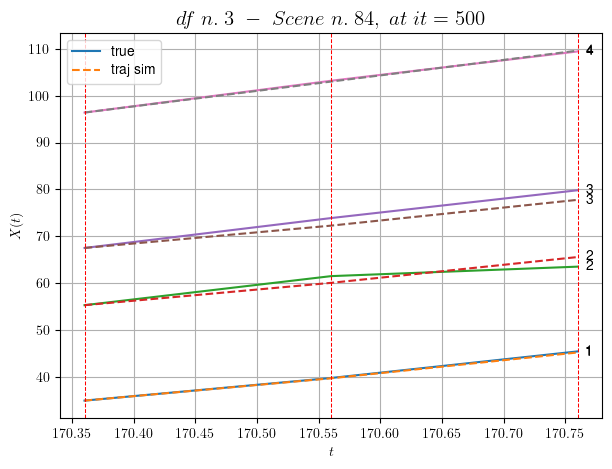

----------------------------------------------------------------------------------------------------
        For scene 2/9:
        * After LR finder: LR_NN=0.01 with mse=1.6113122772052768 at it=24
        * v0 = 32.99653993565754
        * MSE = 1.090762499512537
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.3/9
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [579.56,580.56]


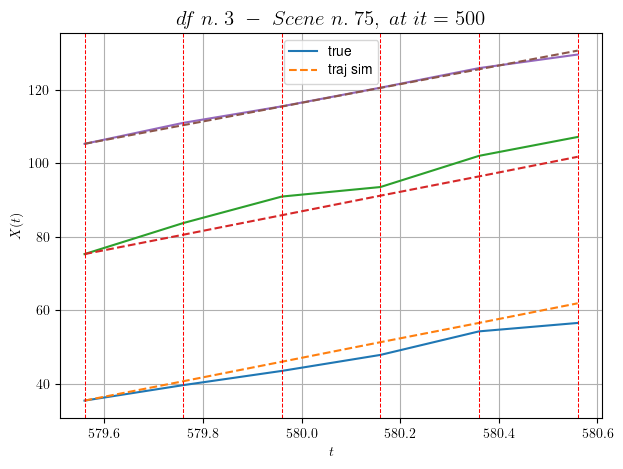

----------------------------------------------------------------------------------------------------
        For scene 3/9:
        * After LR finder: LR_NN=0.001 with mse=11.770788679867481 at it=24
        * v0 = 25.358404463470897
        * MSE = 8.690632128827822
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.4/9
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [142.16,142.76]


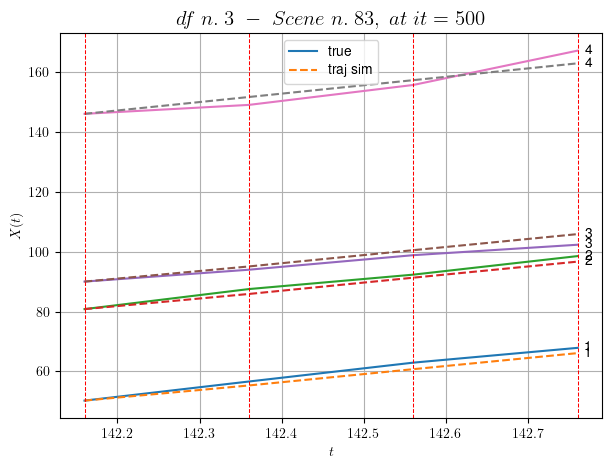

----------------------------------------------------------------------------------------------------
        For scene 4/9:
        * After LR finder: LR_NN=0.01 with mse=3.7203903028770124 at it=24
        * v0 = 28.121237748537503
        * MSE = 3.539235285221033
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.5/9
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [417.16,418.16]


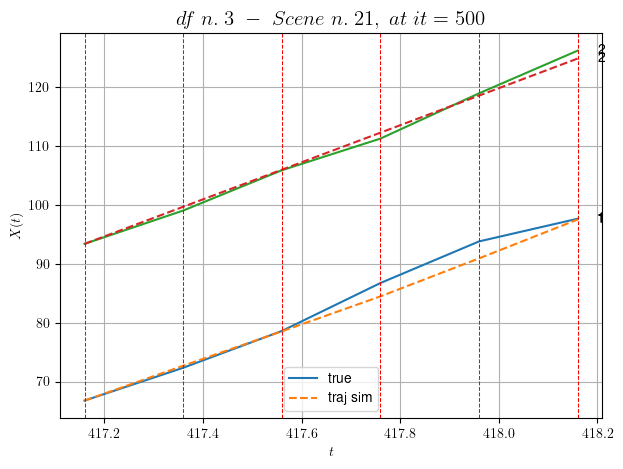

----------------------------------------------------------------------------------------------------
        For scene 5/9:
        * After LR finder: LR_NN=0.005 with mse=3.485020995080154 at it=24
        * v0 = 31.44799012371589
        * MSE = 1.3428611739819882
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.6/9
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [387.36,388.16]


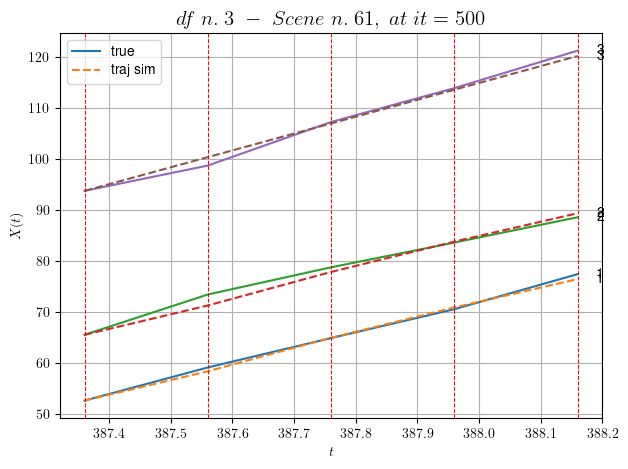

----------------------------------------------------------------------------------------------------
        For scene 6/9:
        * After LR finder: LR_NN=0.01 with mse=1.8290678397744073 at it=24
        * v0 = 33.03189808825561
        * MSE = 0.753867772838078
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.7/9
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [527.36,528.16]


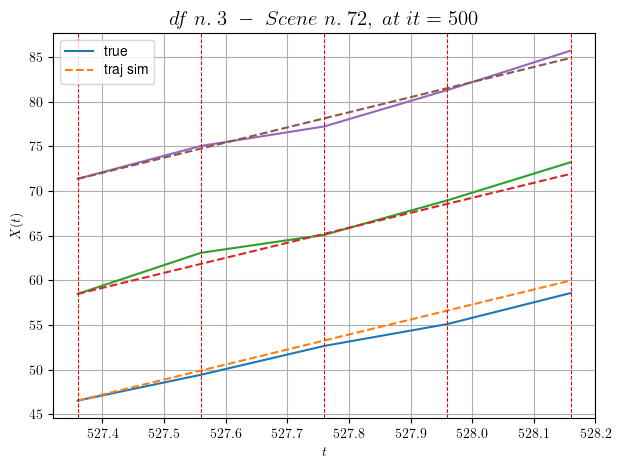

----------------------------------------------------------------------------------------------------
        For scene 7/9:
        * After LR finder: LR_NN=5e-05 with mse=14.097080456762702 at it=24
        * v0 = 16.920906022776112
        * MSE = 0.6569663786895948
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.8/9
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [299.76,300.56]


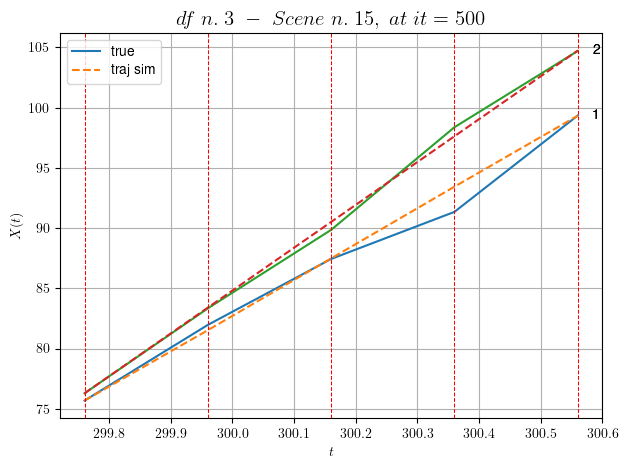

----------------------------------------------------------------------------------------------------
        For scene 8/9:
        * After LR finder: LR_NN=0.0005 with mse=4.7141916154150785 at it=24
        * v0 = 35.55620181997074
        * MSE = 0.5509137280821444
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.9/9
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [218.16,219.16]


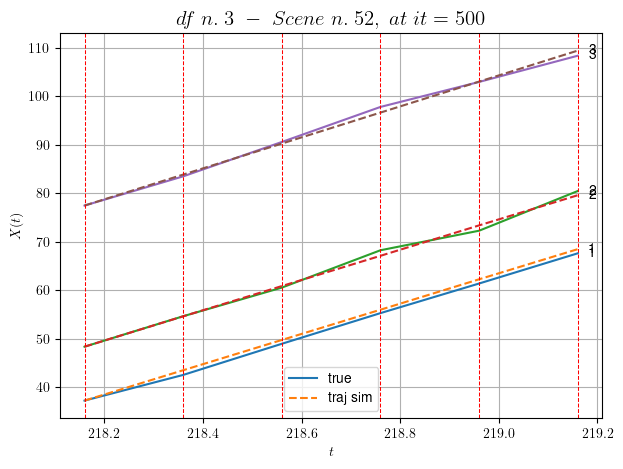

----------------------------------------------------------------------------------------------------
        For scene 9/9:
        * After LR finder: LR_NN=0.001 with mse=0.8774007505113254 at it=24
        * v0 = 31.946925583263187
        * MSE = 0.5314497652816217
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 1.969032433721208
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (81 scenes)
DataFrame n.3. Scene n.1/81


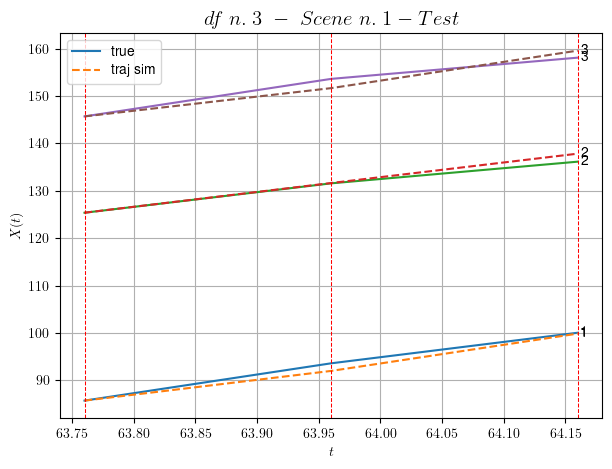

        For scene 1/81:
        * MSE = 1.2755950930912385
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.2/81


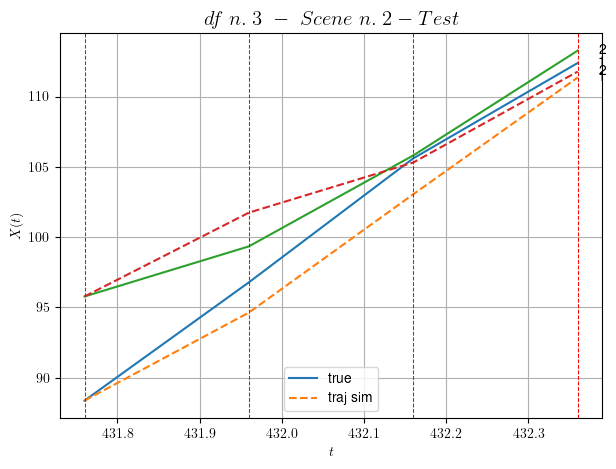

        For scene 2/81:
        * MSE = 2.5506392758899477
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.3/81


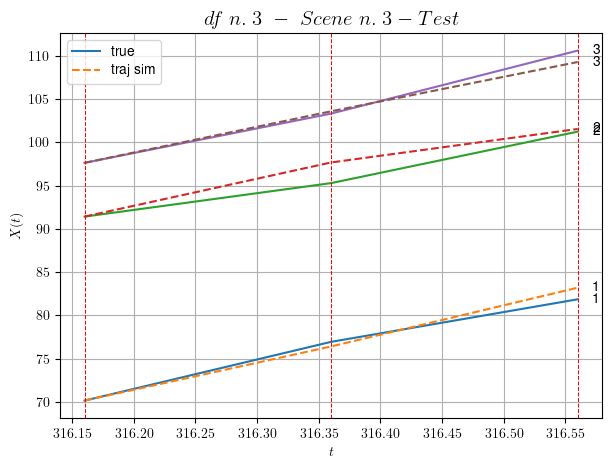

        For scene 3/81:
        * MSE = 1.0765808748114045
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.4/81


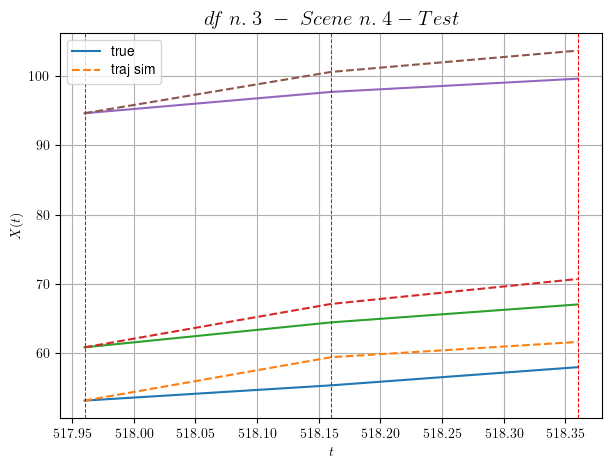

        For scene 4/81:
        * MSE = 8.340515753141657
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.5/81


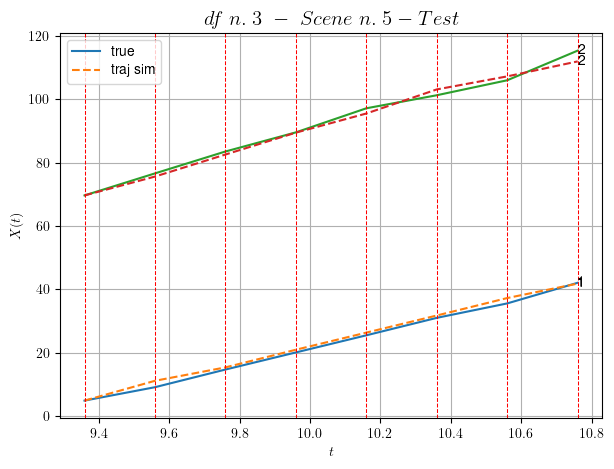

        For scene 5/81:
        * MSE = 1.9165367652284377
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.6/81


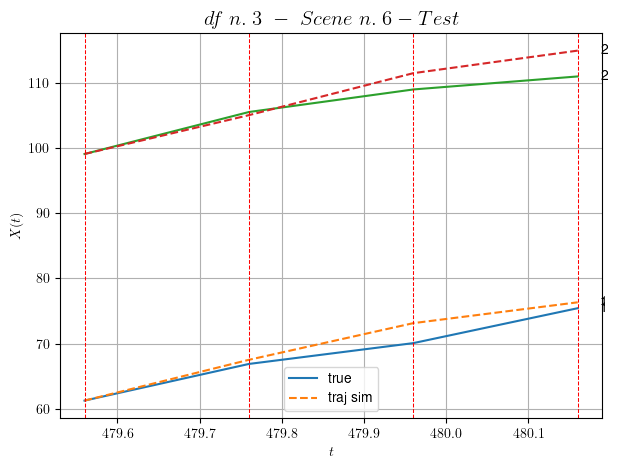

        For scene 6/81:
        * MSE = 4.100515891941699
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.7/81


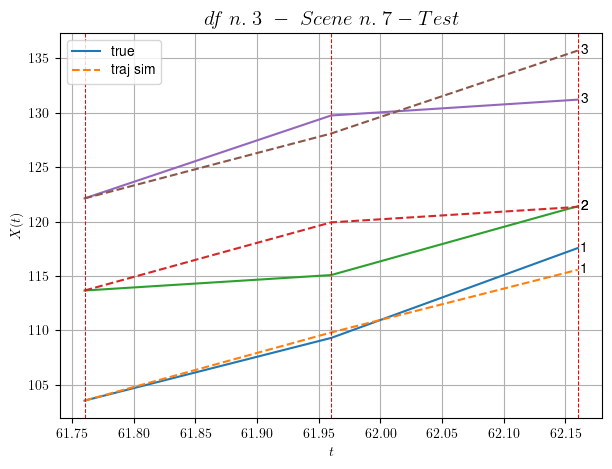

        For scene 7/81:
        * MSE = 5.639276154209867
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.8/81


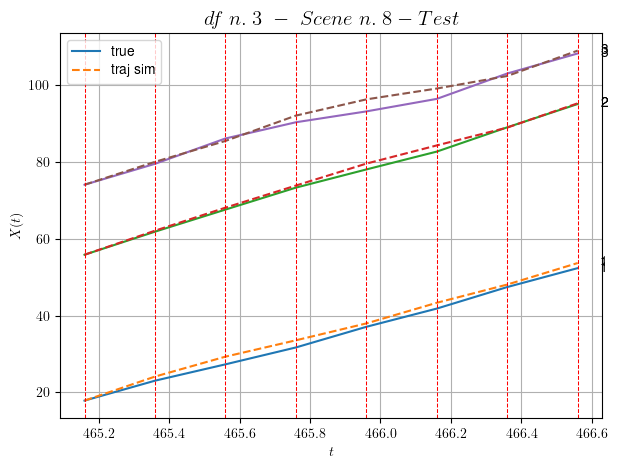

        For scene 8/81:
        * MSE = 1.7170562907424067
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.9/81


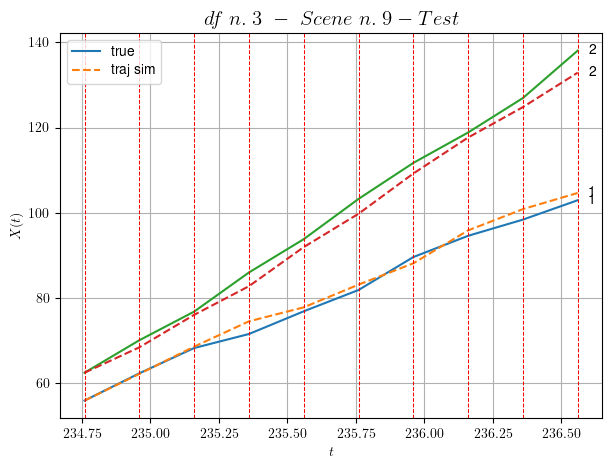

        For scene 9/81:
        * MSE = 4.615580270617255
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.10/81


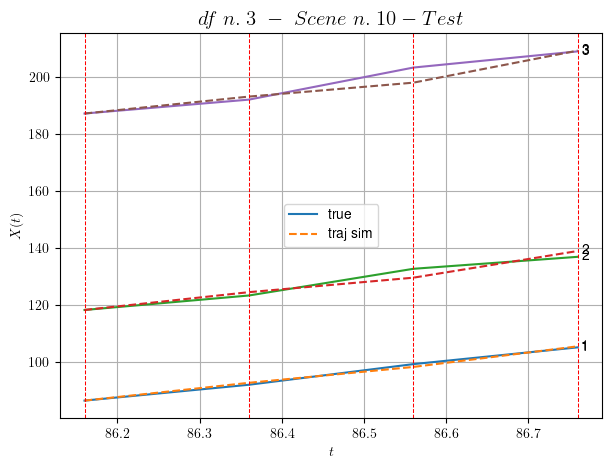

        For scene 10/81:
        * MSE = 3.8584220457947516
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.11/81


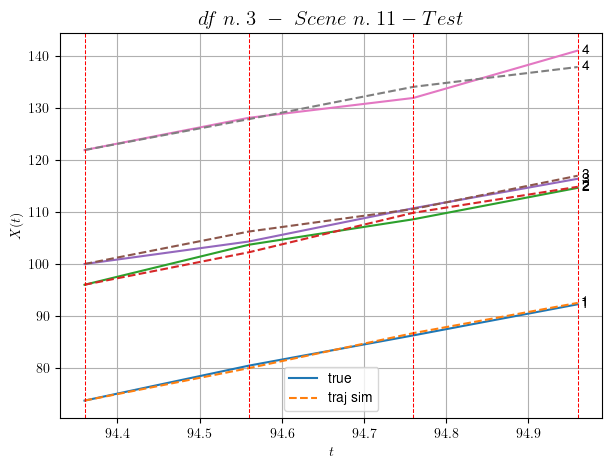

        For scene 11/81:
        * MSE = 1.4327152120783766
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.12/81


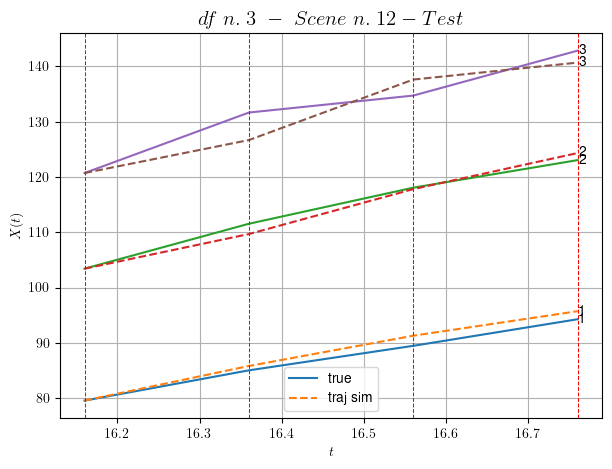

        For scene 12/81:
        * MSE = 4.086902366551368
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.13/81


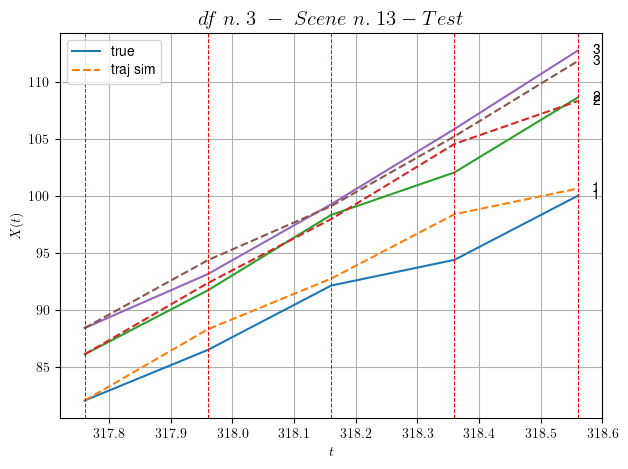

        For scene 13/81:
        * MSE = 1.9852942253392332
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.14/81


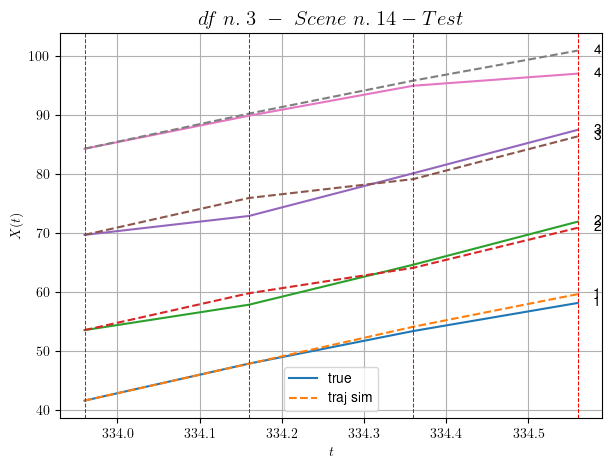

        For scene 14/81:
        * MSE = 2.2264131477317997
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.15/81


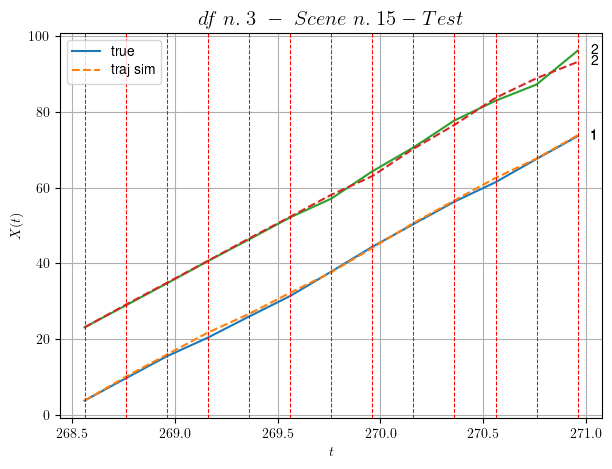

        For scene 15/81:
        * MSE = 0.8255788906315957
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.16/81


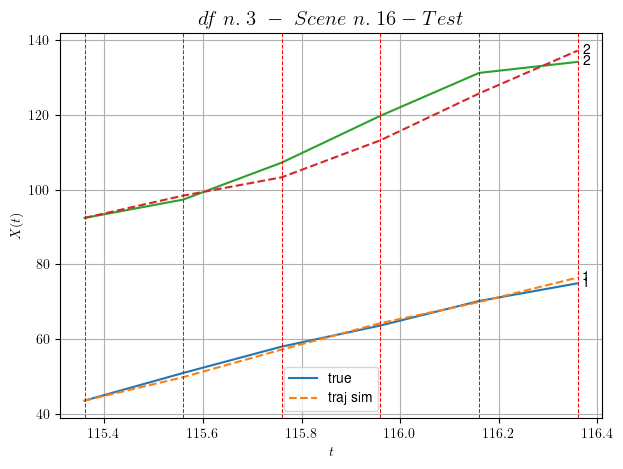

        For scene 16/81:
        * MSE = 8.602056843436234
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.17/81


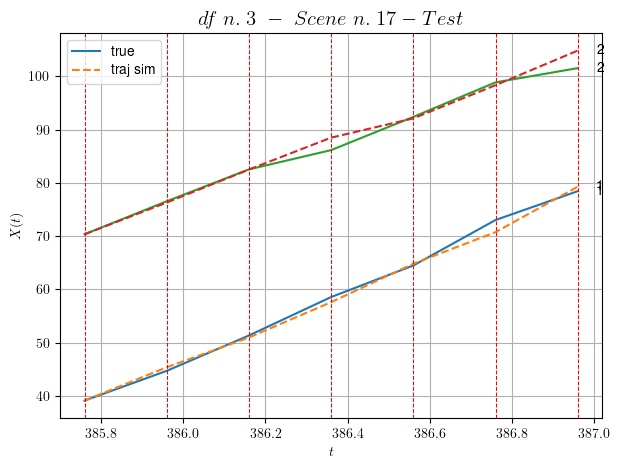

        For scene 17/81:
        * MSE = 1.7336771619216589
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.18/81


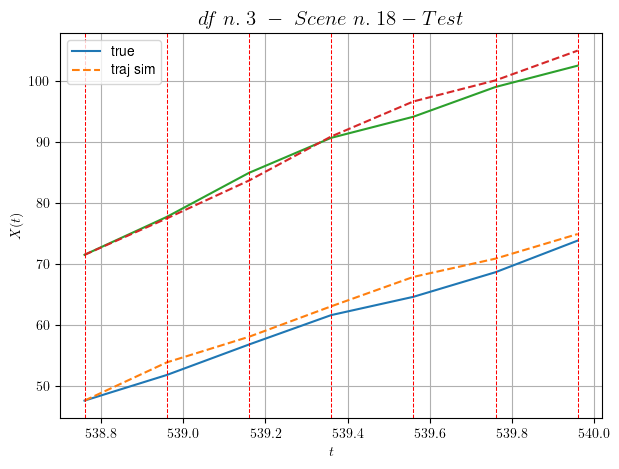

        For scene 18/81:
        * MSE = 2.8508489109273483
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.19/81


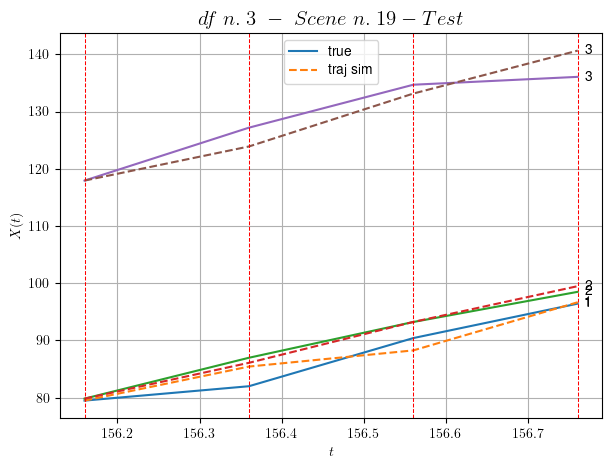

        For scene 19/81:
        * MSE = 4.373137015659079
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.20/81


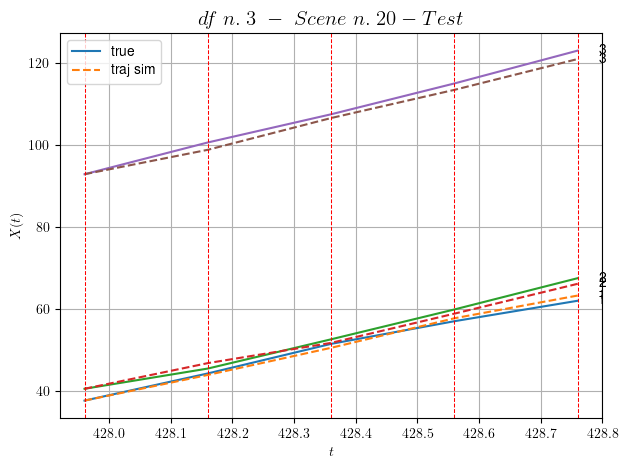

        For scene 20/81:
        * MSE = 1.288136495501918
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.21/81


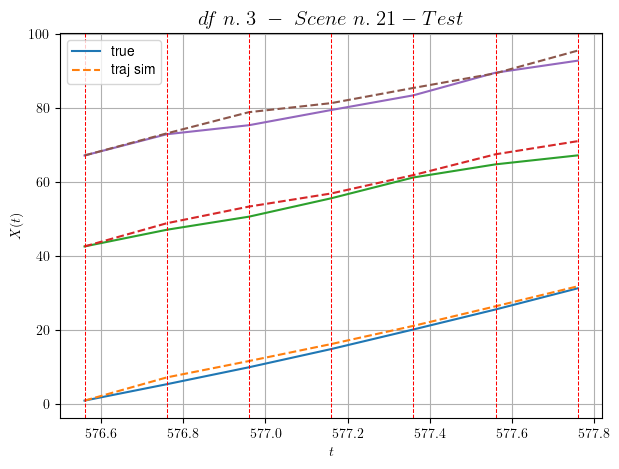

        For scene 21/81:
        * MSE = 3.4308360796346586
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.22/81


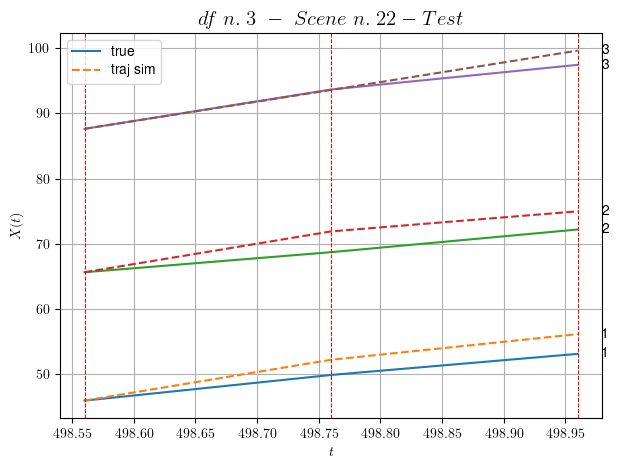

        For scene 22/81:
        * MSE = 4.141019309448853
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.23/81


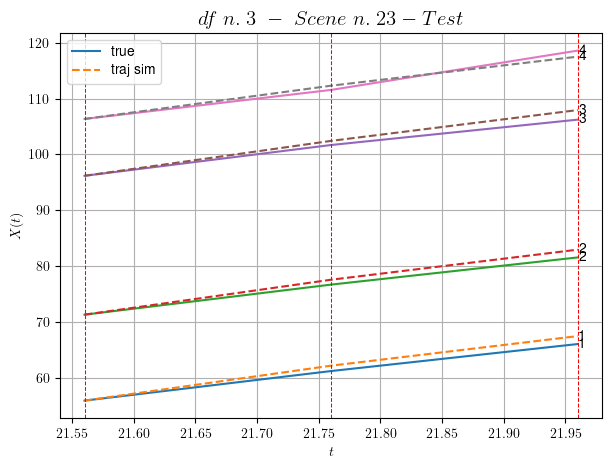

        For scene 23/81:
        * MSE = 0.9079107843528198
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.24/81


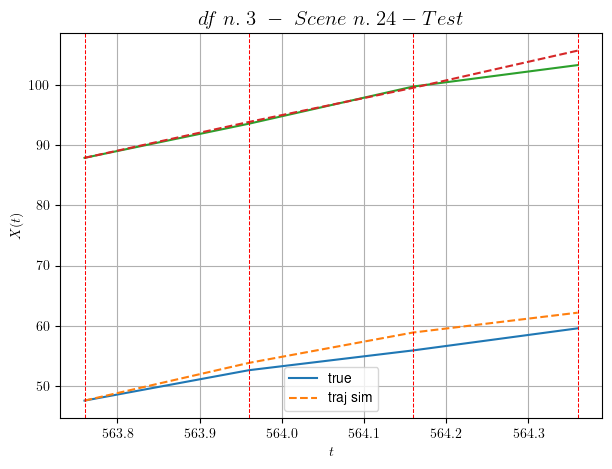

        For scene 24/81:
        * MSE = 2.871994818122192
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.25/81


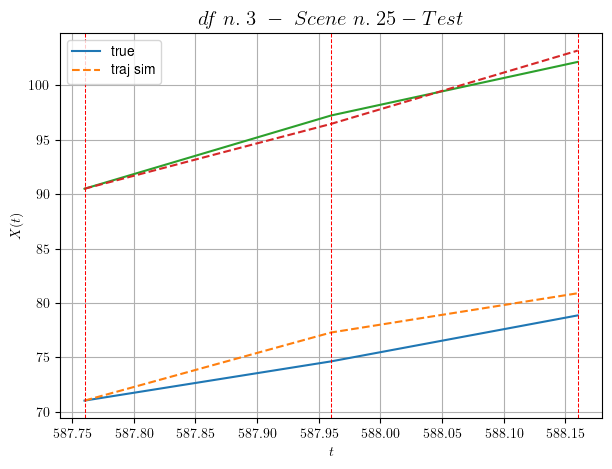

        For scene 25/81:
        * MSE = 2.1455359775767184
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.26/81


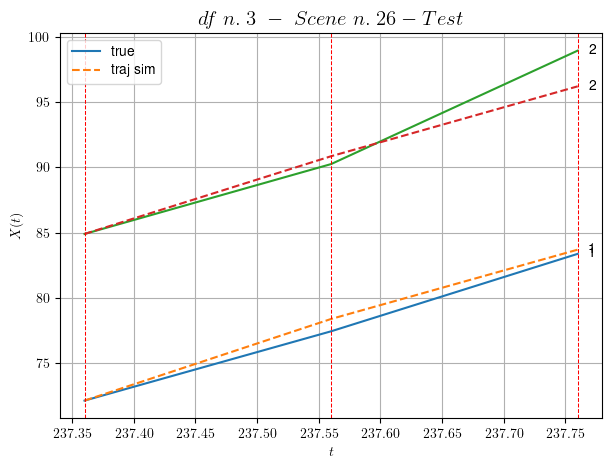

        For scene 26/81:
        * MSE = 1.4769982513049753
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.27/81


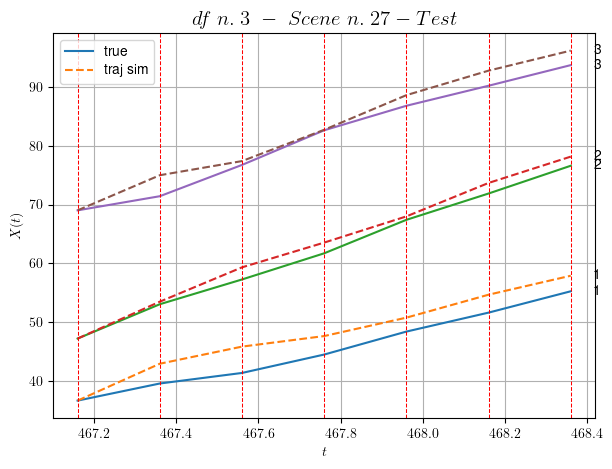

        For scene 27/81:
        * MSE = 5.0281309223592
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.28/81


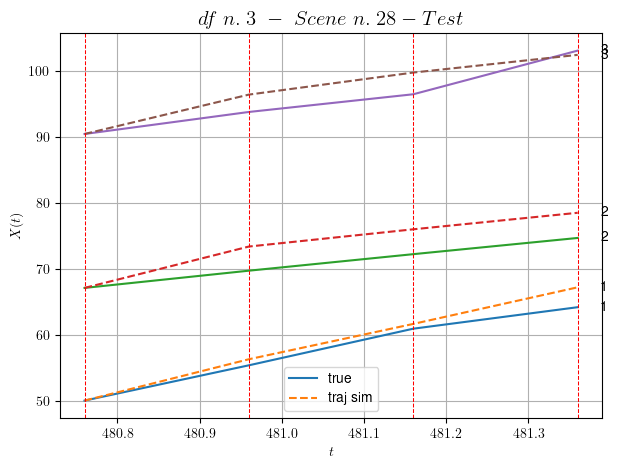

        For scene 28/81:
        * MSE = 5.878268464302166
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.29/81


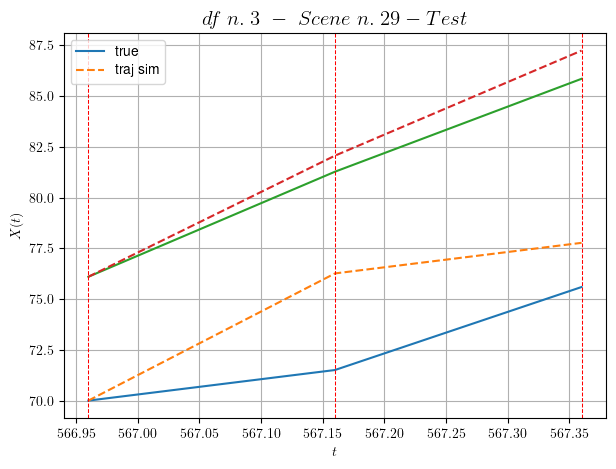

        For scene 29/81:
        * MSE = 4.9834598248121535
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.30/81


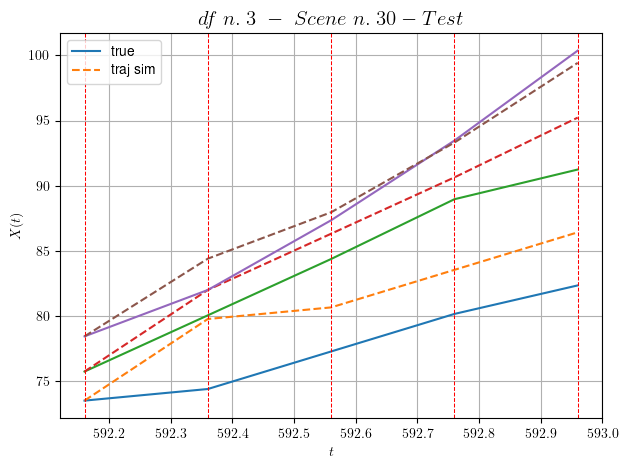

        For scene 30/81:
        * MSE = 6.773805120362389
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.31/81


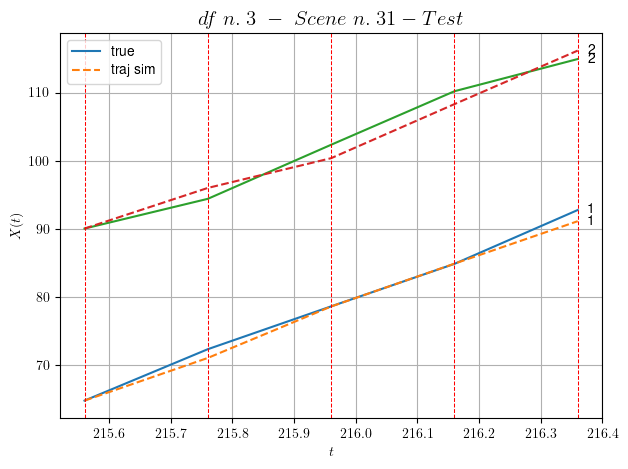

        For scene 31/81:
        * MSE = 1.587133506552625
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.32/81


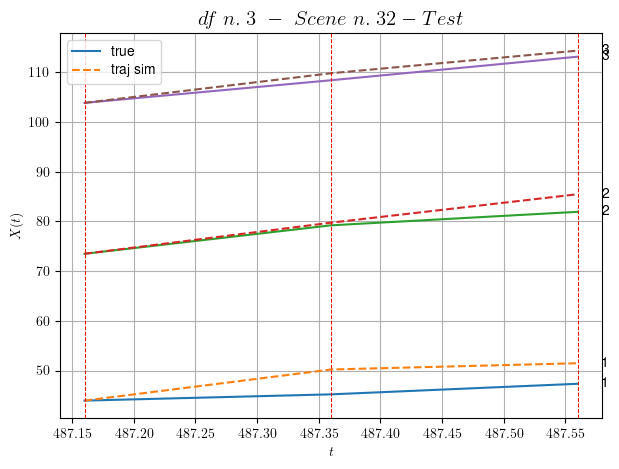

        For scene 32/81:
        * MSE = 6.493428495560281
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.33/81


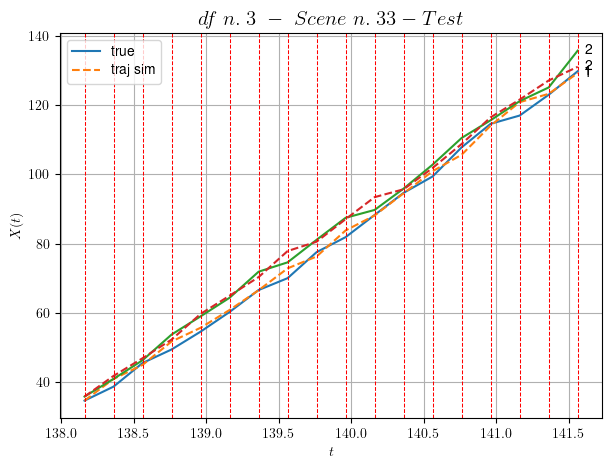

        For scene 33/81:
        * MSE = 3.0503554260482924
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.34/81


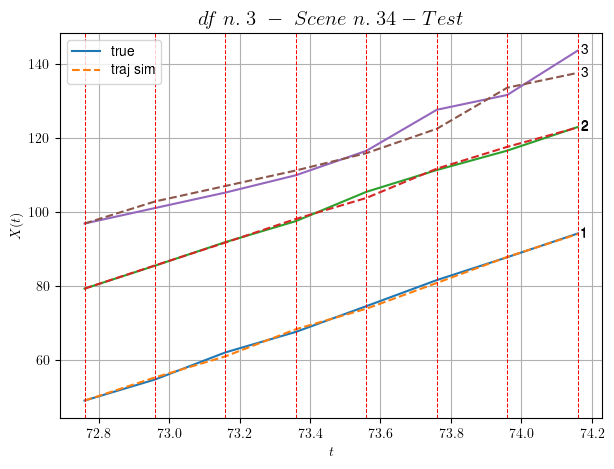

        For scene 34/81:
        * MSE = 3.421415590086937
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.35/81


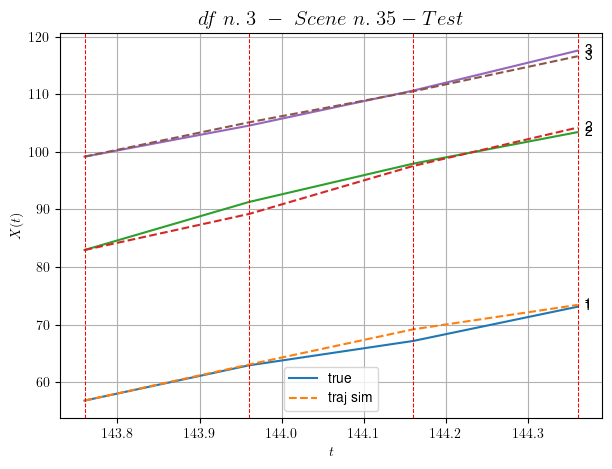

        For scene 35/81:
        * MSE = 0.8853338358344486
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.36/81


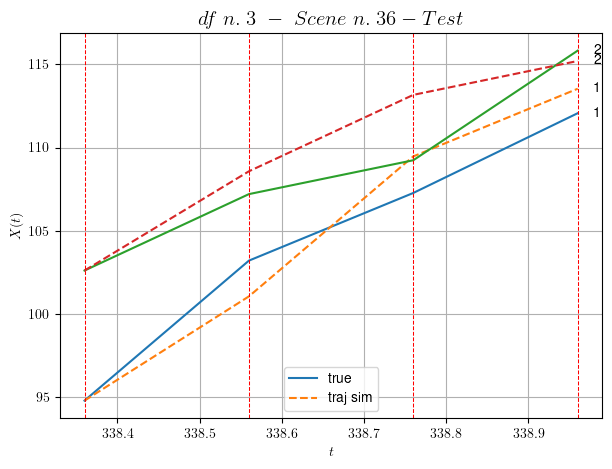

        For scene 36/81:
        * MSE = 3.6607712204440253
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.37/81


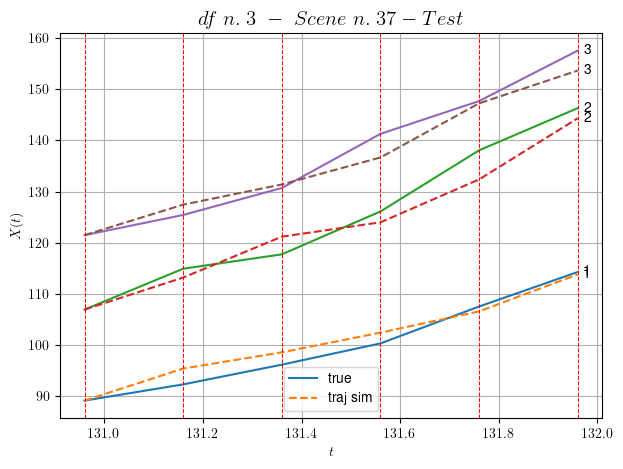

        For scene 37/81:
        * MSE = 6.550279867563103
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.38/81


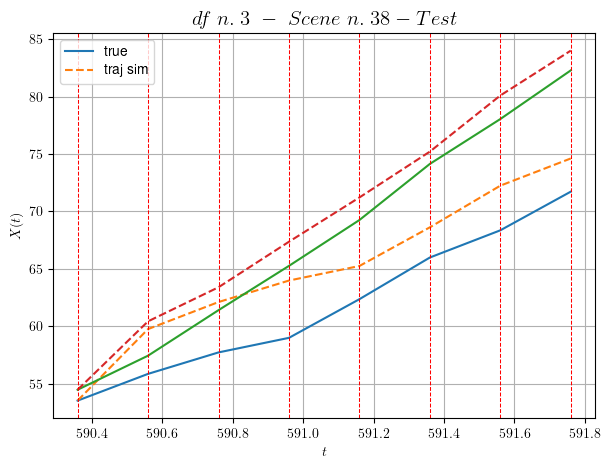

        For scene 38/81:
        * MSE = 7.986476168593482
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.39/81


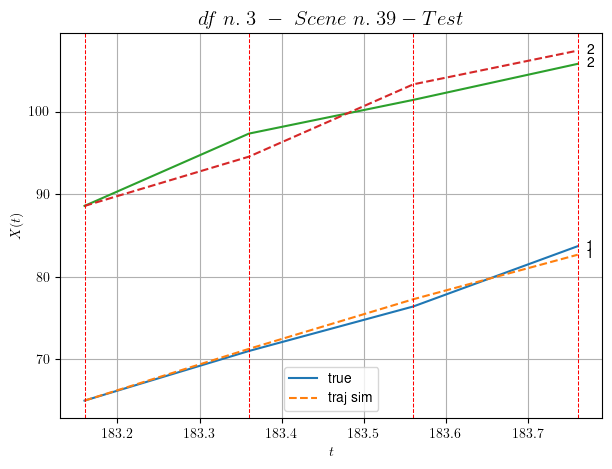

        For scene 39/81:
        * MSE = 1.972512139696679
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.40/81


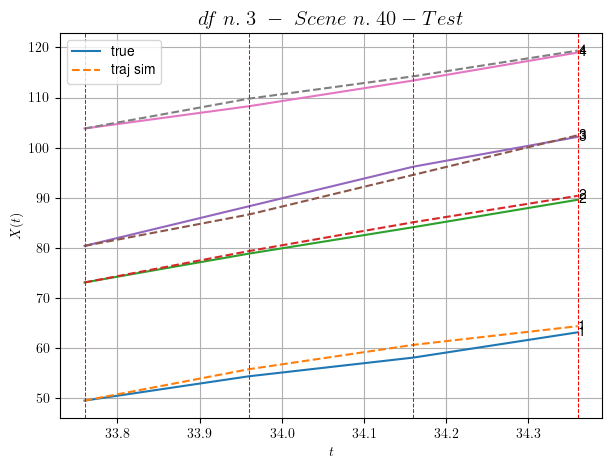

        For scene 40/81:
        * MSE = 1.2732942007696244
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.41/81


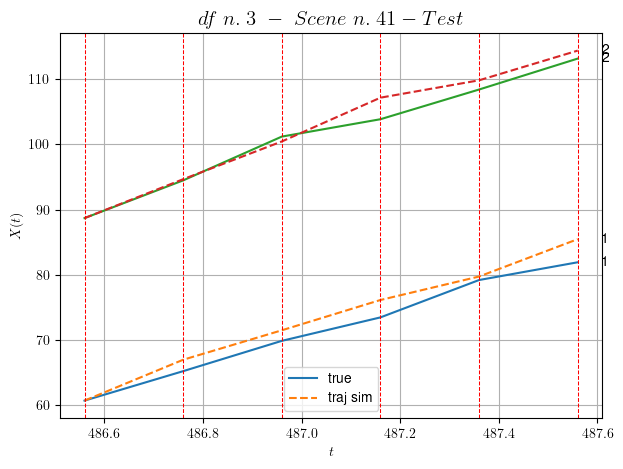

        For scene 41/81:
        * MSE = 3.383433110305779
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.42/81


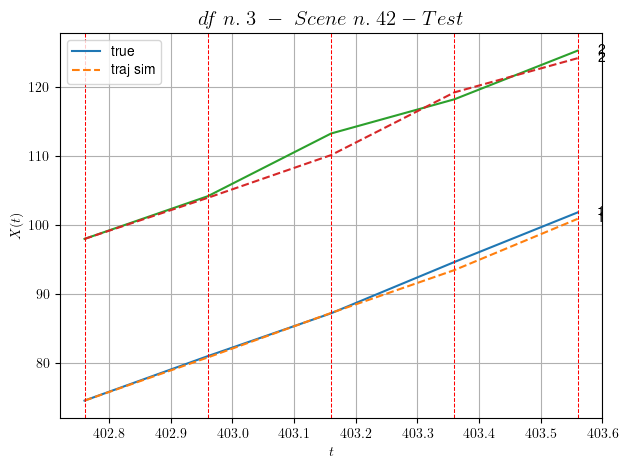

        For scene 42/81:
        * MSE = 1.434819260263745
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.43/81


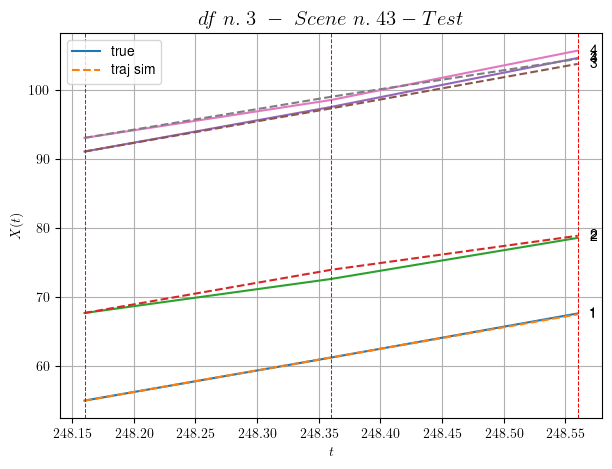

        For scene 43/81:
        * MSE = 0.3581227602416791
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.44/81


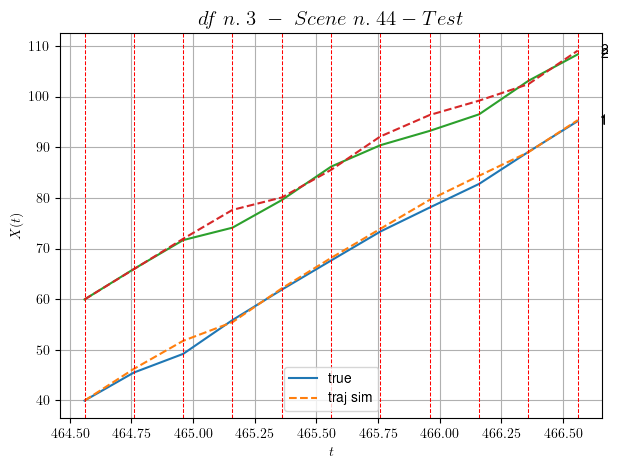

        For scene 44/81:
        * MSE = 2.1380698236338667
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.45/81


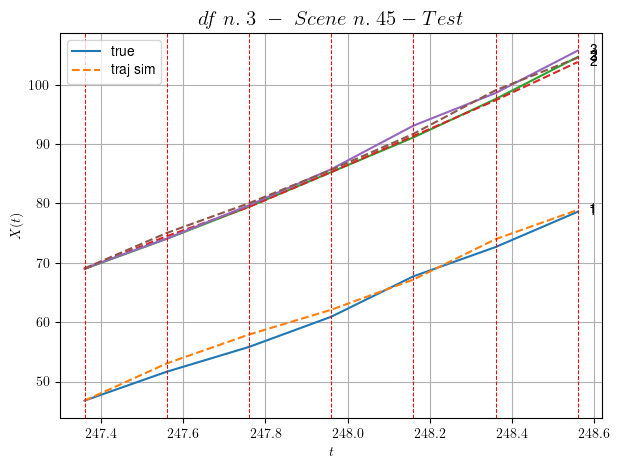

        For scene 45/81:
        * MSE = 0.7357084696372816
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.46/81


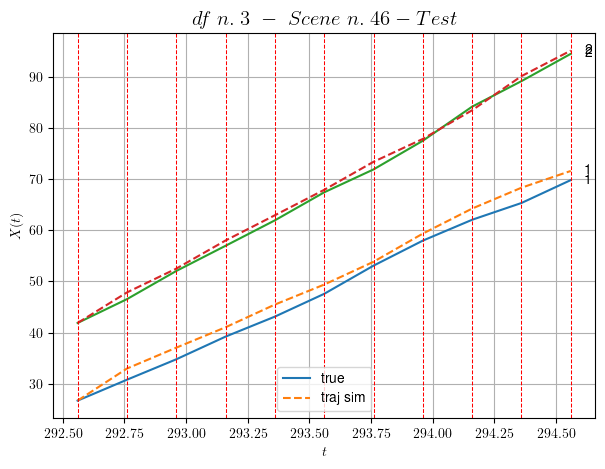

        For scene 46/81:
        * MSE = 2.264918158372123
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.47/81


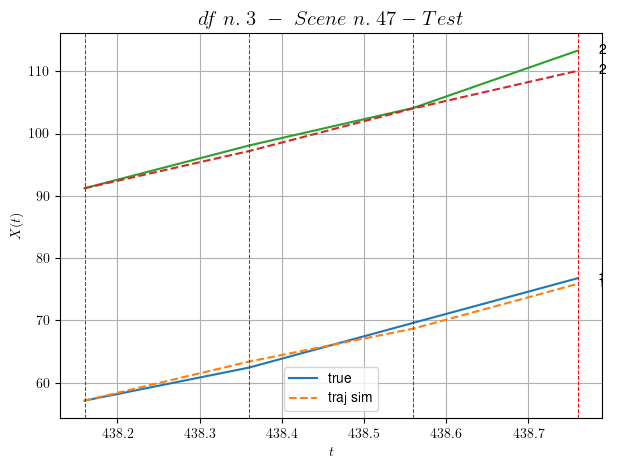

        For scene 47/81:
        * MSE = 1.740115915878146
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.48/81


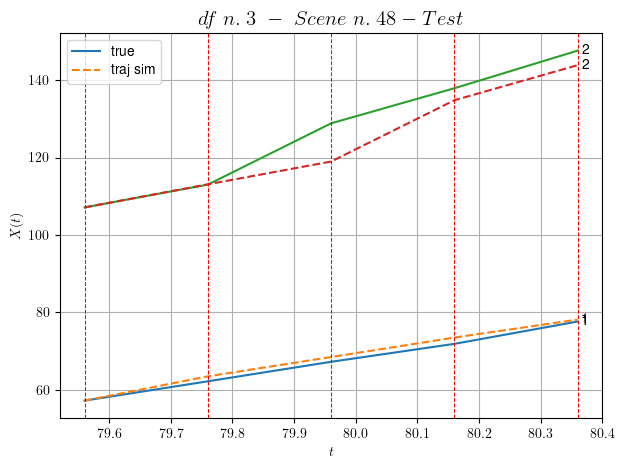

        For scene 48/81:
        * MSE = 12.70356784116519
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.49/81


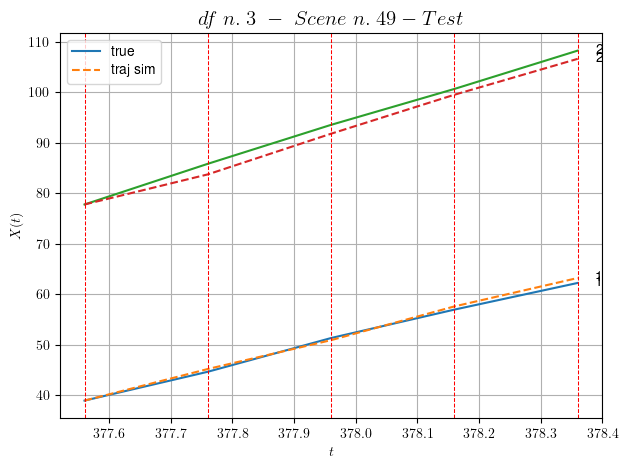

        For scene 49/81:
        * MSE = 1.3284936739723119
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.50/81


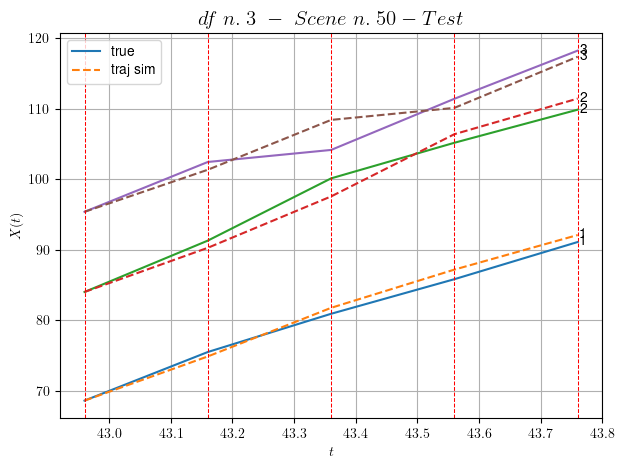

        For scene 50/81:
        * MSE = 2.4809183345119306
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.51/81


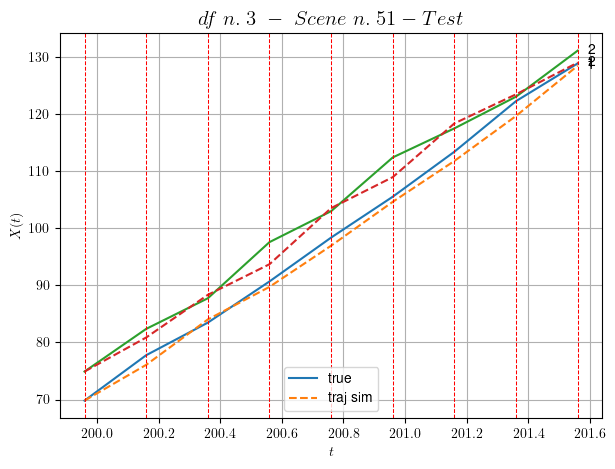

        For scene 51/81:
        * MSE = 2.8638939703789794
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.52/81


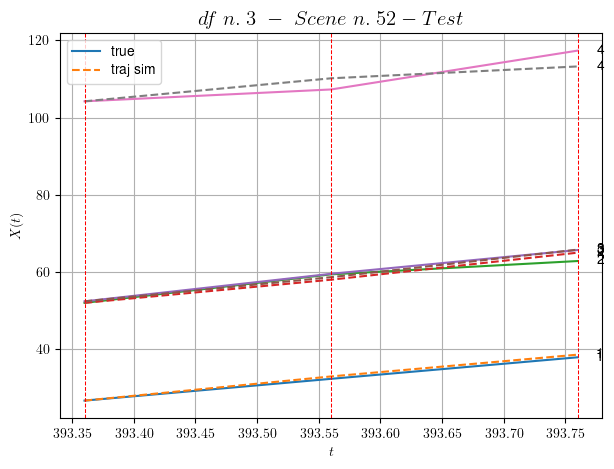

        For scene 52/81:
        * MSE = 2.7844363488773833
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.53/81


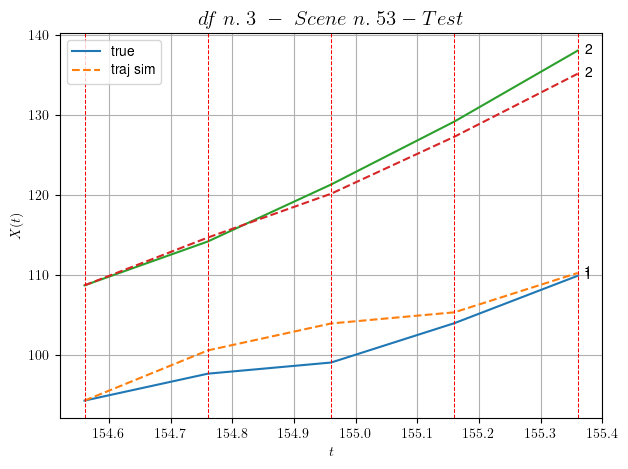

        For scene 53/81:
        * MSE = 4.753760487558532
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.54/81


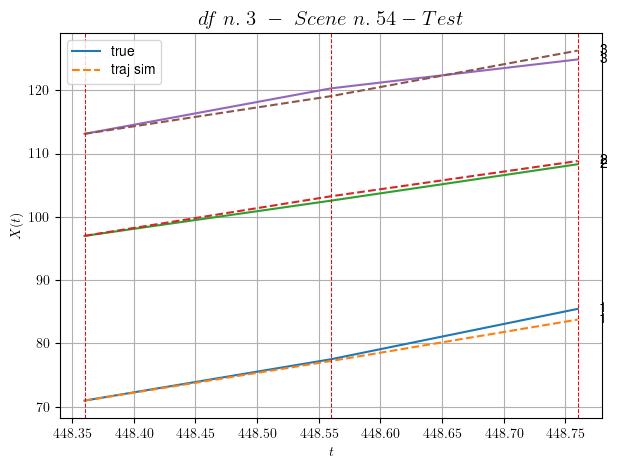

        For scene 54/81:
        * MSE = 0.7925935504811813
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.55/81


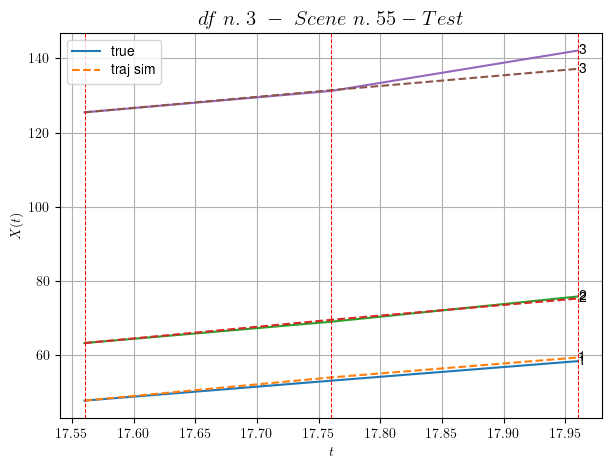

        For scene 55/81:
        * MSE = 2.947696313280478
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.56/81


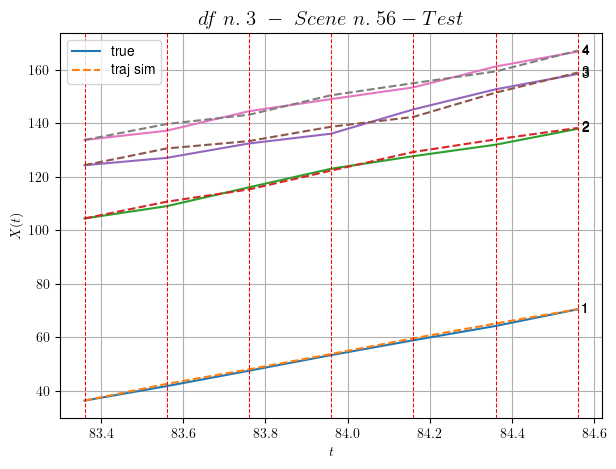

        For scene 56/81:
        * MSE = 2.087072005531713
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.57/81


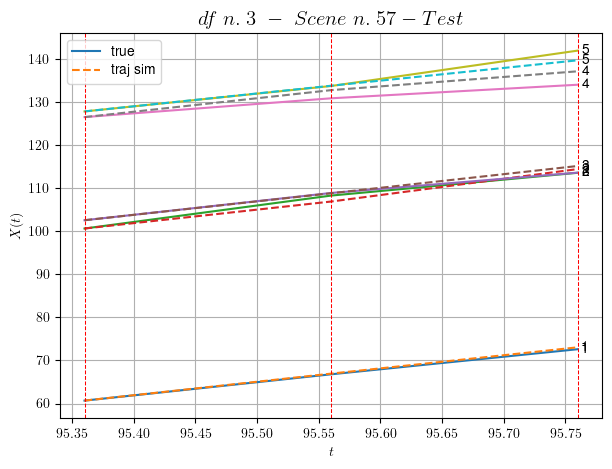

        For scene 57/81:
        * MSE = 1.5734043370907738
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.58/81


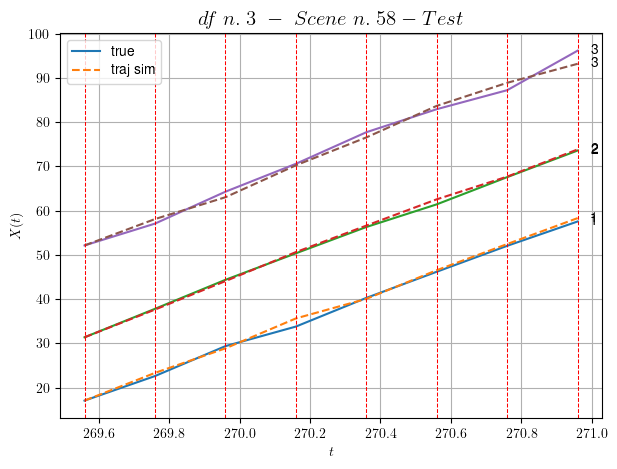

        For scene 58/81:
        * MSE = 0.9596935431063587
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.59/81


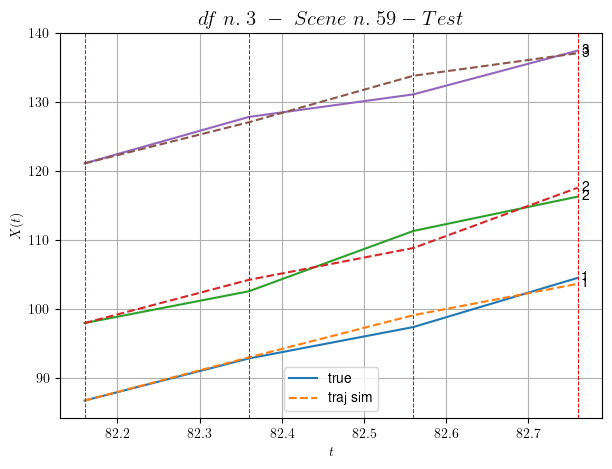

        For scene 59/81:
        * MSE = 1.8510312200176415
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.60/81


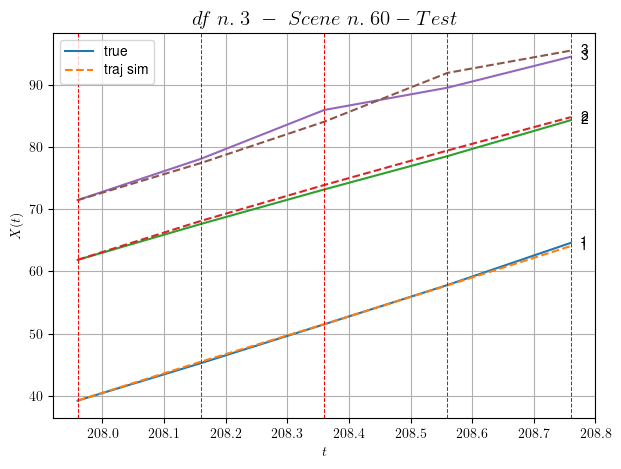

        For scene 60/81:
        * MSE = 0.8507572341797953
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.61/81


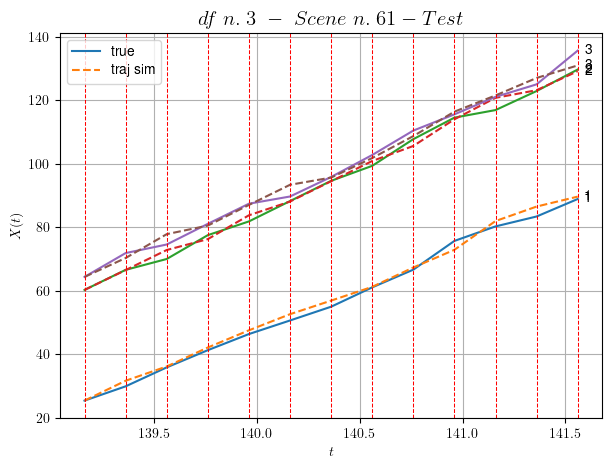

        For scene 61/81:
        * MSE = 3.2872216497449904
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.62/81


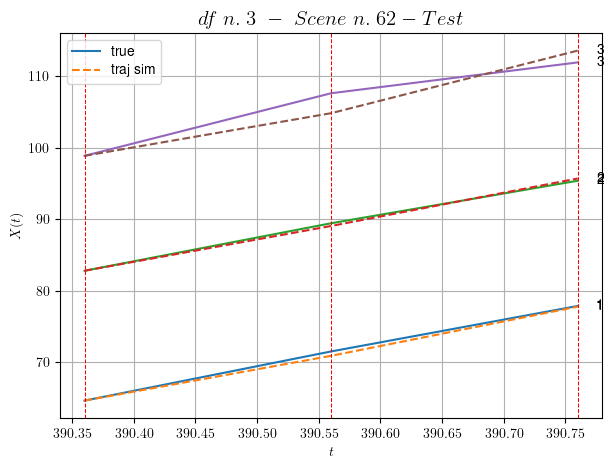

        For scene 62/81:
        * MSE = 1.2354857239960382
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.63/81


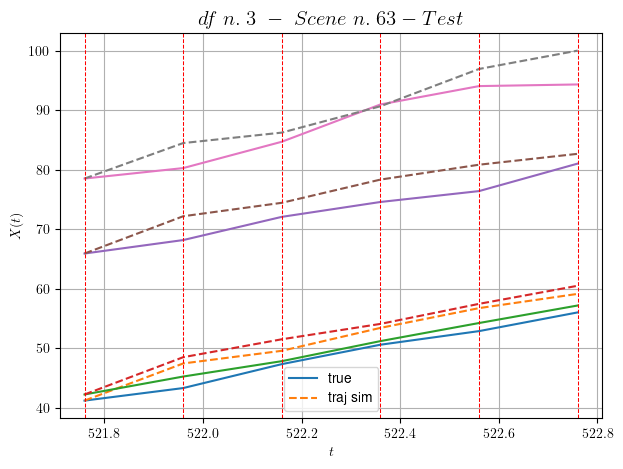

        For scene 63/81:
        * MSE = 9.473627608160061
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.64/81


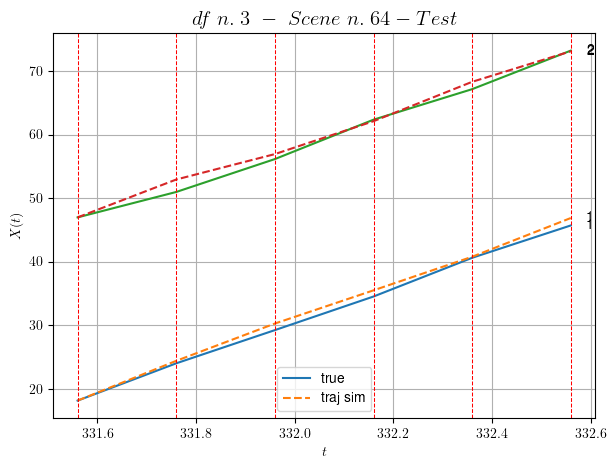

        For scene 64/81:
        * MSE = 0.7855687450562135
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.65/81


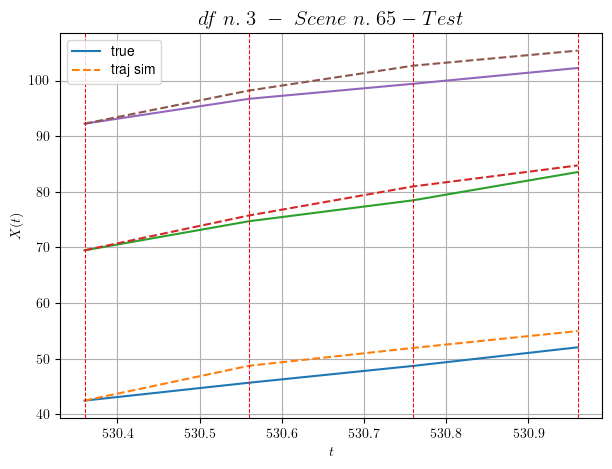

        For scene 65/81:
        * MSE = 4.966098670707148
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.66/81


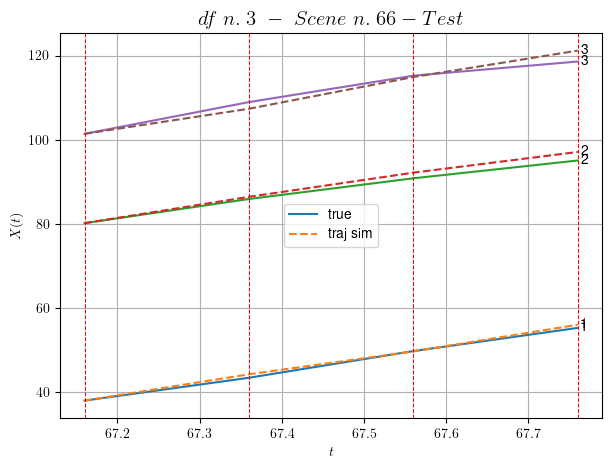

        For scene 66/81:
        * MSE = 1.3961663816388292
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.67/81


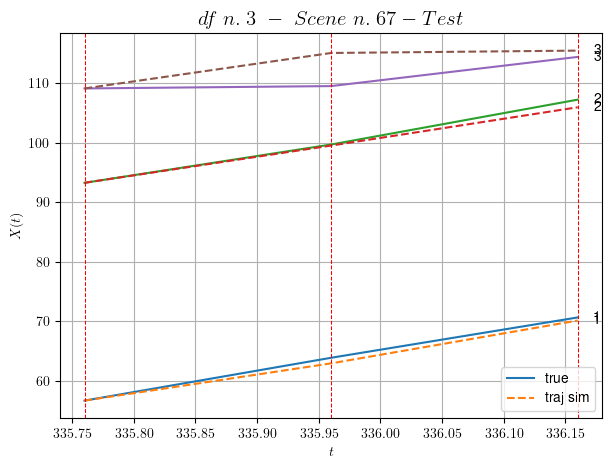

        For scene 67/81:
        * MSE = 3.8787140862351848
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.68/81


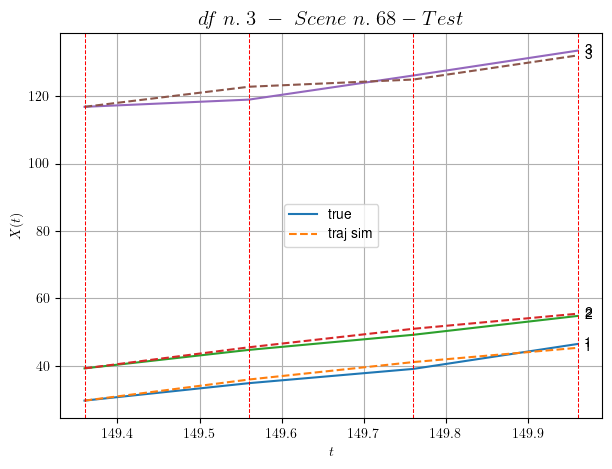

        For scene 68/81:
        * MSE = 2.4049014194625635
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.69/81


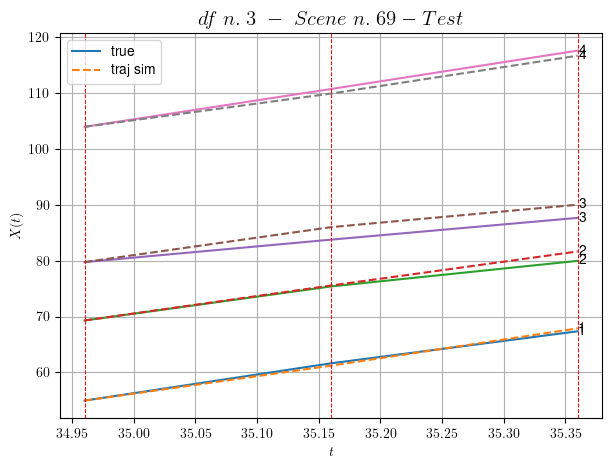

        For scene 69/81:
        * MSE = 1.2826394195480184
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.70/81


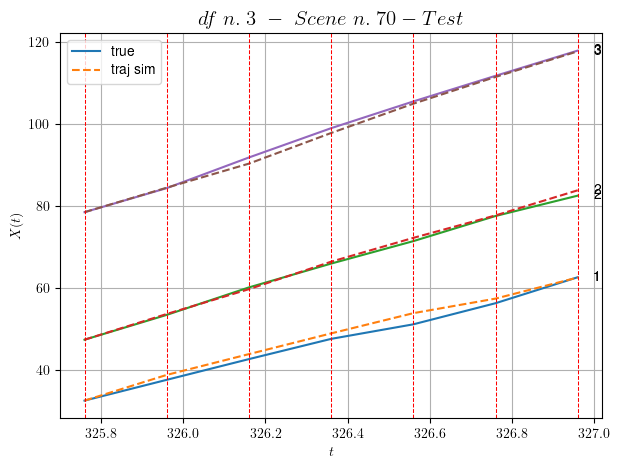

        For scene 70/81:
        * MSE = 0.9609011501665194
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.71/81


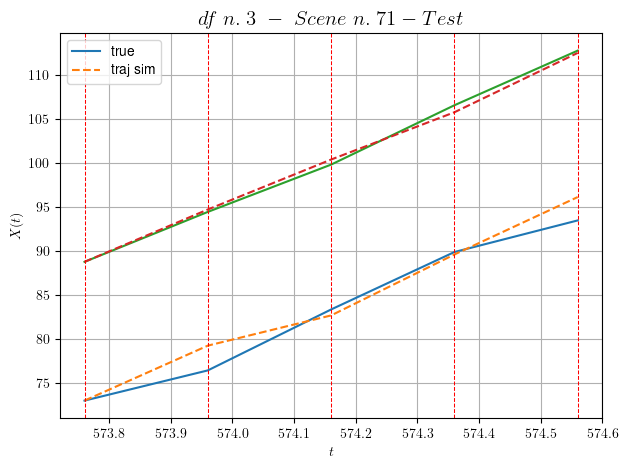

        For scene 71/81:
        * MSE = 1.6692727145562216
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.72/81


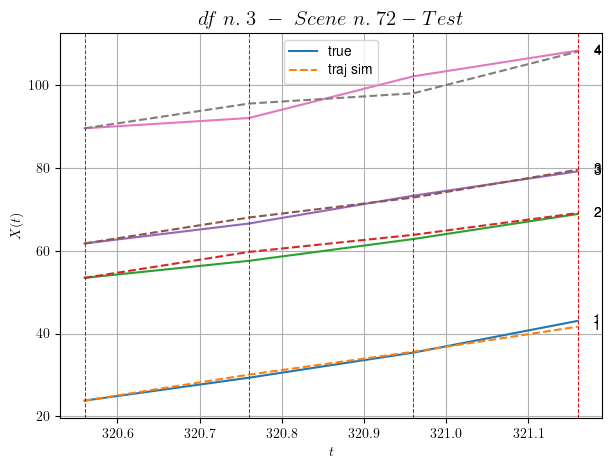

        For scene 72/81:
        * MSE = 2.4758464560540534
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.73/81


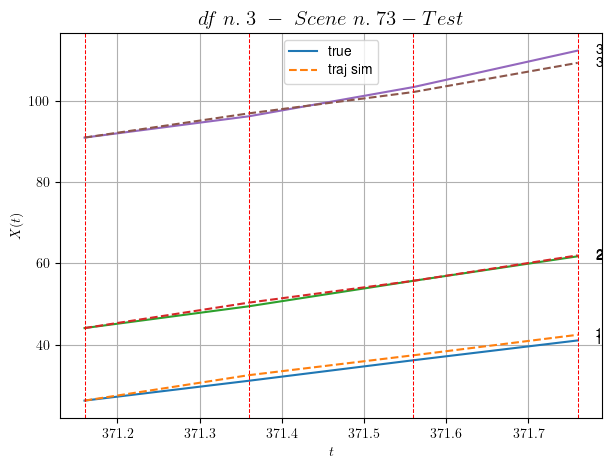

        For scene 73/81:
        * MSE = 1.4373552374189111
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.74/81


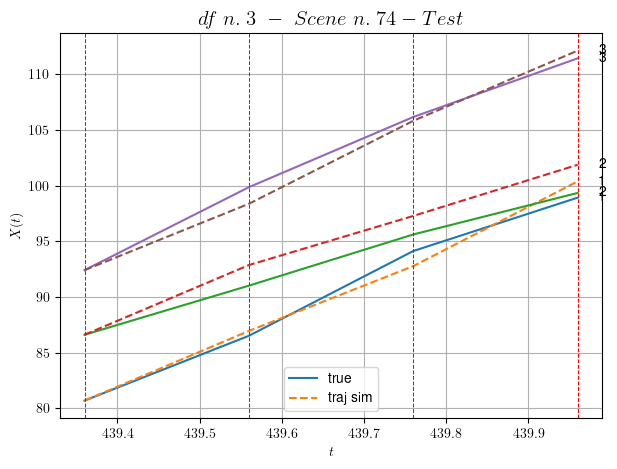

        For scene 74/81:
        * MSE = 1.6314462819874327
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.75/81


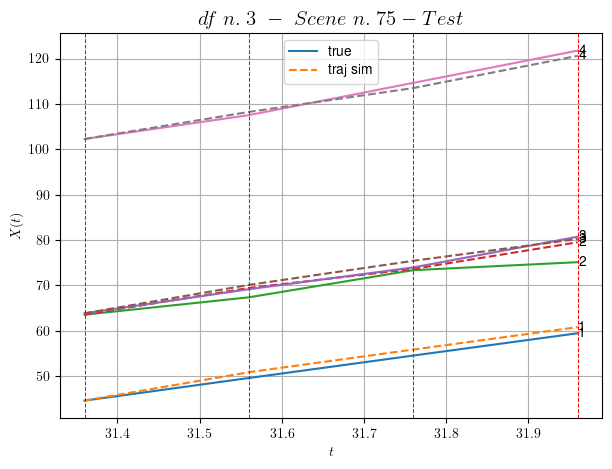

        For scene 75/81:
        * MSE = 2.1996508149031673
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.76/81


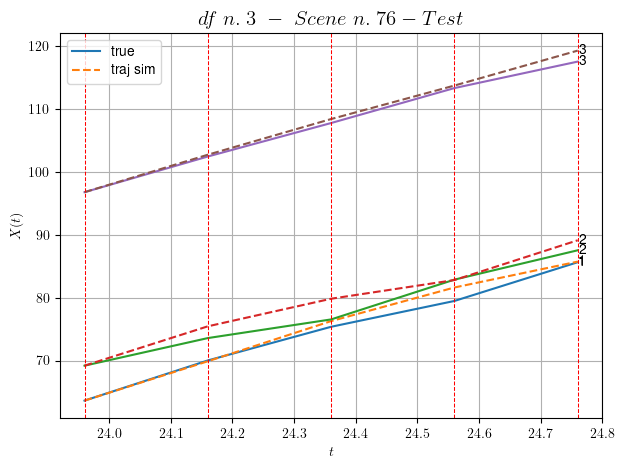

        For scene 76/81:
        * MSE = 1.7336261427407702
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.77/81


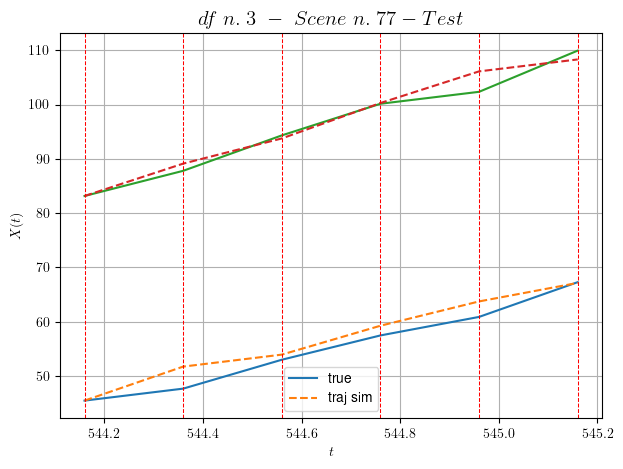

        For scene 77/81:
        * MSE = 3.9649986392370495
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.78/81


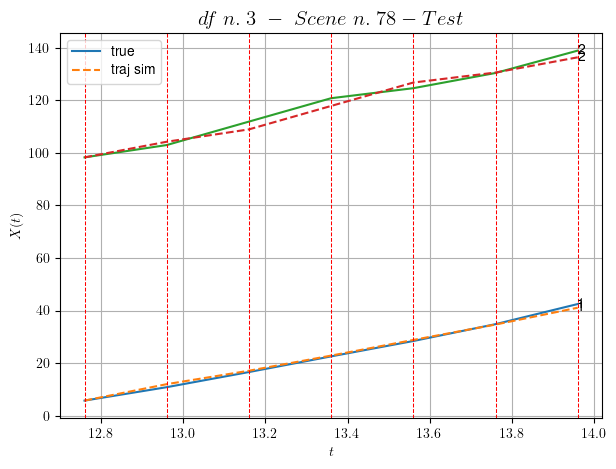

        For scene 78/81:
        * MSE = 2.428999946850213
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.79/81


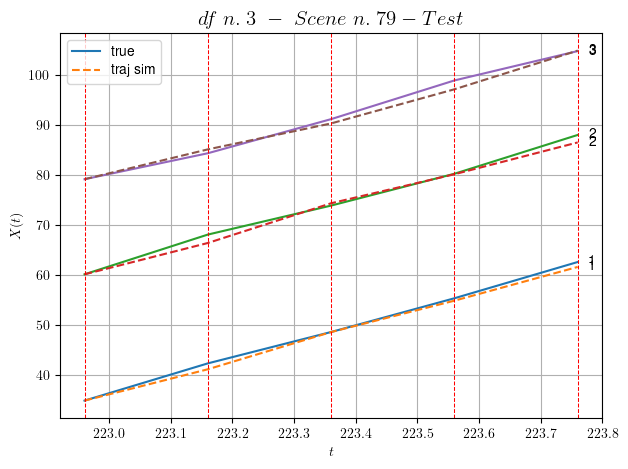

        For scene 79/81:
        * MSE = 0.8236515021185098
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.80/81


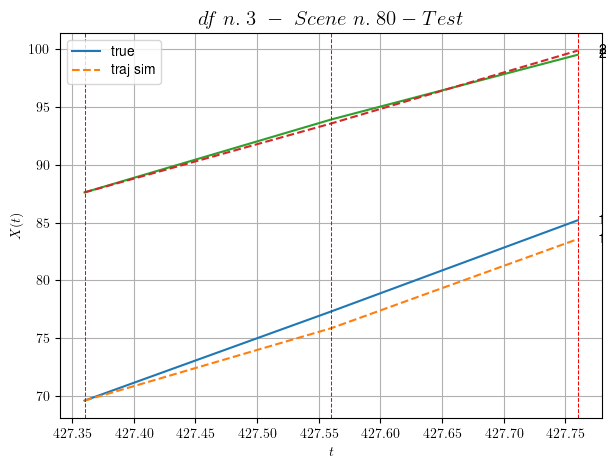

        For scene 80/81:
        * MSE = 0.8333062773087028
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.81/81


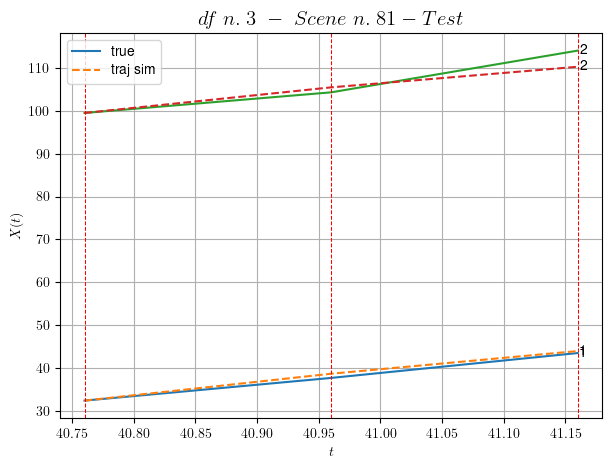

        For scene 81/81:
        * MSE = 2.7766213296931106
----------------------------------------------------------------------------------------------------


MSE test: 2.9715190770955737

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 1.969032433721208
          * MSE test: 2.9715190770955737
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 4/10 dfs.
In DataFrame n.4 we have 69 scenes.
    To train the model we use 6 scenes, the remaining 63 to test the model.

Training step. (6 scenes)
DataFrame n.4. Scene n.1/6
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [65.04,65.64]


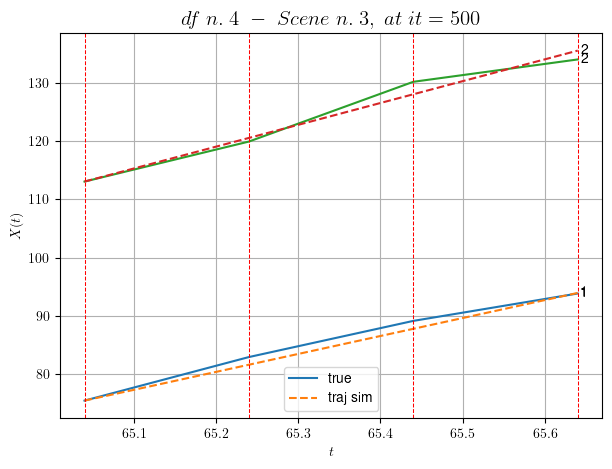

----------------------------------------------------------------------------------------------------
        For scene 1/6:
        * After LR finder: LR_NN=1e-05 with mse=5.285620068106988 at it=24
        * v0 = 37.41903742148339
        * MSE = 1.2830352860746093
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.2/6
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [320.44,321.04]


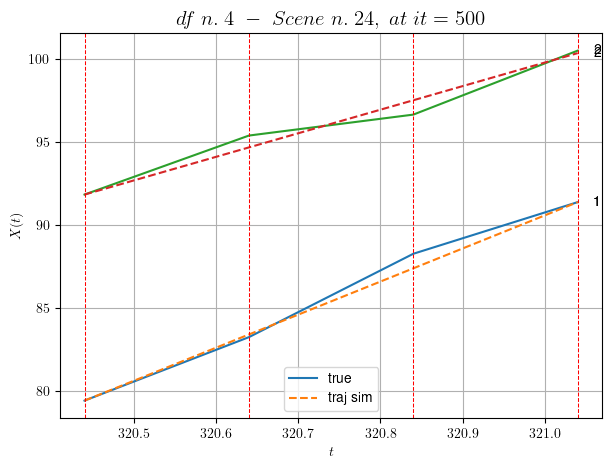

----------------------------------------------------------------------------------------------------
        For scene 2/6:
        * After LR finder: LR_NN=0.0001 with mse=18.221576765314676 at it=24
        * v0 = 14.1624266489926
        * MSE = 0.23734387406756707
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.3/6
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [285.84,287.44]


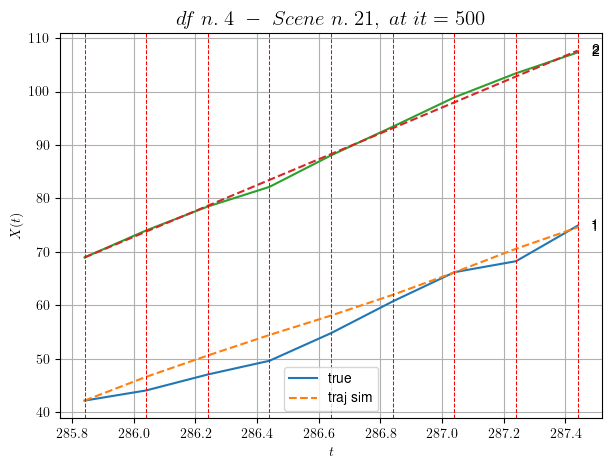

----------------------------------------------------------------------------------------------------
        For scene 3/6:
        * After LR finder: LR_NN=0.01 with mse=16.947680229527684 at it=24
        * v0 = 24.201830847423043
        * MSE = 2.169334201225896
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.4/6
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [554.64,555.04]


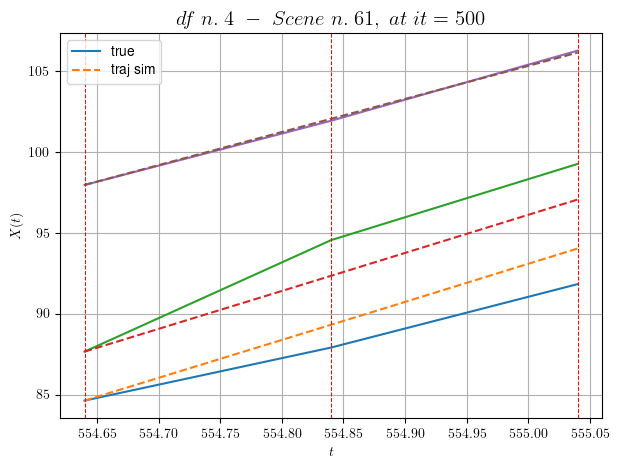

----------------------------------------------------------------------------------------------------
        For scene 4/6:
        * After LR finder: LR_NN=0.001 with mse=2.392925907269909 at it=24
        * v0 = 20.440727818766664
        * MSE = 1.837311223472714
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.5/6
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [182.04,183.64]


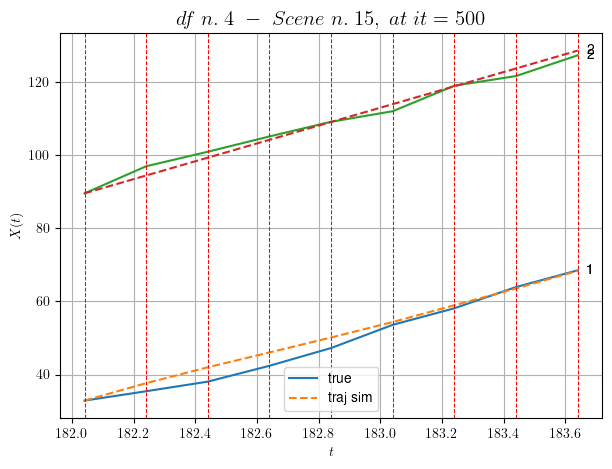

----------------------------------------------------------------------------------------------------
        For scene 5/6:
        * After LR finder: LR_NN=0.01 with mse=19.578567600906858 at it=24
        * v0 = 24.384953428579543
        * MSE = 2.282372042213743
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.6/6
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [233.84,235.24]


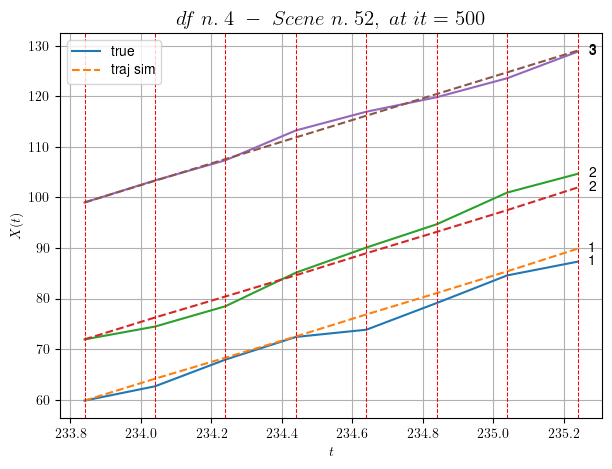

----------------------------------------------------------------------------------------------------
        For scene 6/6:
        * After LR finder: LR_NN=0.005 with mse=20.282273159969638 at it=24
        * v0 = 21.46280647198845
        * MSE = 2.378617848435427
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 1.6980024125816593
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (63 scenes)
DataFrame n.4. Scene n.1/63


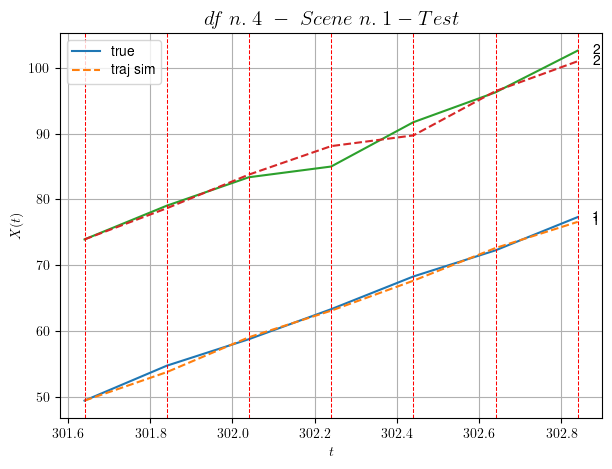

        For scene 1/63:
        * MSE = 1.3441273169123955
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.2/63


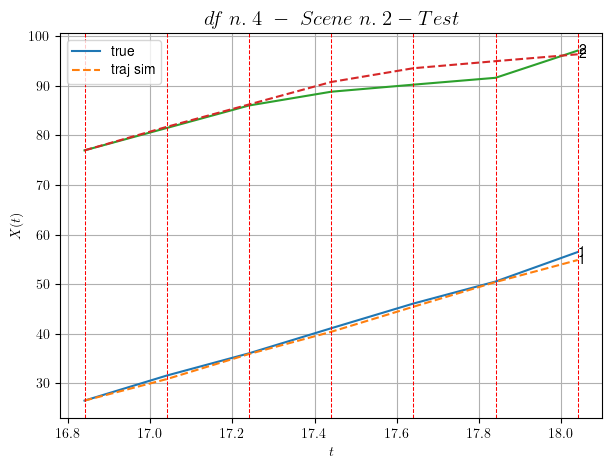

        For scene 2/63:
        * MSE = 2.1975933472957365
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.3/63


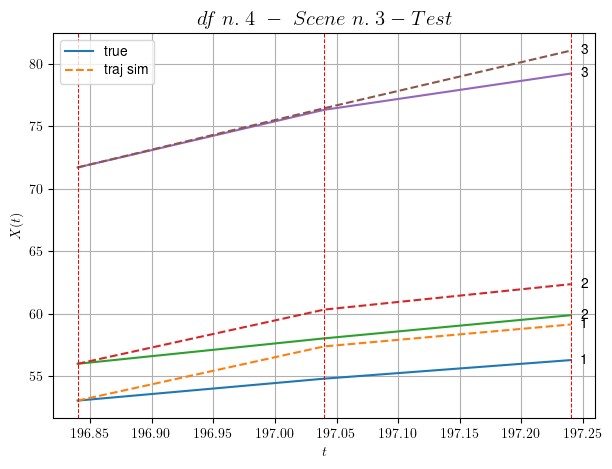

        For scene 3/63:
        * MSE = 3.288361610808352
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.4/63


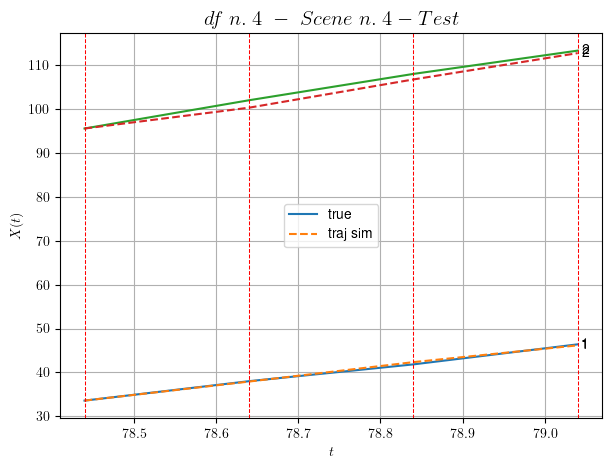

        For scene 4/63:
        * MSE = 0.6380539256224141
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.5/63


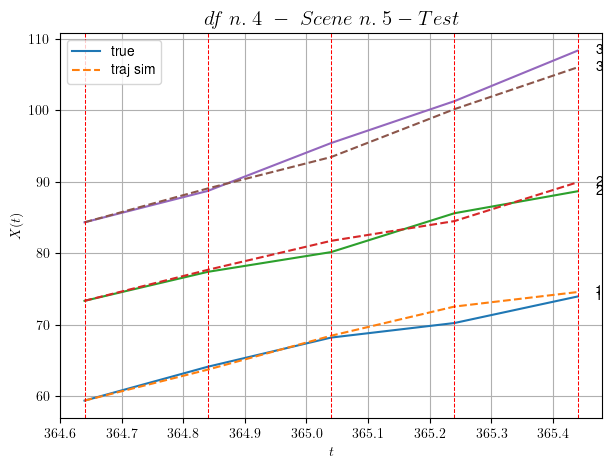

        For scene 5/63:
        * MSE = 1.459148243656615
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.6/63


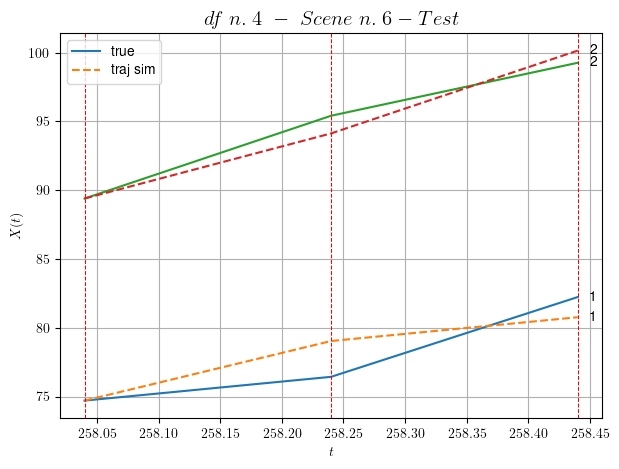

        For scene 6/63:
        * MSE = 1.8942077922423723
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.7/63


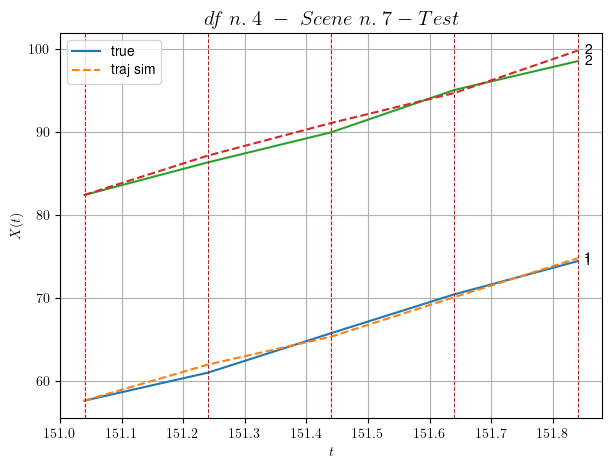

        For scene 7/63:
        * MSE = 0.5019398095996251
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.8/63


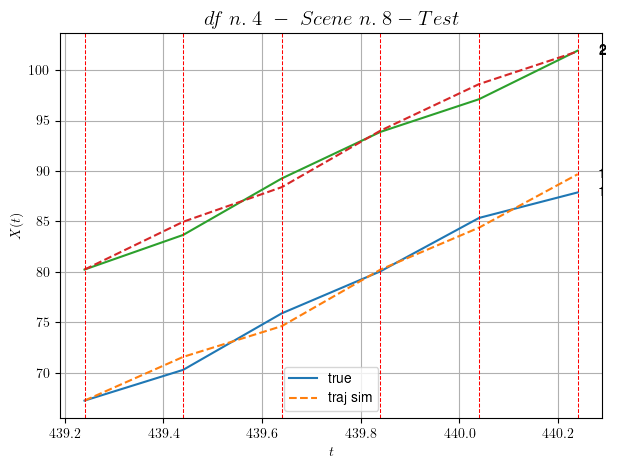

        For scene 8/63:
        * MSE = 1.0142148989017703
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.9/63


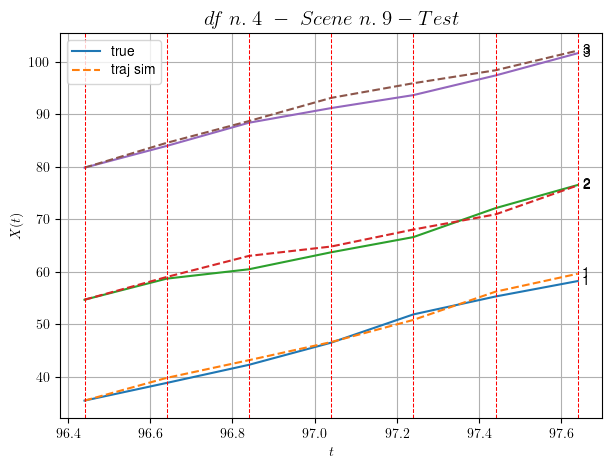

        For scene 9/63:
        * MSE = 1.3085757241191442
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.10/63


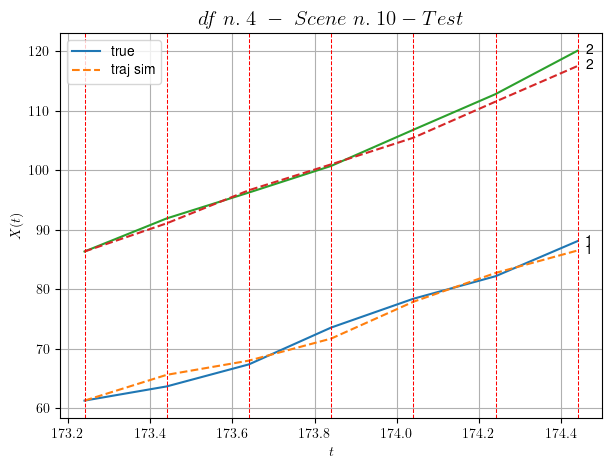

        For scene 10/63:
        * MSE = 1.5418771905656594
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.11/63


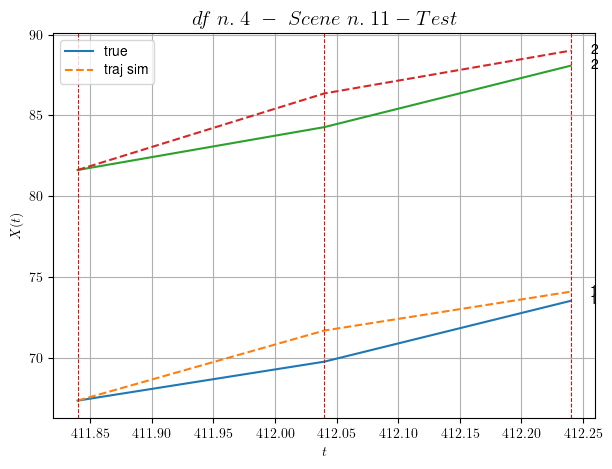

        For scene 11/63:
        * MSE = 1.5393718580232927
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.12/63


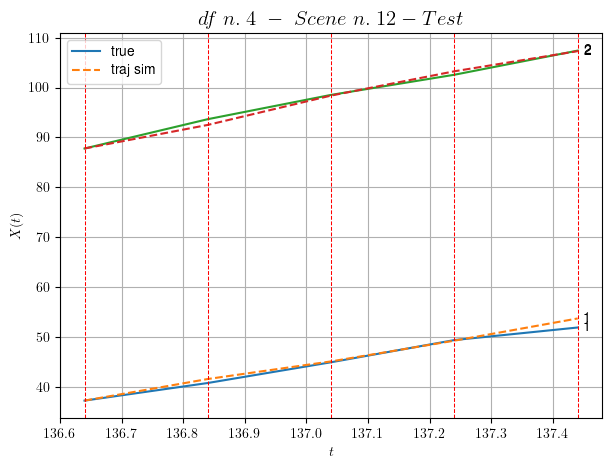

        For scene 12/63:
        * MSE = 0.5805432811131148
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.13/63


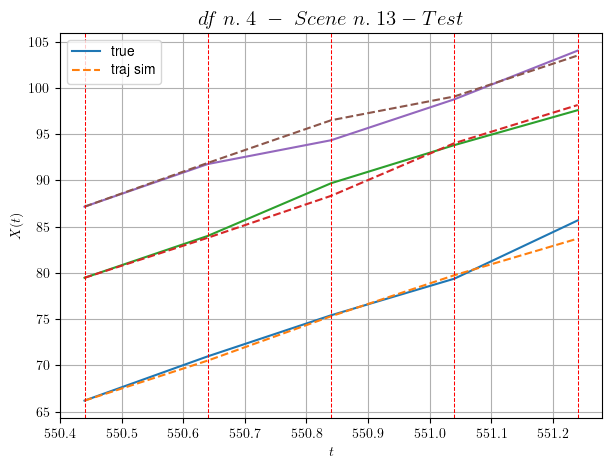

        For scene 13/63:
        * MSE = 0.7698892137924934
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.14/63


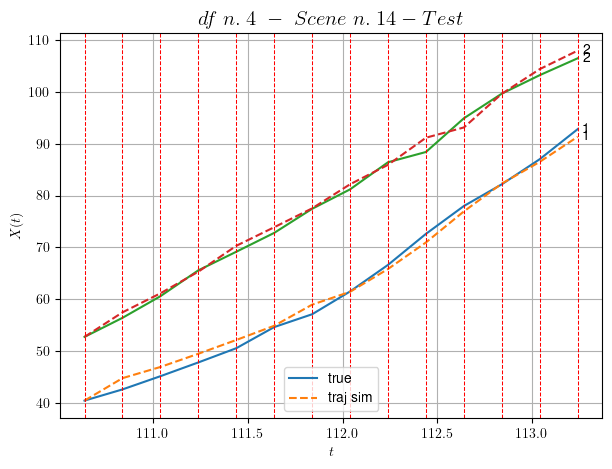

        For scene 14/63:
        * MSE = 1.5402418820838935
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.15/63


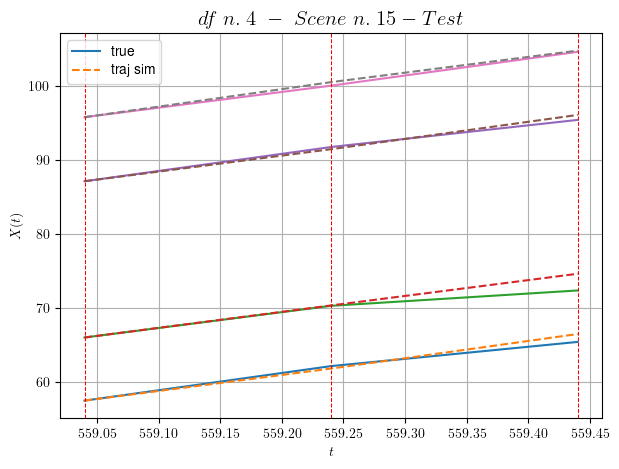

        For scene 15/63:
        * MSE = 0.594728937222278
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.16/63


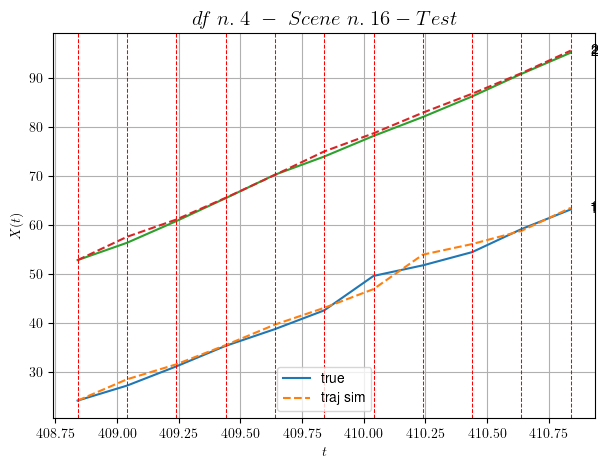

        For scene 16/63:
        * MSE = 1.0024695980747245
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.17/63


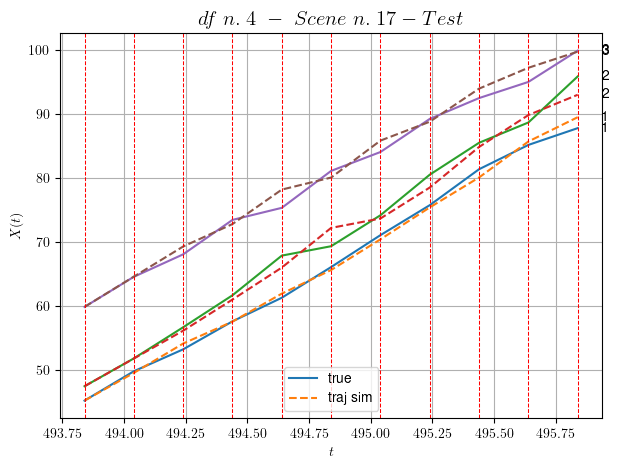

        For scene 17/63:
        * MSE = 1.6737685491799896
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.18/63


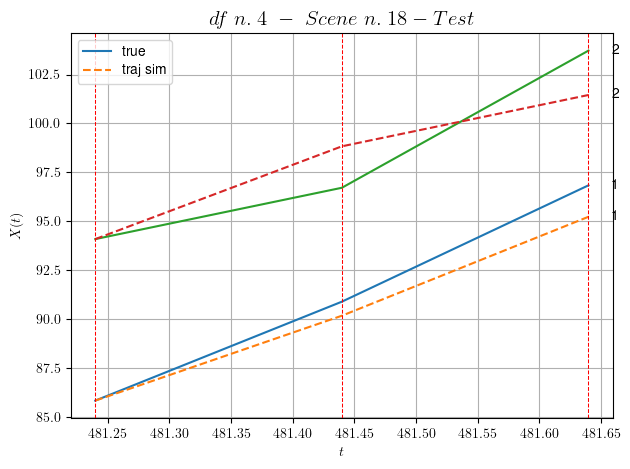

        For scene 18/63:
        * MSE = 2.116523001106567
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.19/63


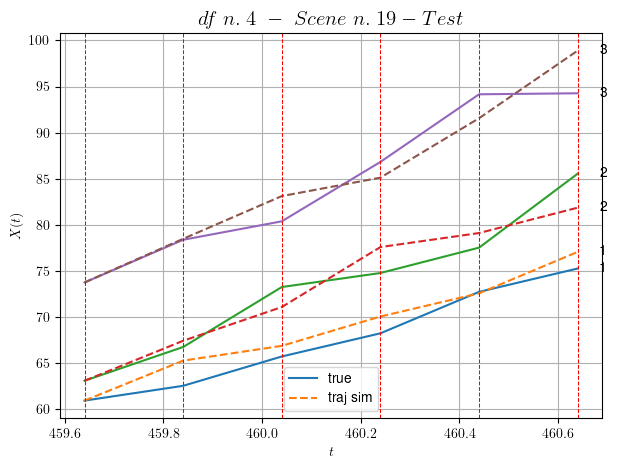

        For scene 19/63:
        * MSE = 4.615041617365407
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.20/63


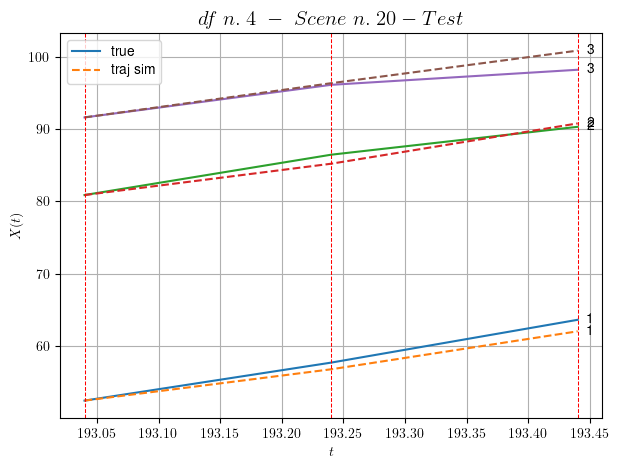

        For scene 20/63:
        * MSE = 1.3598124403834388
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.21/63


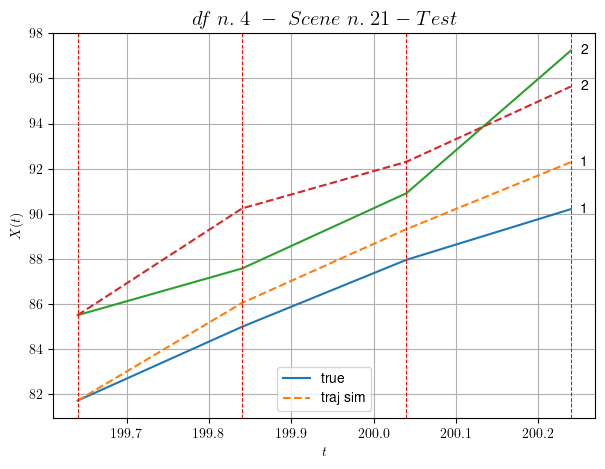

        For scene 21/63:
        * MSE = 2.364342879282513
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.22/63


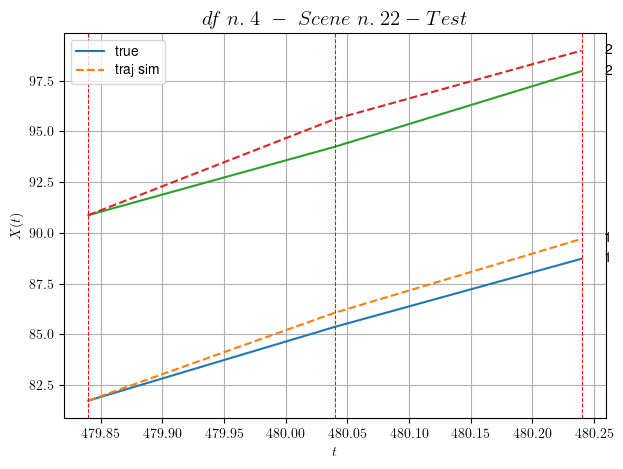

        For scene 22/63:
        * MSE = 0.7222125018191125
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.23/63


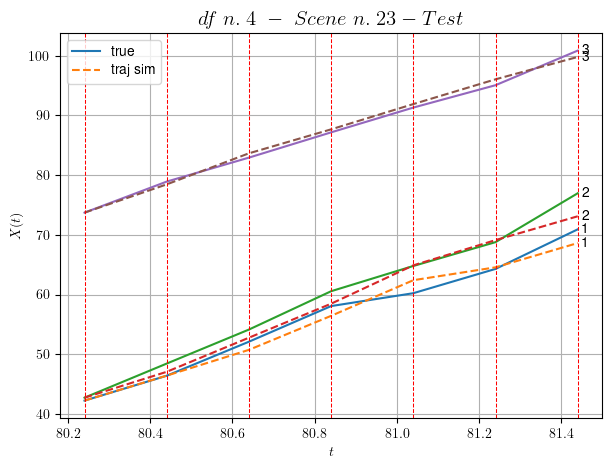

        For scene 23/63:
        * MSE = 1.9594973757417151
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.24/63


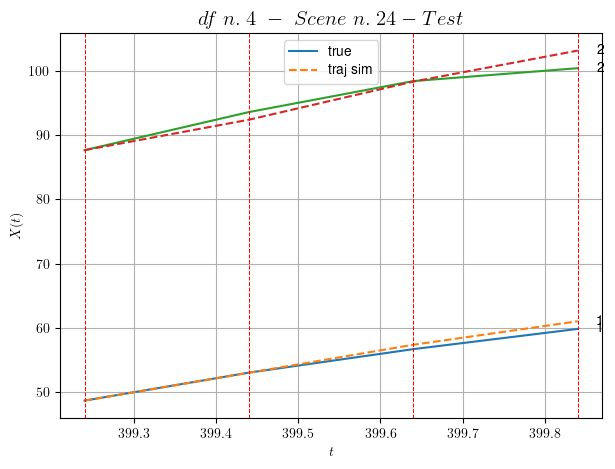

        For scene 24/63:
        * MSE = 1.3464340943543887
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.25/63


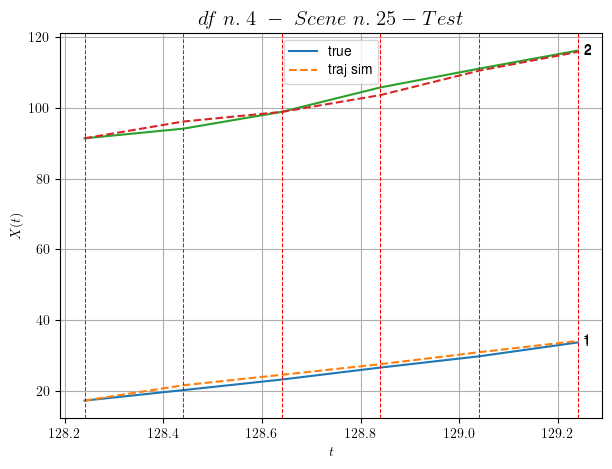

        For scene 25/63:
        * MSE = 1.2723702525942868
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.26/63


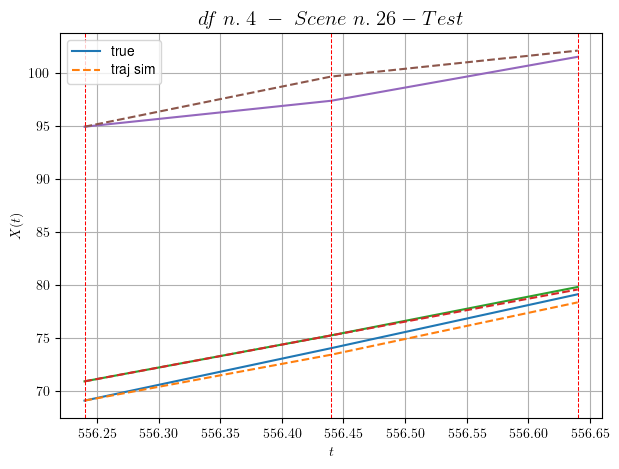

        For scene 26/63:
        * MSE = 0.731568697558969
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.27/63


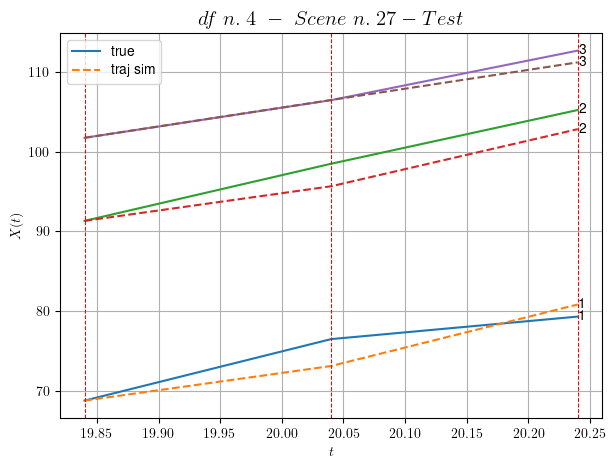

        For scene 27/63:
        * MSE = 3.2743575945777006
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.28/63


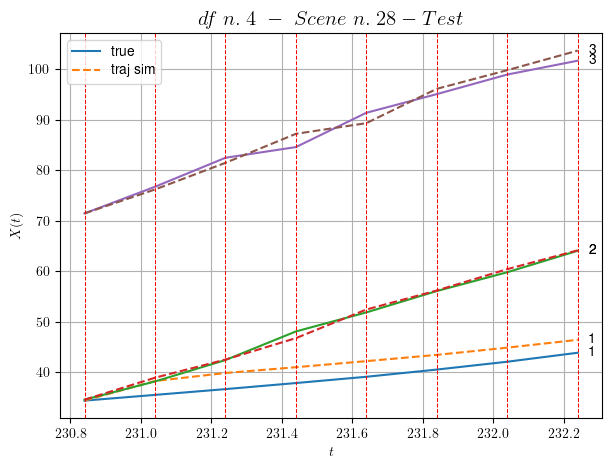

        For scene 28/63:
        * MSE = 3.378509123701384
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.29/63


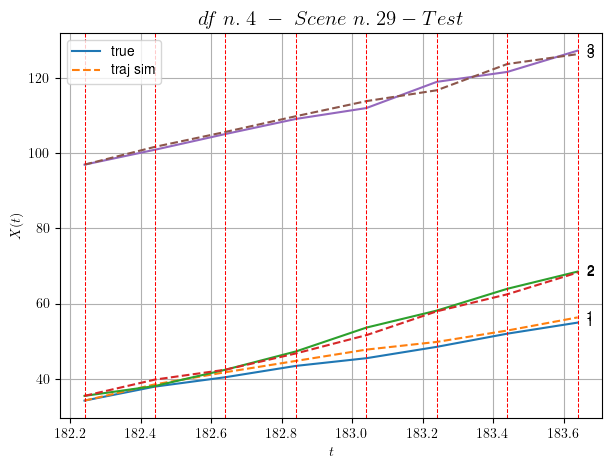

        For scene 29/63:
        * MSE = 1.5844943879567397
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.30/63


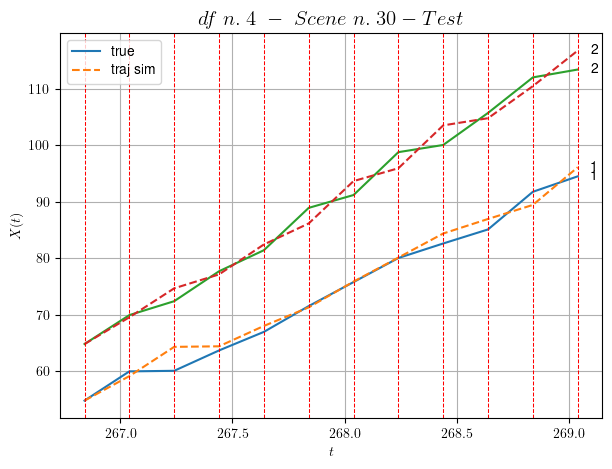

        For scene 30/63:
        * MSE = 3.7375935642710694
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.31/63


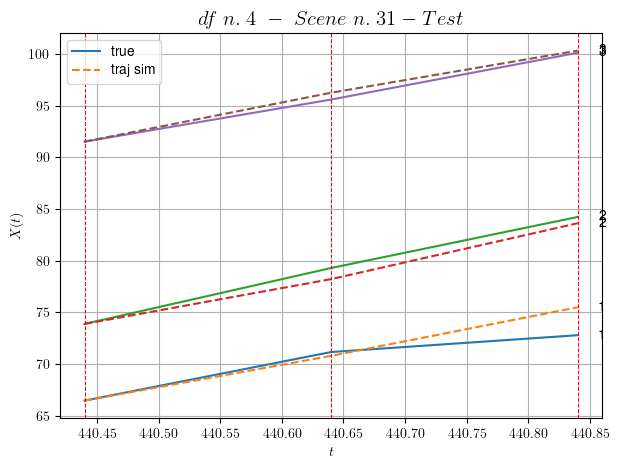

        For scene 31/63:
        * MSE = 1.050242805395954
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.32/63


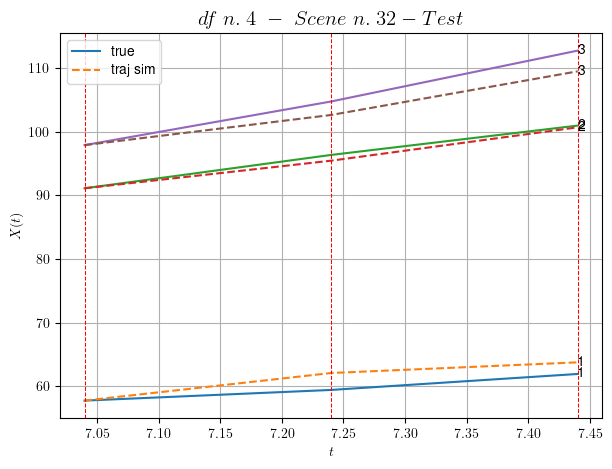

        For scene 32/63:
        * MSE = 2.926385795672862
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.33/63


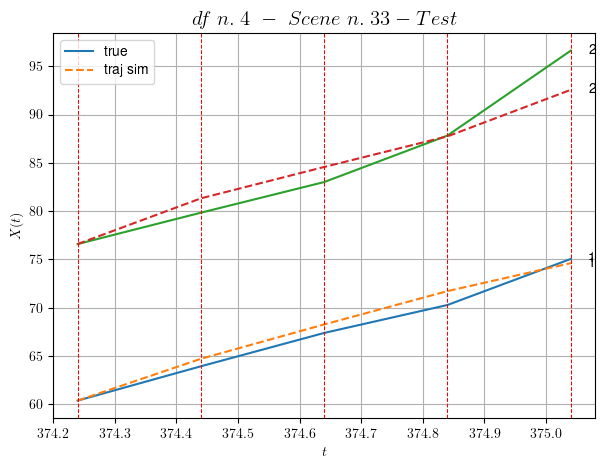

        For scene 33/63:
        * MSE = 2.478813954983239
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.34/63


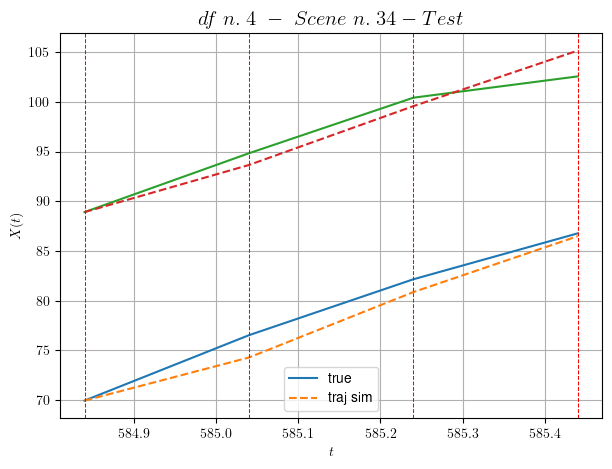

        For scene 34/63:
        * MSE = 1.9524816435537256
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.35/63


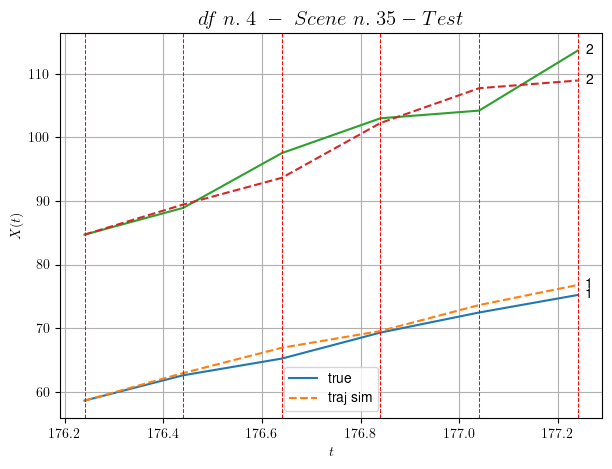

        For scene 35/63:
        * MSE = 4.787396452192738
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.36/63


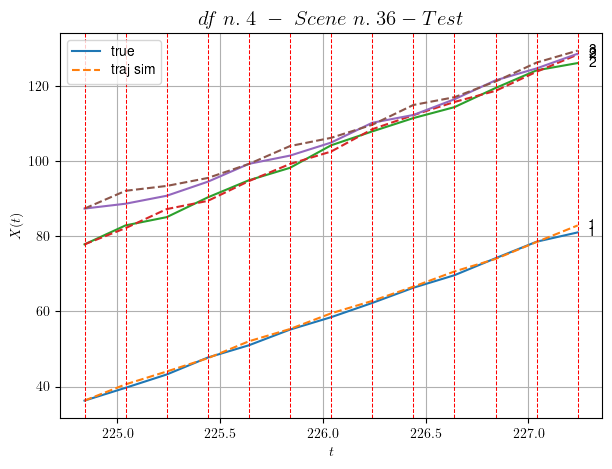

        For scene 36/63:
        * MSE = 1.6851276322645987
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.37/63


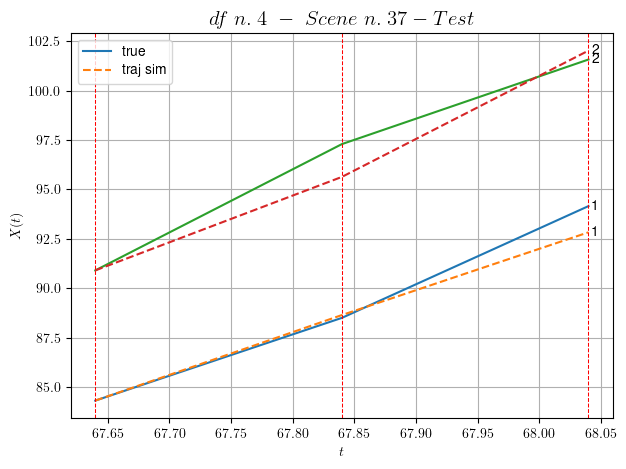

        For scene 37/63:
        * MSE = 0.7909493787088582
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.38/63


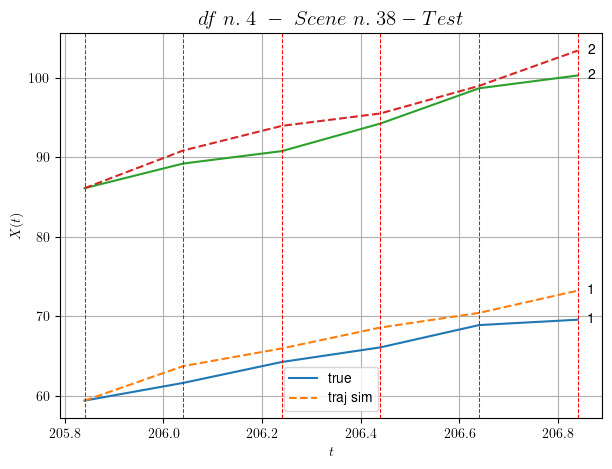

        For scene 38/63:
        * MSE = 4.461306705254032
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.39/63


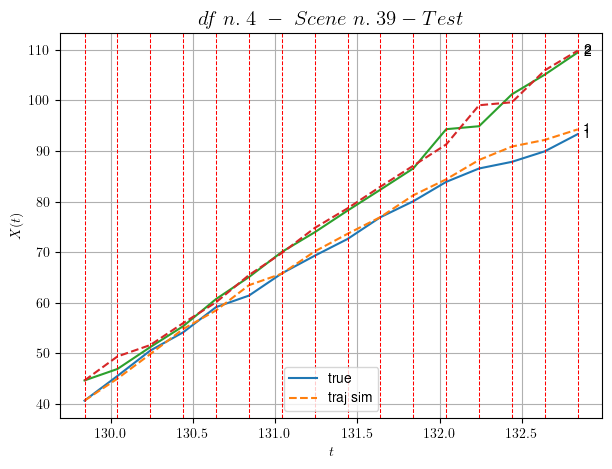

        For scene 39/63:
        * MSE = 2.0512418812514337
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.40/63


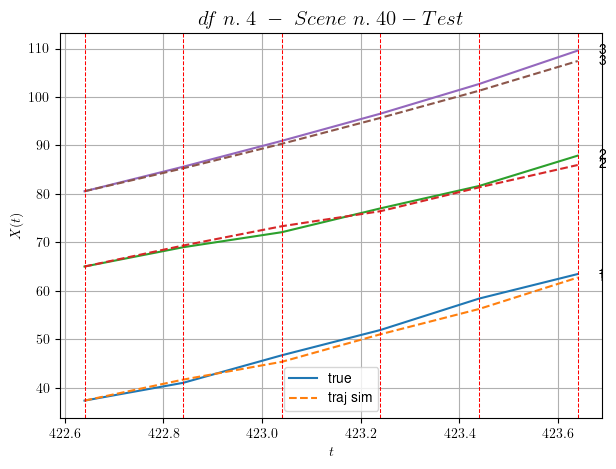

        For scene 40/63:
        * MSE = 1.2086839917469765
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.41/63


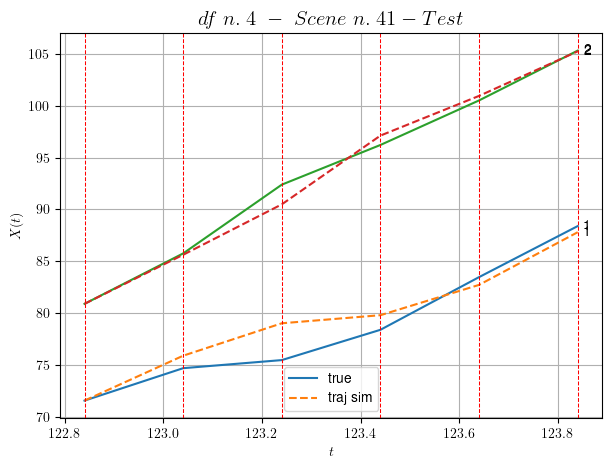

        For scene 41/63:
        * MSE = 1.8018151715940178
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.42/63


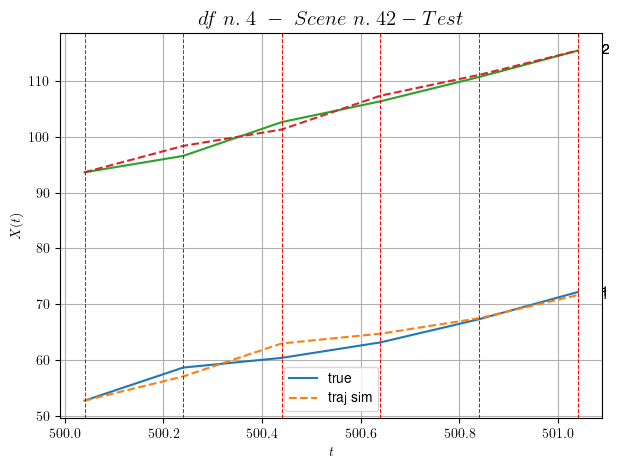

        For scene 42/63:
        * MSE = 1.5120535262925878
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.43/63


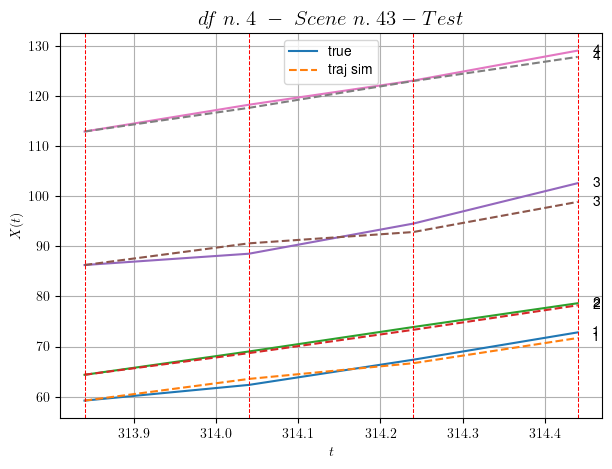

        For scene 43/63:
        * MSE = 1.6778791670562543
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.44/63


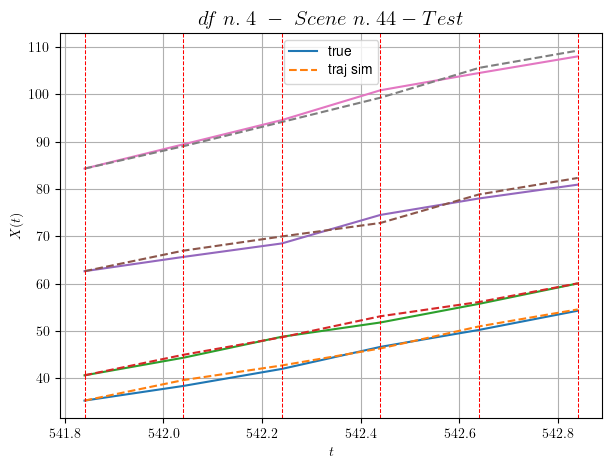

        For scene 44/63:
        * MSE = 0.8364245424919521
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.45/63


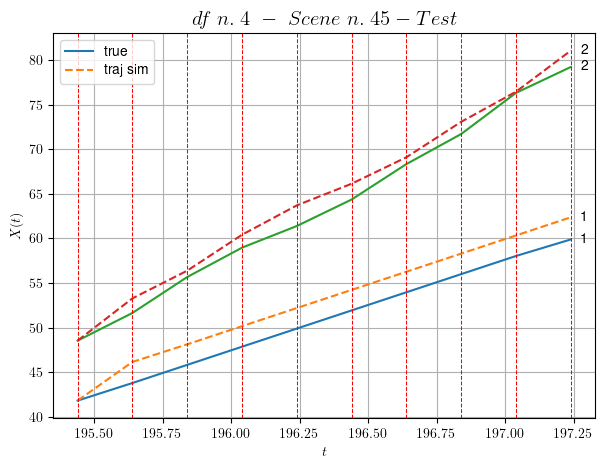

        For scene 45/63:
        * MSE = 3.4171739059672435
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.46/63


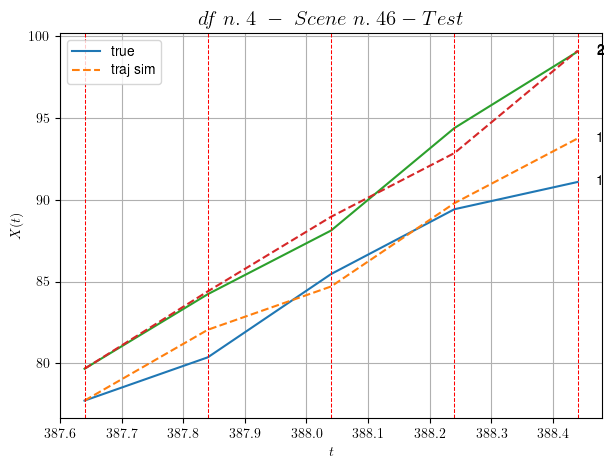

        For scene 46/63:
        * MSE = 1.374553637895023
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.47/63


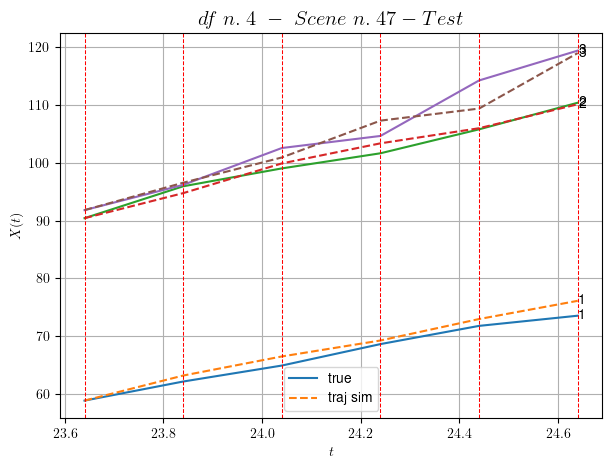

        For scene 47/63:
        * MSE = 2.8205427478227136
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.48/63


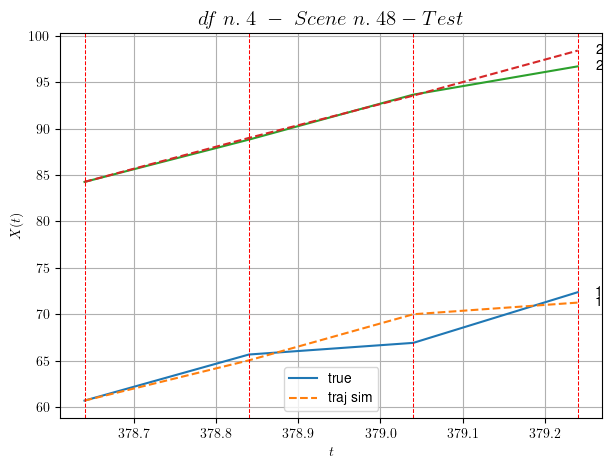

        For scene 48/63:
        * MSE = 1.7552870830066494
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.49/63


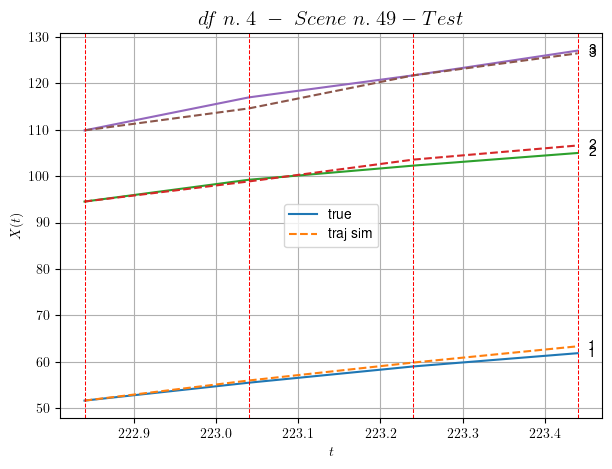

        For scene 49/63:
        * MSE = 1.1253588490991693
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.50/63


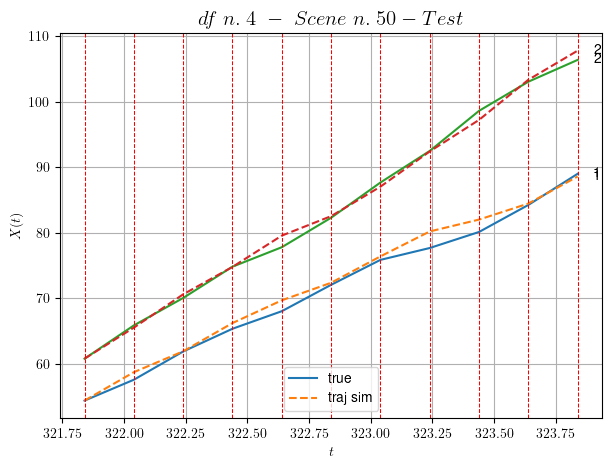

        For scene 50/63:
        * MSE = 1.0617940570815265
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.51/63


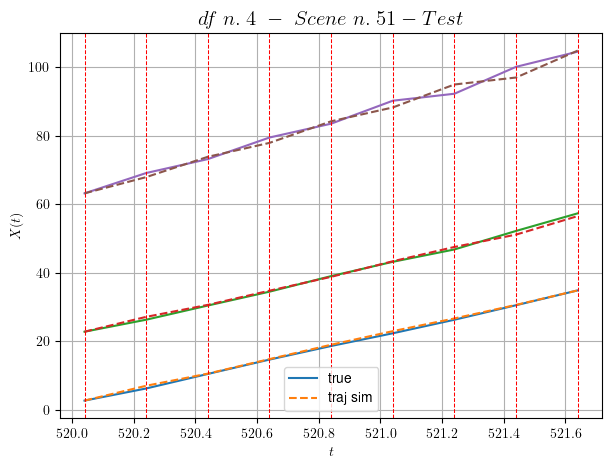

        For scene 51/63:
        * MSE = 1.121365884534703
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.52/63


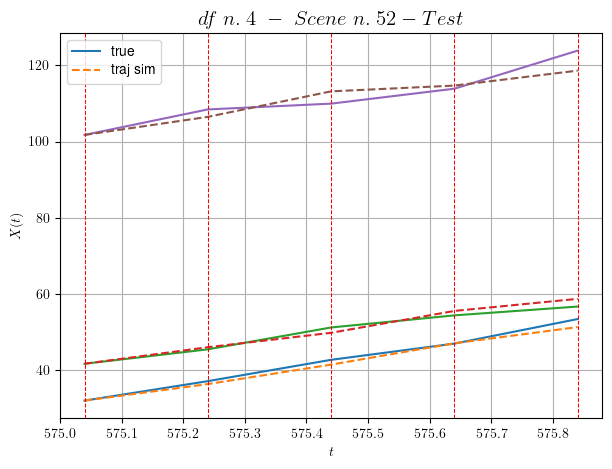

        For scene 52/63:
        * MSE = 3.774877487795546
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.53/63


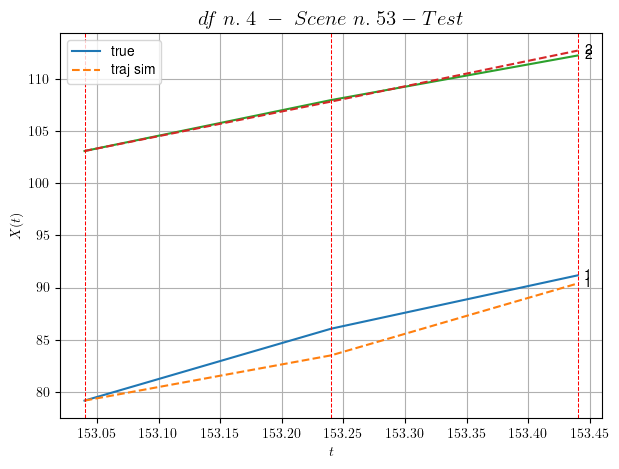

        For scene 53/63:
        * MSE = 1.227068975023248
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.54/63


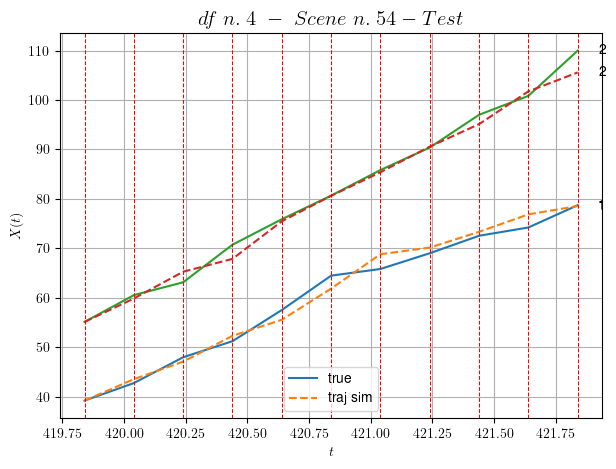

        For scene 54/63:
        * MSE = 3.128304600796511
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.55/63


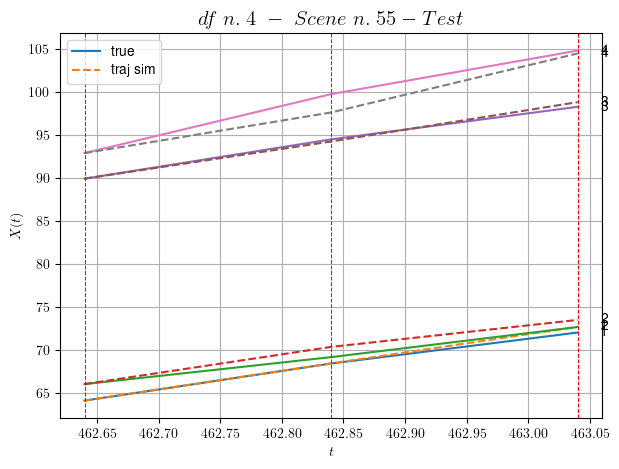

        For scene 55/63:
        * MSE = 0.6311422458080784
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.56/63


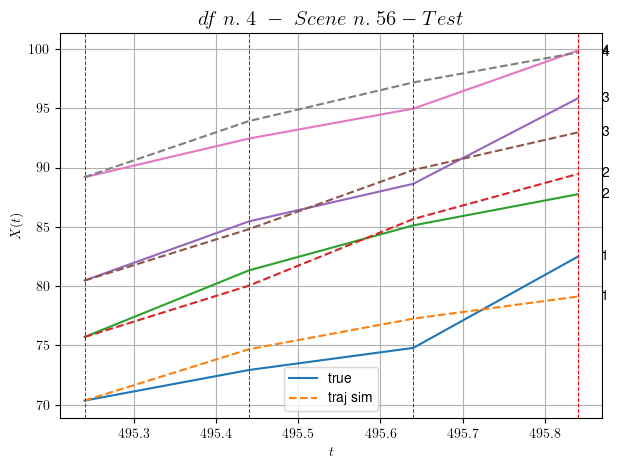

        For scene 56/63:
        * MSE = 2.6508288839944063
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.57/63


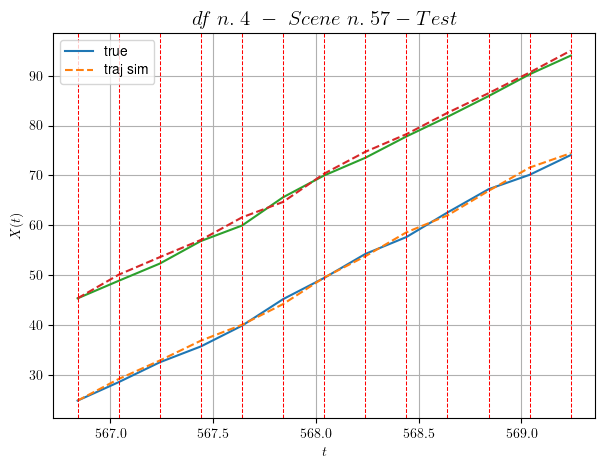

        For scene 57/63:
        * MSE = 0.665978811541181
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.58/63


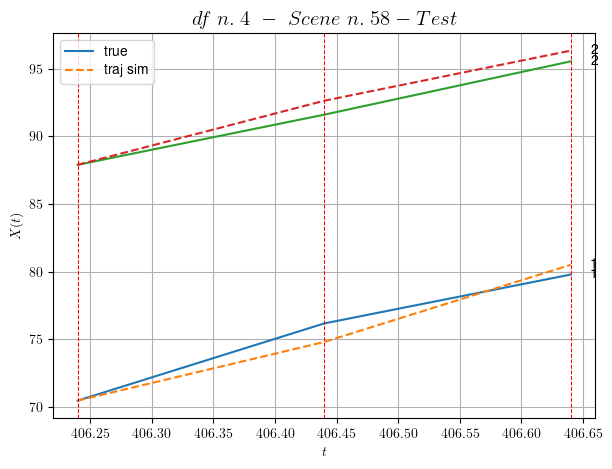

        For scene 58/63:
        * MSE = 0.6808088236848431
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.59/63


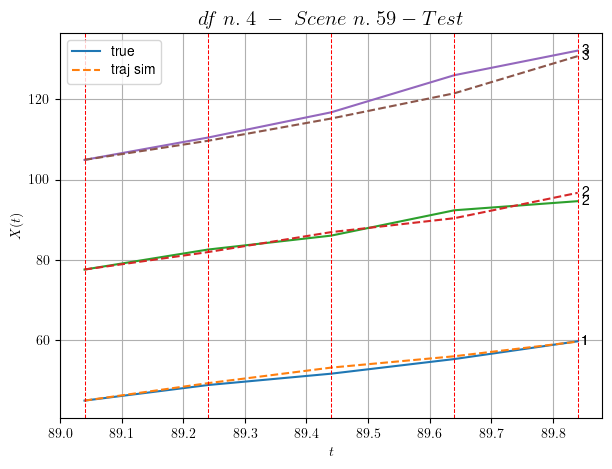

        For scene 59/63:
        * MSE = 2.494764928730001
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.60/63


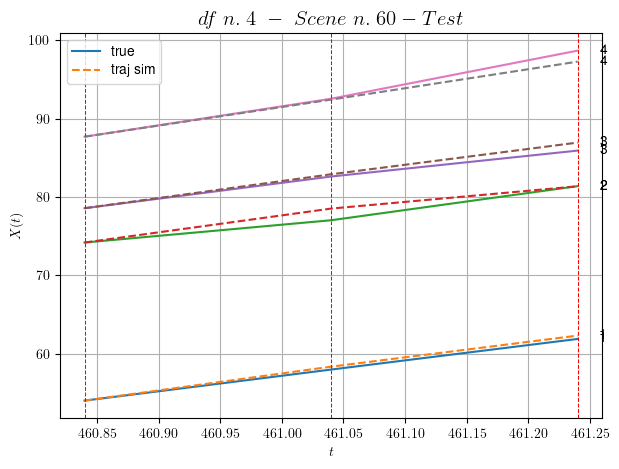

        For scene 60/63:
        * MSE = 0.4705956519511381
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.61/63


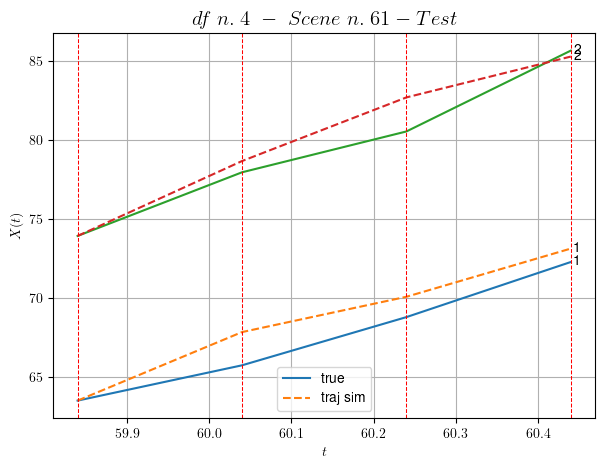

        For scene 61/63:
        * MSE = 1.5092878480116982
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.62/63


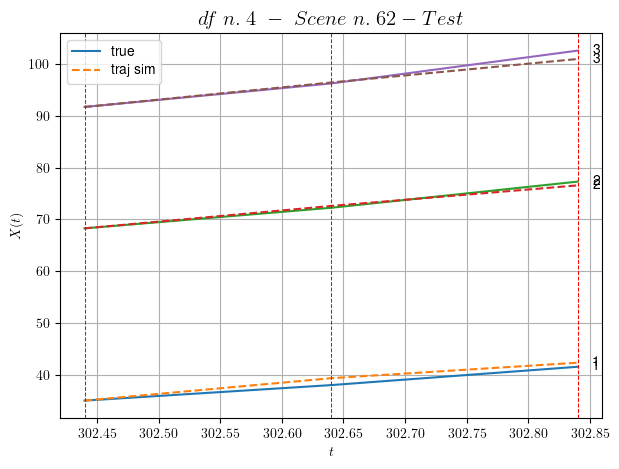

        For scene 62/63:
        * MSE = 0.6339242463054217
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.63/63


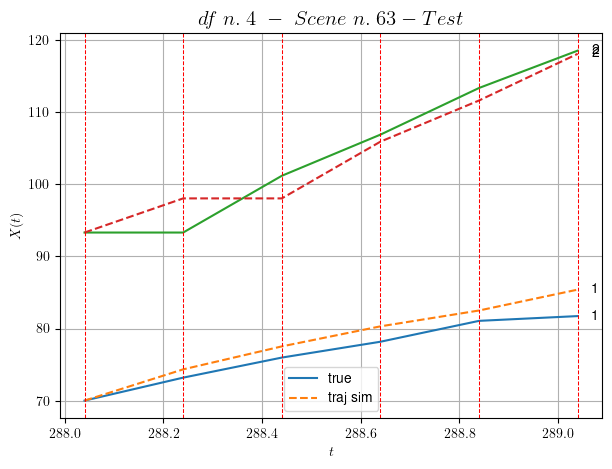

        For scene 63/63:
        * MSE = 5.02087930984654
----------------------------------------------------------------------------------------------------


MSE test: 1.8434477990044769

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 1.6980024125816593
          * MSE test: 1.8434477990044769
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 5/10 dfs.
In DataFrame n.5 we have 66 scenes.
    To train the model we use 6 scenes, the remaining 60 to test the model.

Training step. (6 scenes)
DataFrame n.5. Scene n.1/6
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [226.72,227.92]


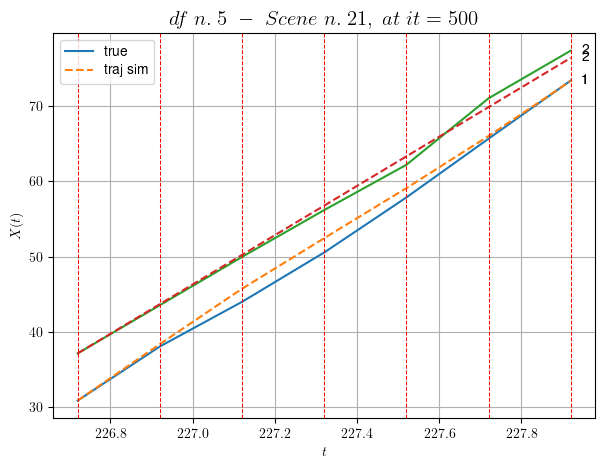

----------------------------------------------------------------------------------------------------
        For scene 1/6:
        * After LR finder: LR_NN=0.01 with mse=2.7229745390674536 at it=24
        * v0 = 32.69366457961451
        * MSE = 0.5223743055989165
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.2/6
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [330.12,330.52]


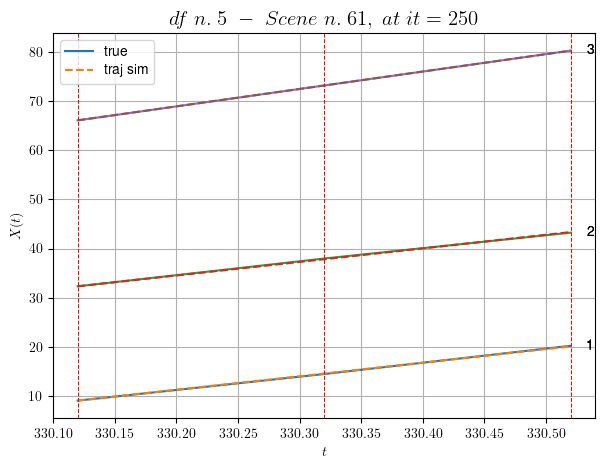

----------------------------------------------------------------------------------------------------
        For scene 2/6:
        * After LR finder: LR_NN=0.01 with mse=0.6737367516088048 at it=24
        * v0 = 35.47750160163107
        * MSE = 0.006672921966416776
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.3/6
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [78.72,79.32]


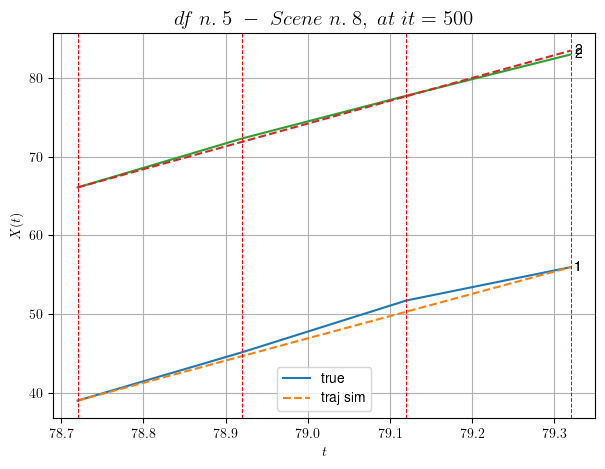

----------------------------------------------------------------------------------------------------
        For scene 3/6:
        * After LR finder: LR_NN=5e-05 with mse=0.4810148544614392 at it=24
        * v0 = 28.965407295611428
        * MSE = 0.3332060441051576
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.4/6
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [449.12,450.12]


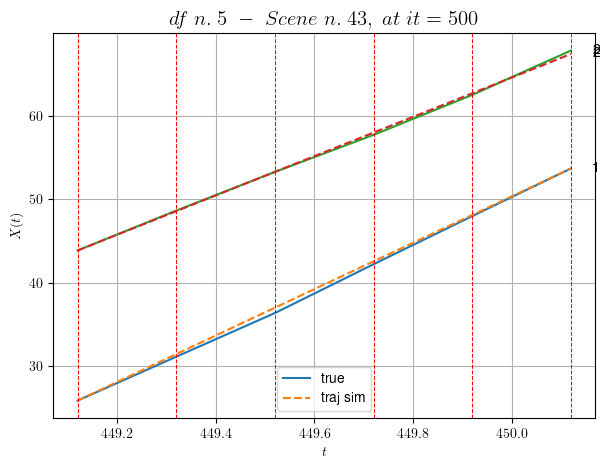

----------------------------------------------------------------------------------------------------
        For scene 4/6:
        * After LR finder: LR_NN=0.001 with mse=7.640267316106977 at it=24
        * v0 = 23.52760427573311
        * MSE = 0.07718823081311804
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.5/6
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [149.92,150.72]


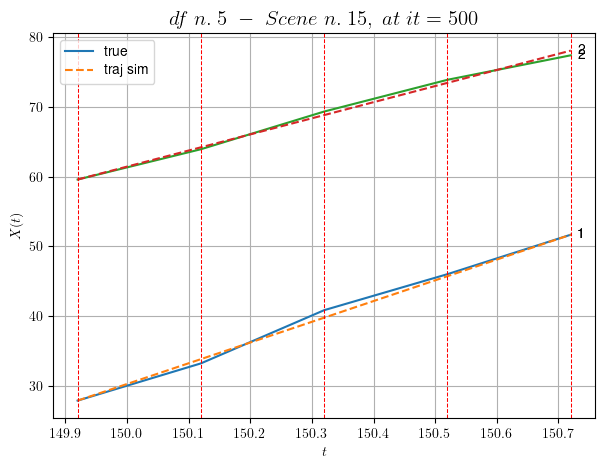

----------------------------------------------------------------------------------------------------
        For scene 5/6:
        * After LR finder: LR_NN=5e-05 with mse=6.142854809702422 at it=24
        * v0 = 23.10299358436158
        * MSE = 0.2590090075121839
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.6/6
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [535.32,535.92]


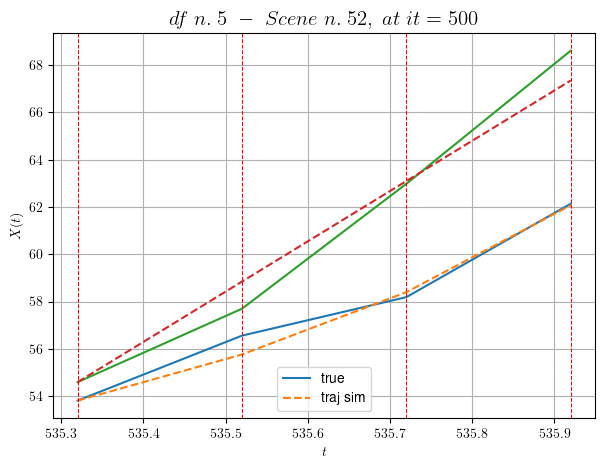

----------------------------------------------------------------------------------------------------
        For scene 6/6:
        * After LR finder: LR_NN=0.005 with mse=4.781062777003891 at it=24
        * v0 = 21.278077520483933
        * MSE = 0.4492575787905673
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.2746180147977267
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (60 scenes)
DataFrame n.5. Scene n.1/60


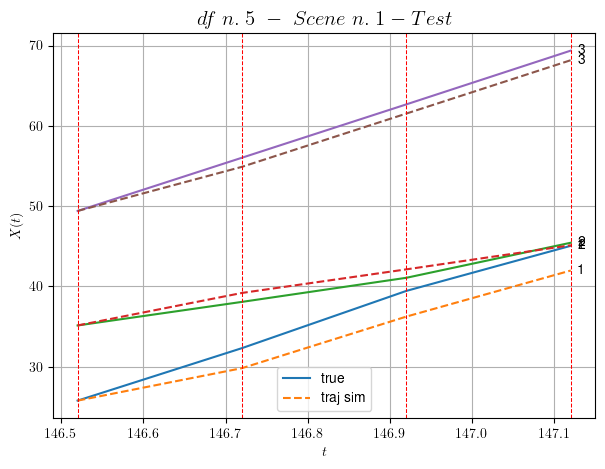

        For scene 1/60:
        * MSE = 2.7027416134169022
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.2/60


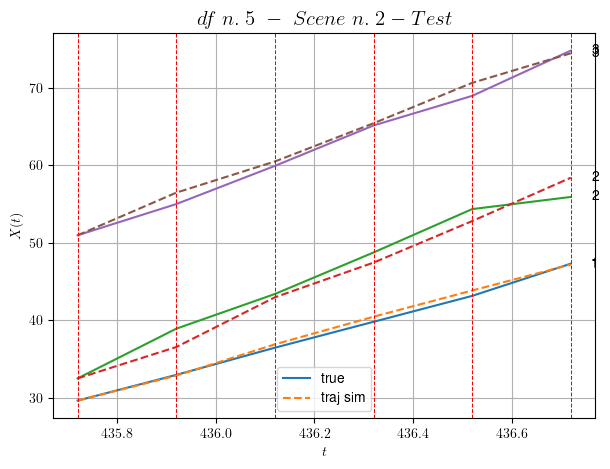

        For scene 2/60:
        * MSE = 1.2615259687082334
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.3/60


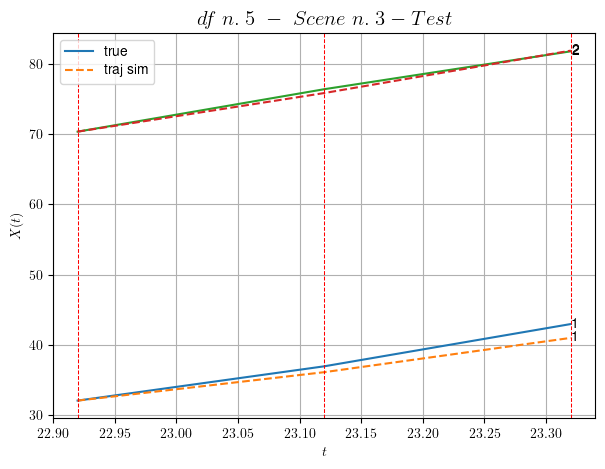

        For scene 3/60:
        * MSE = 0.8166149863486293
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.4/60


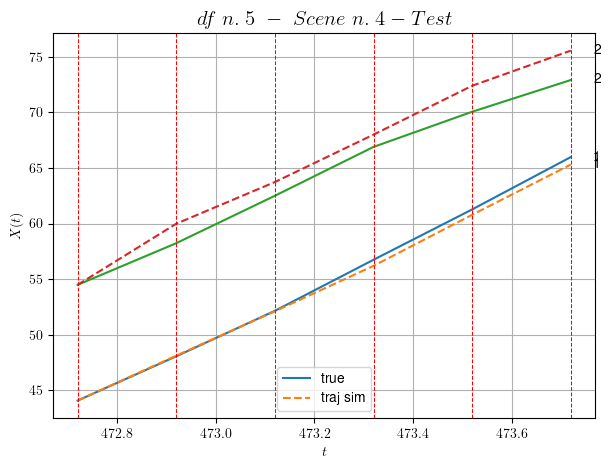

        For scene 4/60:
        * MSE = 1.6062246733489425
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.5/60


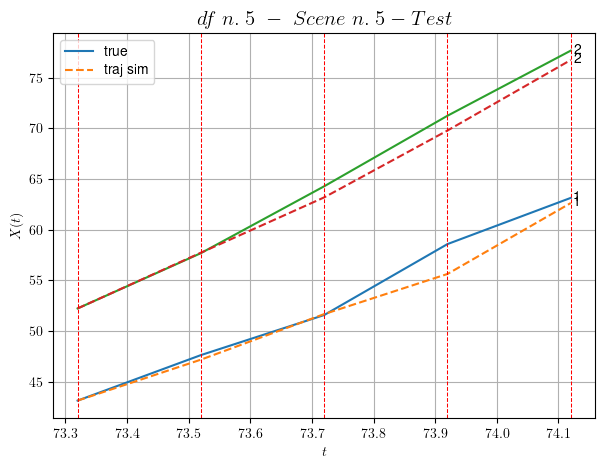

        For scene 5/60:
        * MSE = 1.3346663867734487
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.6/60


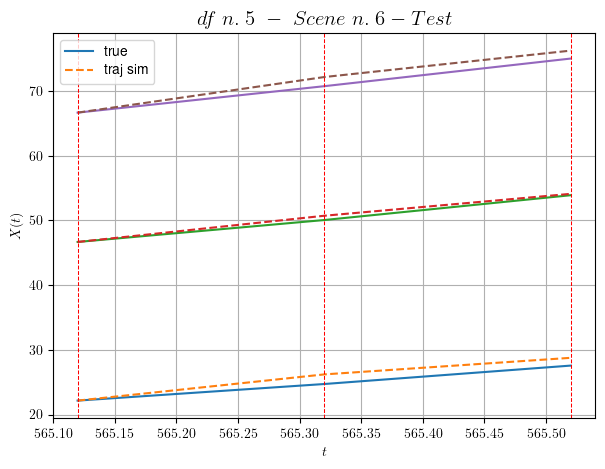

        For scene 6/60:
        * MSE = 0.8489135924879984
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.7/60


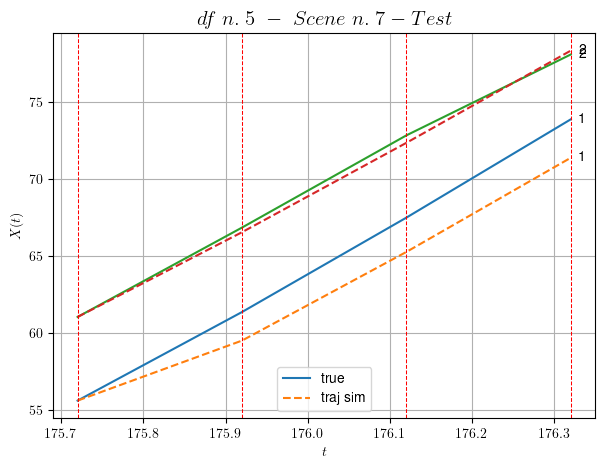

        For scene 7/60:
        * MSE = 1.8764568631199923
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.8/60


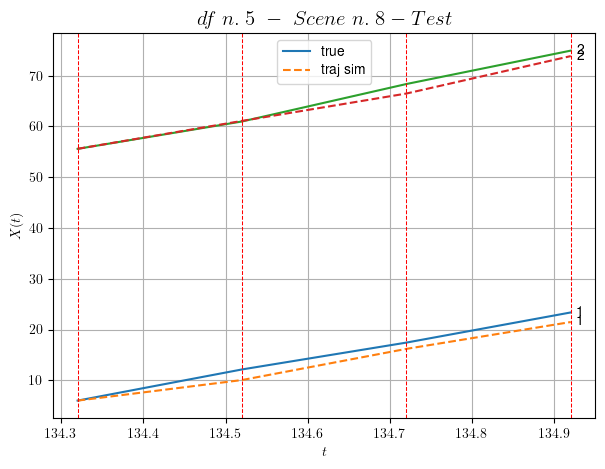

        For scene 8/60:
        * MSE = 1.764407872721339
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.9/60


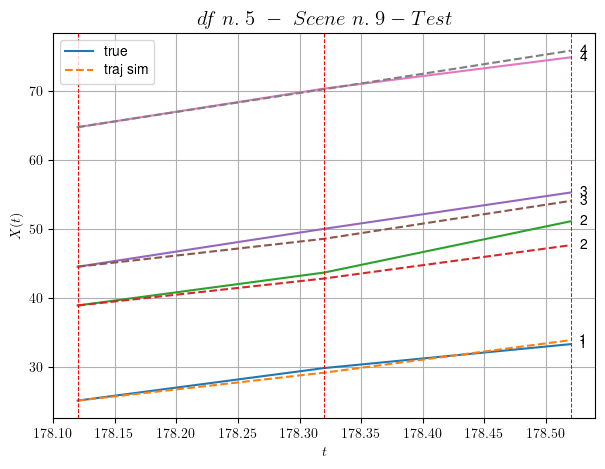

        For scene 9/60:
        * MSE = 1.5027046817411422
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.10/60


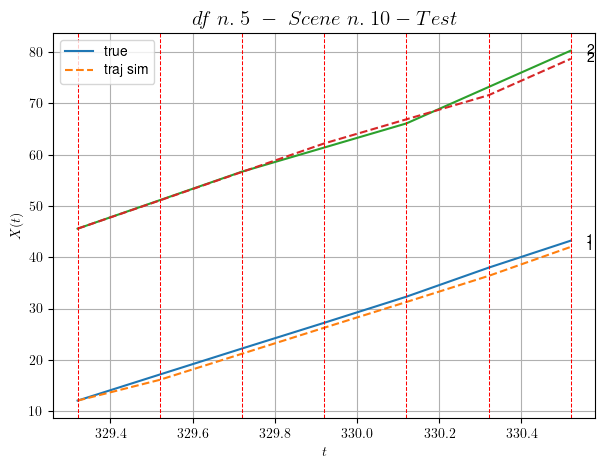

        For scene 10/60:
        * MSE = 1.0369934805110552
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.11/60


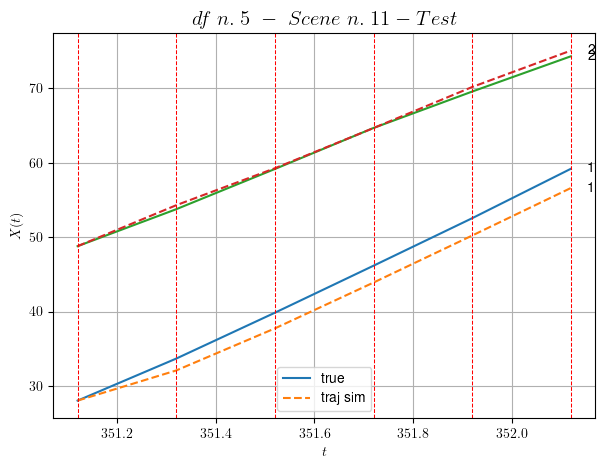

        For scene 11/60:
        * MSE = 2.1217263531683535
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.12/60


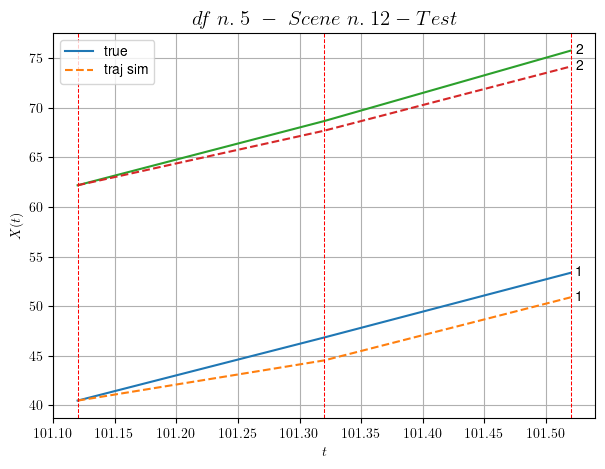

        For scene 12/60:
        * MSE = 2.4904424881573735
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.13/60


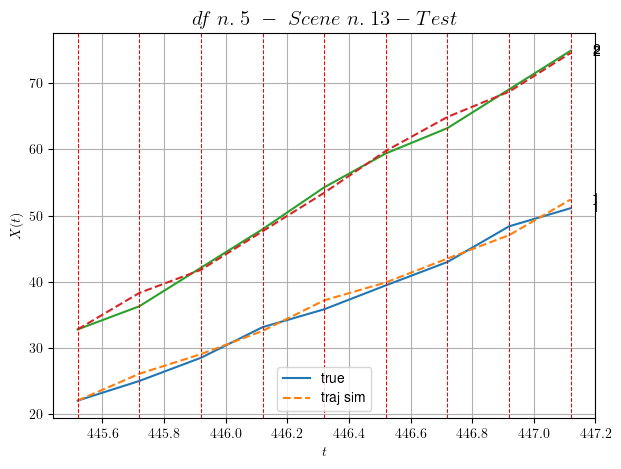

        For scene 13/60:
        * MSE = 0.8728856812947966
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.14/60


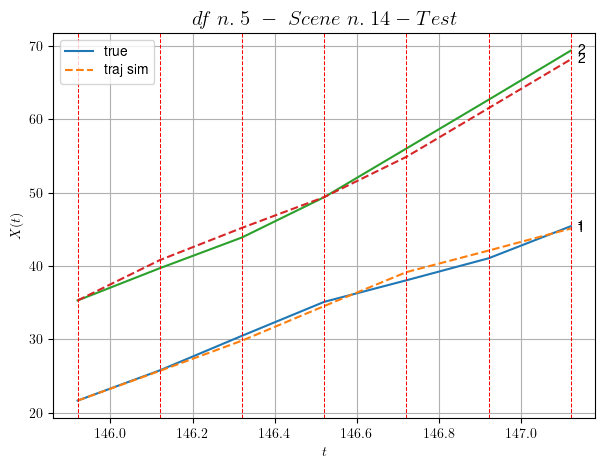

        For scene 14/60:
        * MSE = 0.7267235816695002
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.15/60


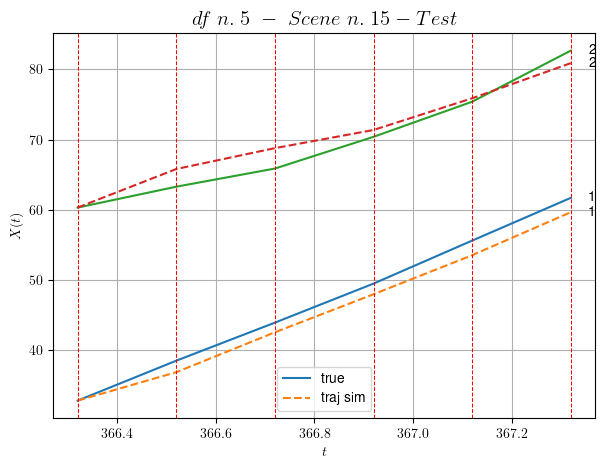

        For scene 15/60:
        * MSE = 2.889441074826003
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.16/60


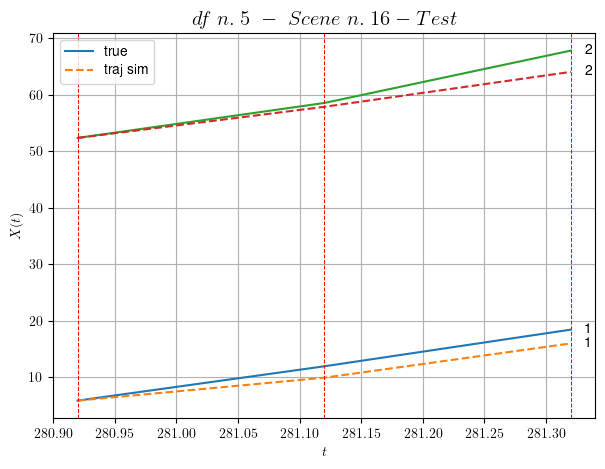

        For scene 16/60:
        * MSE = 4.105779096127603
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.17/60


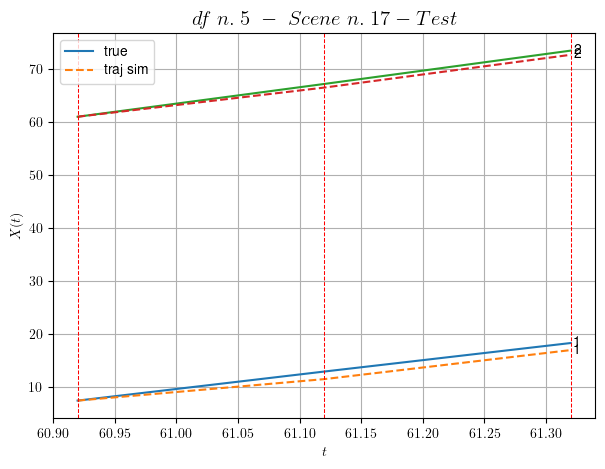

        For scene 17/60:
        * MSE = 0.8185410372694234
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.18/60


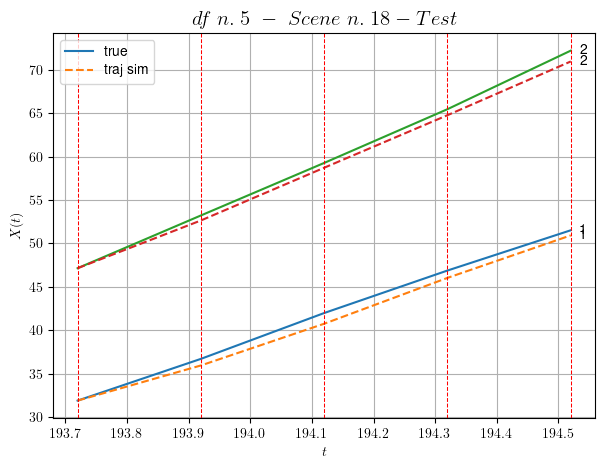

        For scene 18/60:
        * MSE = 0.5842261433602141
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.19/60


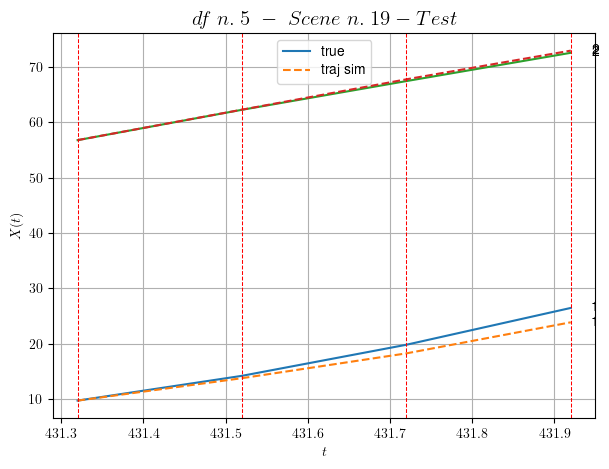

        For scene 19/60:
        * MSE = 1.199143885194417
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.20/60


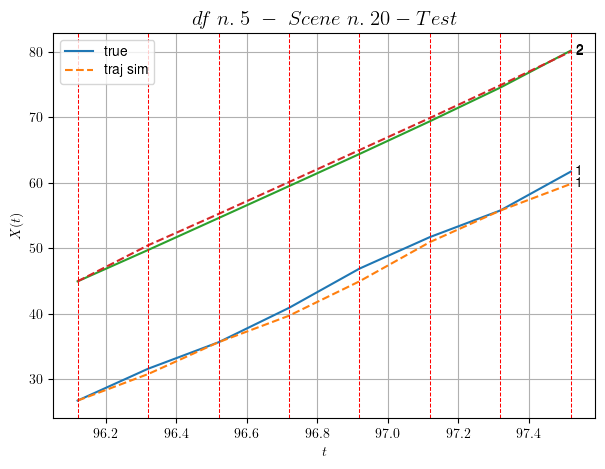

        For scene 20/60:
        * MSE = 0.7519301424777851
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.21/60


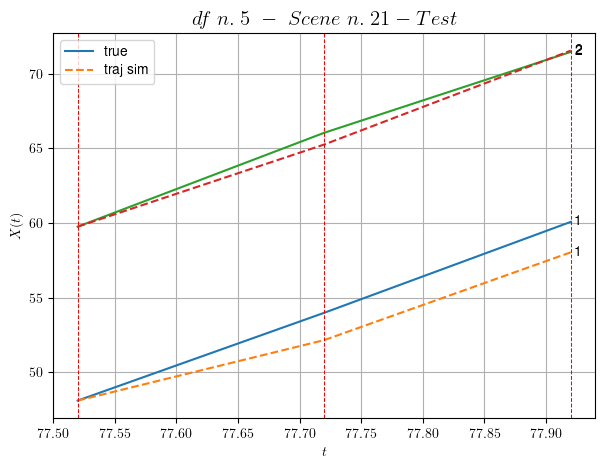

        For scene 21/60:
        * MSE = 1.3529059877926362
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.22/60


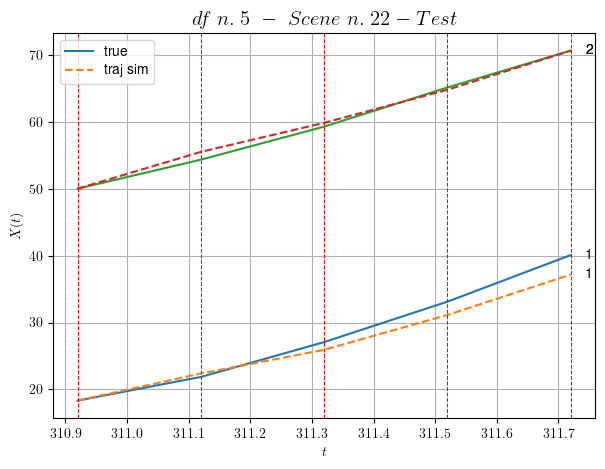

        For scene 22/60:
        * MSE = 1.5798969566988745
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.23/60


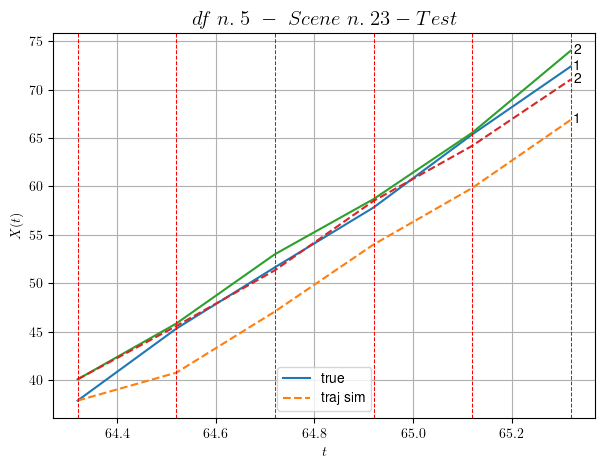

        For scene 23/60:
        * MSE = 10.889273416705102
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.24/60


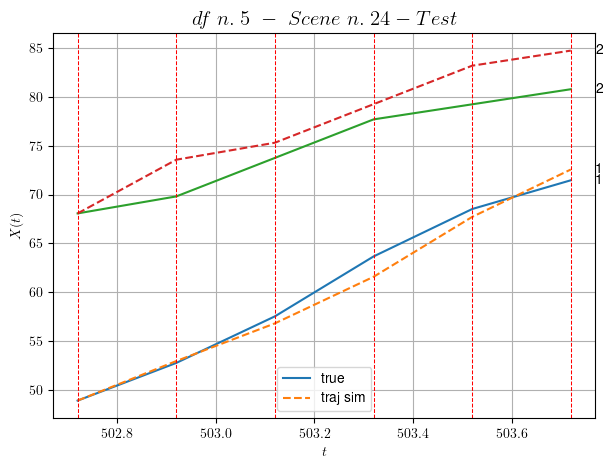

        For scene 24/60:
        * MSE = 4.755109520389065
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.25/60


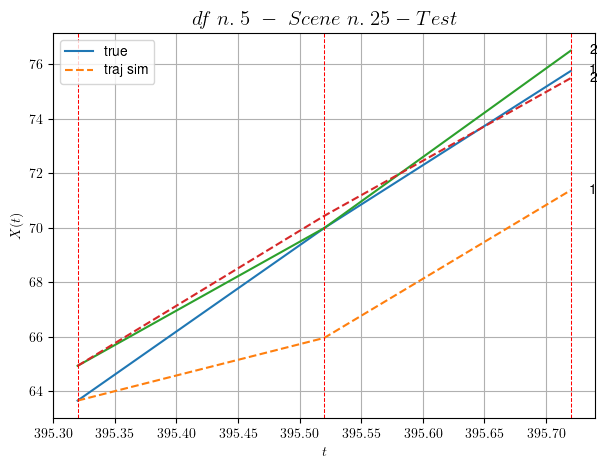

        For scene 25/60:
        * MSE = 6.099191412451633
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.26/60


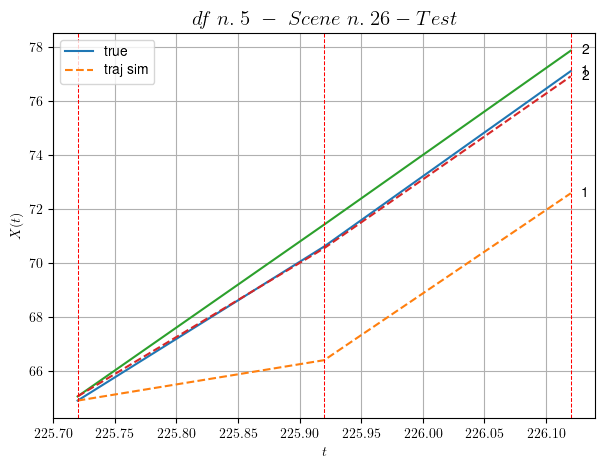

        For scene 26/60:
        * MSE = 6.674582101906527
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.27/60


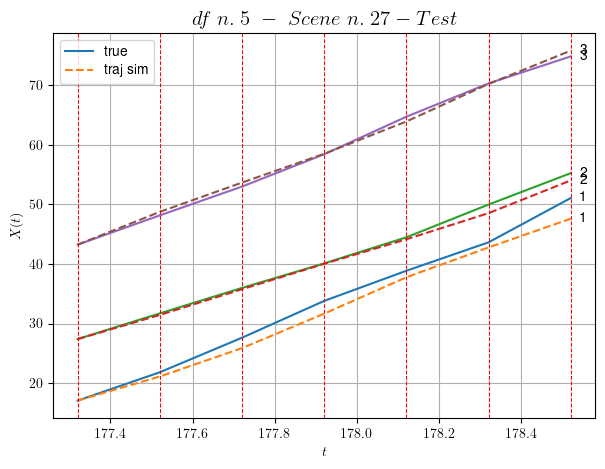

        For scene 27/60:
        * MSE = 1.3465245156269383
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.28/60


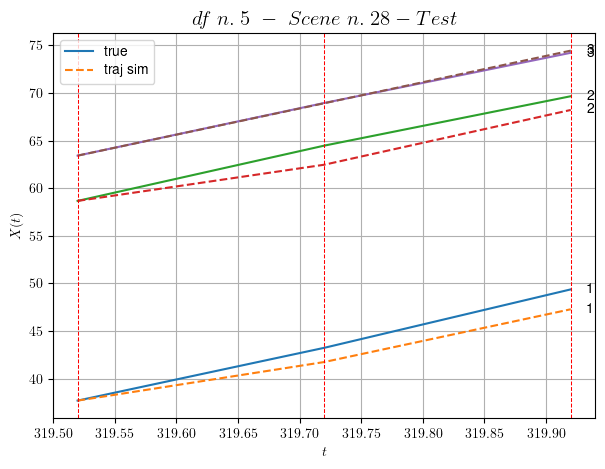

        For scene 28/60:
        * MSE = 1.4160857748230364
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.29/60


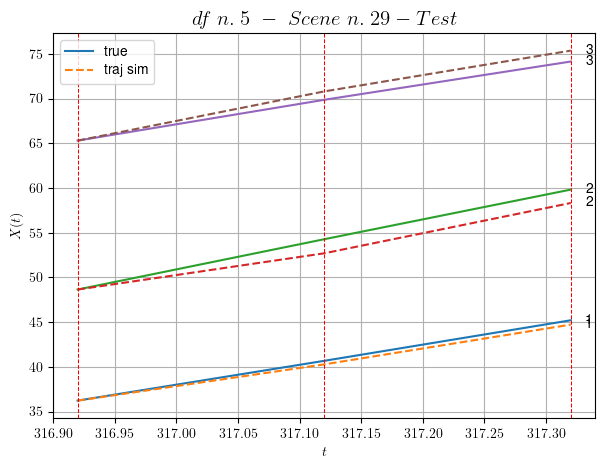

        For scene 29/60:
        * MSE = 0.8314691058722524
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.30/60


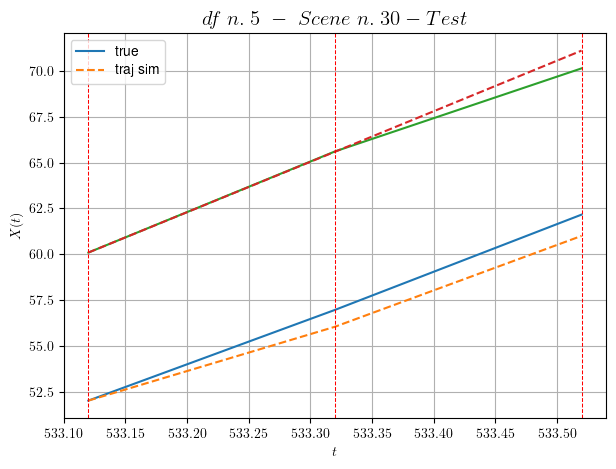

        For scene 30/60:
        * MSE = 0.522177334375751
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.31/60


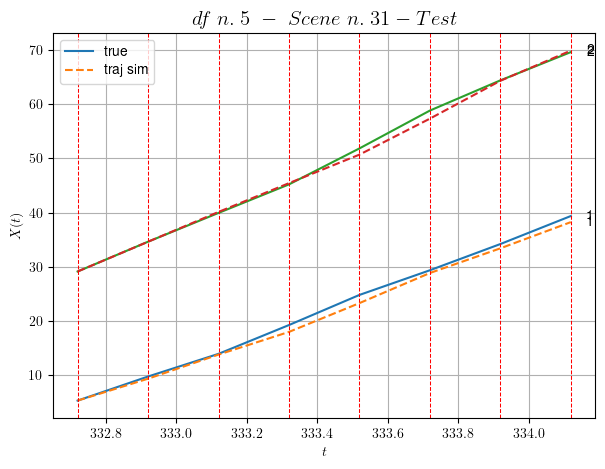

        For scene 31/60:
        * MSE = 0.6222541468713673
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.32/60


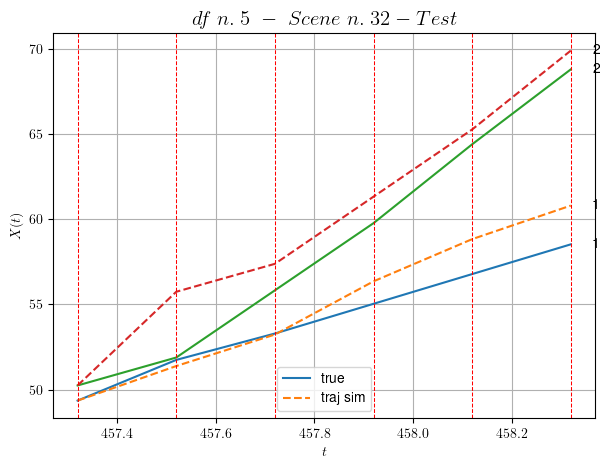

        For scene 32/60:
        * MSE = 2.748666041565146
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.33/60


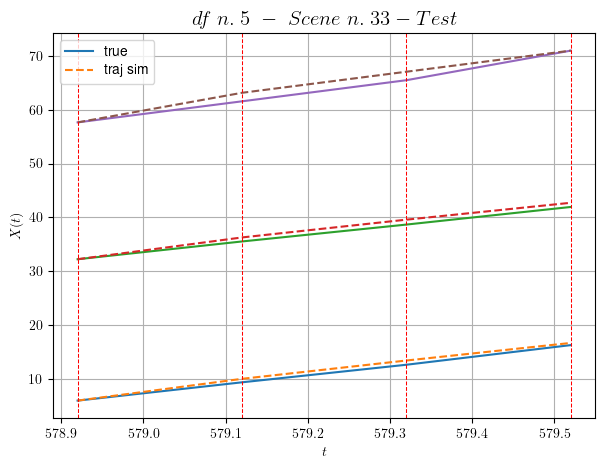

        For scene 33/60:
        * MSE = 0.6826213912521116
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.34/60


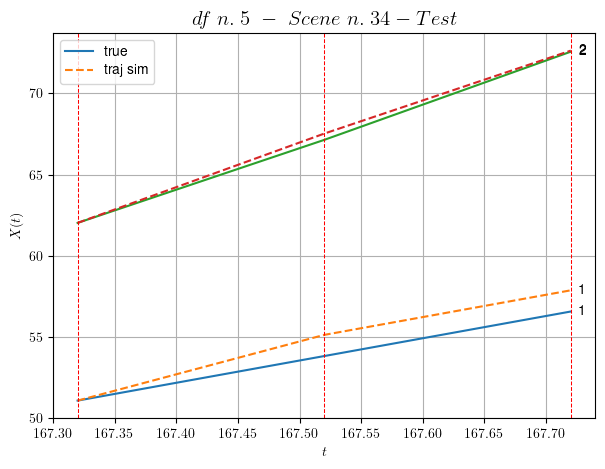

        For scene 34/60:
        * MSE = 0.5935350501445772
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.35/60


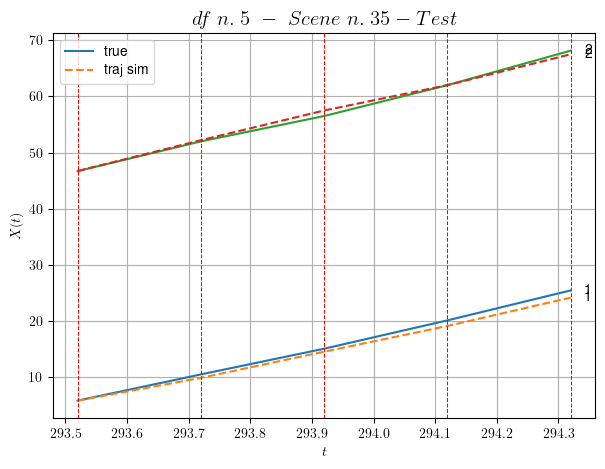

        For scene 35/60:
        * MSE = 0.4733223984890434
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.36/60


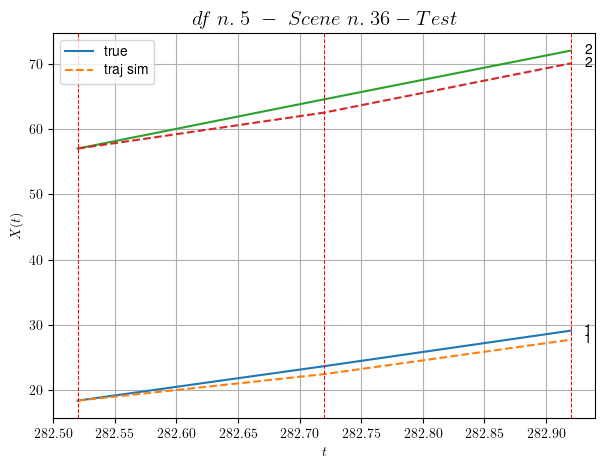

        For scene 36/60:
        * MSE = 1.89112364200232
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.37/60


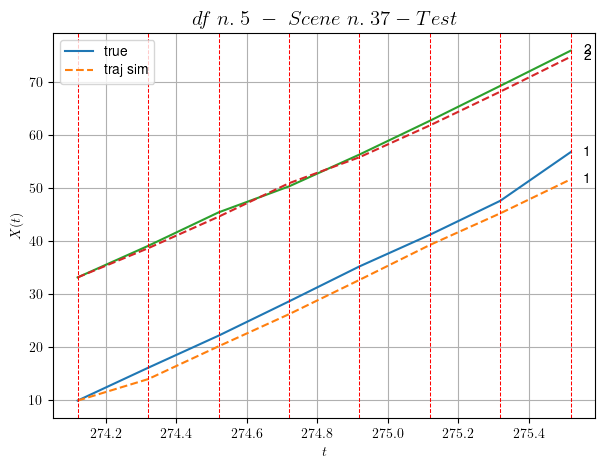

        For scene 37/60:
        * MSE = 3.836836475410925
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.38/60


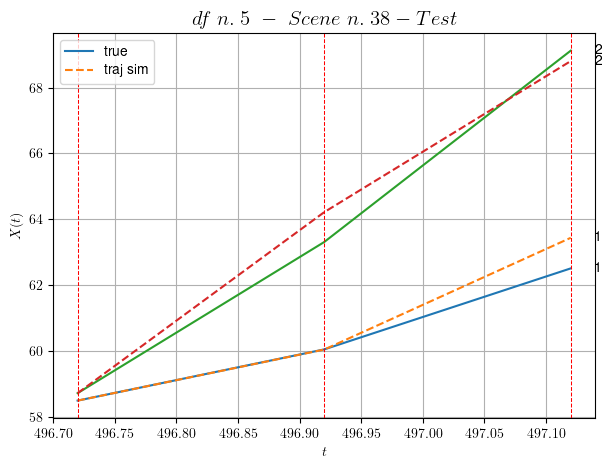

        For scene 38/60:
        * MSE = 0.2979949812864359
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.39/60


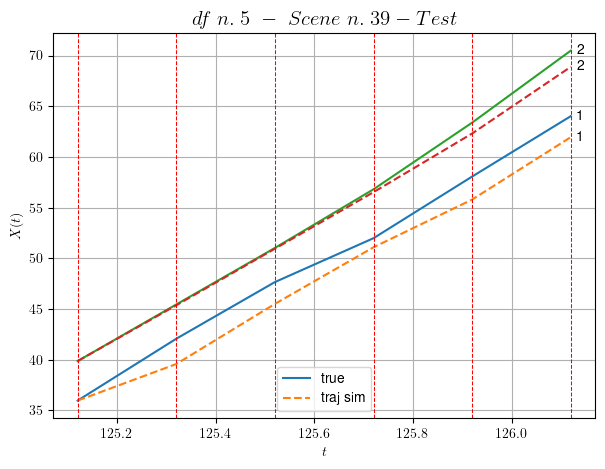

        For scene 39/60:
        * MSE = 2.073834475837733
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.40/60


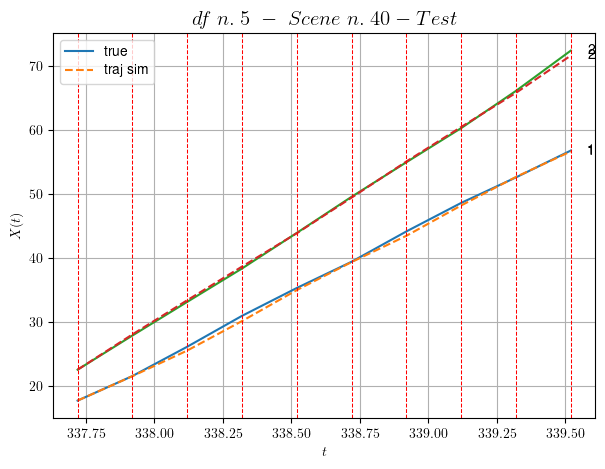

        For scene 40/60:
        * MSE = 0.13610415273597948
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.41/60


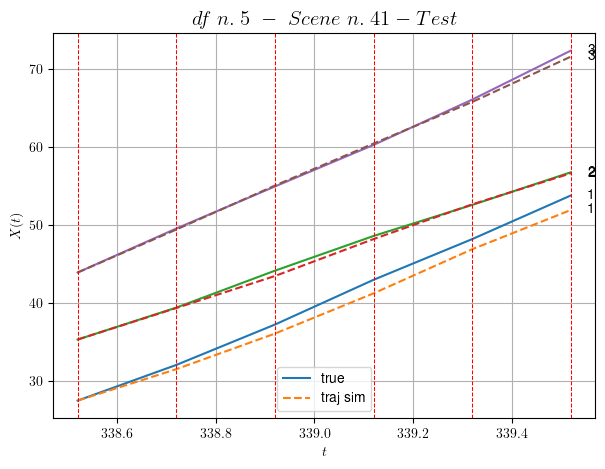

        For scene 41/60:
        * MSE = 0.6218578886803948
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.42/60


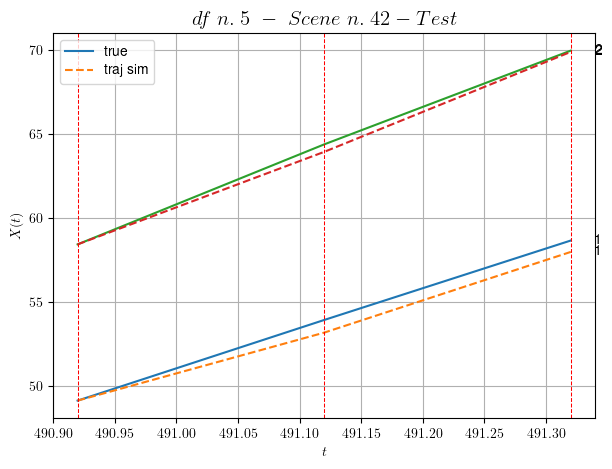

        For scene 42/60:
        * MSE = 0.20459900754438076
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.43/60


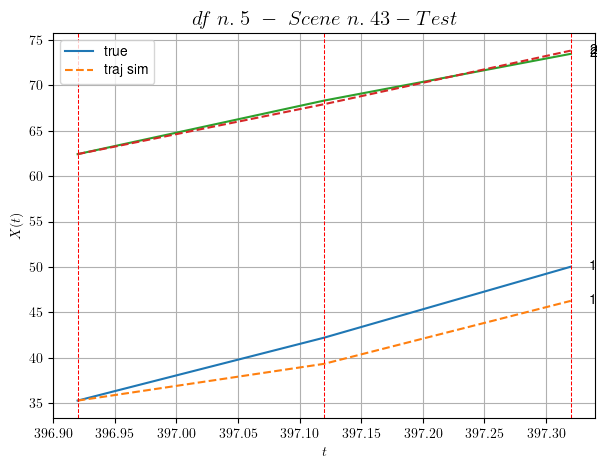

        For scene 43/60:
        * MSE = 3.7871580819652957
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.44/60


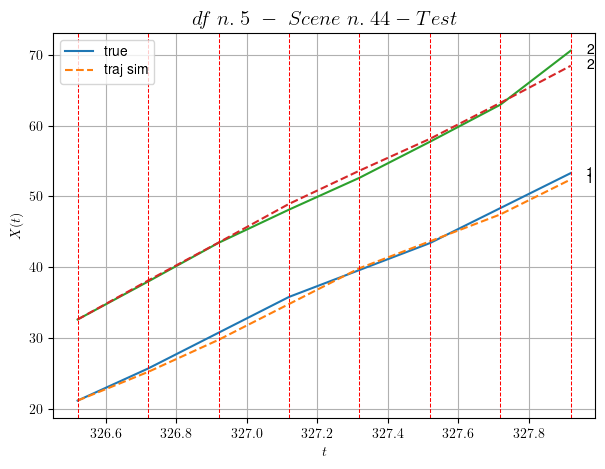

        For scene 44/60:
        * MSE = 0.6549052710135066
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.45/60


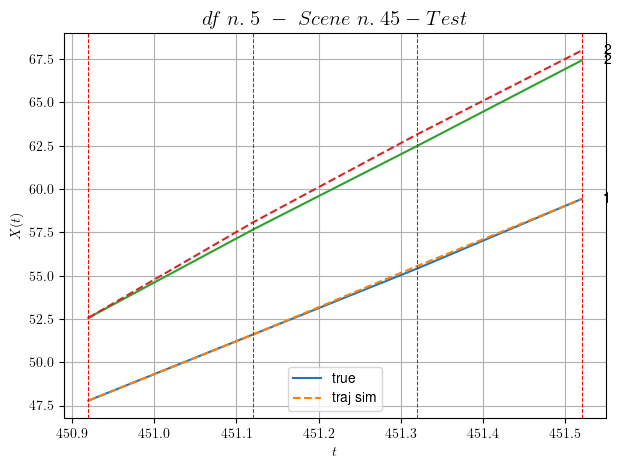

        For scene 45/60:
        * MSE = 0.12067044381687292
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.46/60


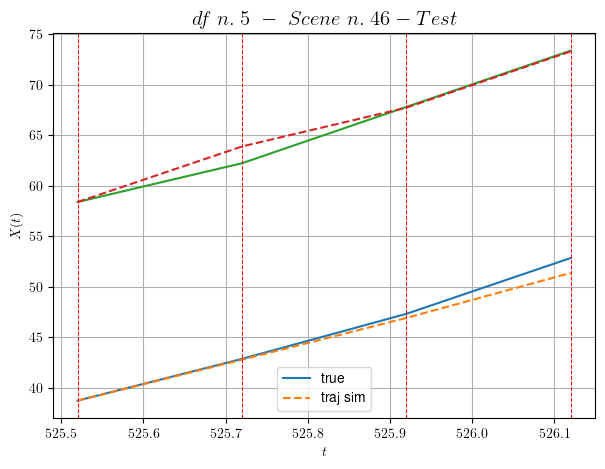

        For scene 46/60:
        * MSE = 0.6411094338309067
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.47/60


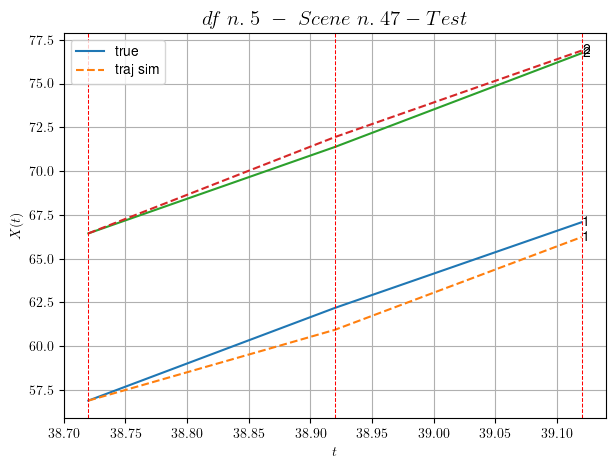

        For scene 47/60:
        * MSE = 0.43750746856893497
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.48/60


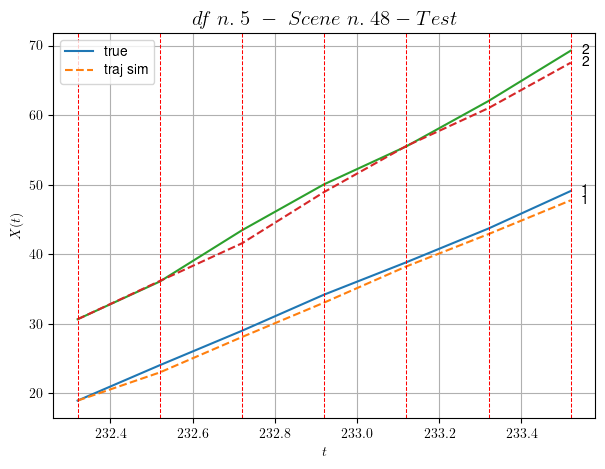

        For scene 48/60:
        * MSE = 1.056637090423945
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.49/60


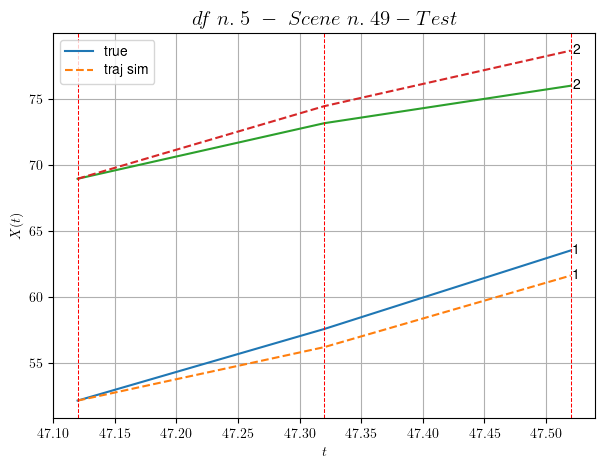

        For scene 49/60:
        * MSE = 2.3773493187458055
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.50/60


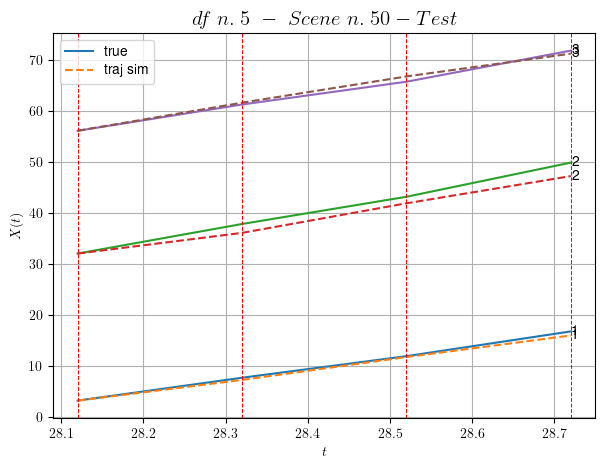

        For scene 50/60:
        * MSE = 1.1679822701256974
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.51/60


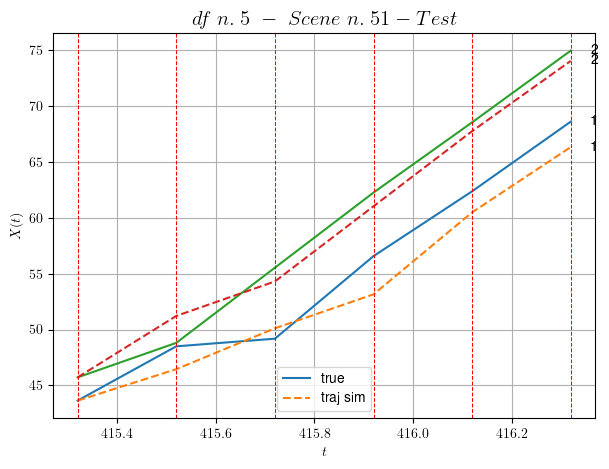

        For scene 51/60:
        * MSE = 2.9833339898941214
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.52/60


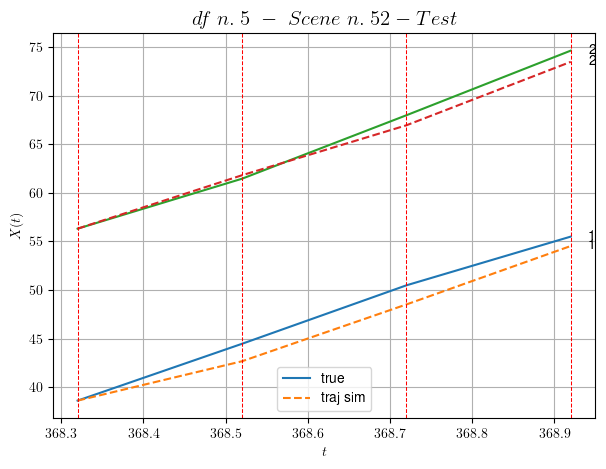

        For scene 52/60:
        * MSE = 1.3224705531857555
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.53/60


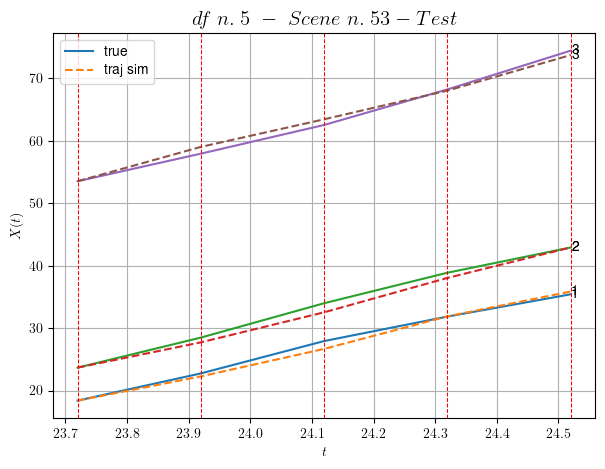

        For scene 53/60:
        * MSE = 0.5273133386509725
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.54/60


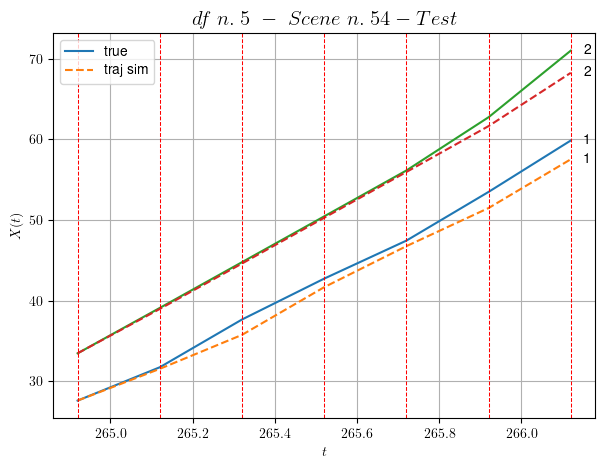

        For scene 54/60:
        * MSE = 1.683329423271621
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.55/60


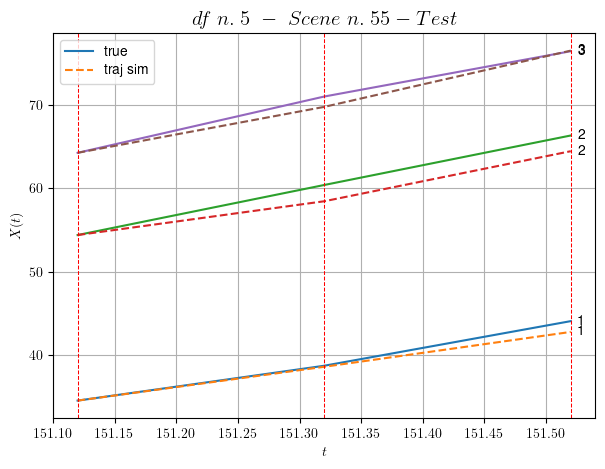

        For scene 55/60:
        * MSE = 1.1737311090909135
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.56/60


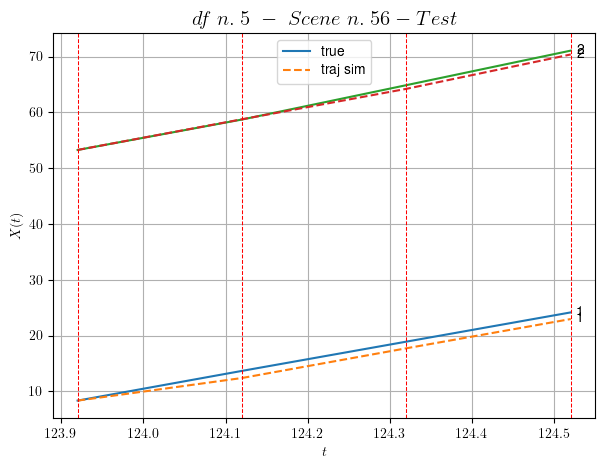

        For scene 56/60:
        * MSE = 0.671699291476445
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.57/60


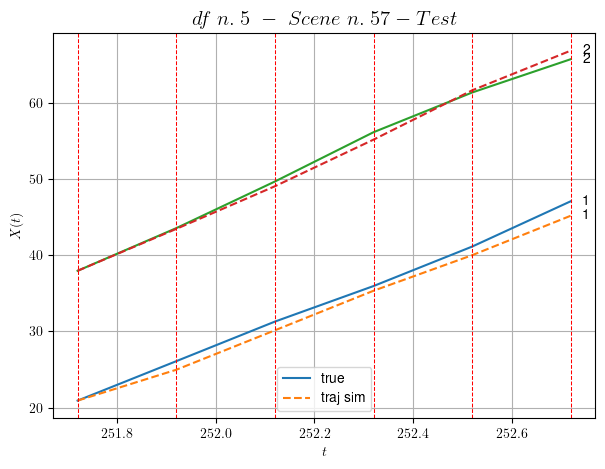

        For scene 57/60:
        * MSE = 0.880691674604879
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.58/60


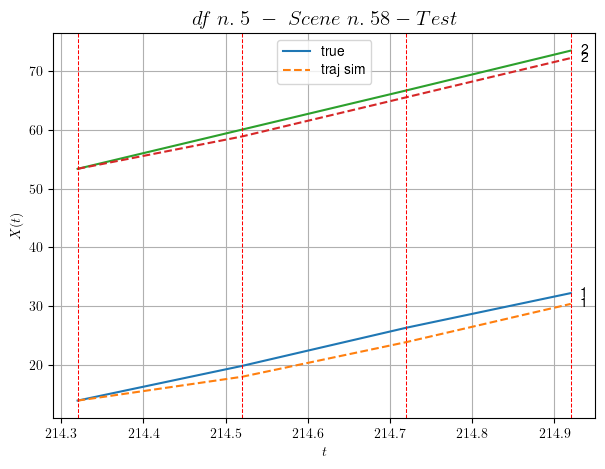

        For scene 58/60:
        * MSE = 2.130472458855299
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.59/60


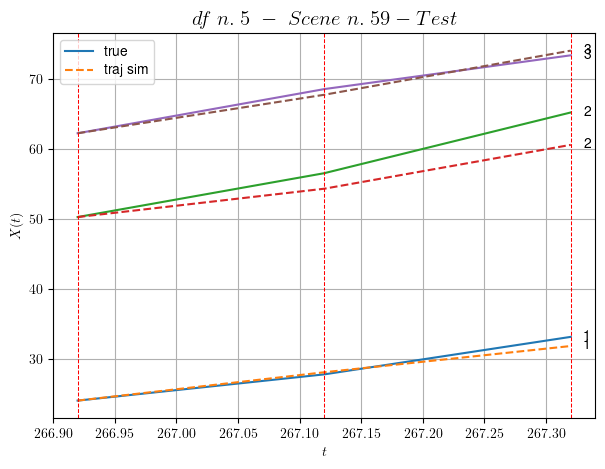

        For scene 59/60:
        * MSE = 3.25137490653232
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.60/60


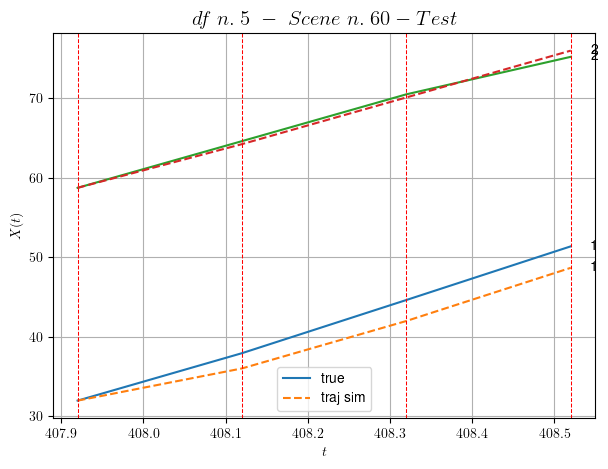

        For scene 60/60:
        * MSE = 2.3599595889791876
----------------------------------------------------------------------------------------------------


MSE test: 1.8031625182369644

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.2746180147977267
          * MSE test: 1.8031625182369644
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 6/10 dfs.
In DataFrame n.6 we have 52 scenes.
    To train the model we use 5 scenes, the remaining 47 to test the model.

Training step. (5 scenes)
DataFrame n.6. Scene n.1/5
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [86.60,87.40]


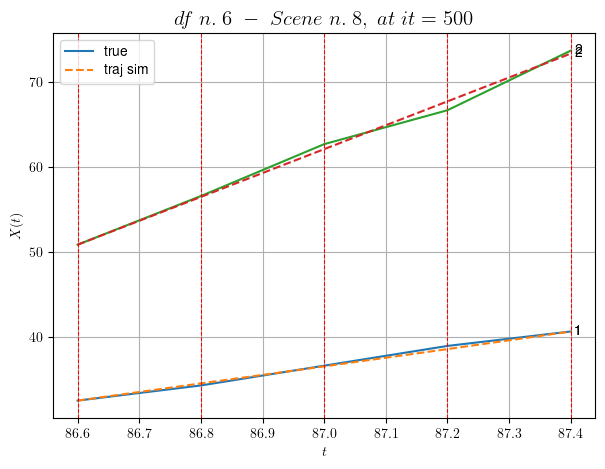

----------------------------------------------------------------------------------------------------
        For scene 1/5:
        * After LR finder: LR_NN=0.005 with mse=0.6119650939040876 at it=24
        * v0 = 28.176915163685493
        * MSE = 0.17788439803236644
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.2/5
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [493.80,494.40]


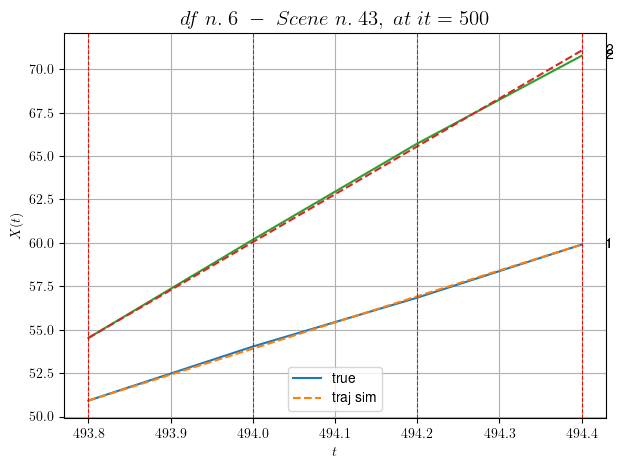

----------------------------------------------------------------------------------------------------
        For scene 2/5:
        * After LR finder: LR_NN=0.005 with mse=0.4840691286460895 at it=24
        * v0 = 27.57702754451529
        * MSE = 0.019570493991155874
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.3/5
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [162.20,163.60]


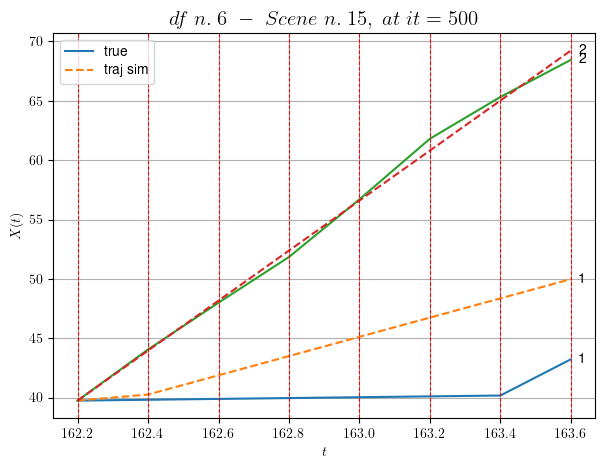

----------------------------------------------------------------------------------------------------
        For scene 3/5:
        * After LR finder: LR_NN=1e-05 with mse=28.86796628220094 at it=24
        * v0 = 21.059787487615633
        * MSE = 12.575814598628195
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.4/5
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [368.20,369.20]


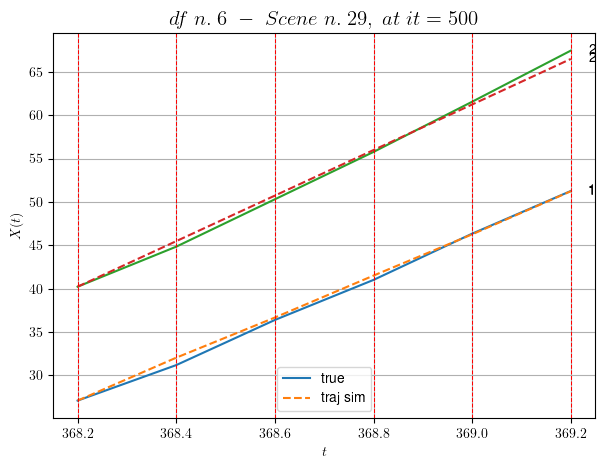

----------------------------------------------------------------------------------------------------
        For scene 4/5:
        * After LR finder: LR_NN=0.01 with mse=2.284975832147533 at it=24
        * v0 = 26.26965461417317
        * MSE = 0.1986199468968108
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.5/5
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [465.20,466.40]


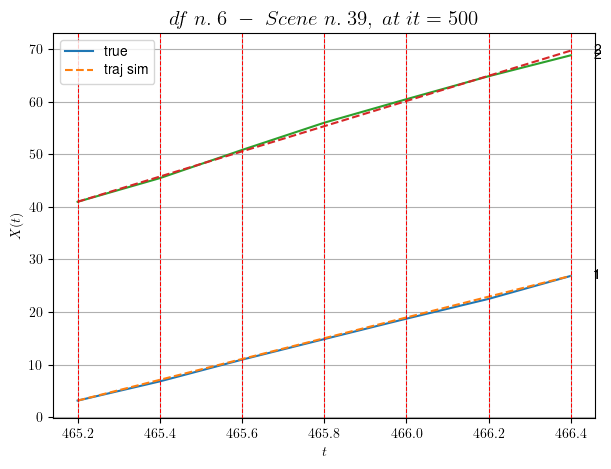

----------------------------------------------------------------------------------------------------
        For scene 5/5:
        * After LR finder: LR_NN=5e-05 with mse=9.992421825834235 at it=24
        * v0 = 23.95696245880239
        * MSE = 0.13390687142346486
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 2.6211592617943986
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (47 scenes)
DataFrame n.6. Scene n.1/47


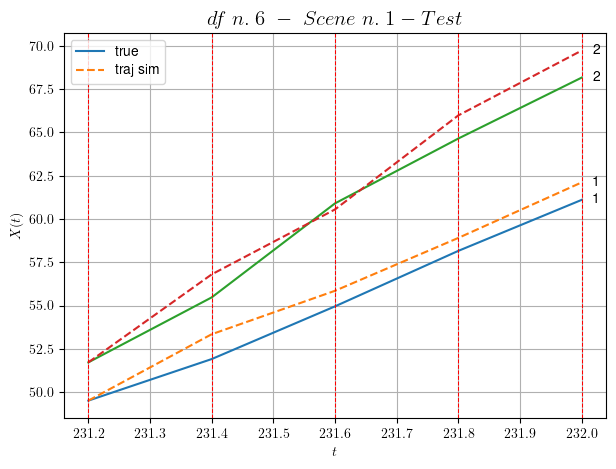

        For scene 1/47:
        * MSE = 1.0559748656081331
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.2/47


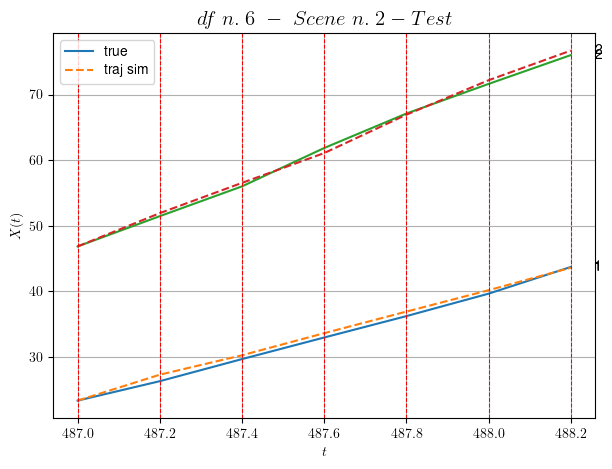

        For scene 2/47:
        * MSE = 0.3161493286867345
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.3/47


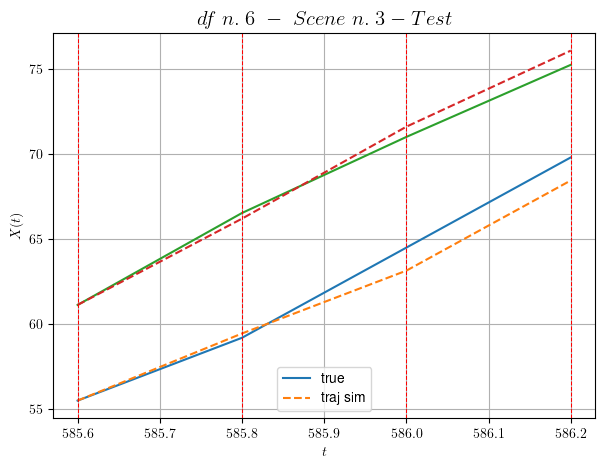

        For scene 3/47:
        * MSE = 0.6149106883383583
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.4/47


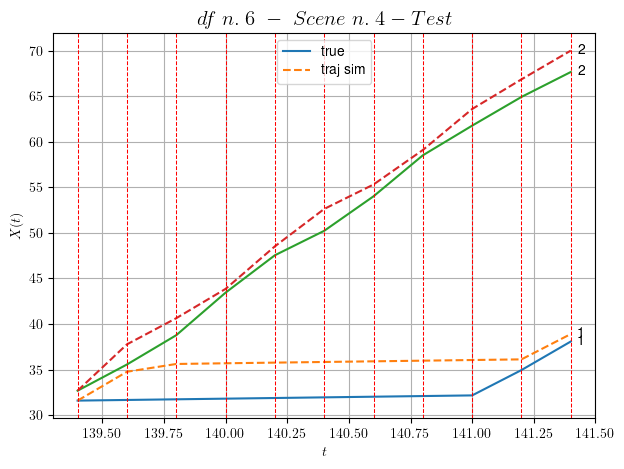

        For scene 4/47:
        * MSE = 6.6783500612764755
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.5/47


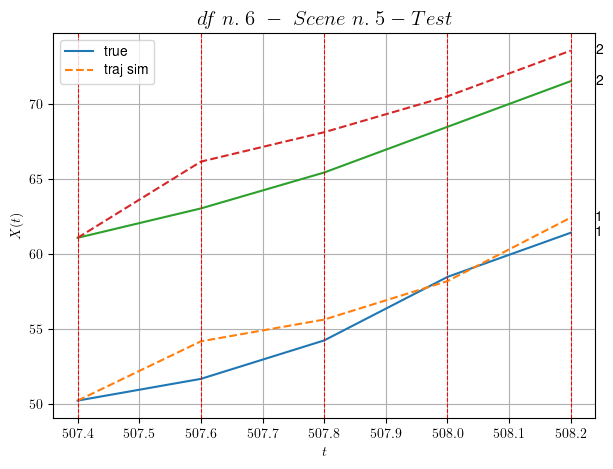

        For scene 5/47:
        * MSE = 3.4536650070128987
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.6/47


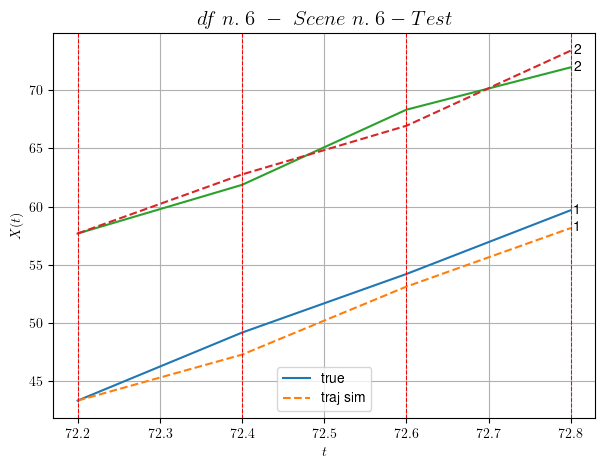

        For scene 6/47:
        * MSE = 1.4891079642096536
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.7/47


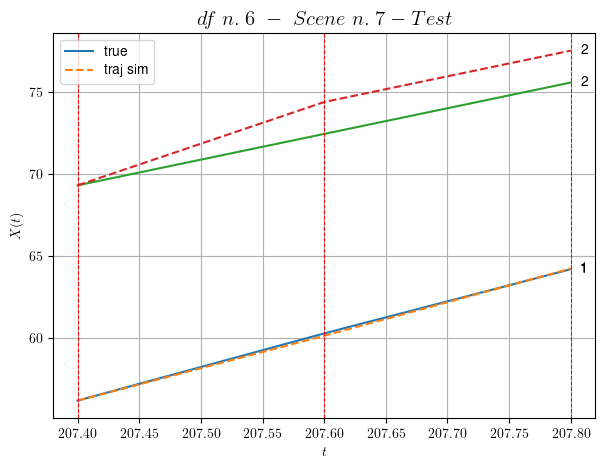

        For scene 7/47:
        * MSE = 1.2664286693045665
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.8/47


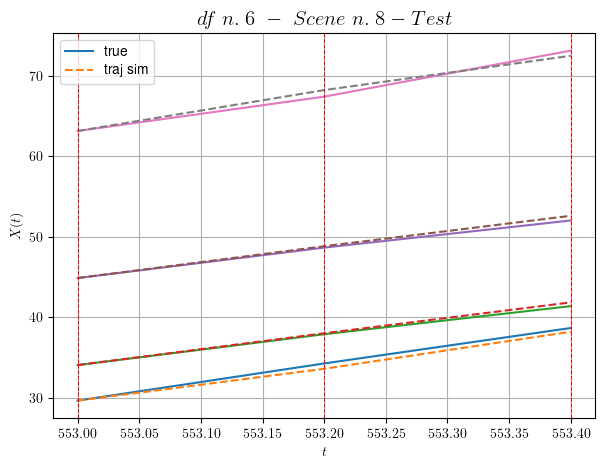

        For scene 8/47:
        * MSE = 0.19392293239390876
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.9/47


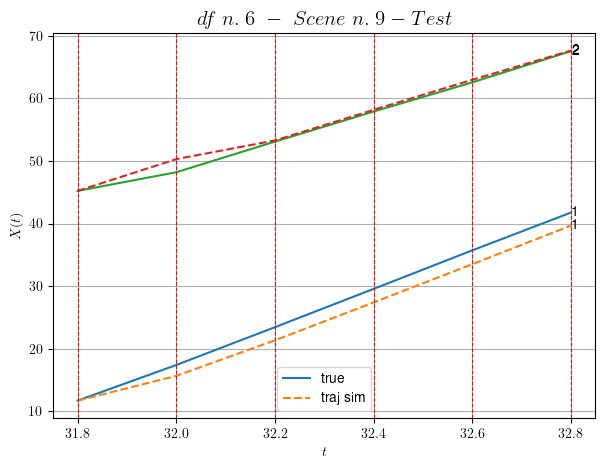

        For scene 9/47:
        * MSE = 2.167953431460896
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.10/47


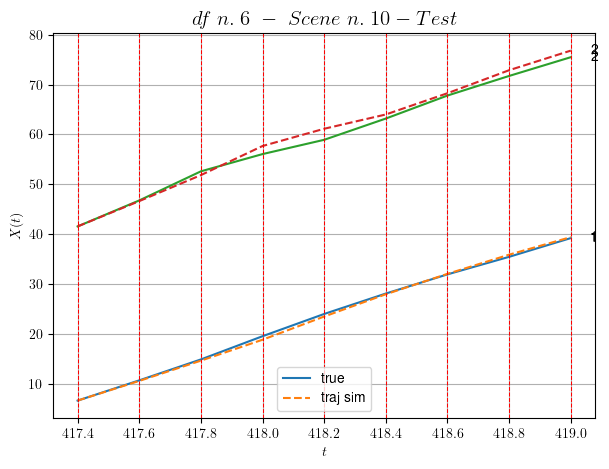

        For scene 10/47:
        * MSE = 0.7320213329049795
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.11/47


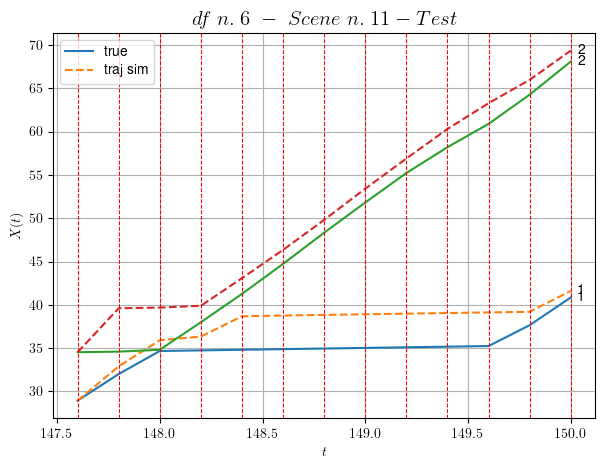

        For scene 11/47:
        * MSE = 7.449738922278197
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.12/47


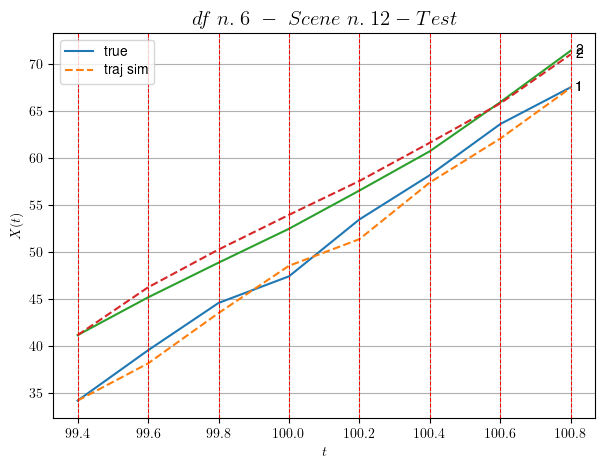

        For scene 12/47:
        * MSE = 1.1895082897287463
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.13/47


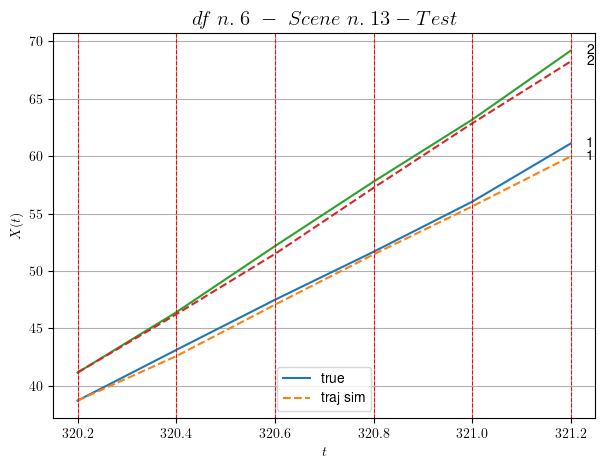

        For scene 13/47:
        * MSE = 0.3114710214468144
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.14/47


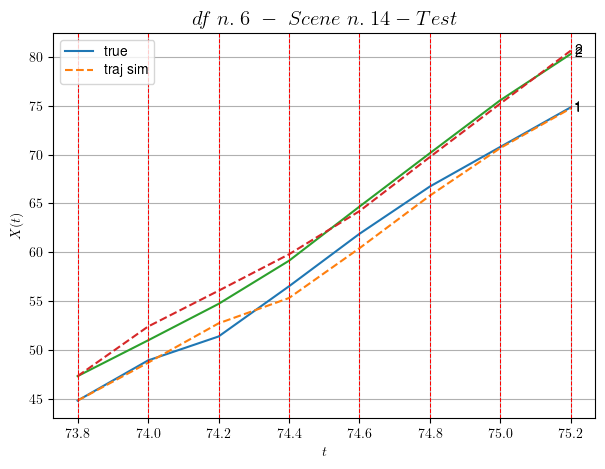

        For scene 14/47:
        * MSE = 0.7032445432027069
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.15/47


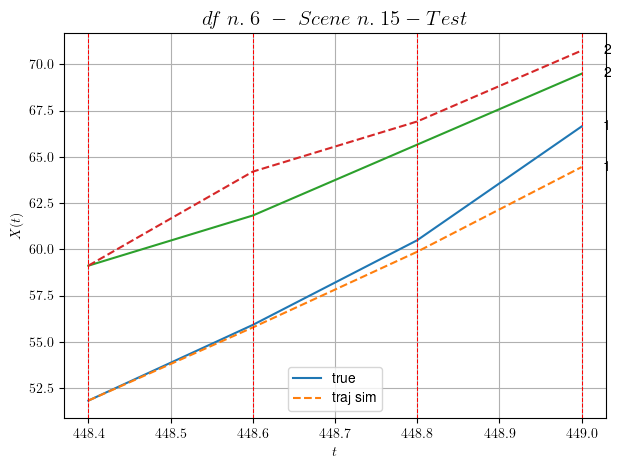

        For scene 15/47:
        * MSE = 1.7465053595420577
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.16/47


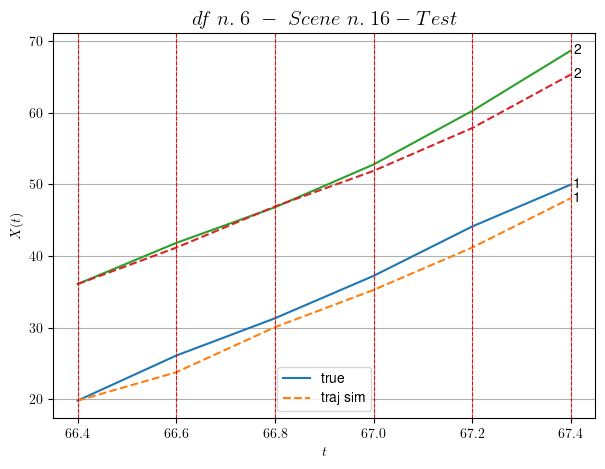

        For scene 16/47:
        * MSE = 3.425493365881403
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.17/47


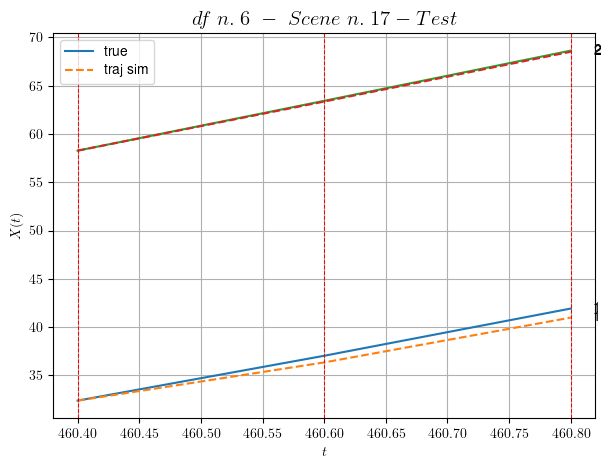

        For scene 17/47:
        * MSE = 0.2296493803085871
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.18/47


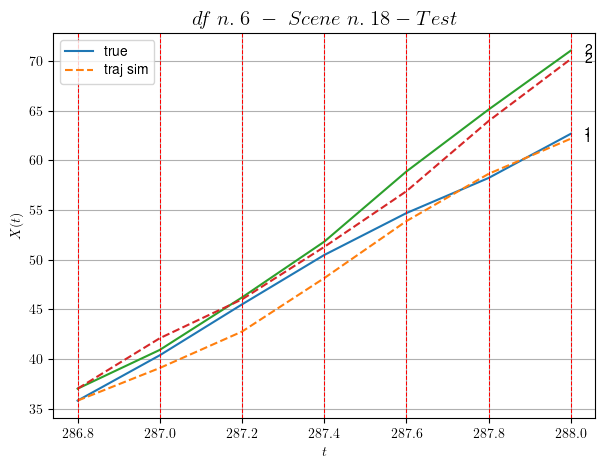

        For scene 18/47:
        * MSE = 1.6654047579603959
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.19/47


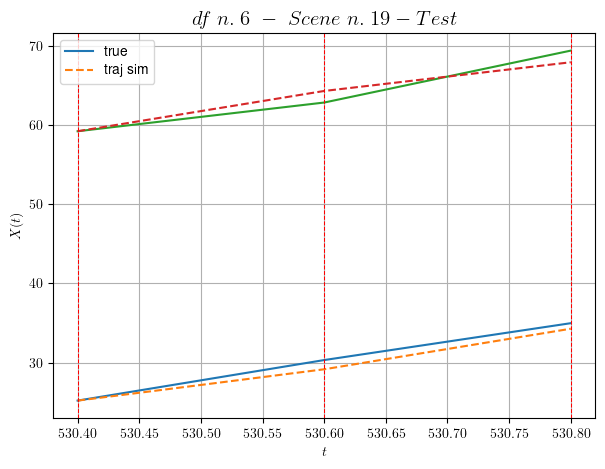

        For scene 19/47:
        * MSE = 1.0210965277696162
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.20/47


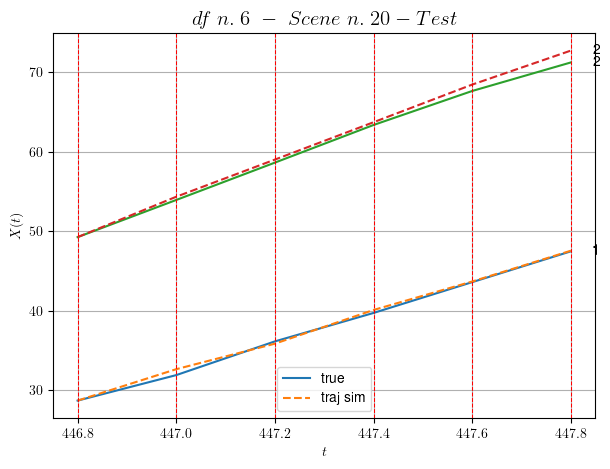

        For scene 20/47:
        * MSE = 0.3407310683279498
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.21/47


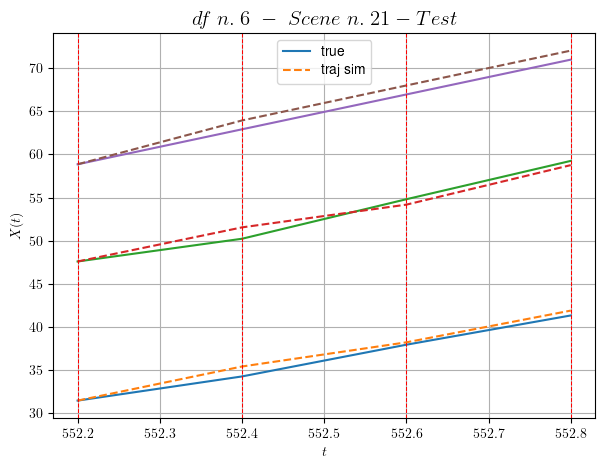

        For scene 21/47:
        * MSE = 0.6102653461418078
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.22/47


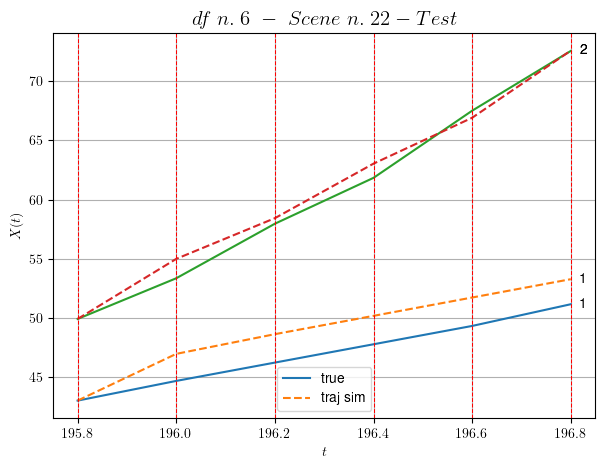

        For scene 22/47:
        * MSE = 2.646864045200623
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.23/47


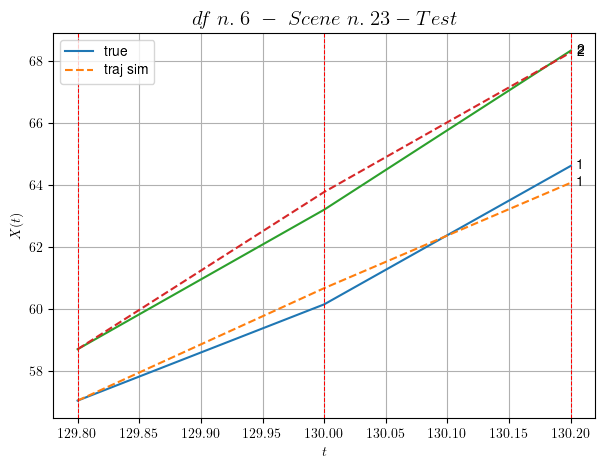

        For scene 23/47:
        * MSE = 0.15027397359920291
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.24/47


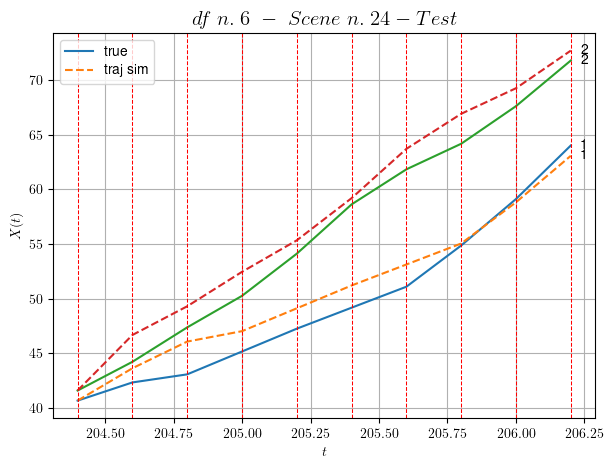

        For scene 24/47:
        * MSE = 2.8911608136731077
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.25/47


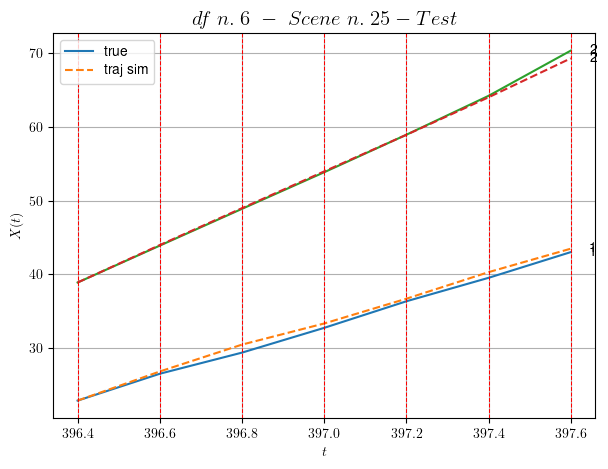

        For scene 25/47:
        * MSE = 0.2666174335710732
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.26/47


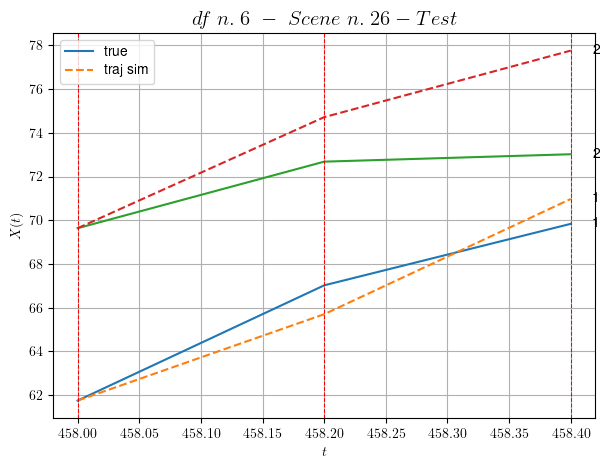

        For scene 26/47:
        * MSE = 4.946344831797948
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.27/47


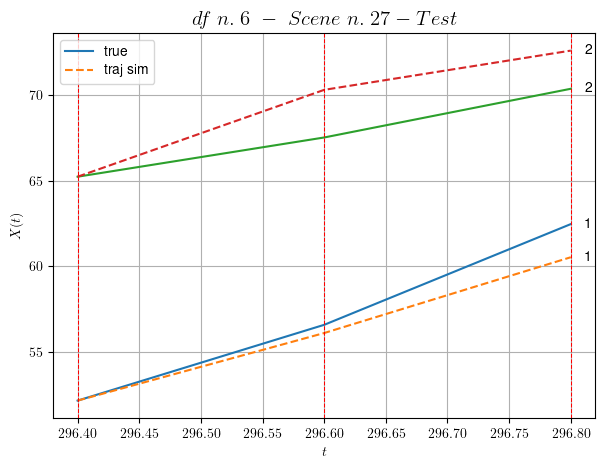

        For scene 27/47:
        * MSE = 2.789559702964004
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.28/47


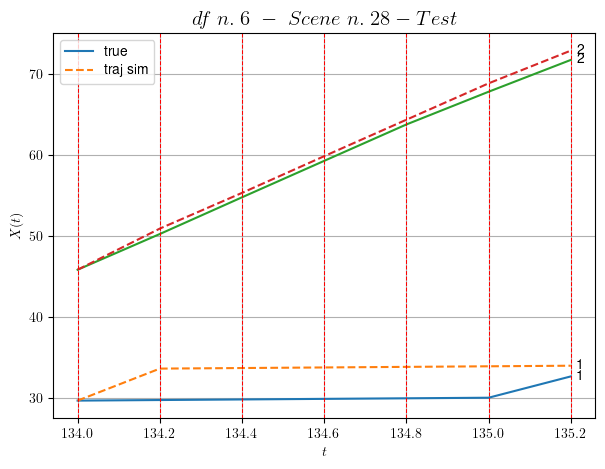

        For scene 28/47:
        * MSE = 5.780795516247332
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.29/47


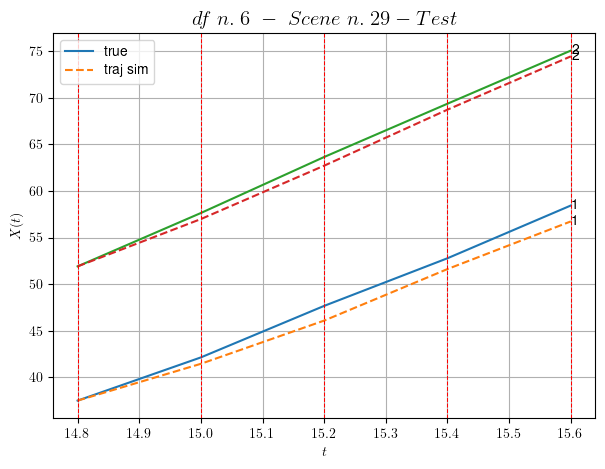

        For scene 29/47:
        * MSE = 0.930793893871064
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.30/47


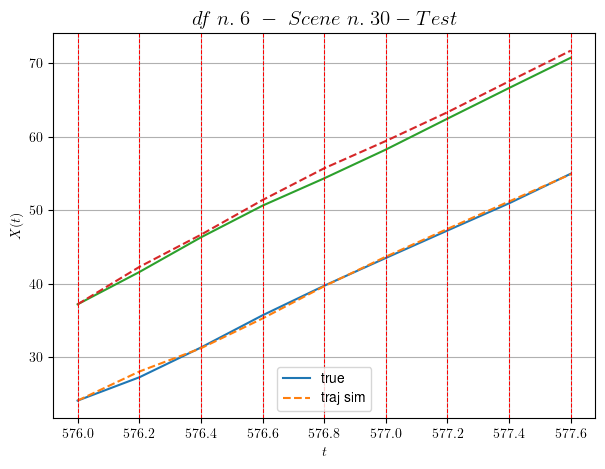

        For scene 30/47:
        * MSE = 0.4394563693786814
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.31/47


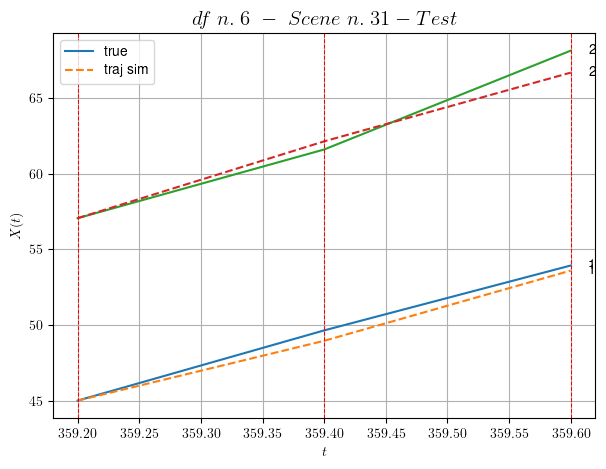

        For scene 31/47:
        * MSE = 0.498525807956702
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.32/47


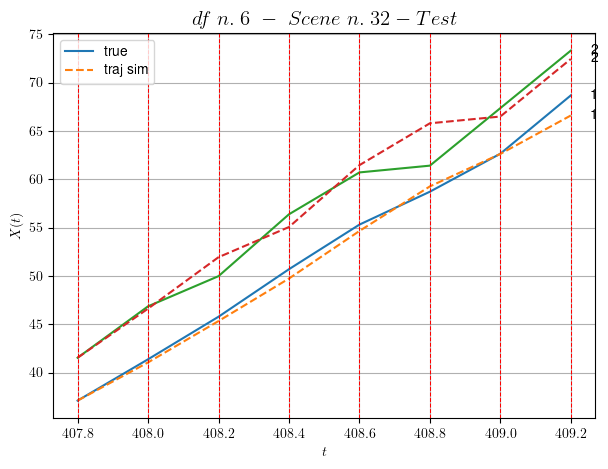

        For scene 32/47:
        * MSE = 2.075408401530659
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.33/47


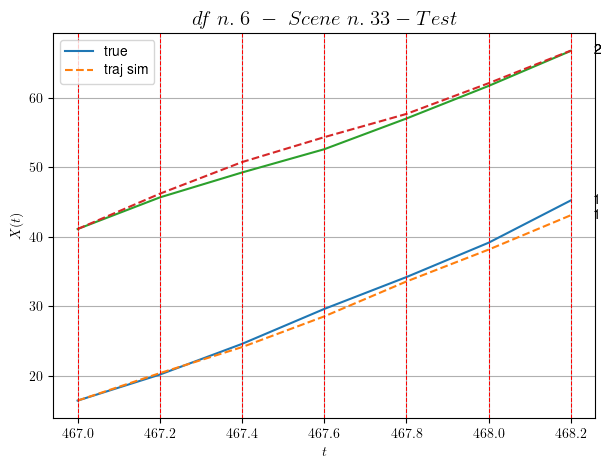

        For scene 33/47:
        * MSE = 0.9618357892807023
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.34/47


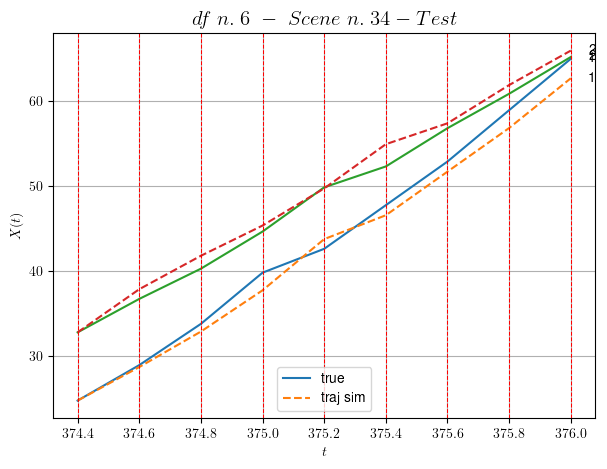

        For scene 34/47:
        * MSE = 1.7747310131063467
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.35/47


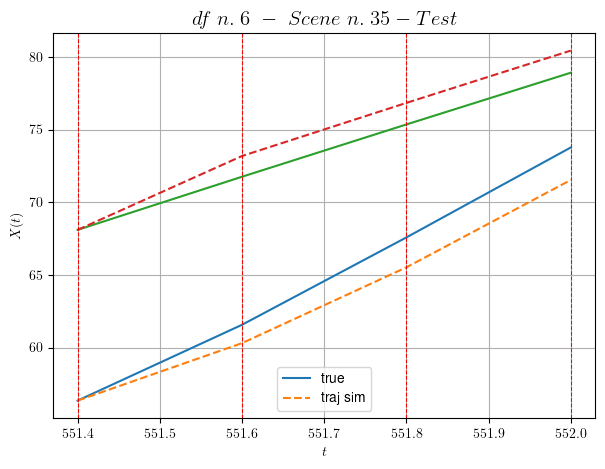

        For scene 35/47:
        * MSE = 2.1735304059304776
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.36/47


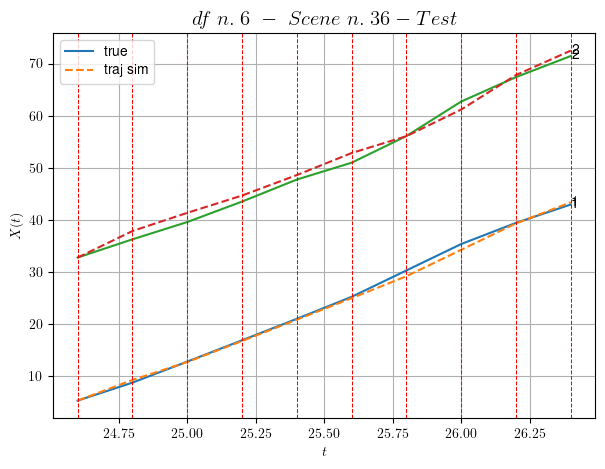

        For scene 36/47:
        * MSE = 0.8880344938453395
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.37/47


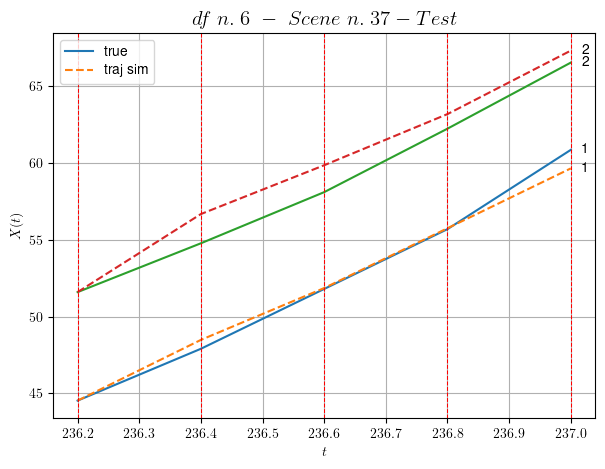

        For scene 37/47:
        * MSE = 0.999985648001407
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.38/47


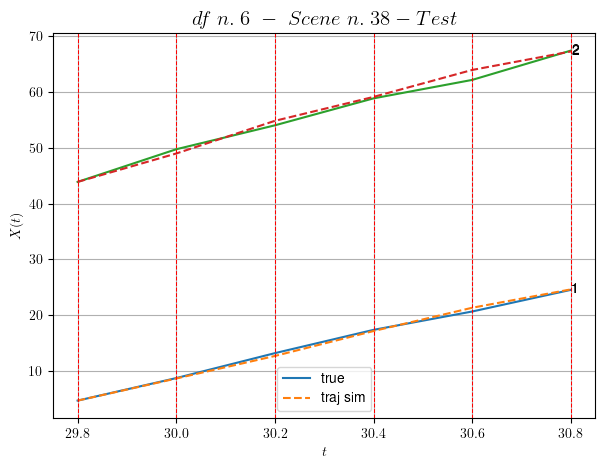

        For scene 38/47:
        * MSE = 0.43728990026109454
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.39/47


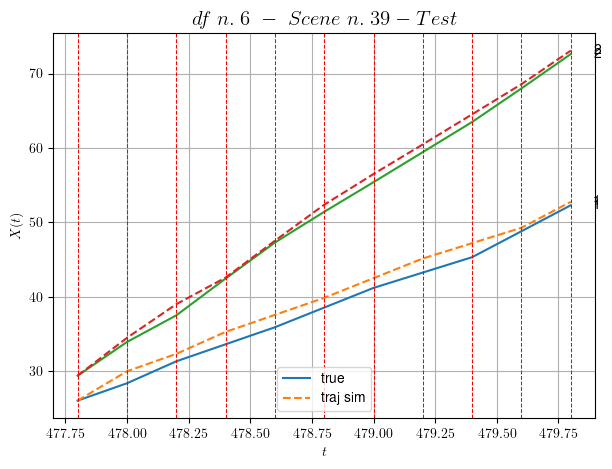

        For scene 39/47:
        * MSE = 1.2521273605286092
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.40/47


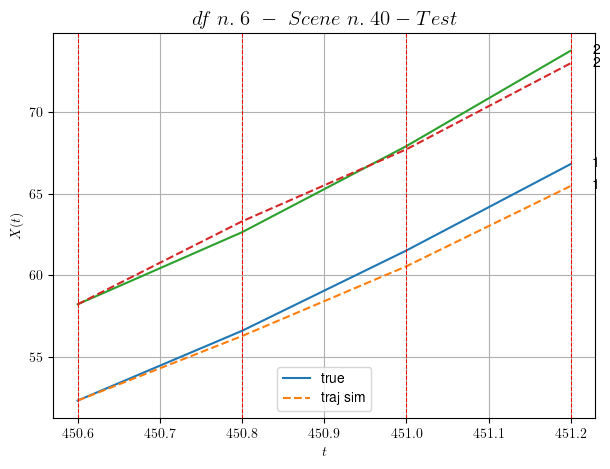

        For scene 40/47:
        * MSE = 0.4902305152384405
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.41/47


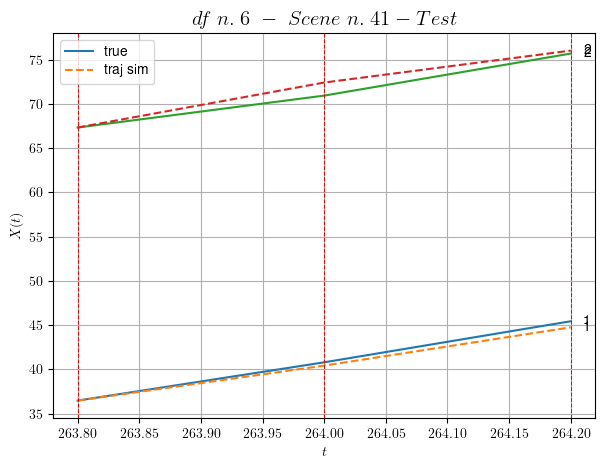

        For scene 41/47:
        * MSE = 0.4823436656139103
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.42/47


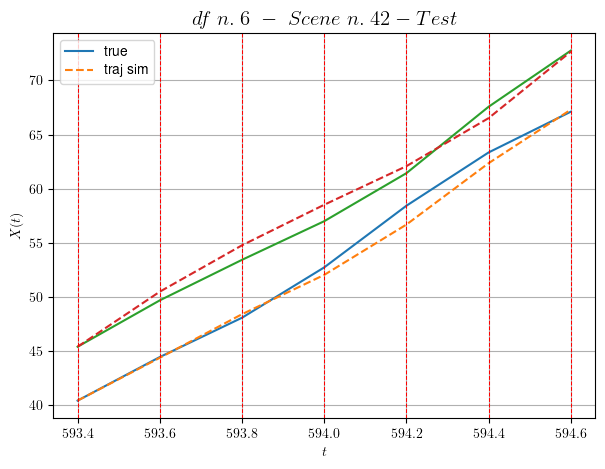

        For scene 42/47:
        * MSE = 0.7794107640684276
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.43/47


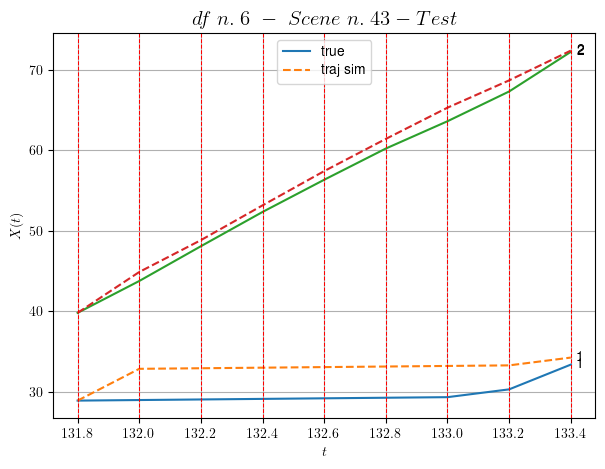

        For scene 43/47:
        * MSE = 6.1090780265736555
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.44/47


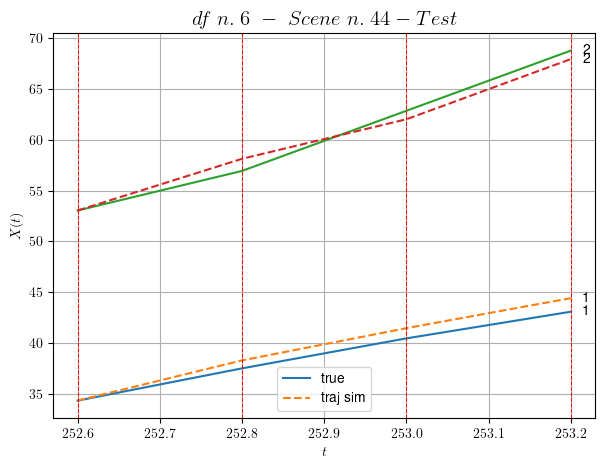

        For scene 44/47:
        * MSE = 0.7761714982825327
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.45/47


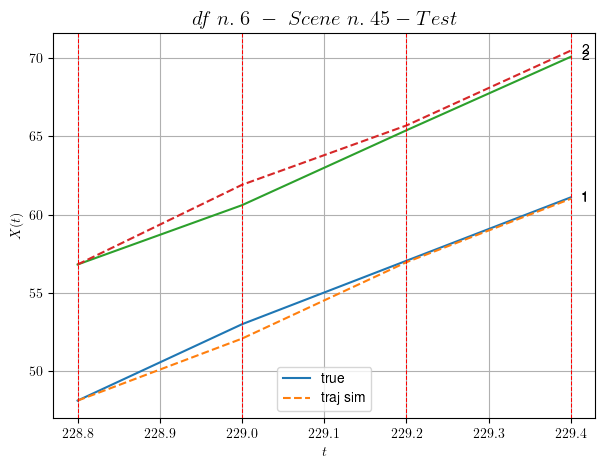

        For scene 45/47:
        * MSE = 0.3492849057955595
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.46/47


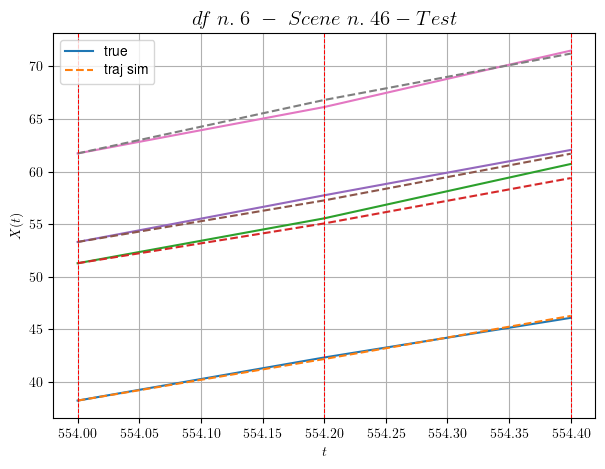

        For scene 46/47:
        * MSE = 0.24851545199164868
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.47/47


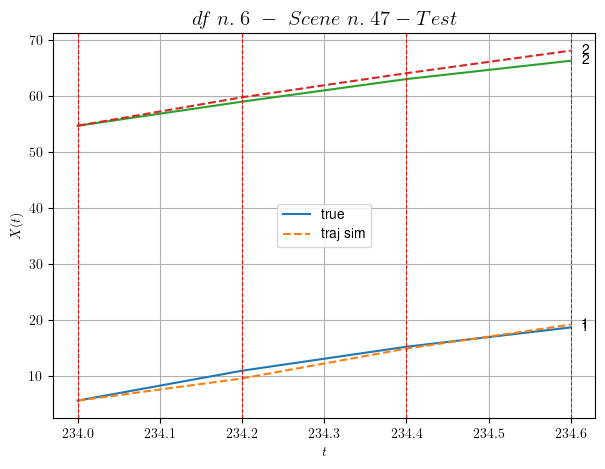

        For scene 47/47:
        * MSE = 0.9070634393915067
----------------------------------------------------------------------------------------------------


MSE test: 1.6746175857762757

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 2.6211592617943986
          * MSE test: 1.6746175857762757
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 7/10 dfs.
In DataFrame n.7 we have 30 scenes.
    To train the model we use 3 scenes, the remaining 27 to test the model.

Training step. (3 scenes)
DataFrame n.7. Scene n.1/3
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [162.36,163.16]


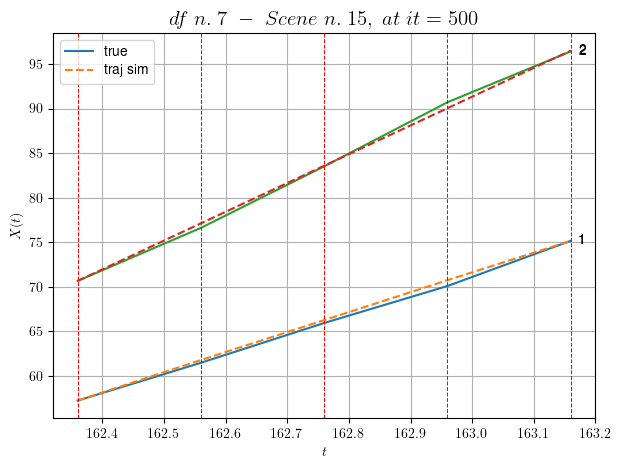

----------------------------------------------------------------------------------------------------
        For scene 1/3:
        * After LR finder: LR_NN=0.005 with mse=0.897942983283073 at it=24
        * v0 = 32.323787690864414
        * MSE = 0.1343069925069944
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.2/3
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [206.96,207.56]


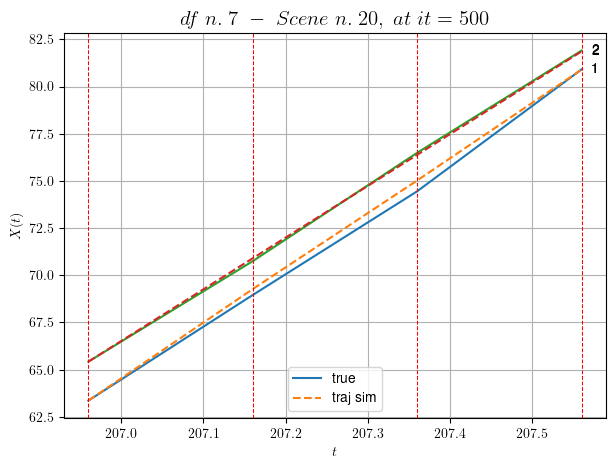

----------------------------------------------------------------------------------------------------
        For scene 2/3:
        * After LR finder: LR_NN=0.0005 with mse=0.5334095557600066 at it=24
        * v0 = 27.399256338801305
        * MSE = 0.05805345312563022
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.3/3
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [82.16,82.76]


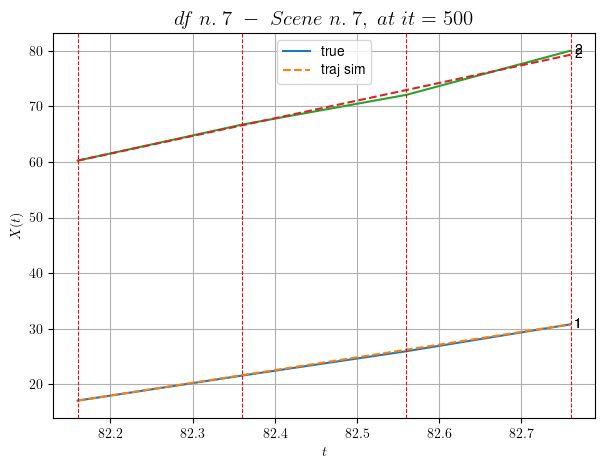

----------------------------------------------------------------------------------------------------
        For scene 3/3:
        * After LR finder: LR_NN=5e-05 with mse=0.43421207886995694 at it=24
        * v0 = 31.745431023356435
        * MSE = 0.17410890239885704
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.12215644934382723
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (27 scenes)
DataFrame n.7. Scene n.1/27


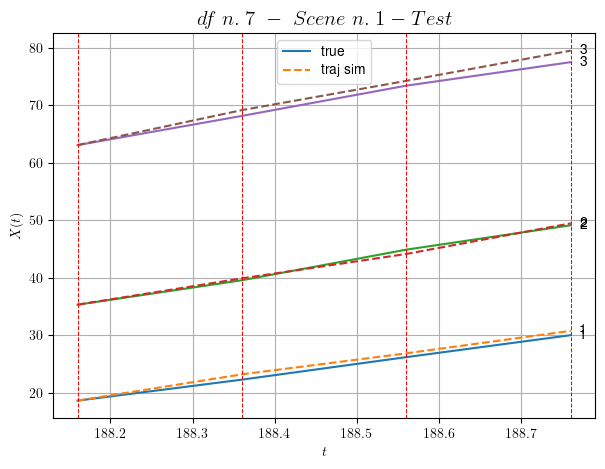

        For scene 1/27:
        * MSE = 0.6997492803647324
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.2/27


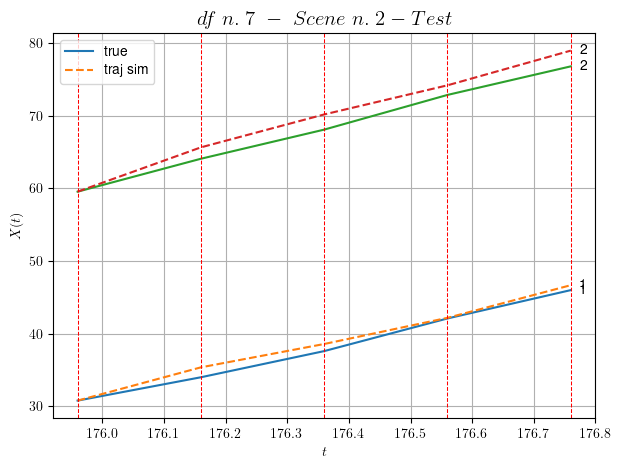

        For scene 2/27:
        * MSE = 1.6551224923959371
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.3/27


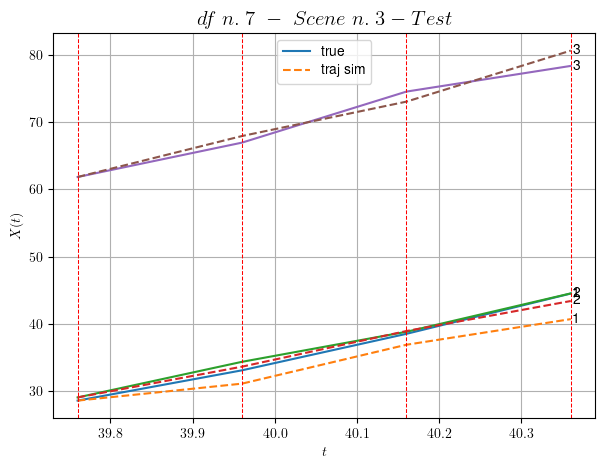

        For scene 3/27:
        * MSE = 2.6041180452819113
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.4/27


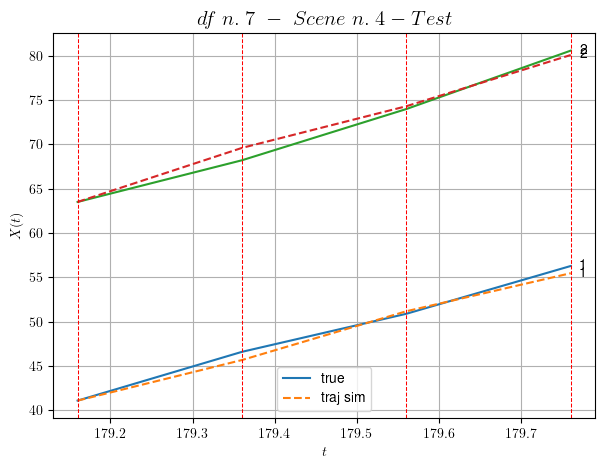

        For scene 4/27:
        * MSE = 0.48619995285412776
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.5/27


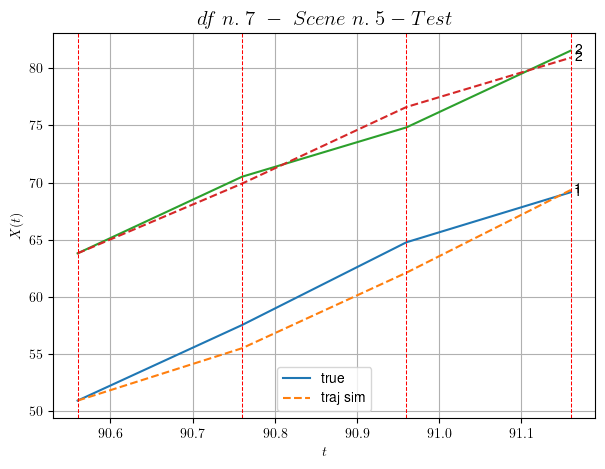

        For scene 5/27:
        * MSE = 1.8940829944874693
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.6/27


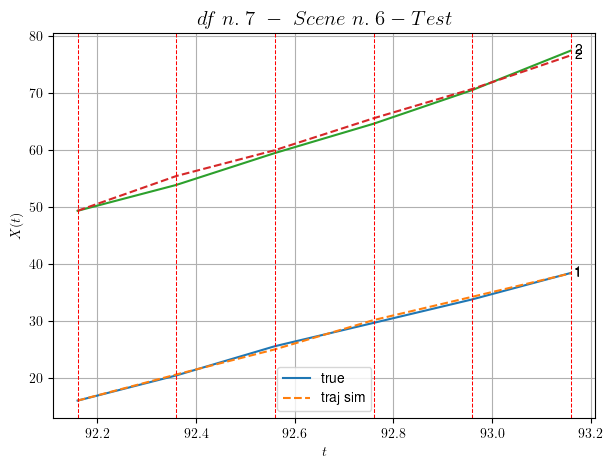

        For scene 6/27:
        * MSE = 0.42708185233698287
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.7/27


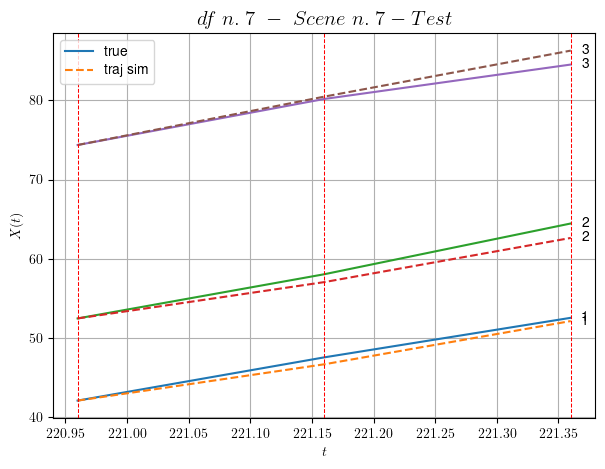

        For scene 7/27:
        * MSE = 0.9347927539741497
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.8/27


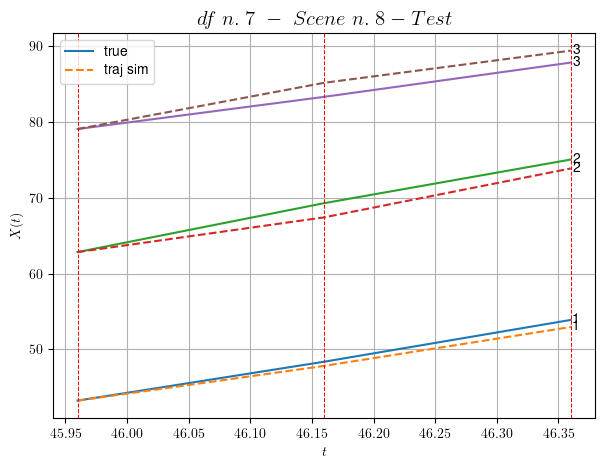

        For scene 8/27:
        * MSE = 1.3311266191482636
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.9/27


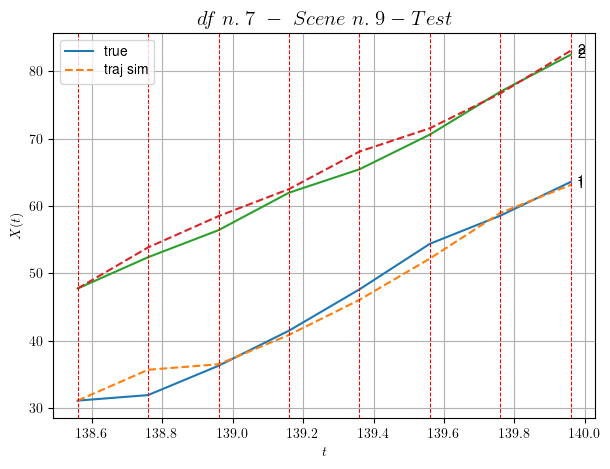

        For scene 9/27:
        * MSE = 2.3185073107722864
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.10/27


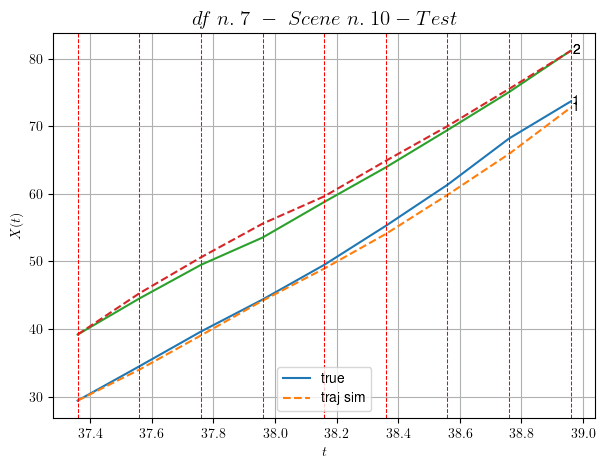

        For scene 10/27:
        * MSE = 1.0468384323367692
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.11/27


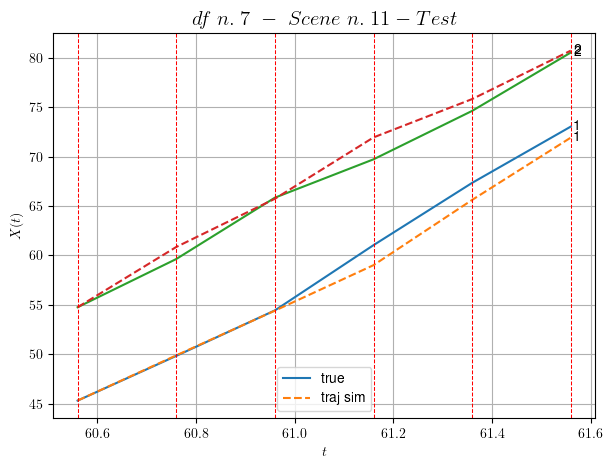

        For scene 11/27:
        * MSE = 1.3498873780161242
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.12/27


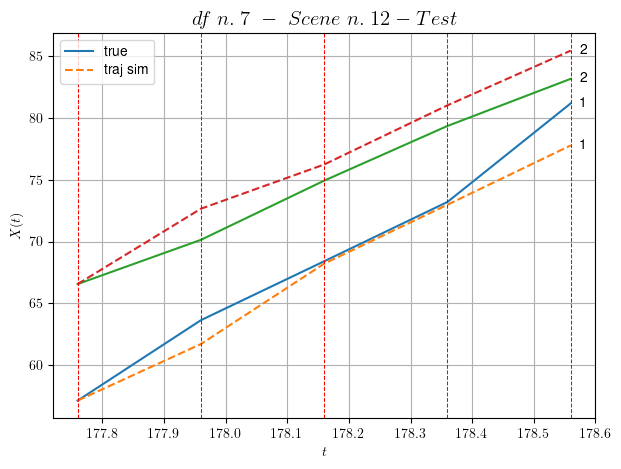

        For scene 12/27:
        * MSE = 3.143892196493443
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.13/27


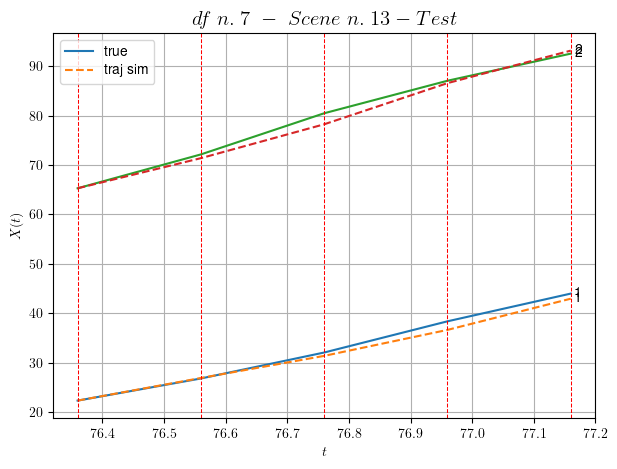

        For scene 13/27:
        * MSE = 1.0726158003417794
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.14/27


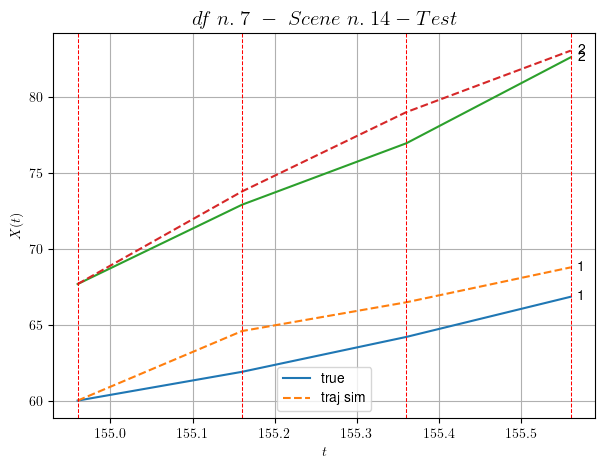

        For scene 14/27:
        * MSE = 2.6620300087184567
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.15/27


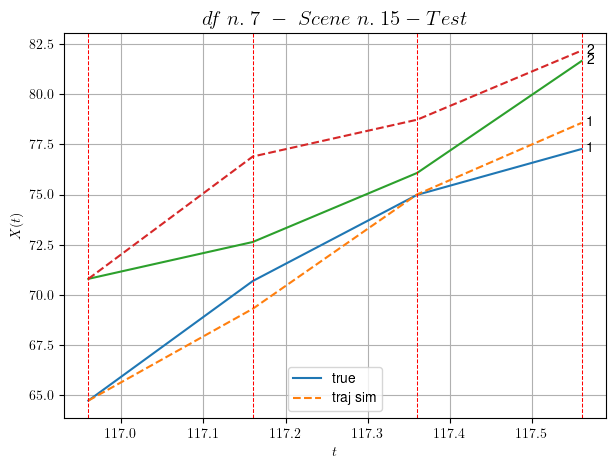

        For scene 15/27:
        * MSE = 3.634980159971432
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.16/27


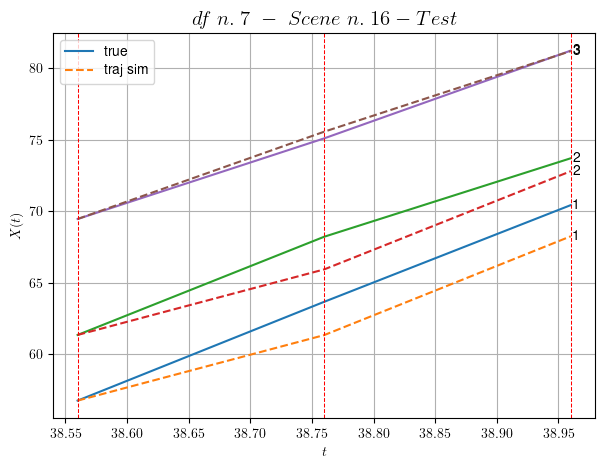

        For scene 16/27:
        * MSE = 1.820394052846425
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.17/27


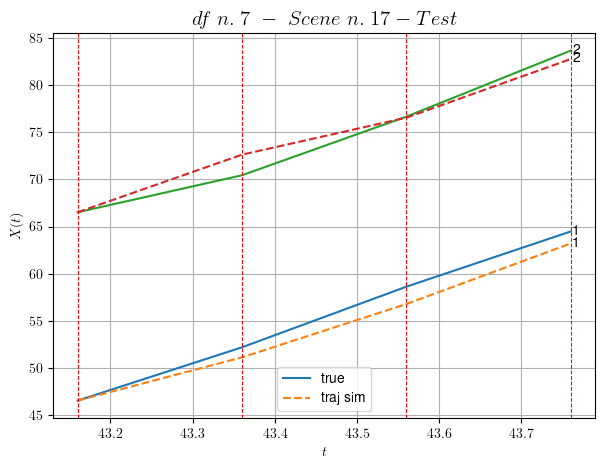

        For scene 17/27:
        * MSE = 1.4585509900017364
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.18/27


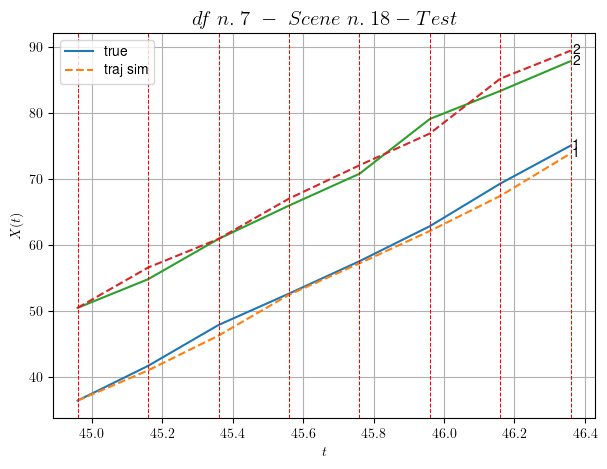

        For scene 18/27:
        * MSE = 1.5774748689010782
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.19/27


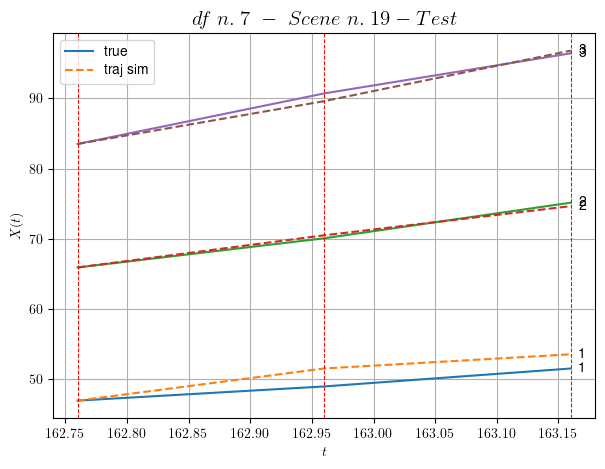

        For scene 19/27:
        * MSE = 1.3822094935686693
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.20/27


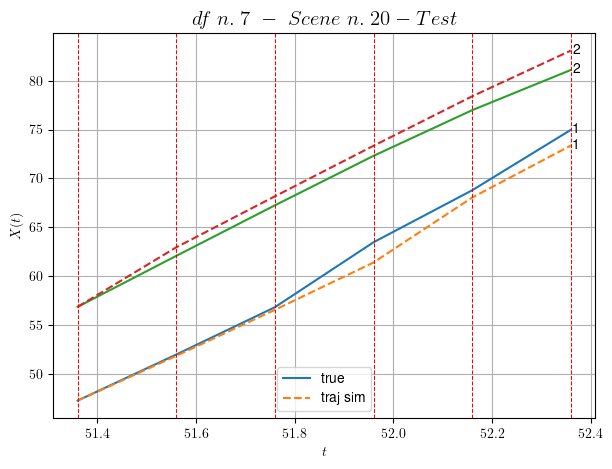

        For scene 20/27:
        * MSE = 1.3451673896875935
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.21/27


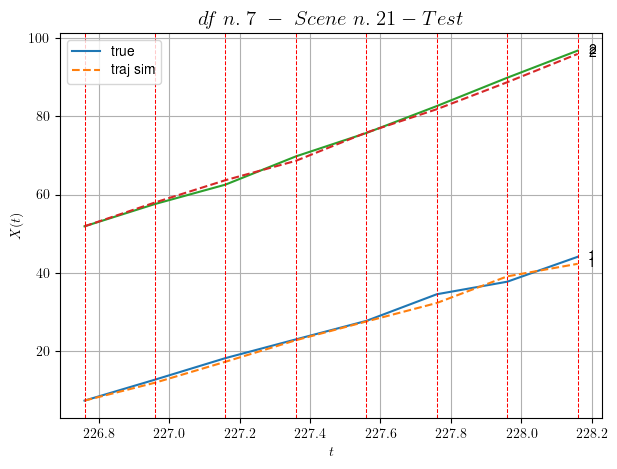

        For scene 21/27:
        * MSE = 1.0663537286606988
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.22/27


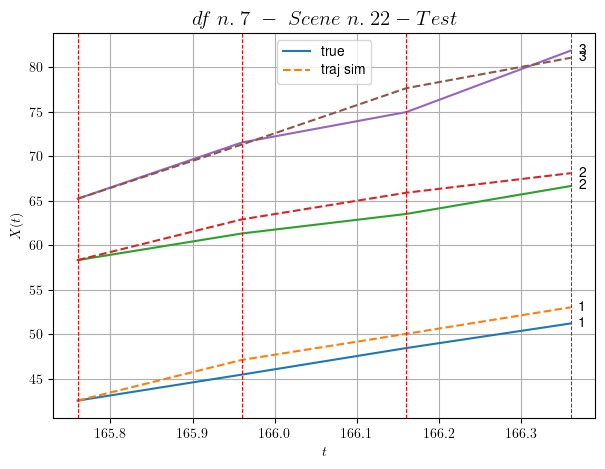

        For scene 22/27:
        * MSE = 2.230145752884447
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.23/27


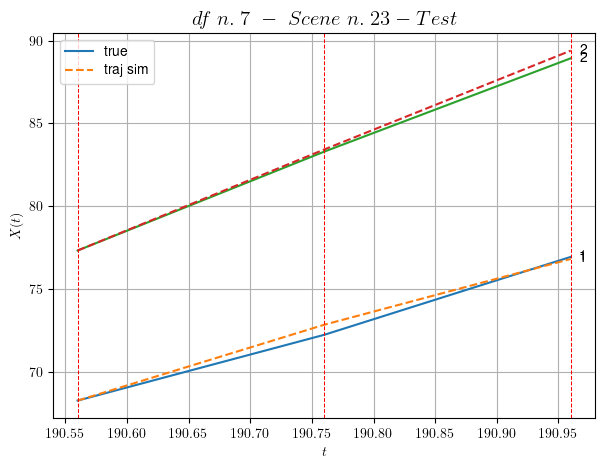

        For scene 23/27:
        * MSE = 0.10265983255695646
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.24/27


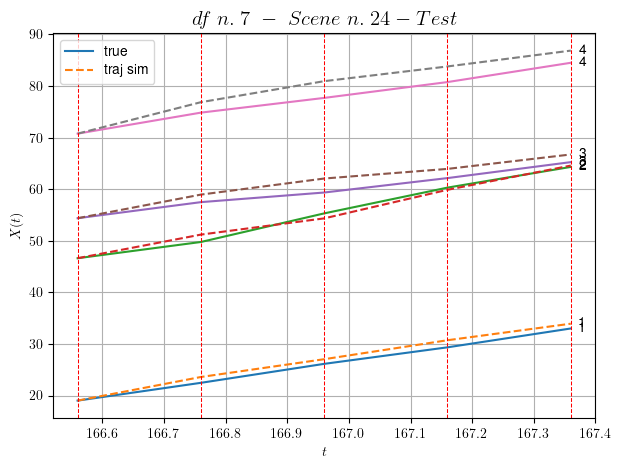

        For scene 24/27:
        * MSE = 2.6149544889463083
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.25/27


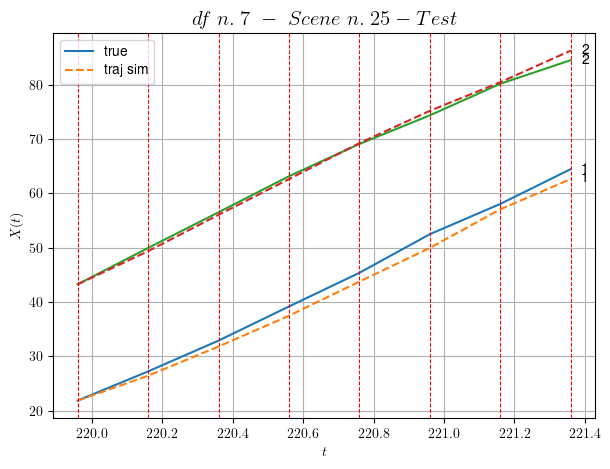

        For scene 25/27:
        * MSE = 1.4200369681459153
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.26/27


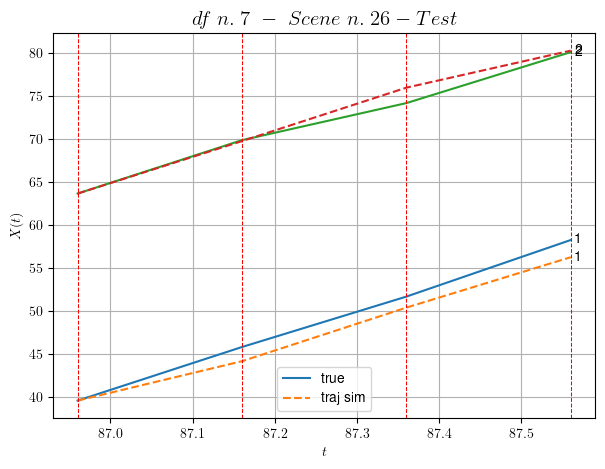

        For scene 26/27:
        * MSE = 1.450691366001377
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.27/27


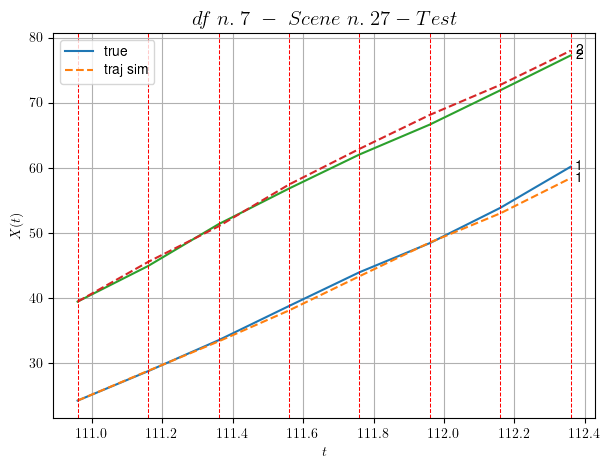

        For scene 27/27:
        * MSE = 0.6079115928420684
----------------------------------------------------------------------------------------------------


MSE test: 1.5680583630569314

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.12215644934382723
          * MSE test: 1.5680583630569314
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 8/10 dfs.
In DataFrame n.8 we have 79 scenes.
    To train the model we use 7 scenes, the remaining 72 to test the model.

Training step. (7 scenes)
DataFrame n.8. Scene n.1/7
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [48.04,48.84]


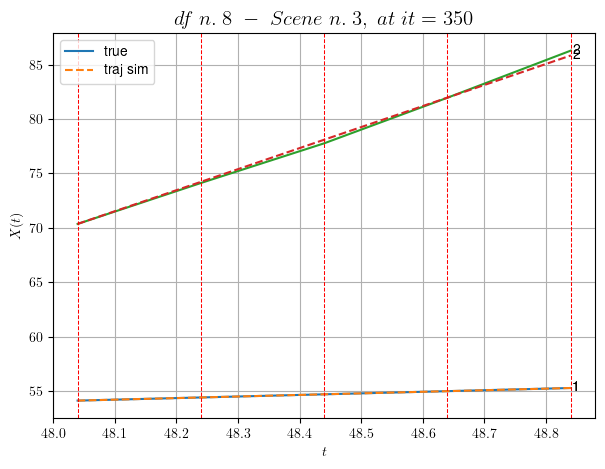

----------------------------------------------------------------------------------------------------
        For scene 1/7:
        * After LR finder: LR_NN=0.01 with mse=13.179518071434005 at it=24
        * v0 = 19.366199429857964
        * MSE = 0.02887728133316128
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.2/7
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [283.84,285.04]


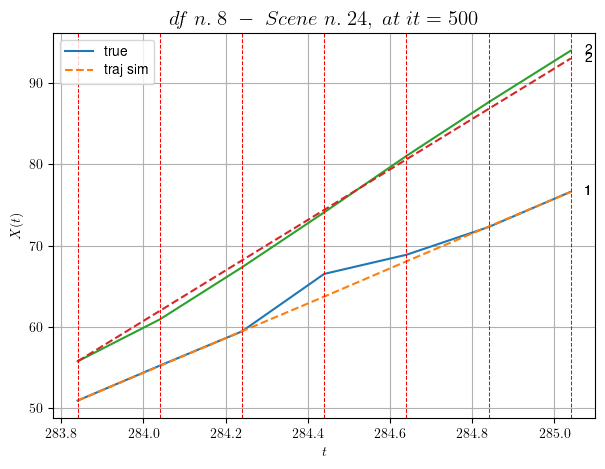

----------------------------------------------------------------------------------------------------
        For scene 2/7:
        * After LR finder: LR_NN=0.001 with mse=1.421495058886579 at it=24
        * v0 = 31.024373752742626
        * MSE = 0.8617019042448827
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.3/7
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [276.64,277.64]


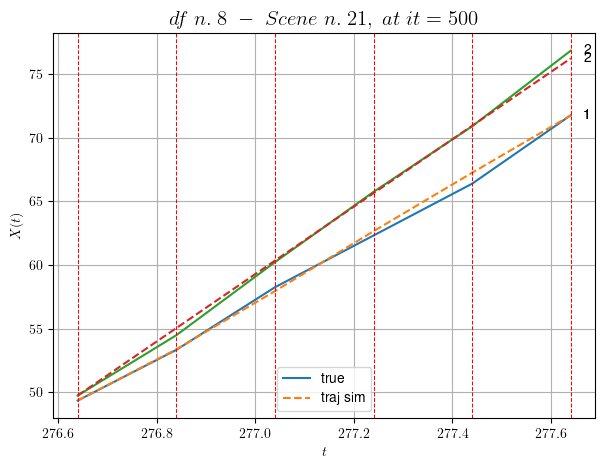

----------------------------------------------------------------------------------------------------
        For scene 3/7:
        * After LR finder: LR_NN=0.005 with mse=2.173100624982102 at it=24
        * v0 = 26.49050884606435
        * MSE = 0.1323119943462476
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.4/7
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [102.24,103.04]


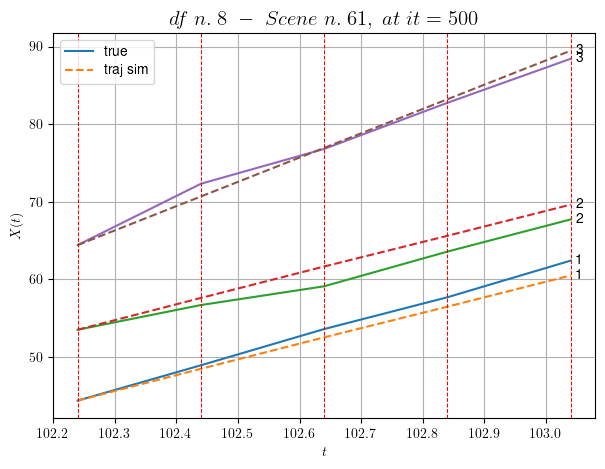

----------------------------------------------------------------------------------------------------
        For scene 4/7:
        * After LR finder: LR_NN=0.005 with mse=1.7295035675026125 at it=24
        * v0 = 31.34829198332158
        * MSE = 1.6923646687078413
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.5/7
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [290.84,291.44]


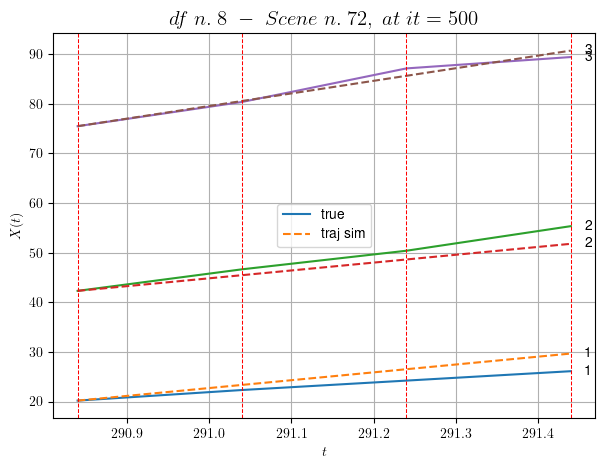

----------------------------------------------------------------------------------------------------
        For scene 5/7:
        * After LR finder: LR_NN=0.0005 with mse=2.3330784788169465 at it=24
        * v0 = 25.378244279773945
        * MSE = 3.3359624927943243
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.6/7
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [178.44,179.24]


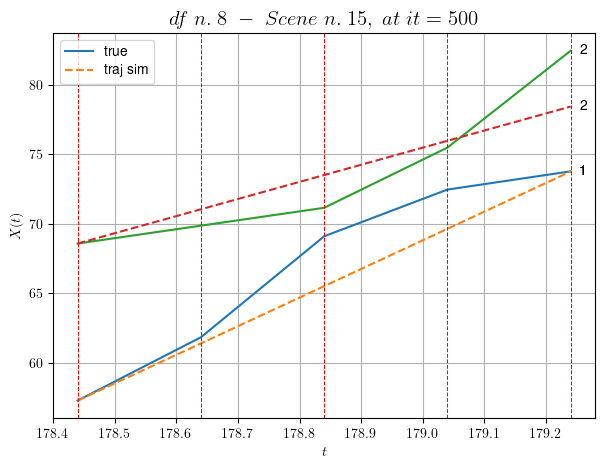

----------------------------------------------------------------------------------------------------
        For scene 6/7:
        * After LR finder: LR_NN=0.0001 with mse=35.33369129043748 at it=24
        * v0 = 12.308982889932006
        * MSE = 4.428063596698282
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.7/7
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [536.64,537.24]


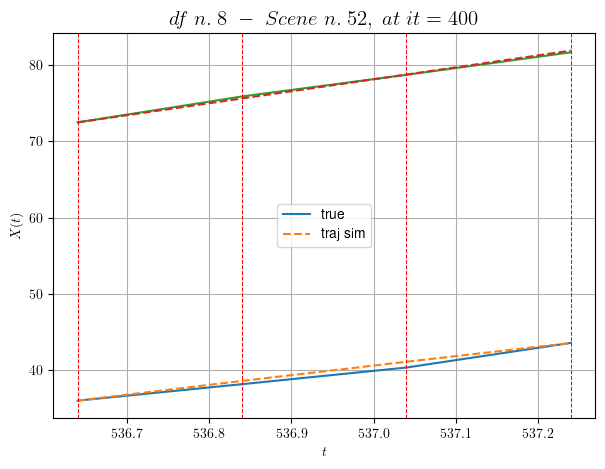

----------------------------------------------------------------------------------------------------
        For scene 7/7:
        * After LR finder: LR_NN=0.005 with mse=14.815466828559629 at it=24
        * v0 = 15.683354901826254
        * MSE = 0.10654953388743371
        * iterations = 400
----------------------------------------------------------------------------------------------------


MSE train: 1.5122616388588817
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (72 scenes)
DataFrame n.8. Scene n.1/72


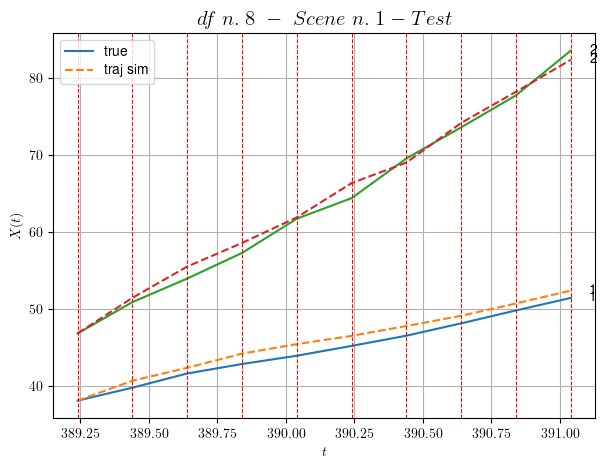

        For scene 1/72:
        * MSE = 1.095812540876138
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.2/72


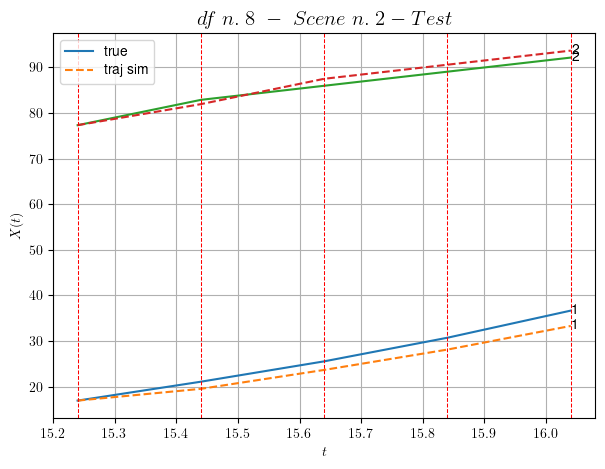

        For scene 2/72:
        * MSE = 3.1916076880474877
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.3/72


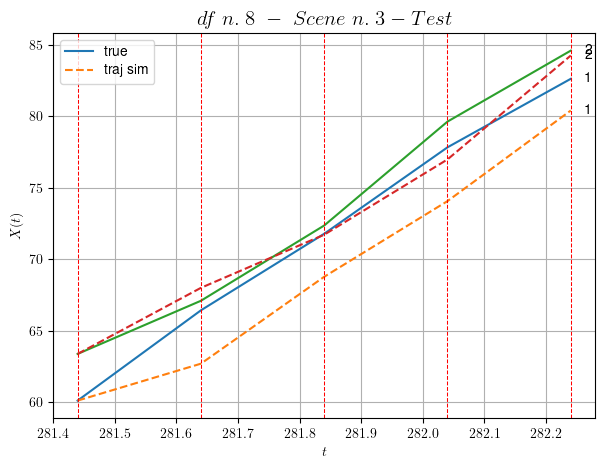

        For scene 3/72:
        * MSE = 5.02909914923647
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.4/72


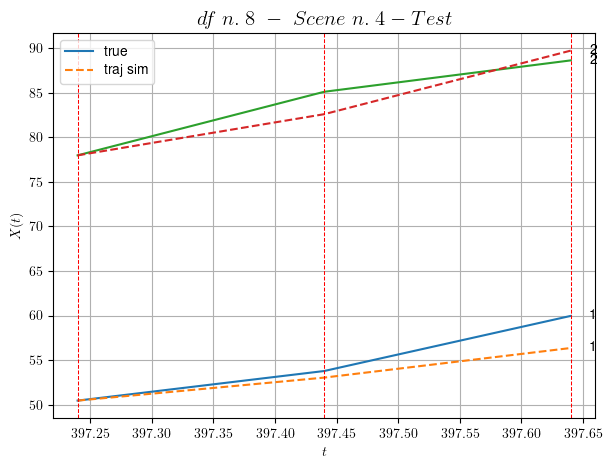

        For scene 4/72:
        * MSE = 3.5062912113370617
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.5/72


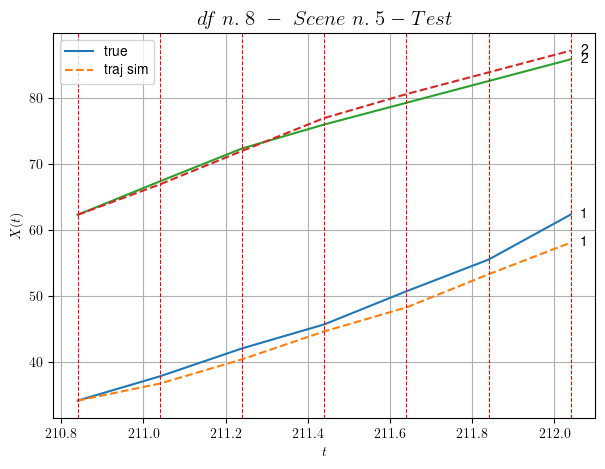

        For scene 5/72:
        * MSE = 2.908252519894276
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.6/72


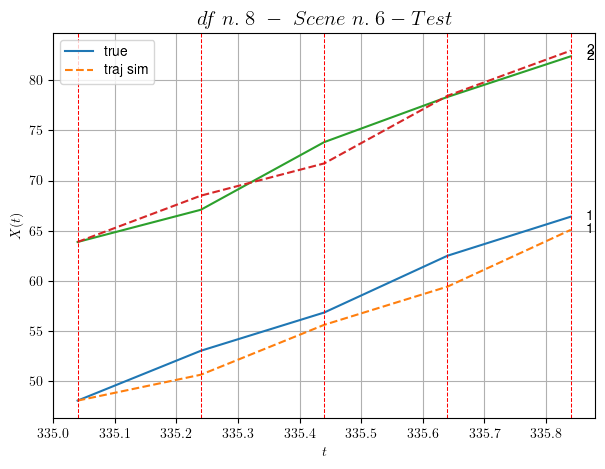

        For scene 6/72:
        * MSE = 2.5222636018669684
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.7/72


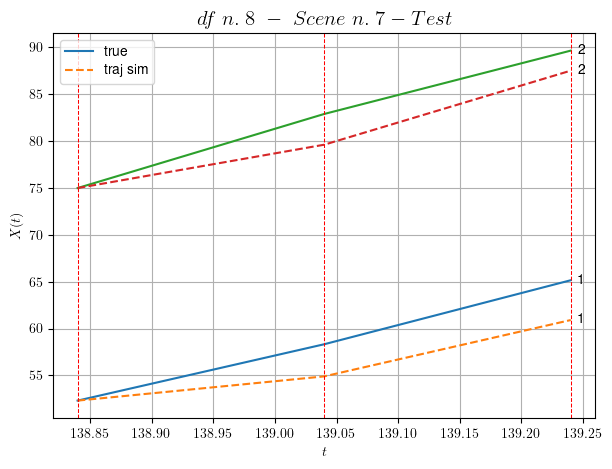

        For scene 7/72:
        * MSE = 7.494223548579877
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.8/72


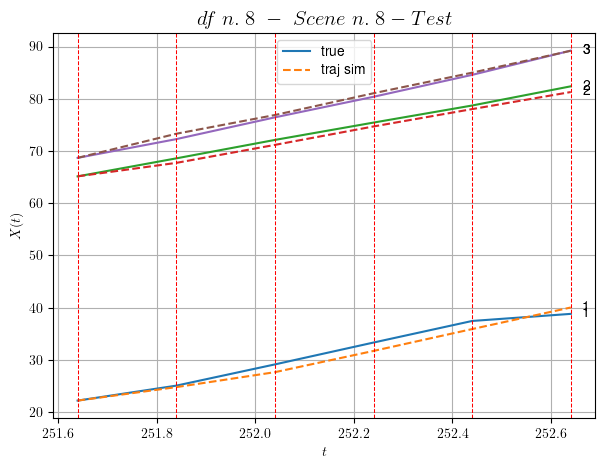

        For scene 8/72:
        * MSE = 0.8072072933782962
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.9/72


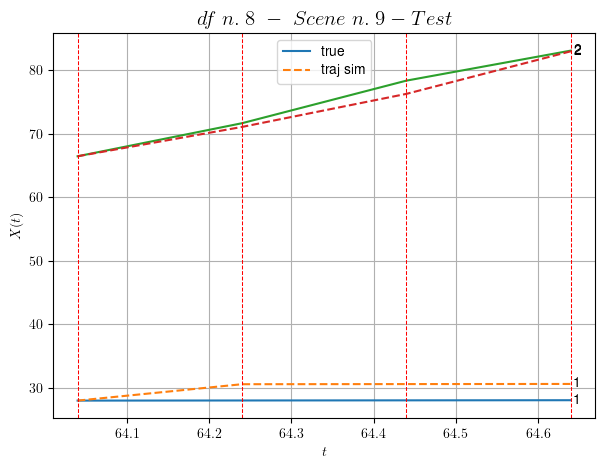

        For scene 9/72:
        * MSE = 3.045035100321719
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.10/72


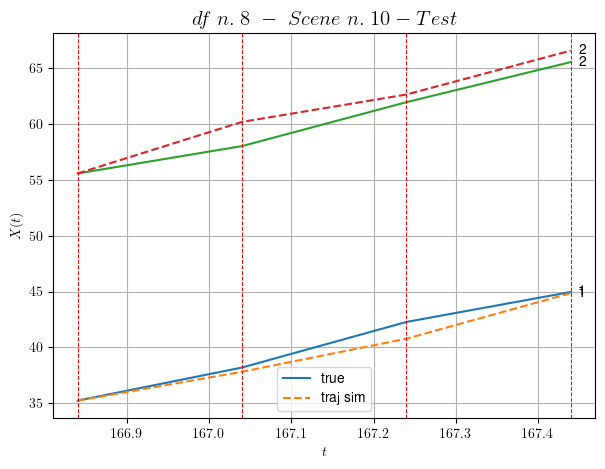

        For scene 10/72:
        * MSE = 1.0779621631974456
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.11/72


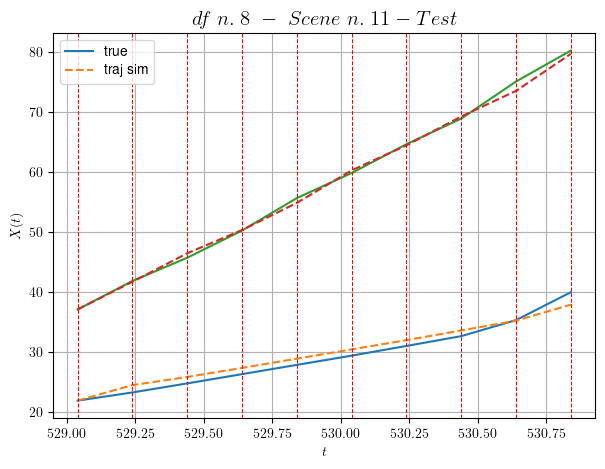

        For scene 11/72:
        * MSE = 0.8143011728841771
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.12/72


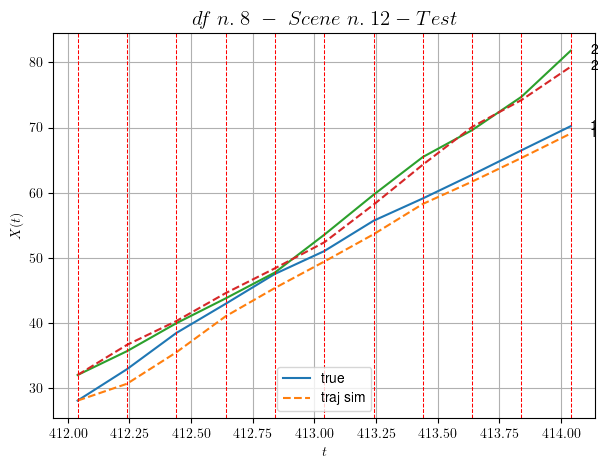

        For scene 12/72:
        * MSE = 2.145148627544111
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.13/72


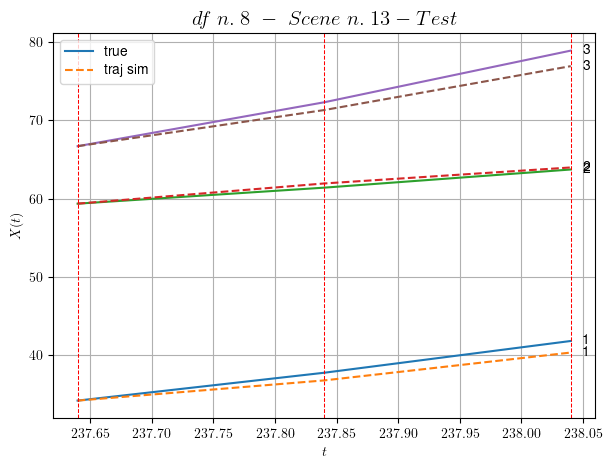

        For scene 13/72:
        * MSE = 0.9352241992358628
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.14/72


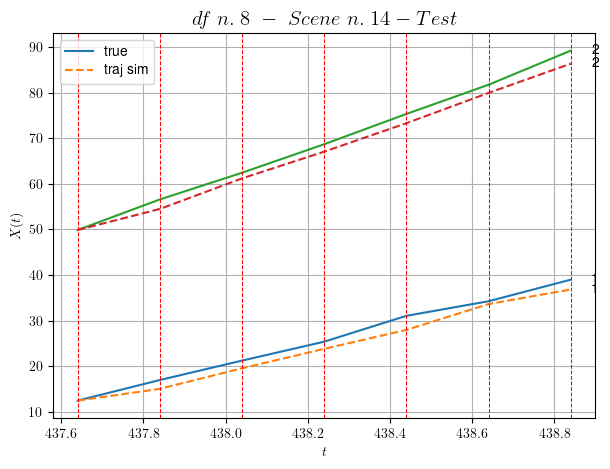

        For scene 14/72:
        * MSE = 3.399976000052951
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.15/72


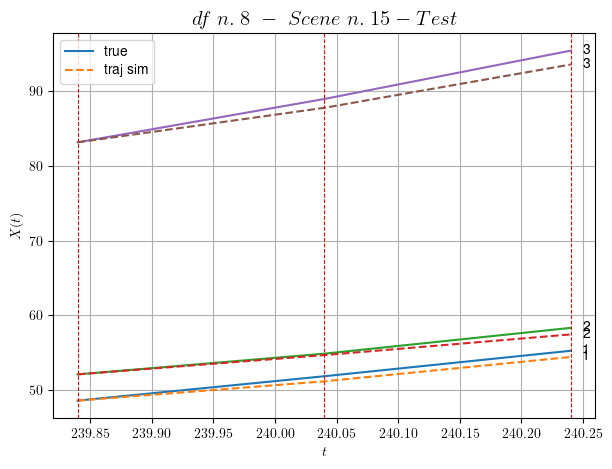

        For scene 15/72:
        * MSE = 0.7570156268479463
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.16/72


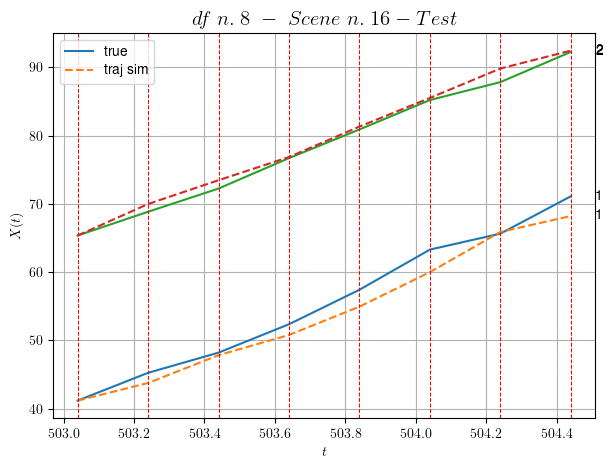

        For scene 16/72:
        * MSE = 2.3319644157650954
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.17/72


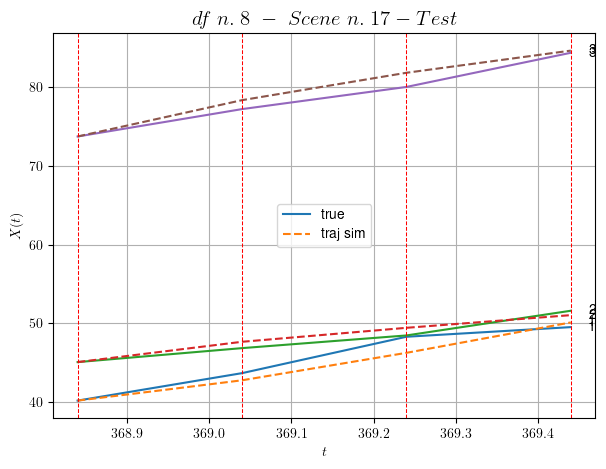

        For scene 17/72:
        * MSE = 0.9885435353887391
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.18/72


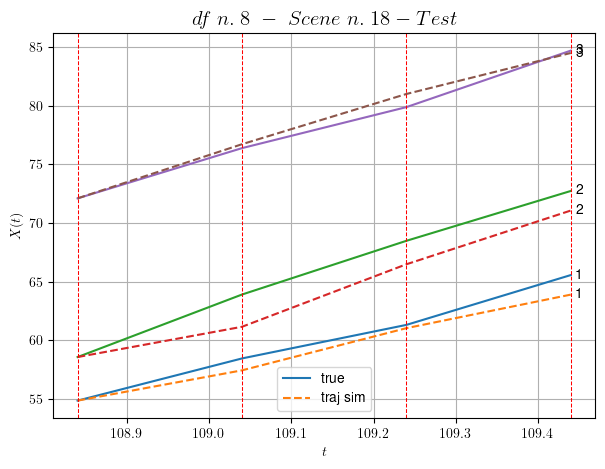

        For scene 18/72:
        * MSE = 1.63670522820854
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.19/72


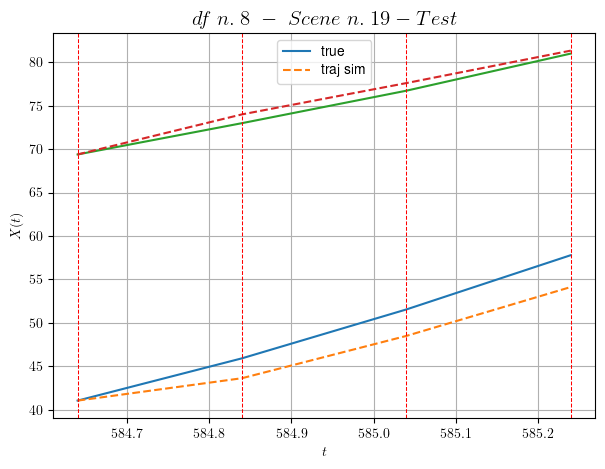

        For scene 19/72:
        * MSE = 3.740256998628645
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.20/72


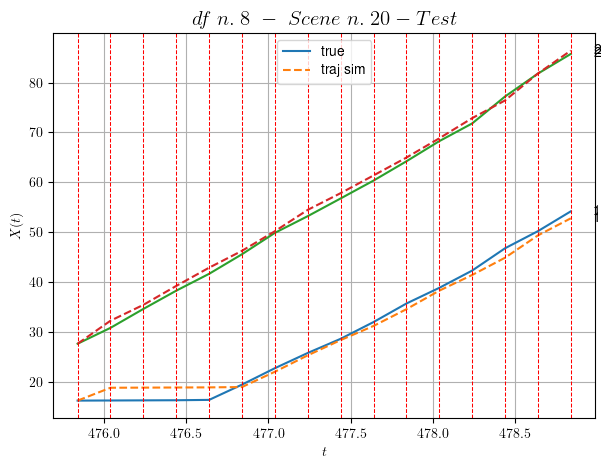

        For scene 20/72:
        * MSE = 1.5261204689757653
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.21/72


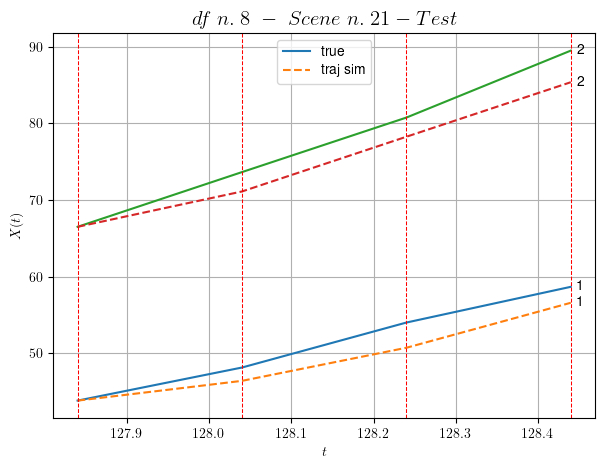

        For scene 21/72:
        * MSE = 5.9929193838091095
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.22/72


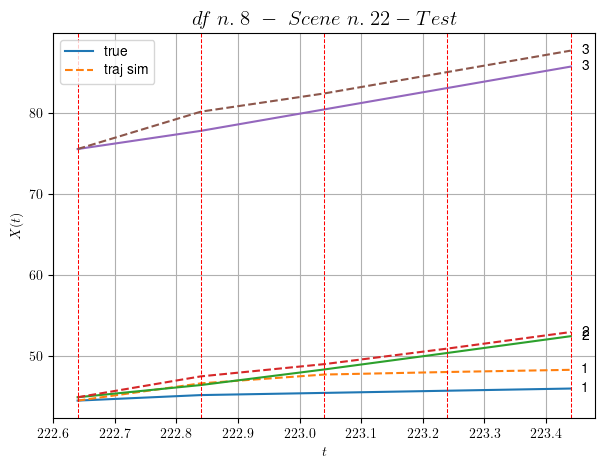

        For scene 22/72:
        * MSE = 2.490008964561422
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.23/72


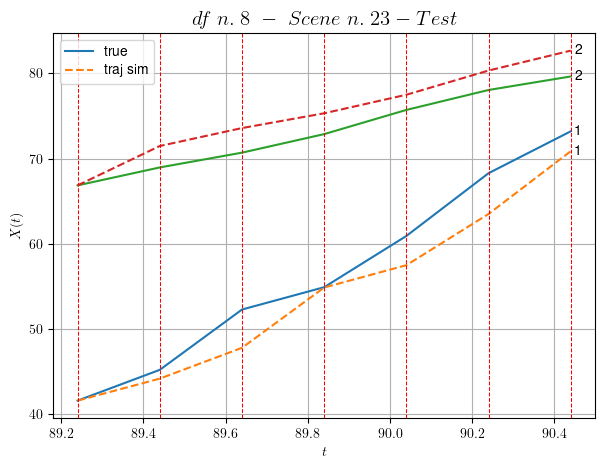

        For scene 23/72:
        * MSE = 7.0990745529382355
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.24/72


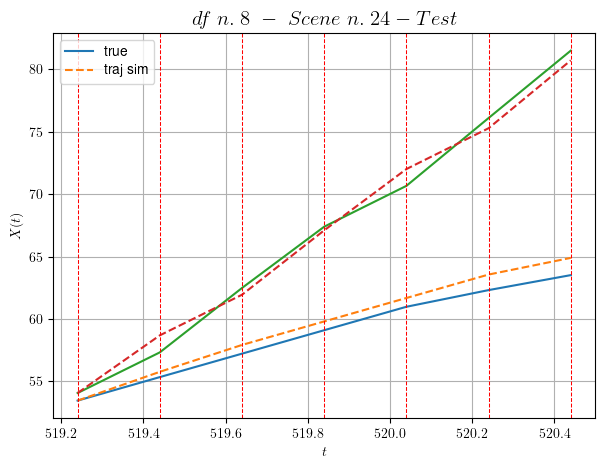

        For scene 24/72:
        * MSE = 0.7459233931968523
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.25/72


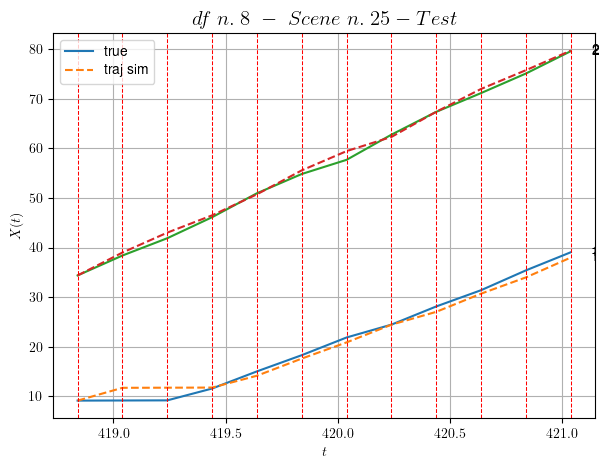

        For scene 25/72:
        * MSE = 1.123930154910149
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.26/72


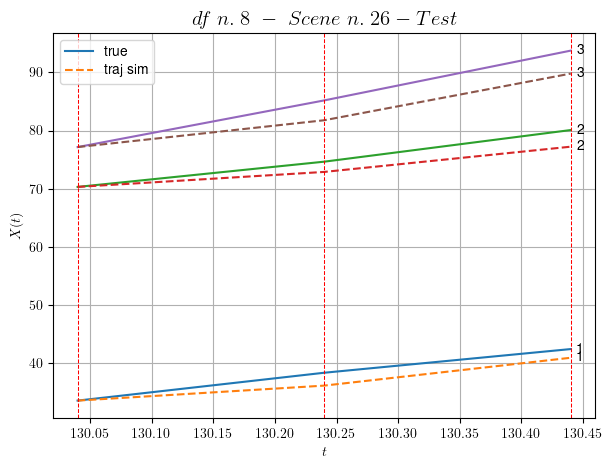

        For scene 26/72:
        * MSE = 5.082438952701094
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.27/72


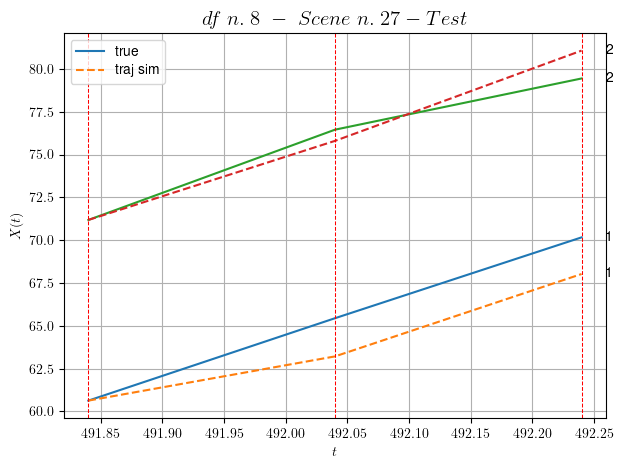

        For scene 27/72:
        * MSE = 2.103385513169221
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.28/72


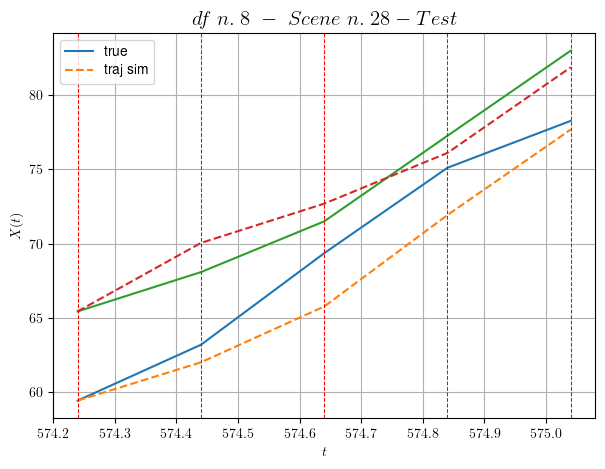

        For scene 28/72:
        * MSE = 3.2691482582879243
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.29/72


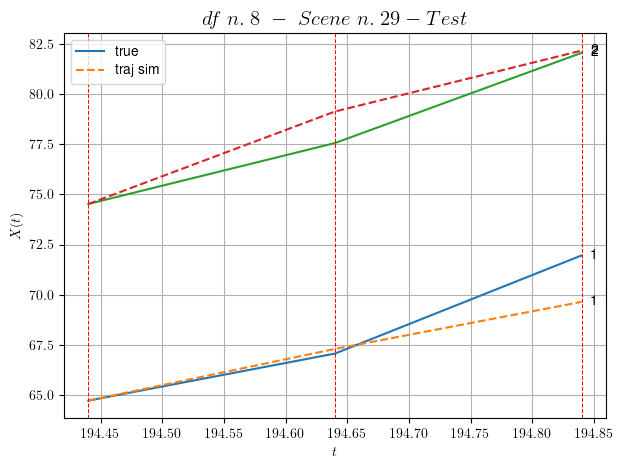

        For scene 29/72:
        * MSE = 1.3209540759672649
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.30/72


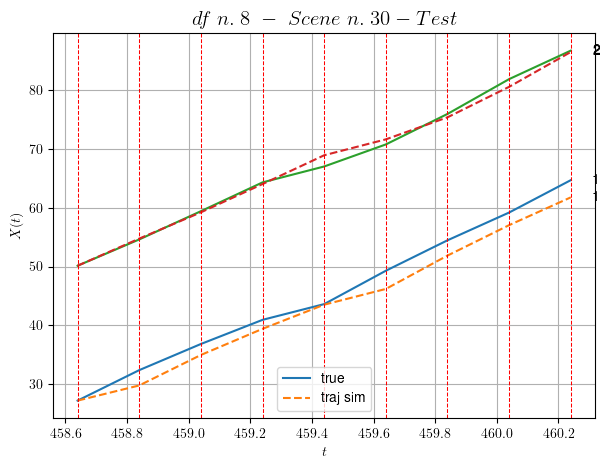

        For scene 30/72:
        * MSE = 2.713861147877139
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.31/72


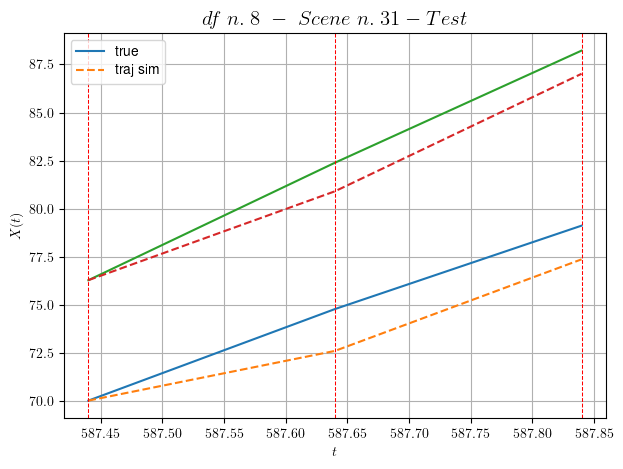

        For scene 31/72:
        * MSE = 1.9057435330199013
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.32/72


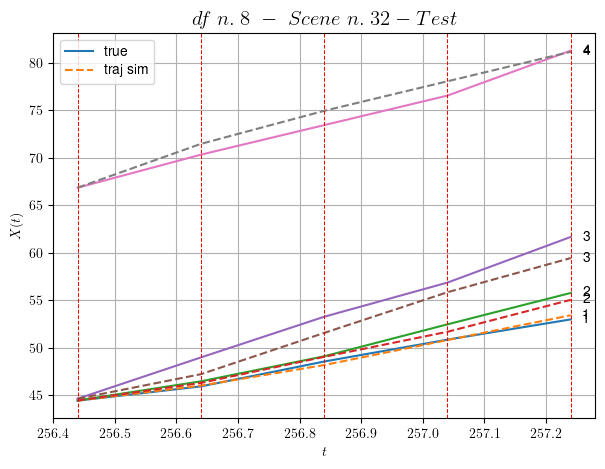

        For scene 32/72:
        * MSE = 0.9680447124822018
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.33/72


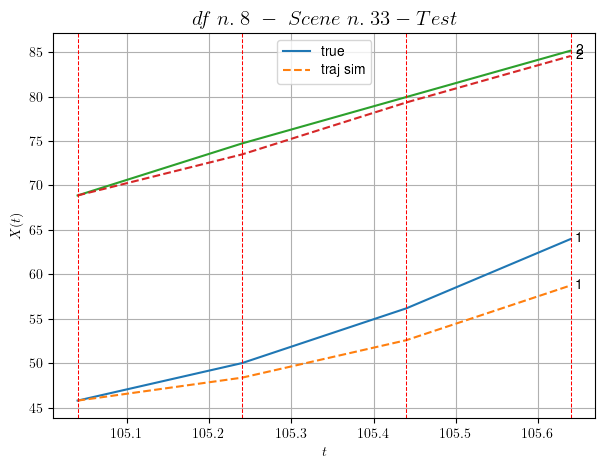

        For scene 33/72:
        * MSE = 5.636265019013926
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.34/72


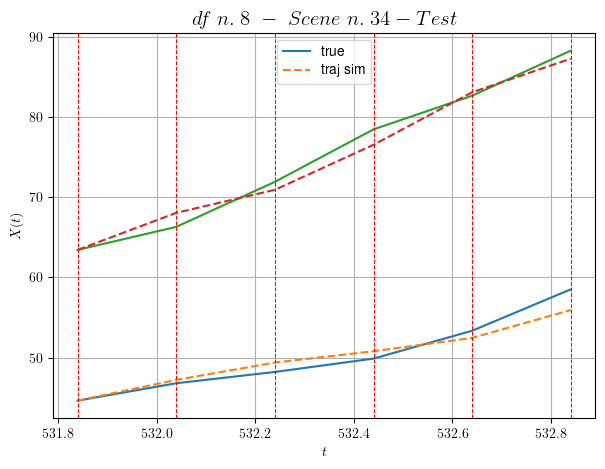

        For scene 34/72:
        * MSE = 1.565627887815832
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.35/72


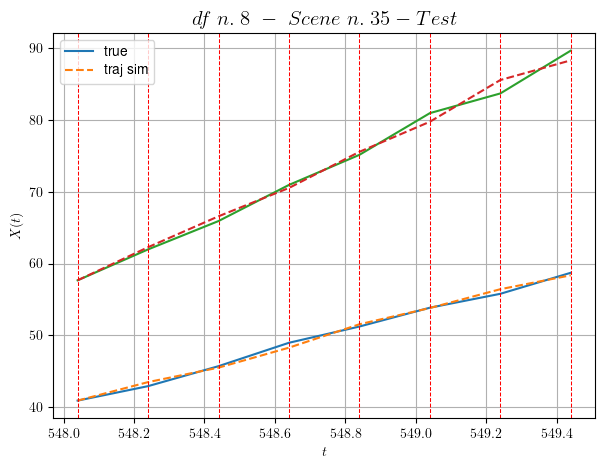

        For scene 35/72:
        * MSE = 0.5702553806303747
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.36/72


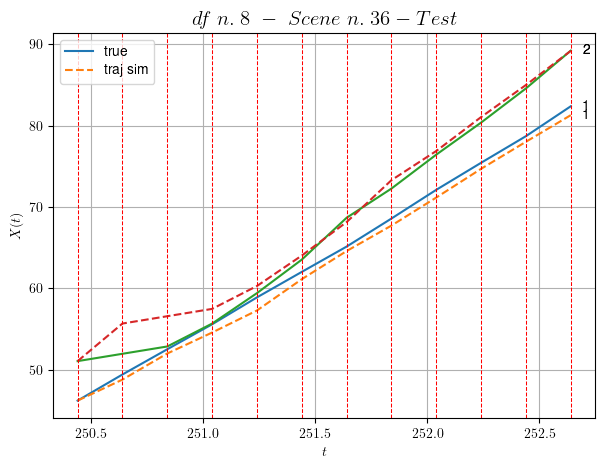

        For scene 36/72:
        * MSE = 1.806201883239983
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.37/72


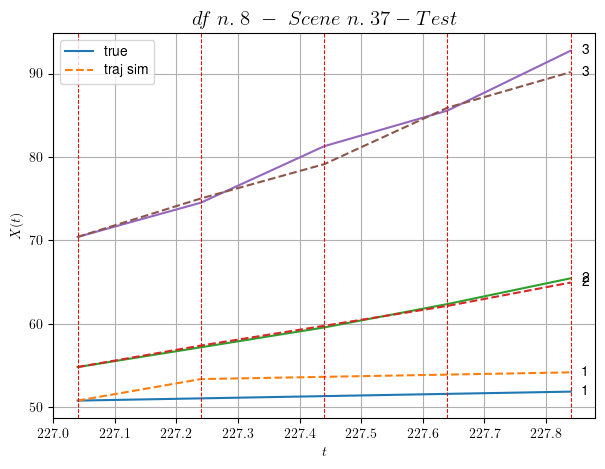

        For scene 37/72:
        * MSE = 2.2274678996472157
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.38/72


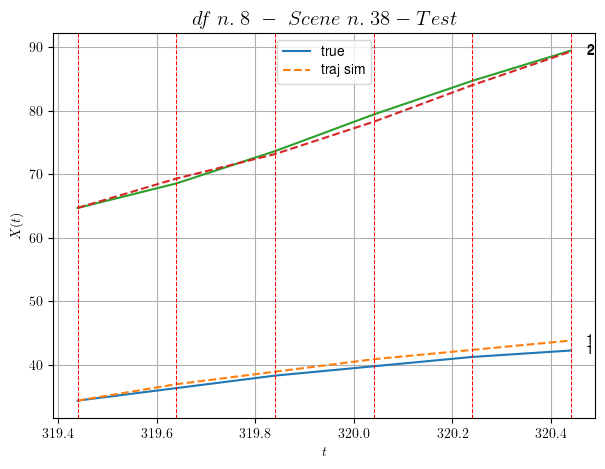

        For scene 38/72:
        * MSE = 0.6911347523160383
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.39/72


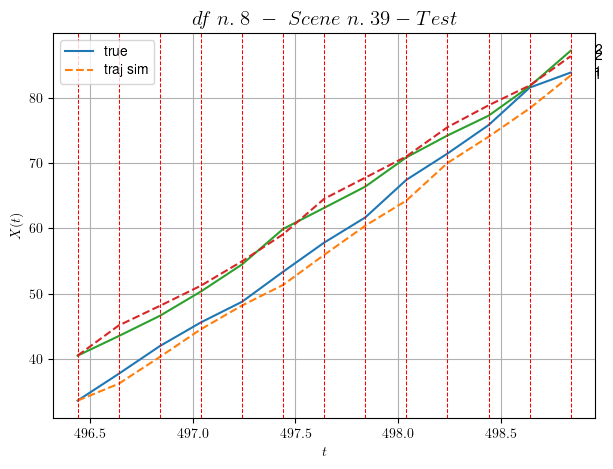

        For scene 39/72:
        * MSE = 2.1756907006587567
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.40/72


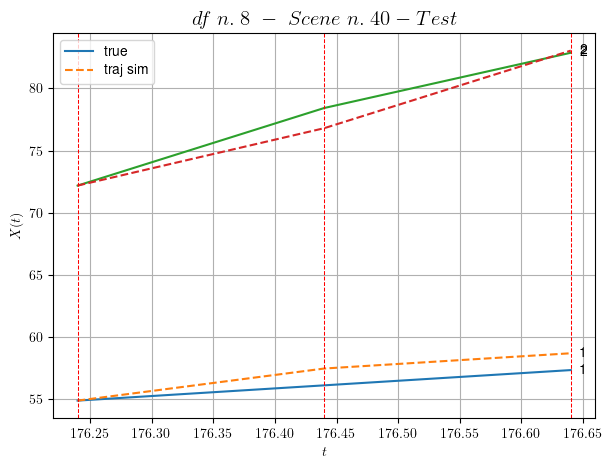

        For scene 40/72:
        * MSE = 1.0544267561030929
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.41/72


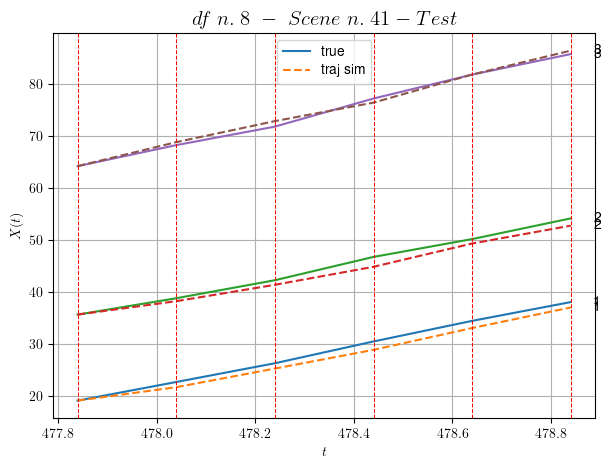

        For scene 41/72:
        * MSE = 0.972295723992647
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.42/72


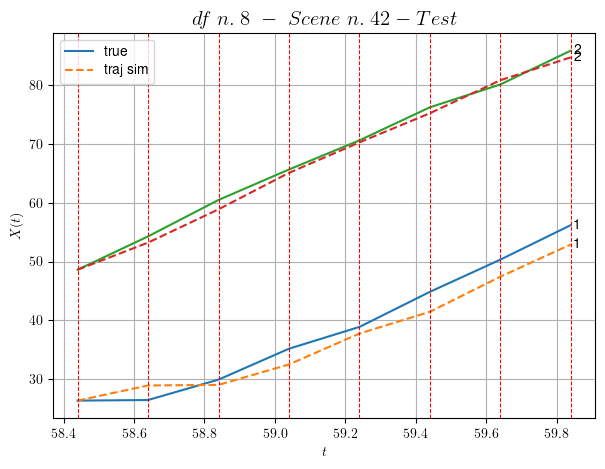

        For scene 42/72:
        * MSE = 3.3268660080040857
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.43/72


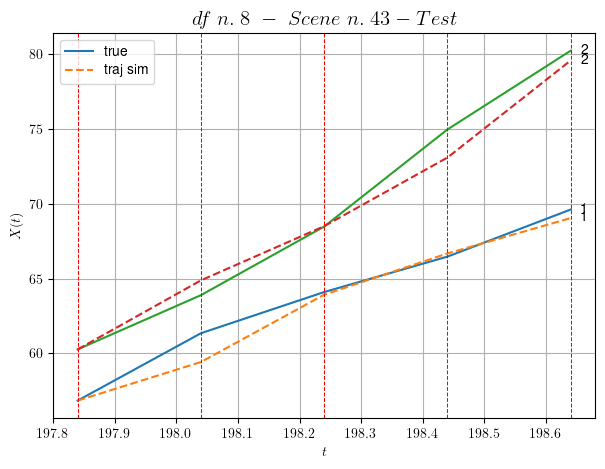

        For scene 43/72:
        * MSE = 0.9049398029195028
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.44/72


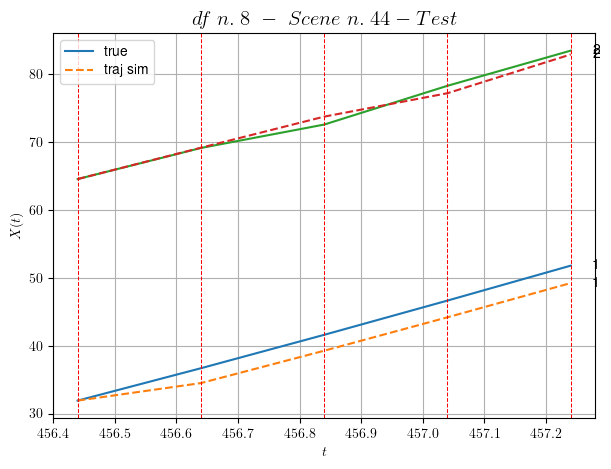

        For scene 44/72:
        * MSE = 2.579786376890397
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.45/72


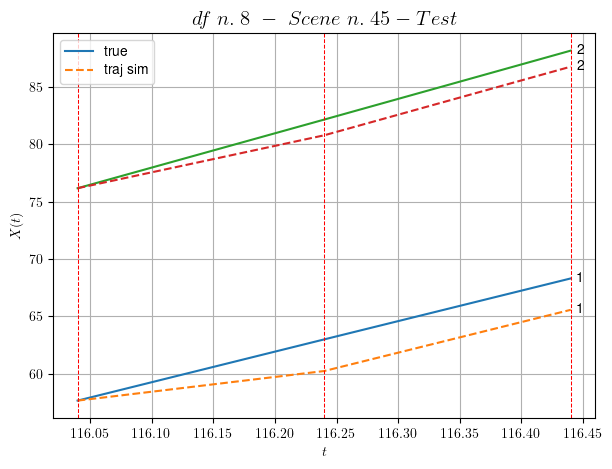

        For scene 45/72:
        * MSE = 3.1598006232344336
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.46/72


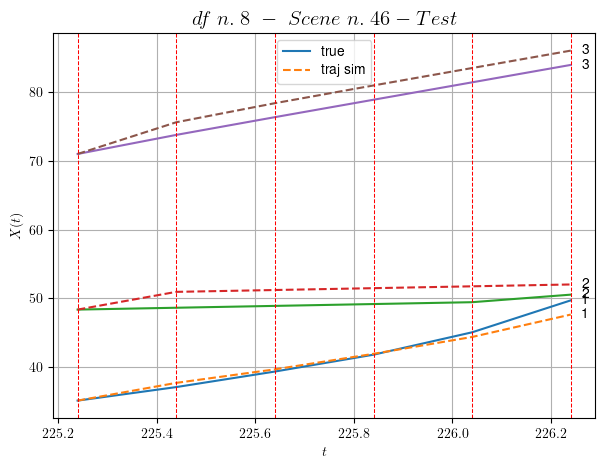

        For scene 46/72:
        * MSE = 2.7407017192535776
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.47/72


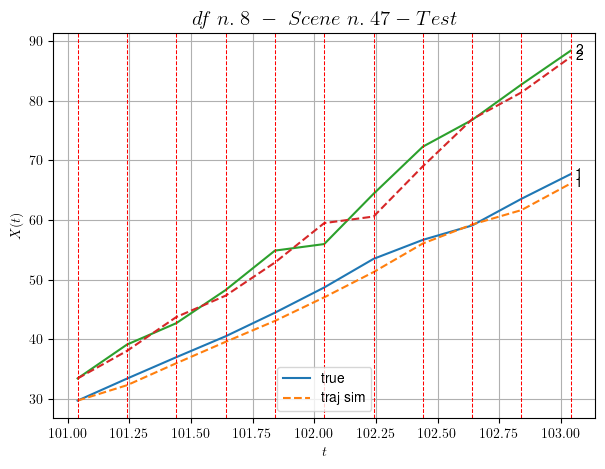

        For scene 47/72:
        * MSE = 3.040478134996394
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.48/72


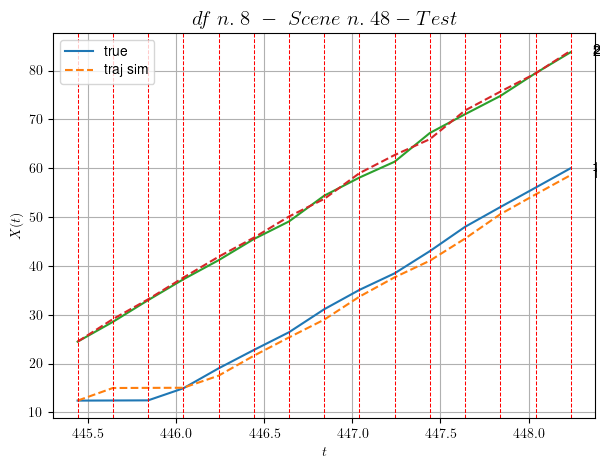

        For scene 48/72:
        * MSE = 1.629666790929698
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.49/72


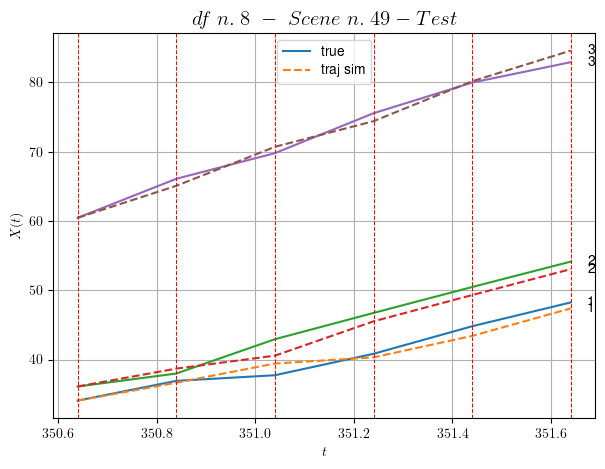

        For scene 49/72:
        * MSE = 1.2236761374377194
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.50/72


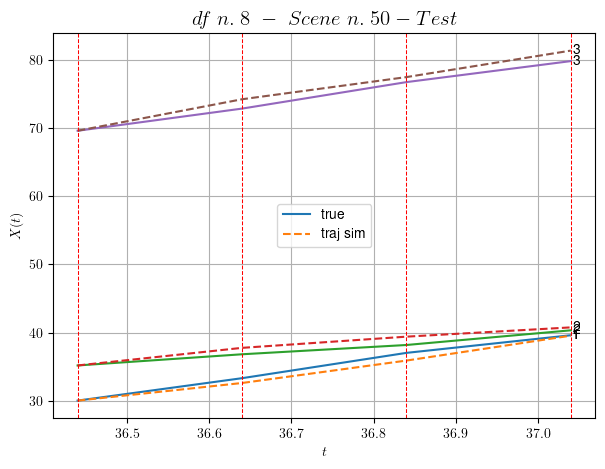

        For scene 50/72:
        * MSE = 0.7598677052116986
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.51/72


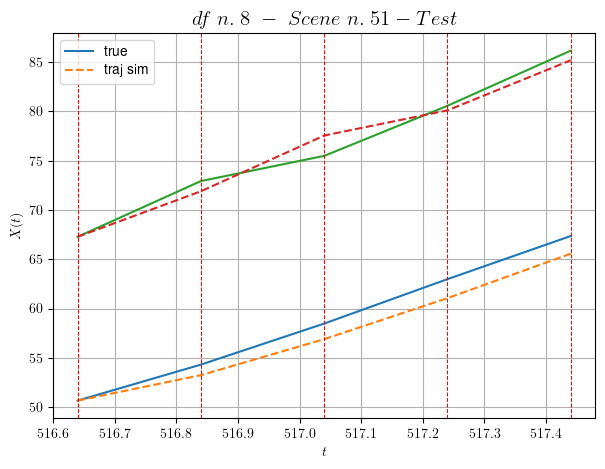

        For scene 51/72:
        * MSE = 1.70922848029265
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.52/72


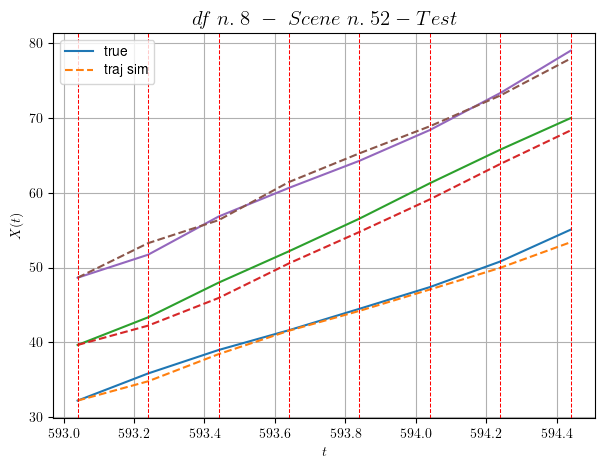

        For scene 52/72:
        * MSE = 1.3757572520634724
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.53/72


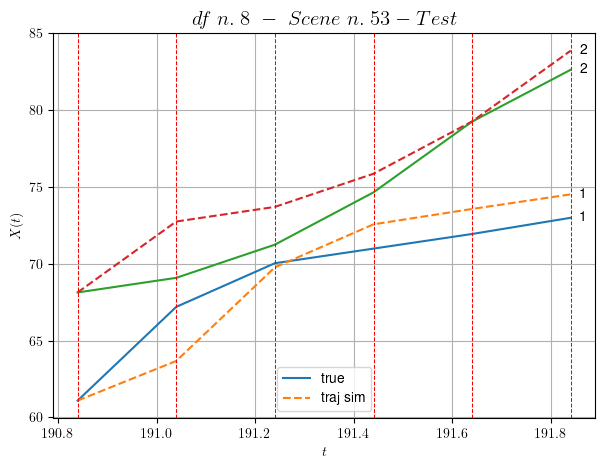

        For scene 53/72:
        * MSE = 3.5368331170573795
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.54/72


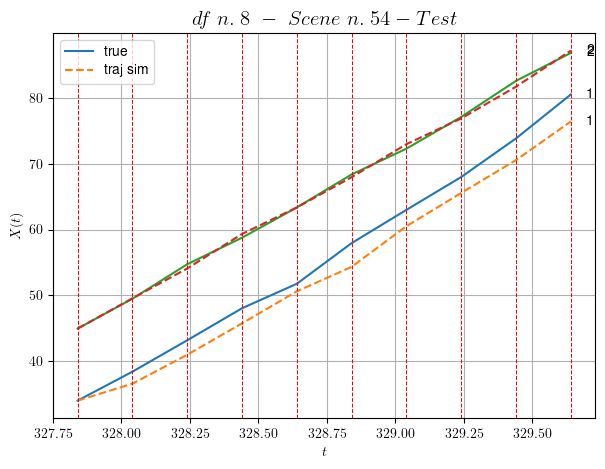

        For scene 54/72:
        * MSE = 3.5202272443137526
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.55/72


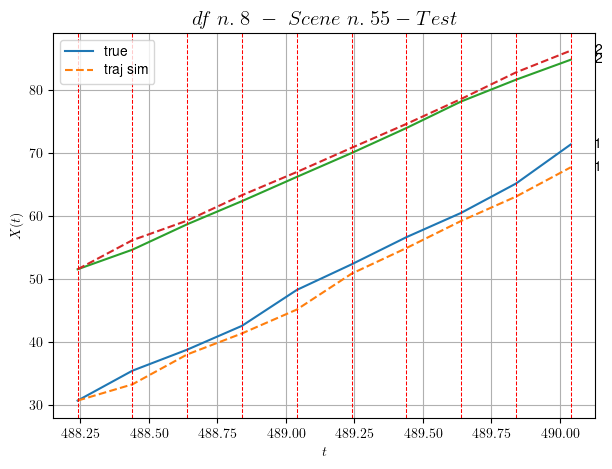

        For scene 55/72:
        * MSE = 2.4750028032841693
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.56/72


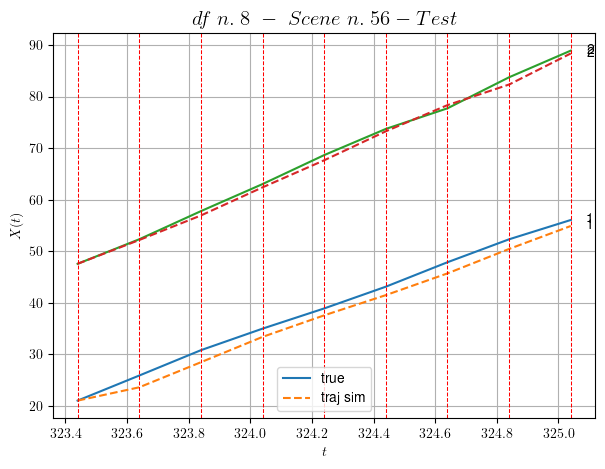

        For scene 56/72:
        * MSE = 1.7939649648490312
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.57/72


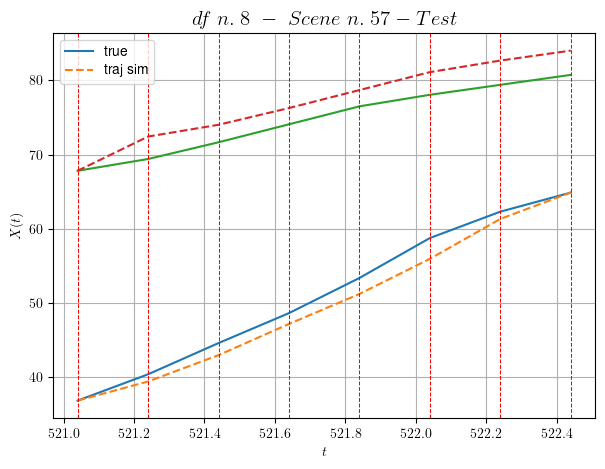

        For scene 57/72:
        * MSE = 4.648180216472197
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.58/72


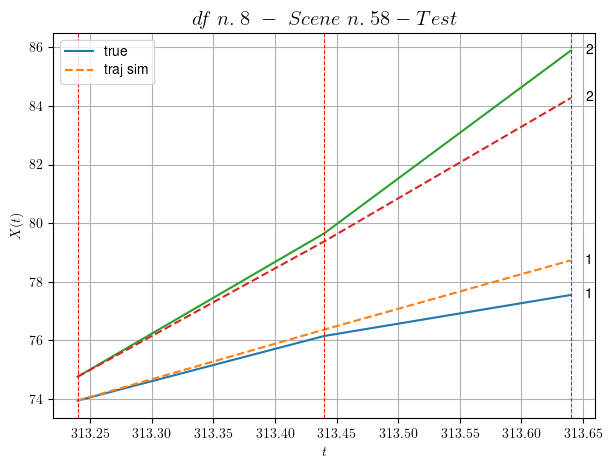

        For scene 58/72:
        * MSE = 0.6891762779487526
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.59/72


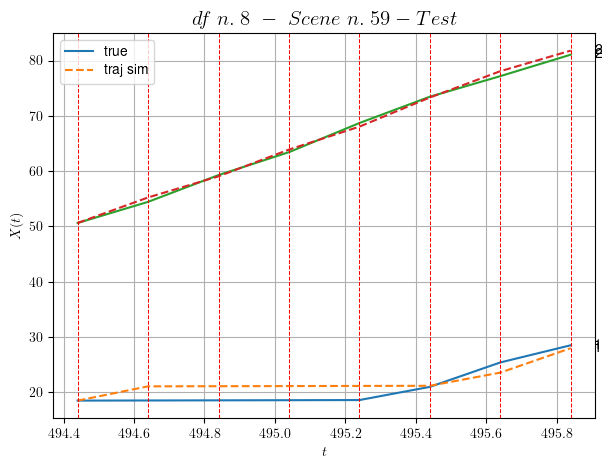

        For scene 59/72:
        * MSE = 2.033269086673843
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.60/72


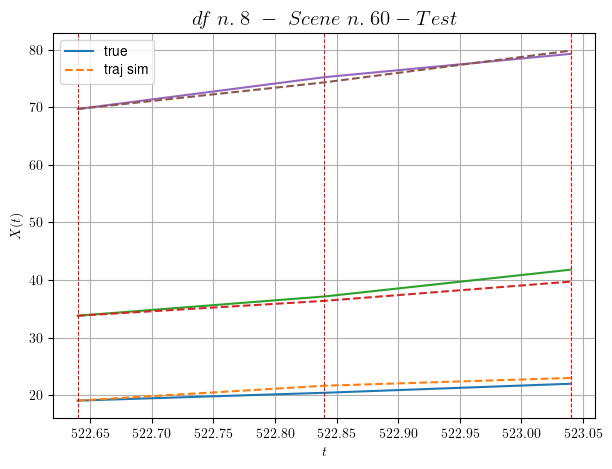

        For scene 60/72:
        * MSE = 0.9480639146577347
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.61/72


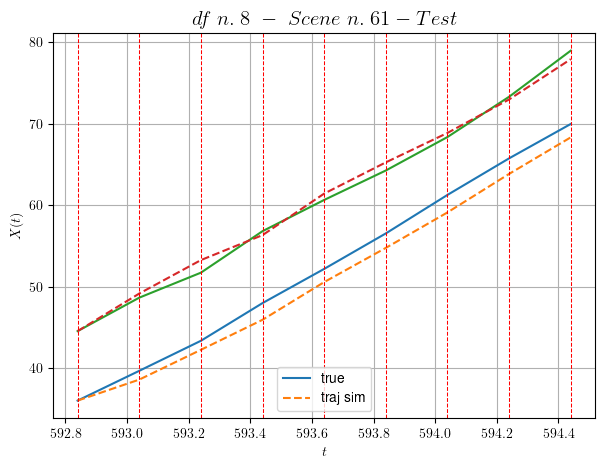

        For scene 61/72:
        * MSE = 1.6291268809060693
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.62/72


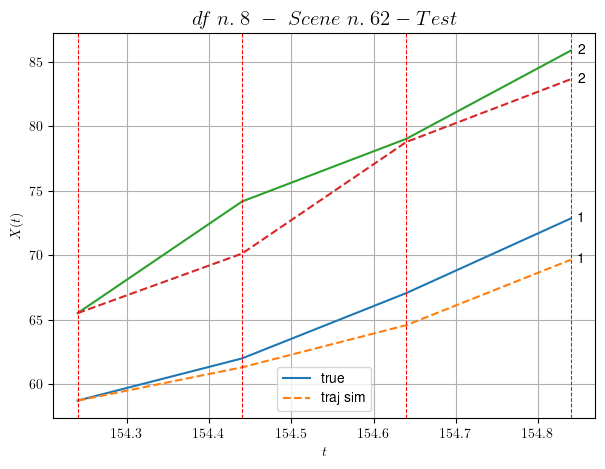

        For scene 62/72:
        * MSE = 4.773935054667122
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.63/72


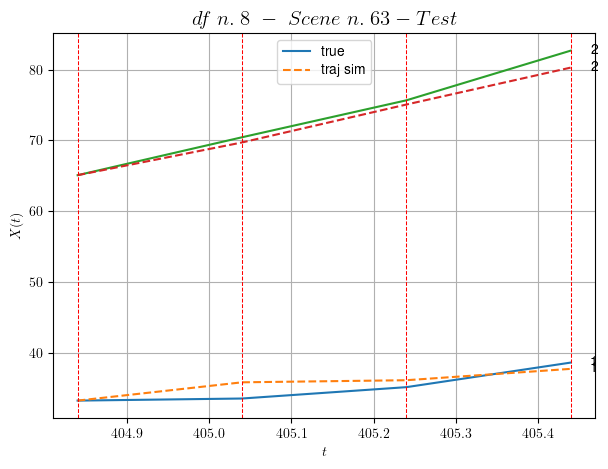

        For scene 63/72:
        * MSE = 1.698038362528802
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.64/72


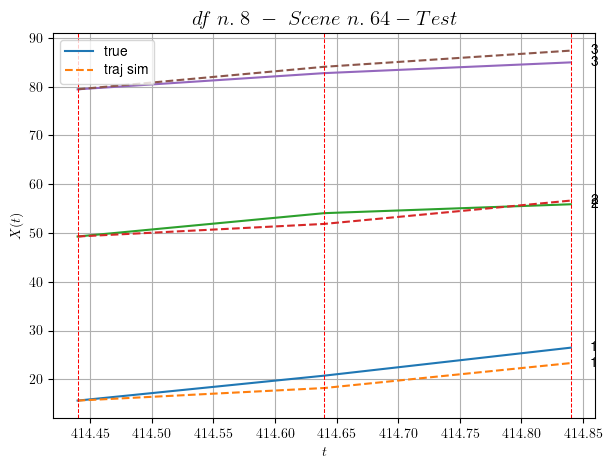

        For scene 64/72:
        * MSE = 3.261709891022086
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.65/72


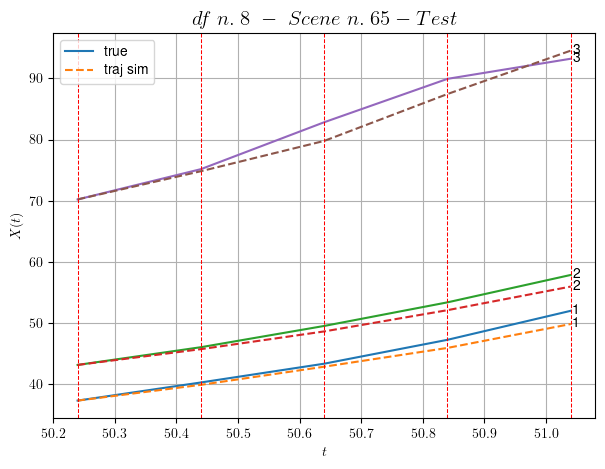

        For scene 65/72:
        * MSE = 2.0218395452179263
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.66/72


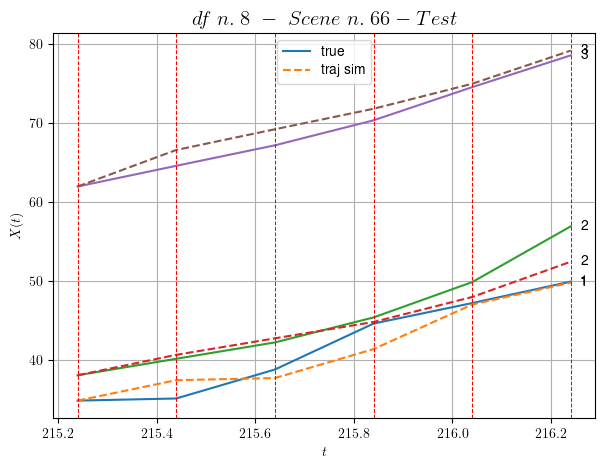

        For scene 66/72:
        * MSE = 2.8935606515057226
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.67/72


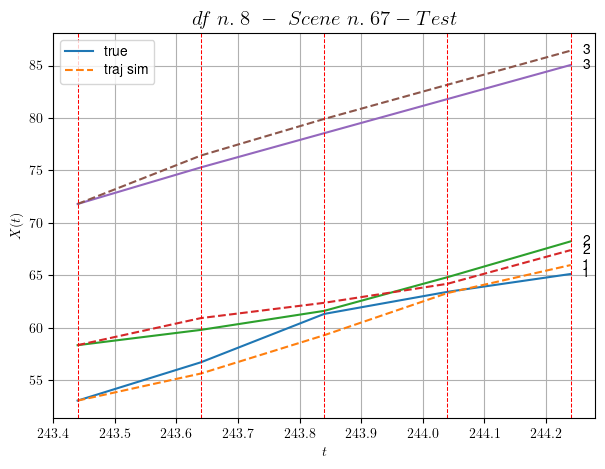

        For scene 67/72:
        * MSE = 1.0531193069641474
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.68/72


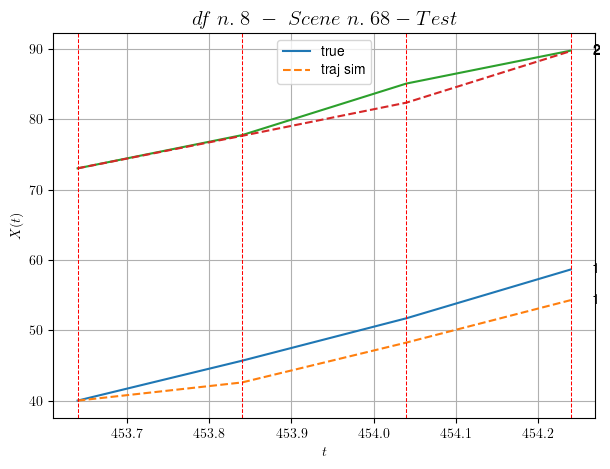

        For scene 68/72:
        * MSE = 5.9755613893958275
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.69/72


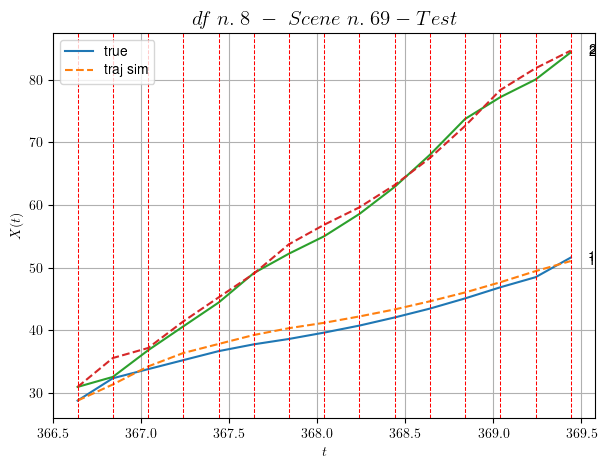

        For scene 69/72:
        * MSE = 1.4299102891515358
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.70/72


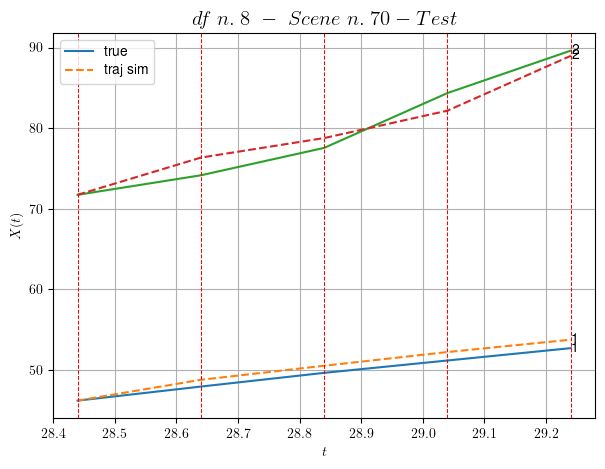

        For scene 70/72:
        * MSE = 1.5167440903625007
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.71/72


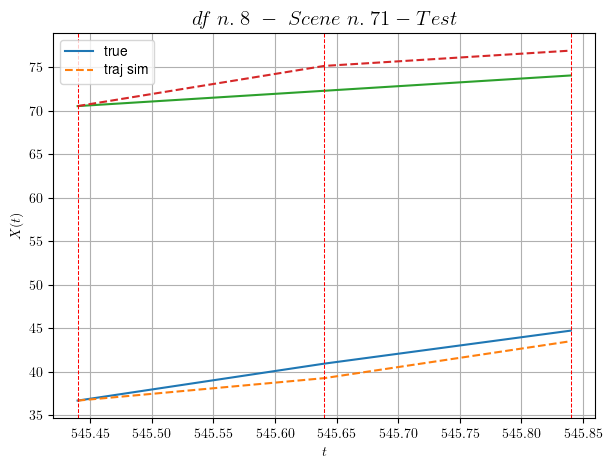

        For scene 71/72:
        * MSE = 3.430026233192439
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.72/72


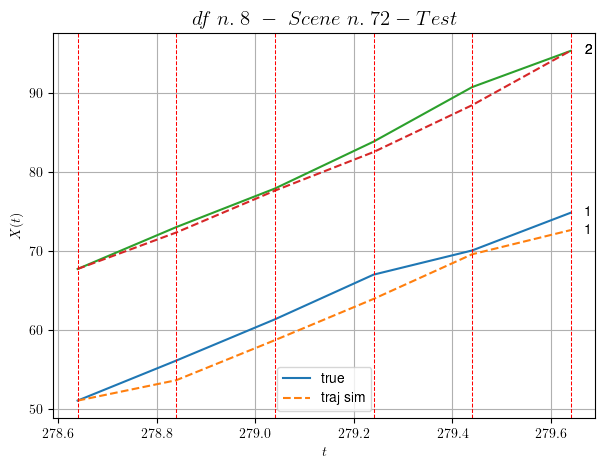

        For scene 72/72:
        * MSE = 2.929361365961857
----------------------------------------------------------------------------------------------------


MSE test: 2.433003186860729

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 1.5122616388588817
          * MSE test: 2.433003186860729
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 9/10 dfs.
In DataFrame n.9 we have 33 scenes.
    To train the model we use 3 scenes, the remaining 30 to test the model.

Training step. (3 scenes)
DataFrame n.9. Scene n.1/3
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [140.00,140.40]


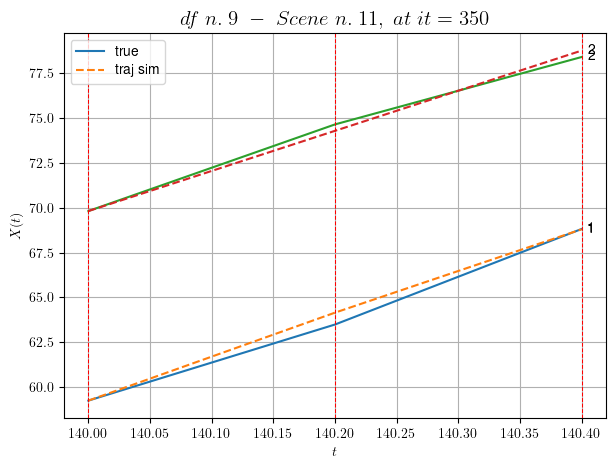

----------------------------------------------------------------------------------------------------
        For scene 1/3:
        * After LR finder: LR_NN=0.005 with mse=2.2495131905873826 at it=24
        * v0 = 22.365188464684348
        * MSE = 0.11563833140721952
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.2/3
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [161.60,162.80]


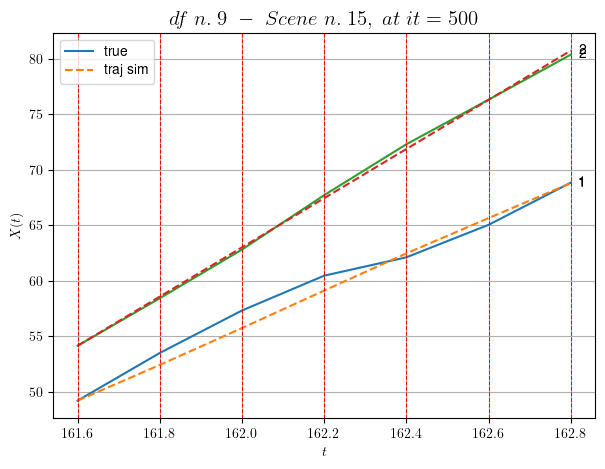

----------------------------------------------------------------------------------------------------
        For scene 2/3:
        * After LR finder: LR_NN=0.005 with mse=16.43947844610389 at it=24
        * v0 = 22.164023913692947
        * MSE = 0.4461091156349821
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.3/3
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [117.80,118.40]


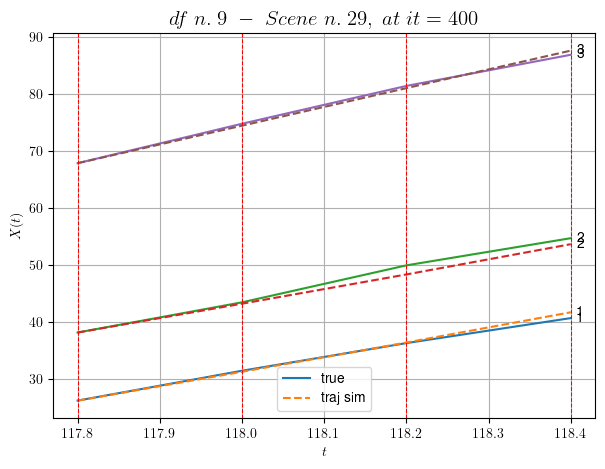

----------------------------------------------------------------------------------------------------
        For scene 3/3:
        * After LR finder: LR_NN=0.005 with mse=0.8034676449070686 at it=24
        * v0 = 32.94782183132055
        * MSE = 0.4619182199517178
        * iterations = 400
----------------------------------------------------------------------------------------------------


MSE train: 0.3412218889979732
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (30 scenes)
DataFrame n.9. Scene n.1/30


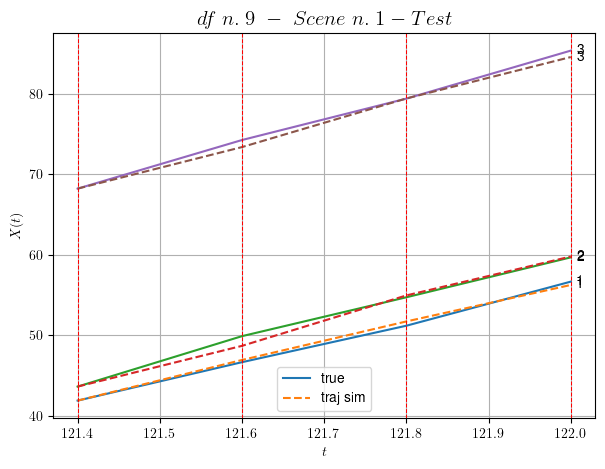

        For scene 1/30:
        * MSE = 0.28780676774462405
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.2/30


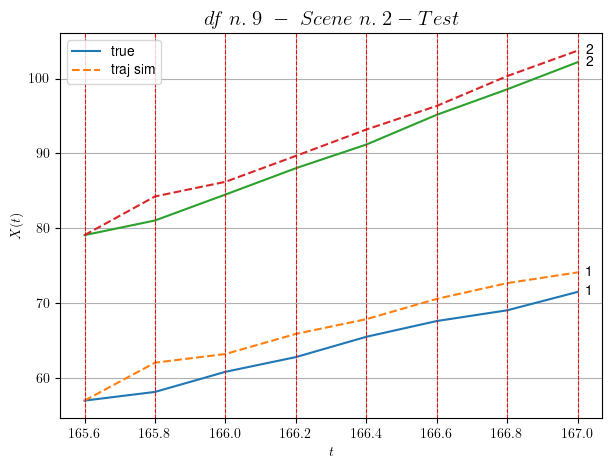

        For scene 2/30:
        * MSE = 5.724447718286706
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.3/30


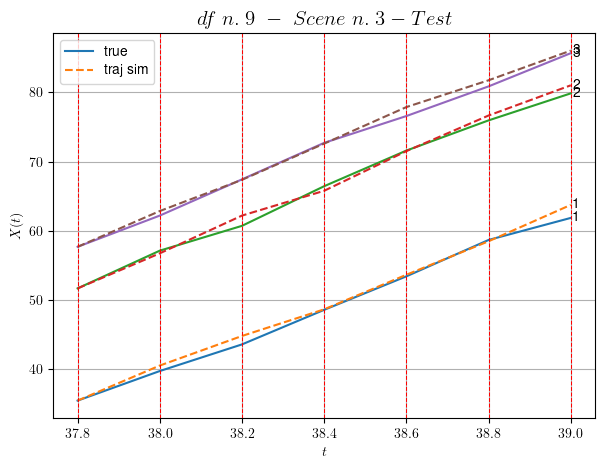

        For scene 3/30:
        * MSE = 0.6384730059311904
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.4/30


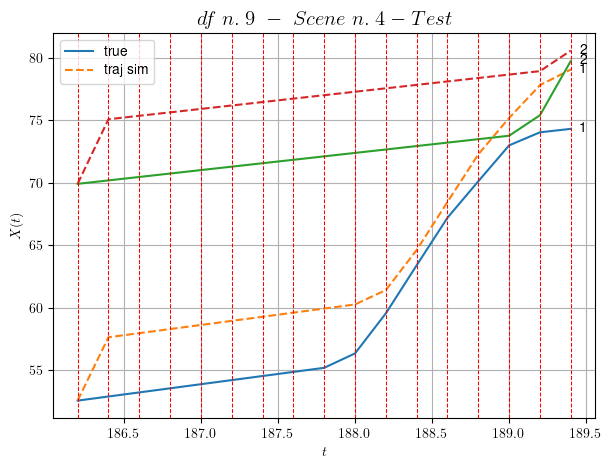

        For scene 4/30:
        * MSE = 17.513817562597577
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.5/30


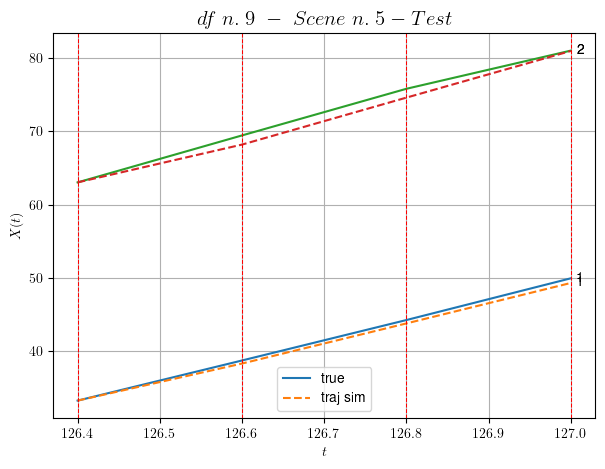

        For scene 5/30:
        * MSE = 0.4780565787678997
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.6/30


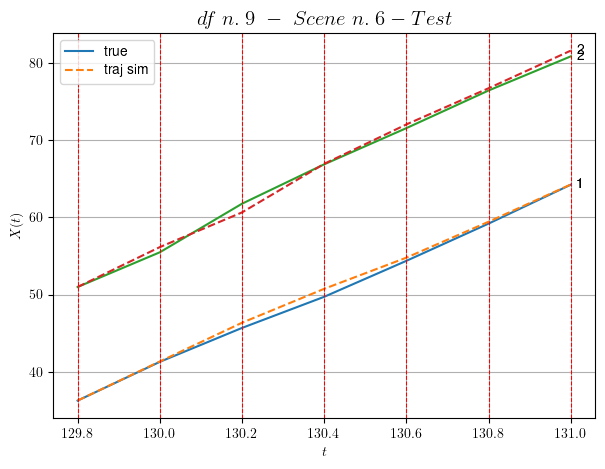

        For scene 6/30:
        * MSE = 0.30969734889101086
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.7/30


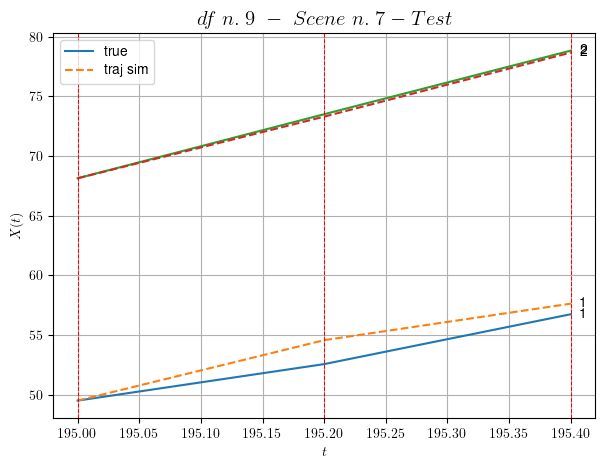

        For scene 7/30:
        * MSE = 0.8126427303062915
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.8/30


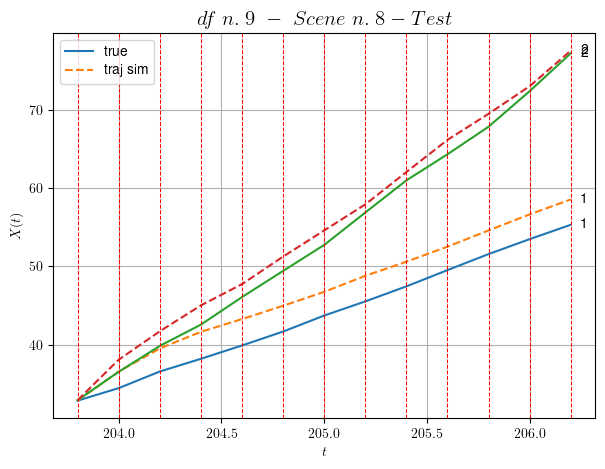

        For scene 8/30:
        * MSE = 5.592242098181089
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.9/30


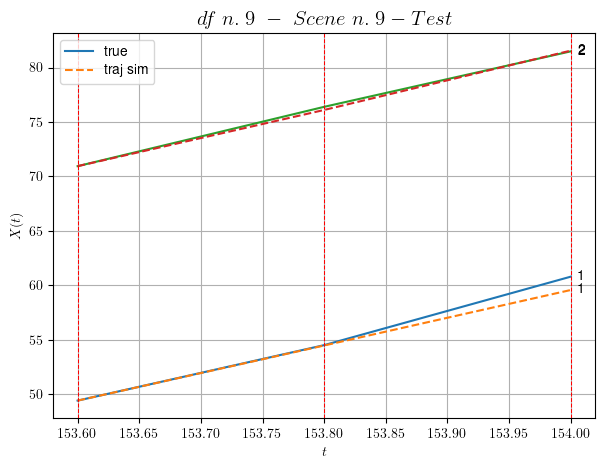

        For scene 9/30:
        * MSE = 0.26516329428876534
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.10/30


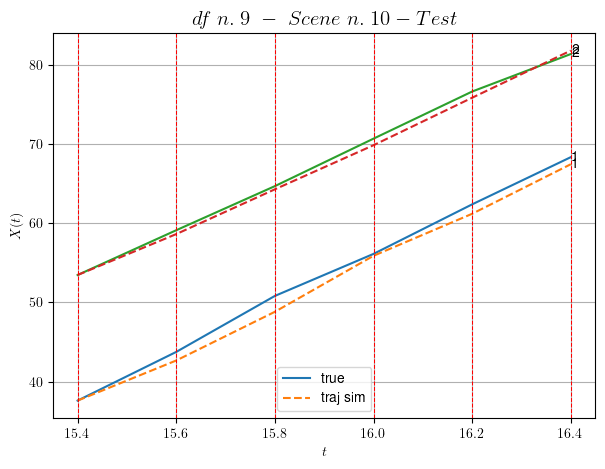

        For scene 10/30:
        * MSE = 0.7775666625723743
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.11/30


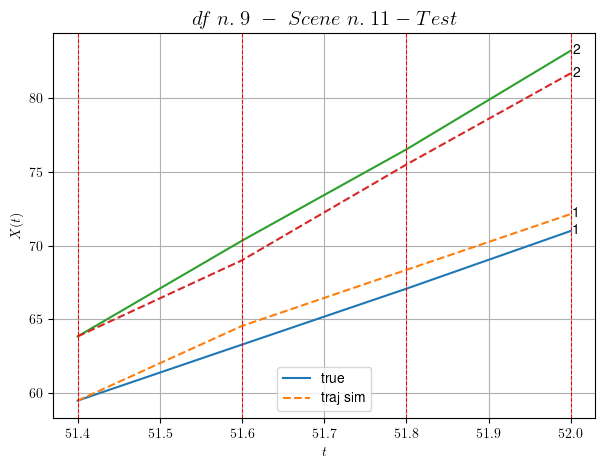

        For scene 11/30:
        * MSE = 1.2138010033392423
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.12/30


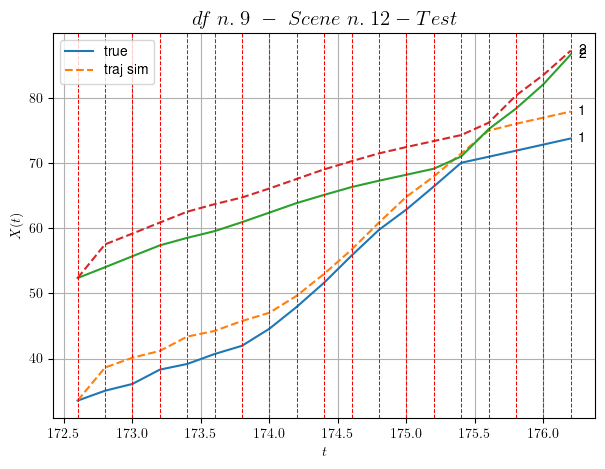

        For scene 12/30:
        * MSE = 10.108559067304407
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.13/30


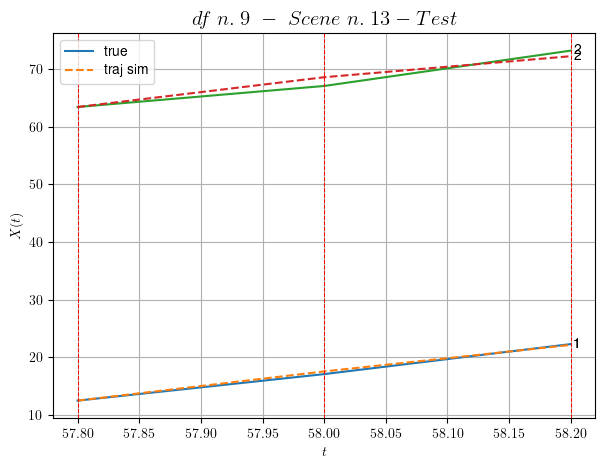

        For scene 13/30:
        * MSE = 0.5799876618543753
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.14/30


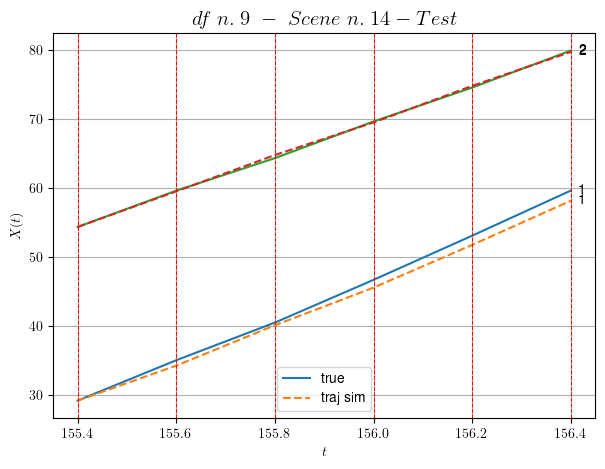

        For scene 14/30:
        * MSE = 0.5276814095346916
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.15/30


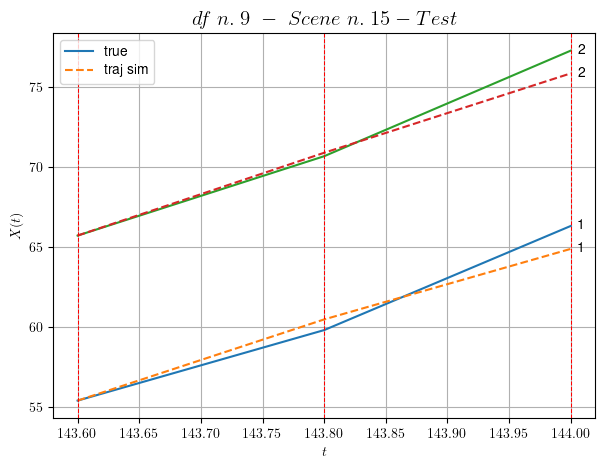

        For scene 15/30:
        * MSE = 0.7581074555743019
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.16/30


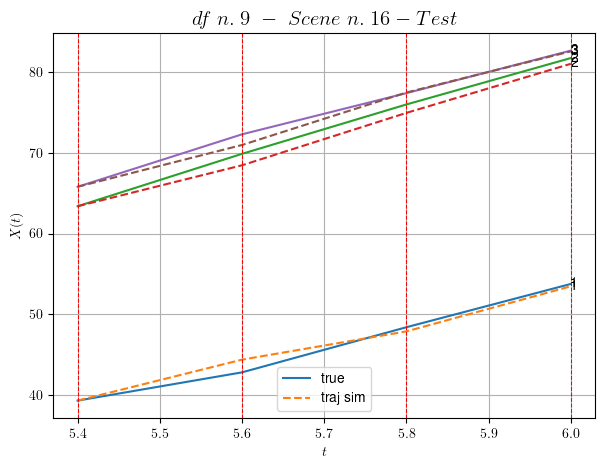

        For scene 16/30:
        * MSE = 0.6808120340752398
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.17/30


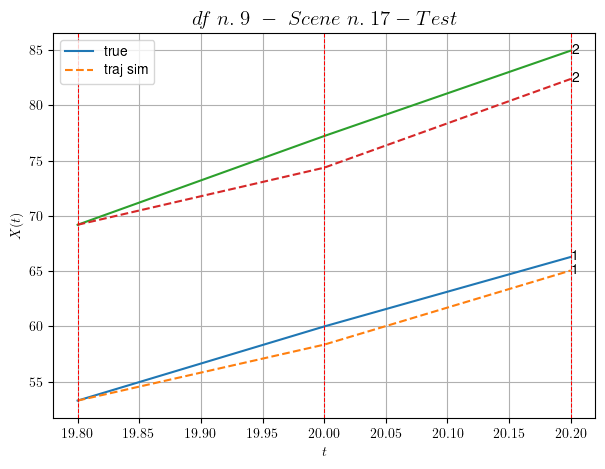

        For scene 17/30:
        * MSE = 3.162782454737971
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.18/30


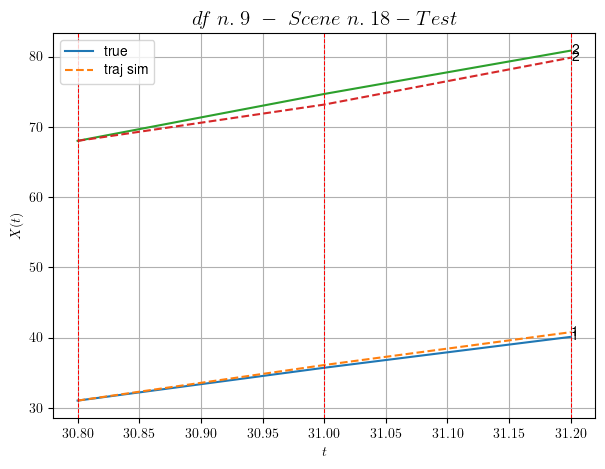

        For scene 18/30:
        * MSE = 0.6479221075502877
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.19/30


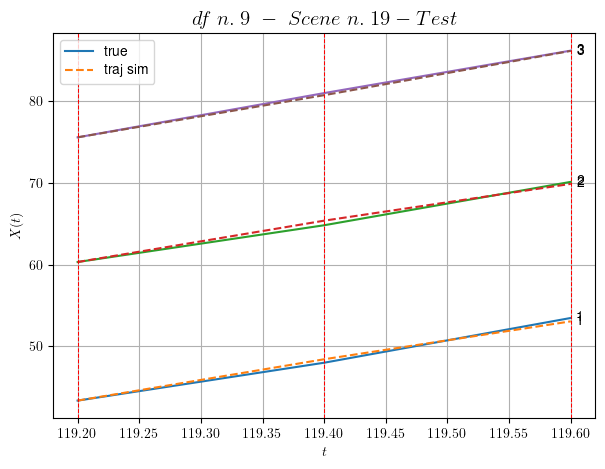

        For scene 19/30:
        * MSE = 0.08804369975323285
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.20/30


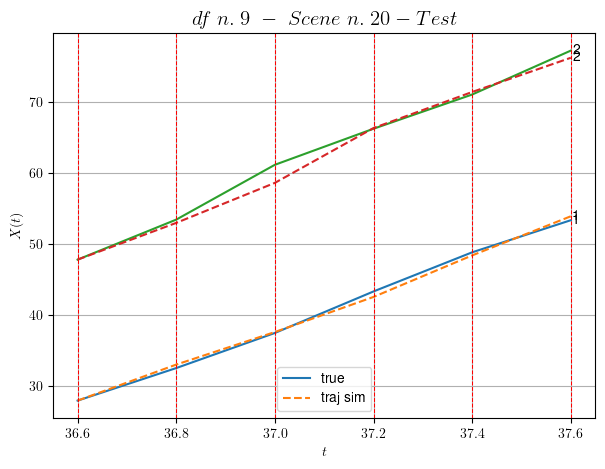

        For scene 20/30:
        * MSE = 0.7634224967962399
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.21/30


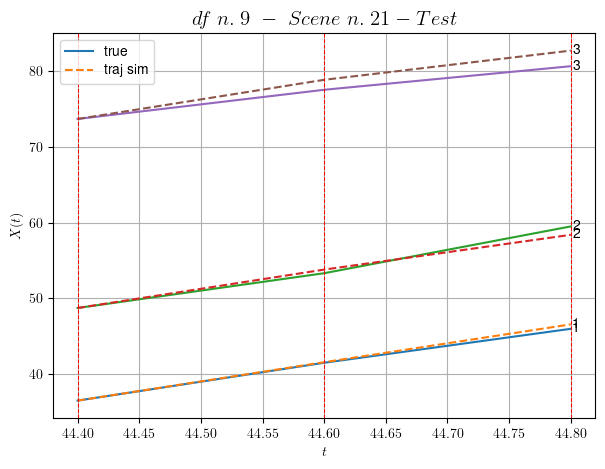

        For scene 21/30:
        * MSE = 0.8617217871286654
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.22/30


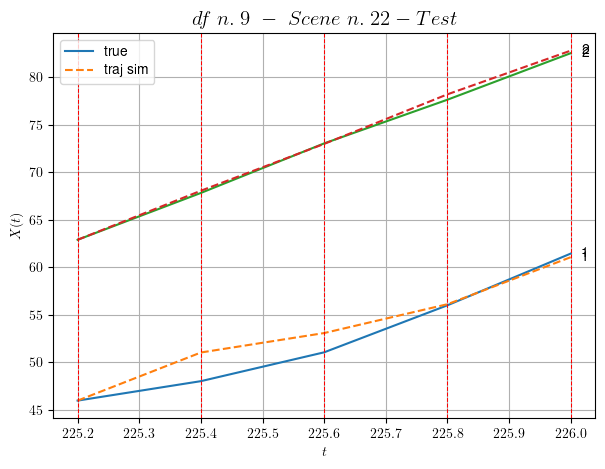

        For scene 22/30:
        * MSE = 1.3819488351173148
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.23/30


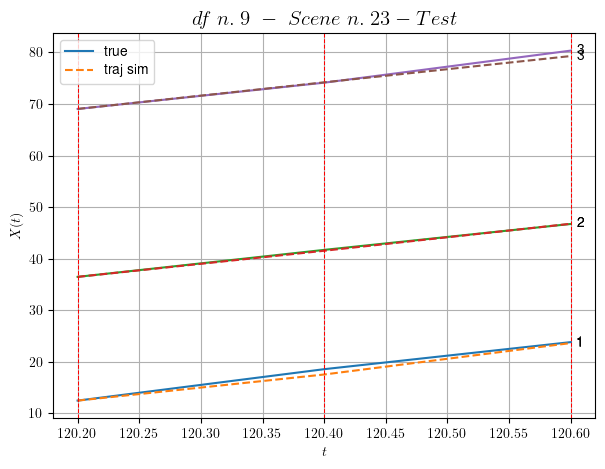

        For scene 23/30:
        * MSE = 0.24939430730053935
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.24/30


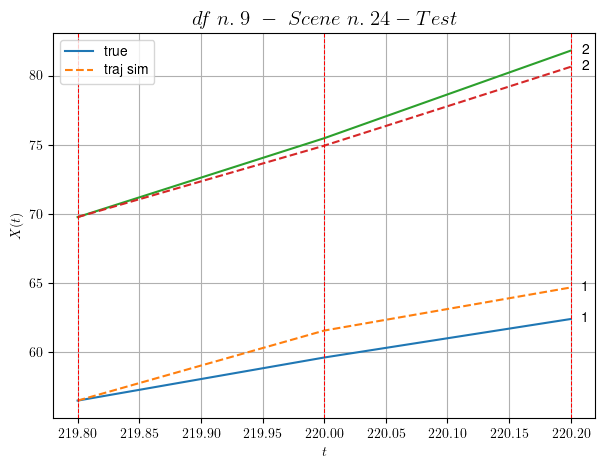

        For scene 24/30:
        * MSE = 1.7750447180678068
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.25/30


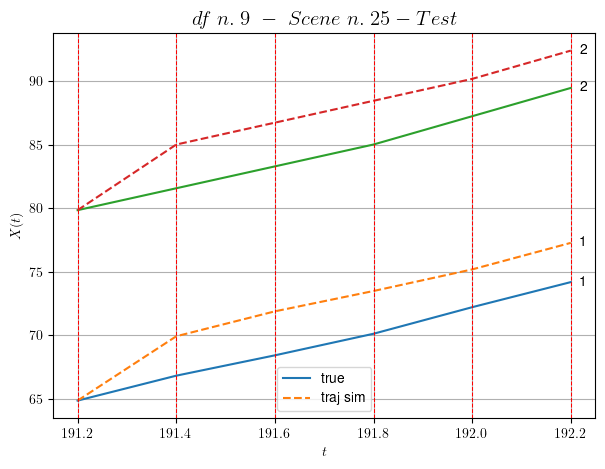

        For scene 25/30:
        * MSE = 8.679318047637476
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.26/30


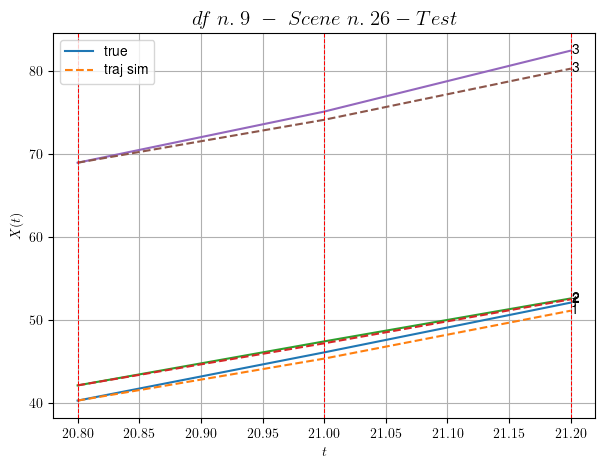

        For scene 26/30:
        * MSE = 0.8062775869770872
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.27/30


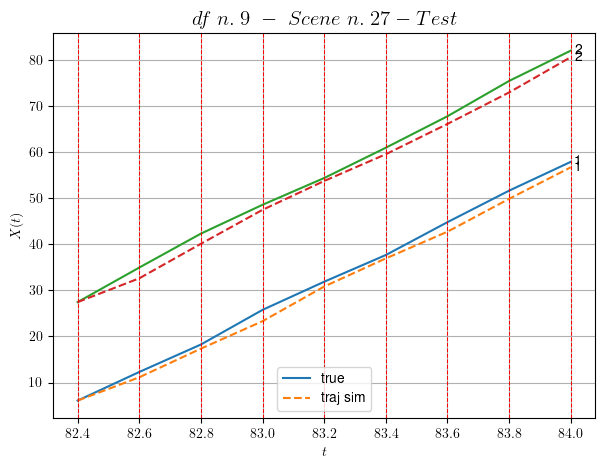

        For scene 27/30:
        * MSE = 2.421321990001511
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.28/30


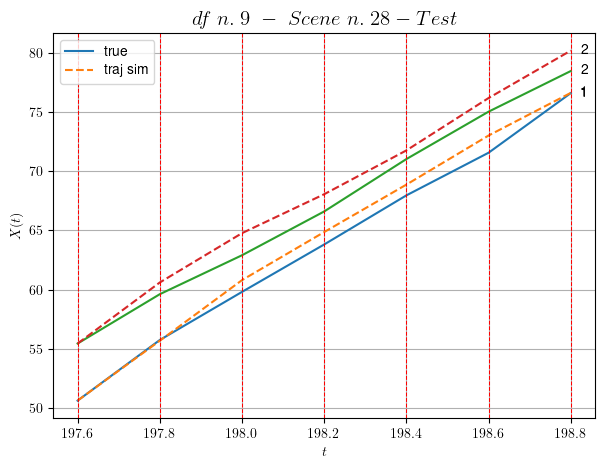

        For scene 28/30:
        * MSE = 1.1789877843112624
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.29/30


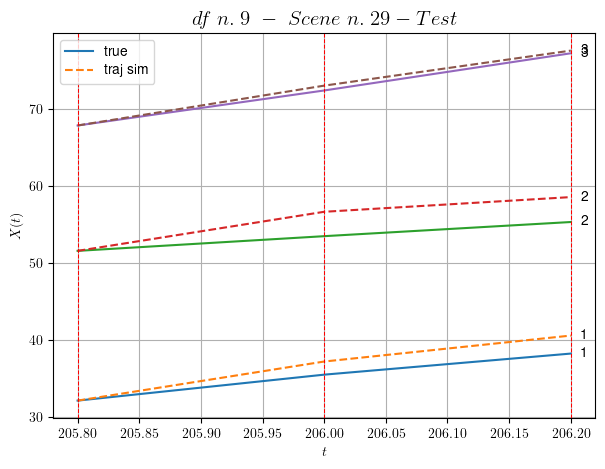

        For scene 29/30:
        * MSE = 3.2526700100099917
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.30/30


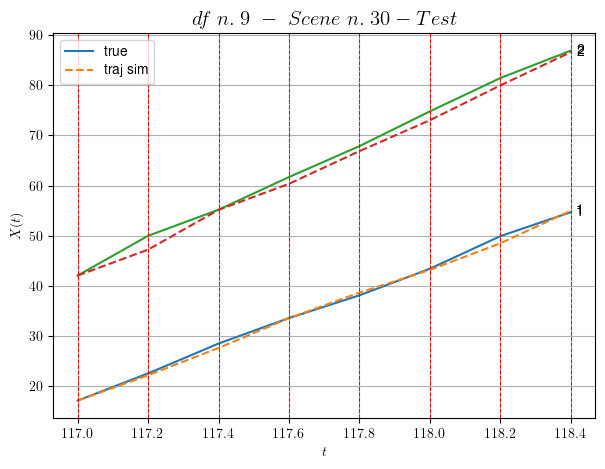

        For scene 30/30:
        * MSE = 1.1975939374742863
----------------------------------------------------------------------------------------------------


MSE test: 2.424510405403782

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.3412218889979732
          * MSE test: 2.424510405403782
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 10/10 dfs.
In DataFrame n.10 we have 74 scenes.
    To train the model we use 7 scenes, the remaining 67 to test the model.

Training step. (7 scenes)
DataFrame n.10. Scene n.1/7
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [34.92,36.32]


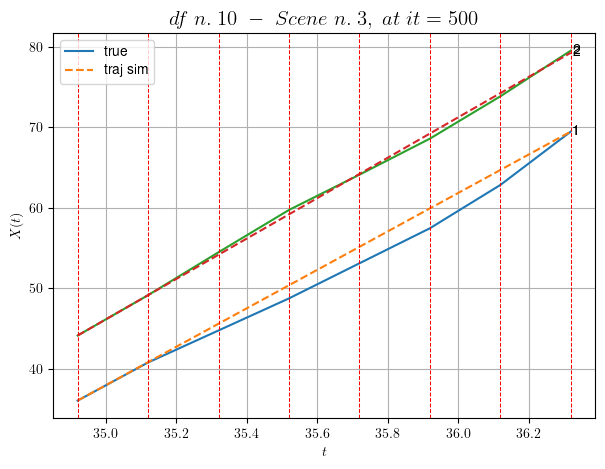

----------------------------------------------------------------------------------------------------
        For scene 1/7:
        * After LR finder: LR_NN=5e-05 with mse=9.103805797203869 at it=24
        * v0 = 25.102289962227612
        * MSE = 1.133106804330332
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.2/7
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [235.52,235.92]


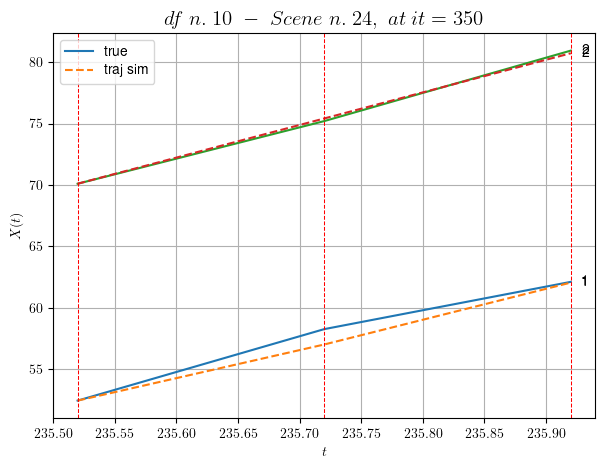

----------------------------------------------------------------------------------------------------
        For scene 2/7:
        * After LR finder: LR_NN=0.005 with mse=0.6568797807027835 at it=24
        * v0 = 26.569531431549684
        * MSE = 0.2766299905217892
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.3/7
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [209.32,210.52]


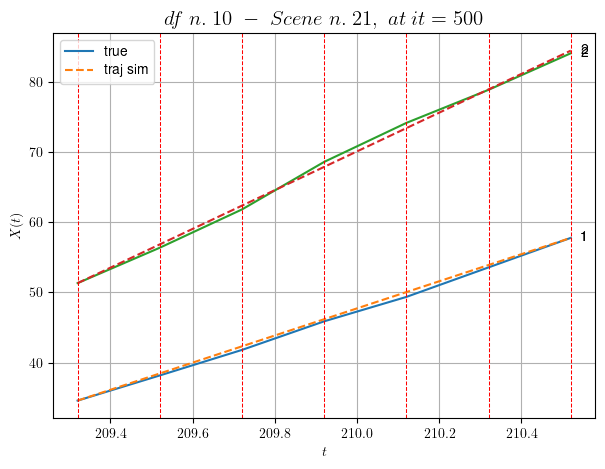

----------------------------------------------------------------------------------------------------
        For scene 3/7:
        * After LR finder: LR_NN=0.0005 with mse=1.8300542438336302 at it=24
        * v0 = 27.594562747146874
        * MSE = 0.19547993909442693
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.4/7
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [237.72,238.12]


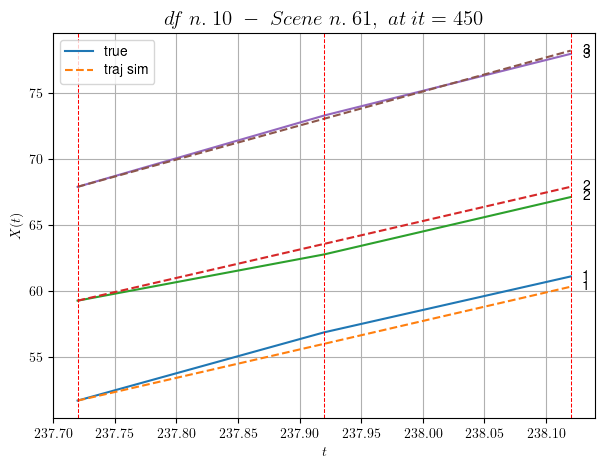

----------------------------------------------------------------------------------------------------
        For scene 4/7:
        * After LR finder: LR_NN=0.01 with mse=0.7347353007032108 at it=24
        * v0 = 25.83259327322175
        * MSE = 0.3032960308231982
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.5/7
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [202.52,203.12]


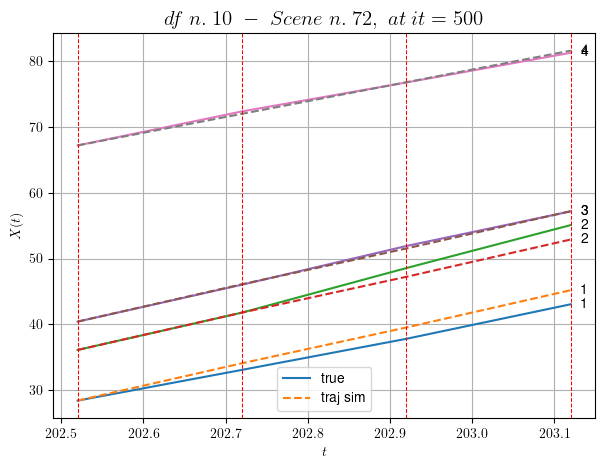

----------------------------------------------------------------------------------------------------
        For scene 5/7:
        * After LR finder: LR_NN=0.01 with mse=2.3316048799678377 at it=24
        * v0 = 24.01414470414979
        * MSE = 0.970406750624518
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.6/7
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [118.92,119.32]


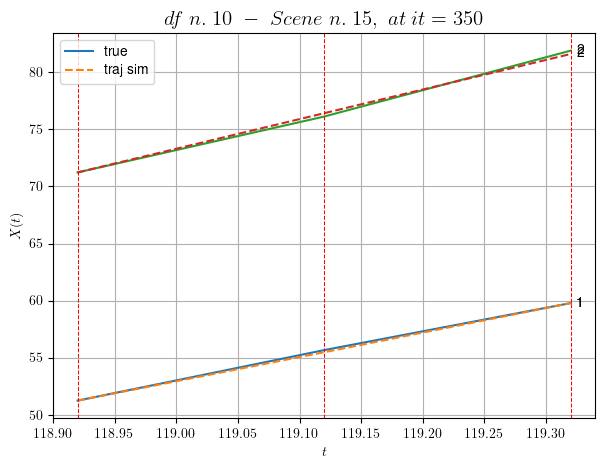

----------------------------------------------------------------------------------------------------
        For scene 6/7:
        * After LR finder: LR_NN=0.005 with mse=0.4974924216656269 at it=24
        * v0 = 25.969534482224386
        * MSE = 0.03206310378119643
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.7/7
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [578.92,580.52]


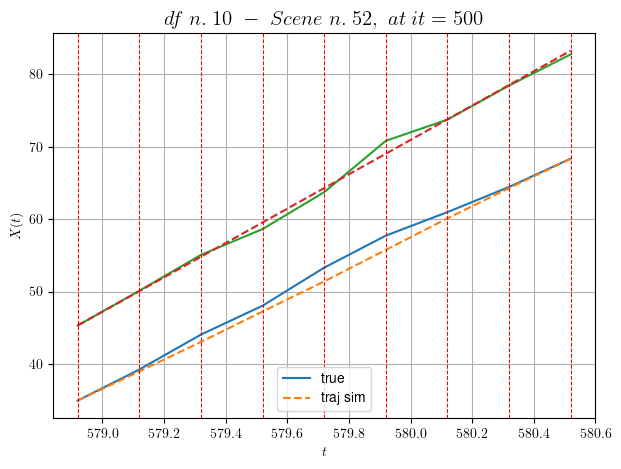

----------------------------------------------------------------------------------------------------
        For scene 7/7:
        * After LR finder: LR_NN=0.01 with mse=18.439958794708662 at it=24
        * v0 = 23.728017954300714
        * MSE = 0.6426701298885185
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.5076646784377113
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (67 scenes)
DataFrame n.10. Scene n.1/67


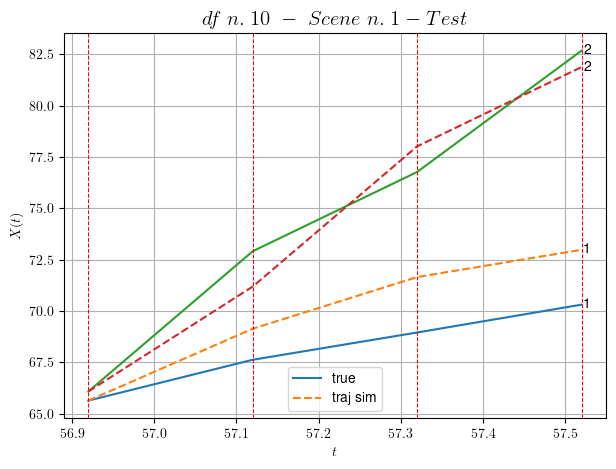

        For scene 1/67:
        * MSE = 2.737045798172927
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.2/67


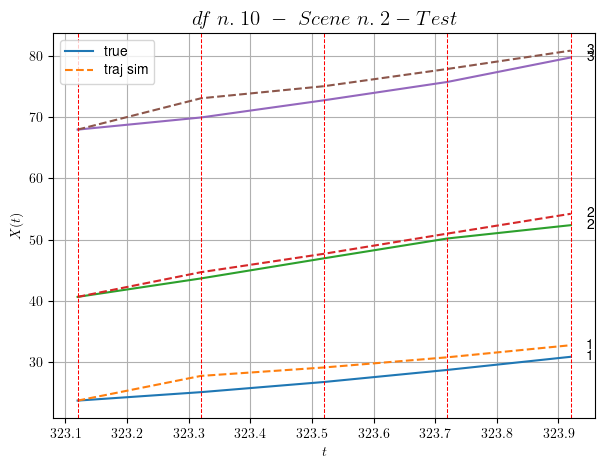

        For scene 2/67:
        * MSE = 3.1283661517722137
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.3/67


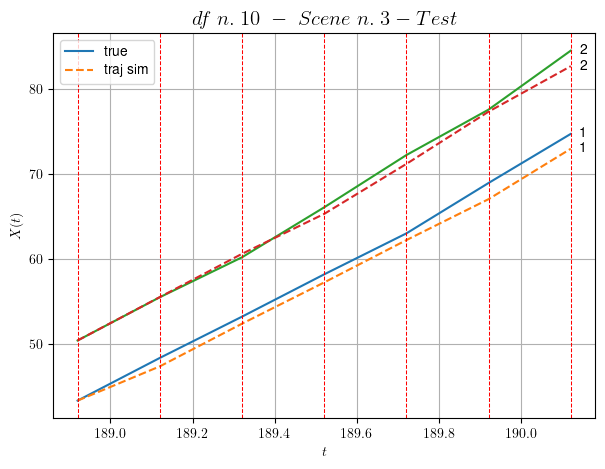

        For scene 3/67:
        * MSE = 1.0822485943822309
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.4/67


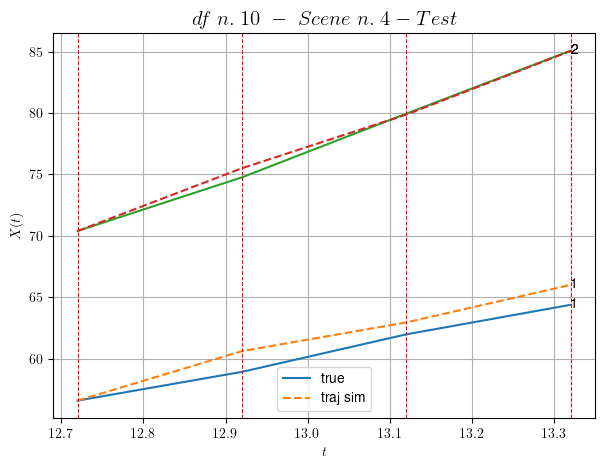

        For scene 4/67:
        * MSE = 0.873295713510849
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.5/67


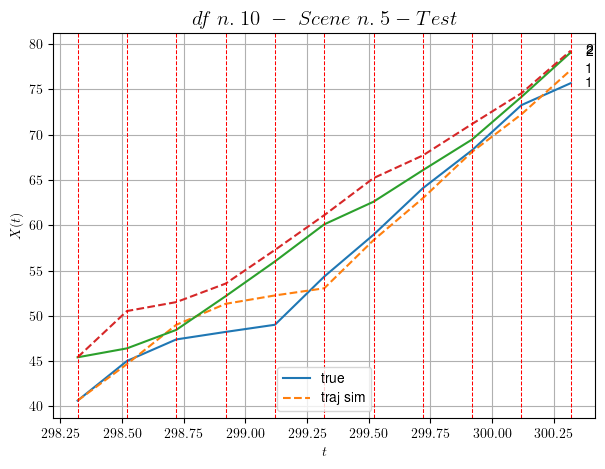

        For scene 5/67:
        * MSE = 3.3091965473599316
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.6/67


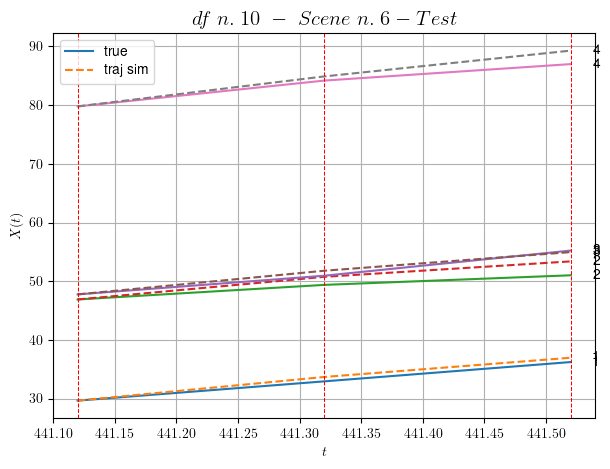

        For scene 6/67:
        * MSE = 1.266167129680229
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.7/67


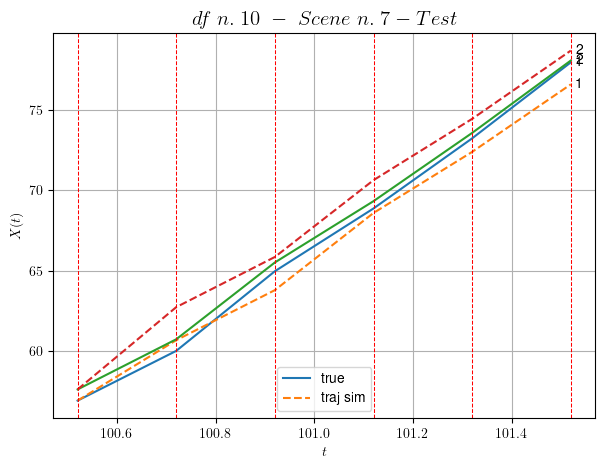

        For scene 7/67:
        * MSE = 0.9501311987141438
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.8/67


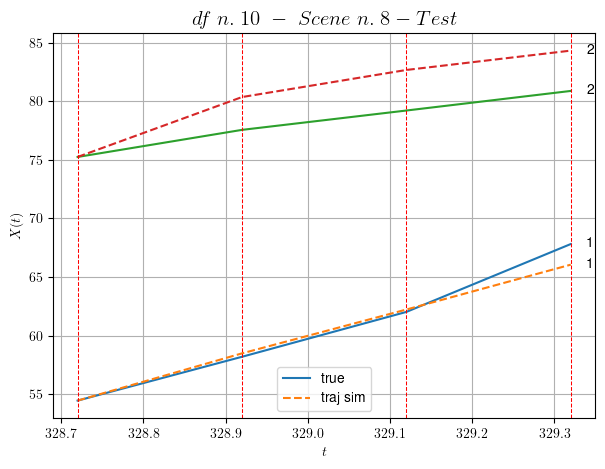

        For scene 8/67:
        * MSE = 4.3550762753618795
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.9/67


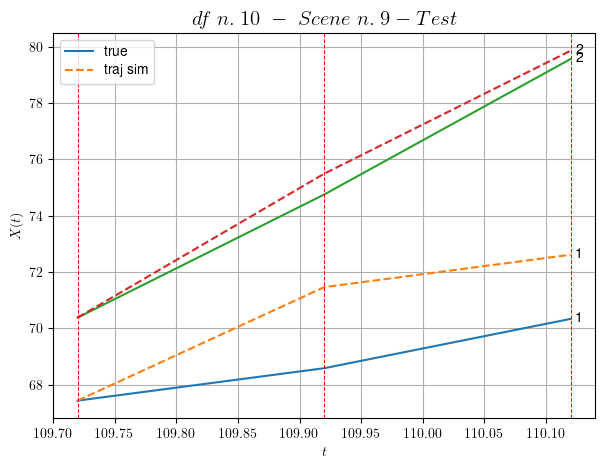

        For scene 9/67:
        * MSE = 2.3503666222635093
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.10/67


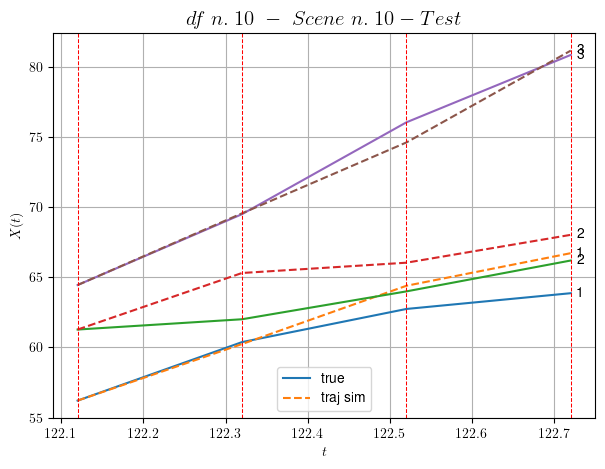

        For scene 10/67:
        * MSE = 2.617932263384148
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.11/67


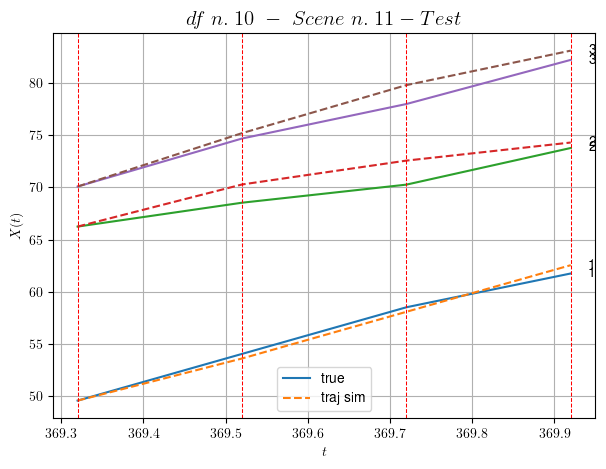

        For scene 11/67:
        * MSE = 1.160668258032241
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.12/67


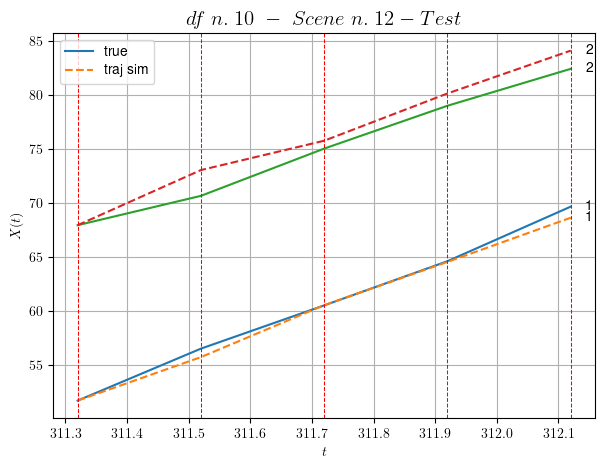

        For scene 12/67:
        * MSE = 1.2067551683440811
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.13/67


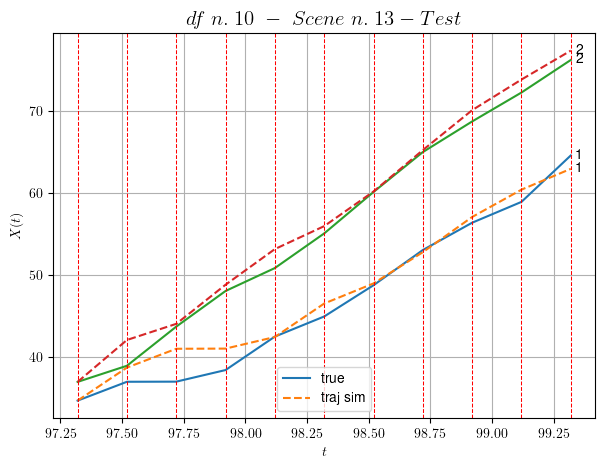

        For scene 13/67:
        * MSE = 2.560886775413948
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.14/67


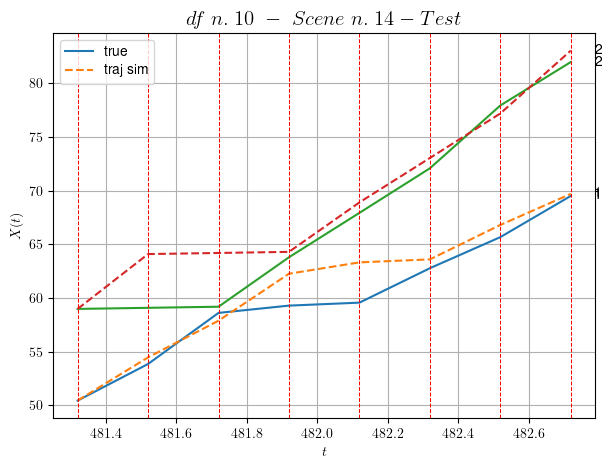

        For scene 14/67:
        * MSE = 4.984014679436445
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.15/67


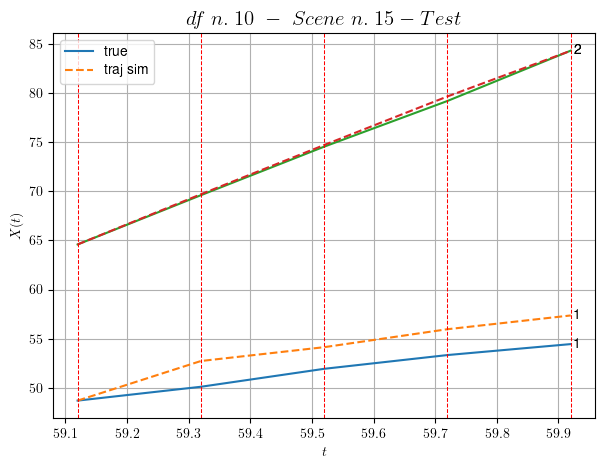

        For scene 15/67:
        * MSE = 2.736397767072696
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.16/67


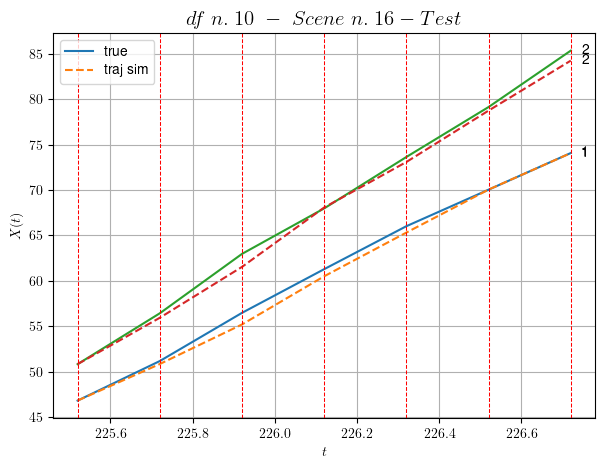

        For scene 16/67:
        * MSE = 0.48693885780976104
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.17/67


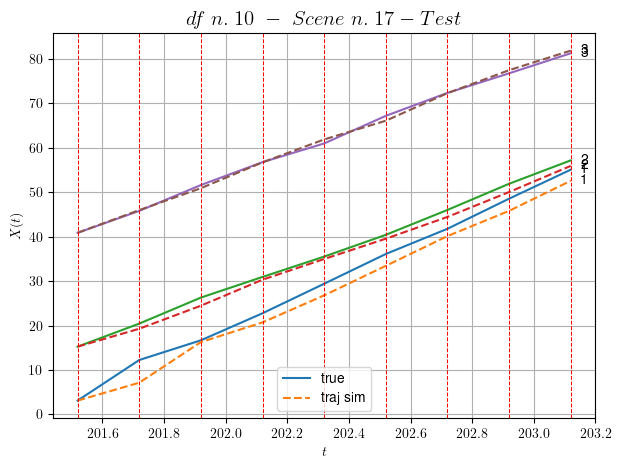

        For scene 17/67:
        * MSE = 2.8820221095095246
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.18/67


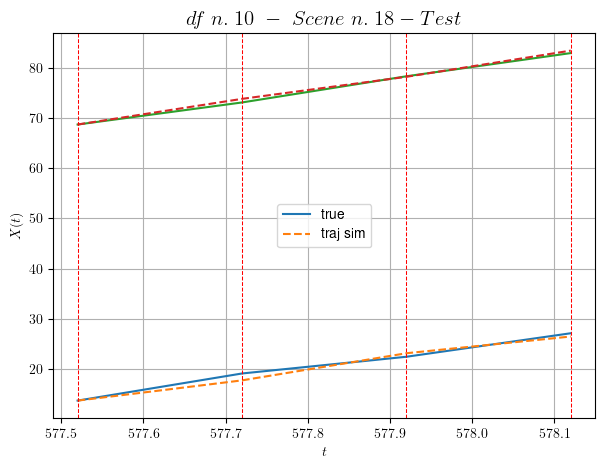

        For scene 18/67:
        * MSE = 0.4448236474683555
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.19/67


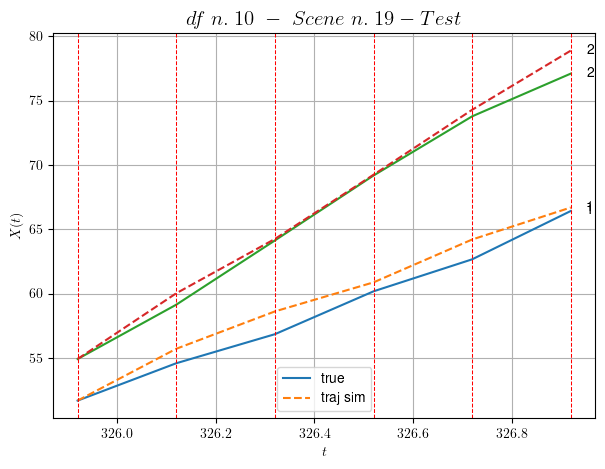

        For scene 19/67:
        * MSE = 0.9655912819994501
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.20/67


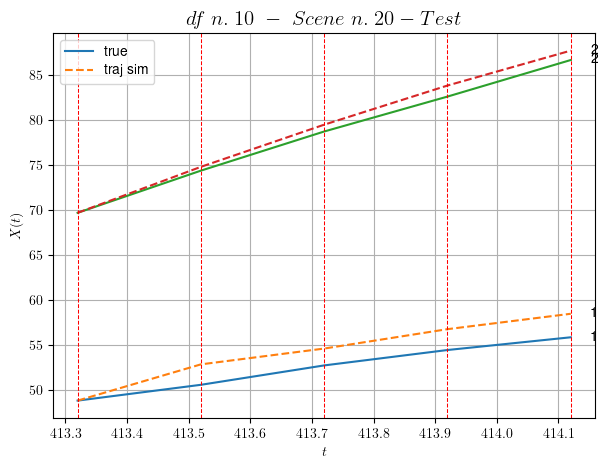

        For scene 20/67:
        * MSE = 2.4231162011278684
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.21/67


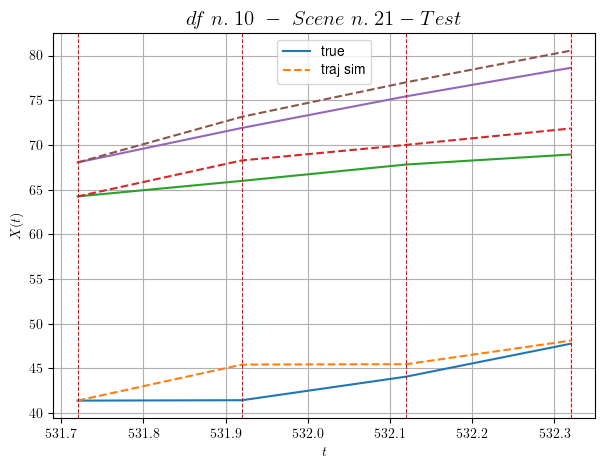

        For scene 21/67:
        * MSE = 3.682463063064024
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.22/67


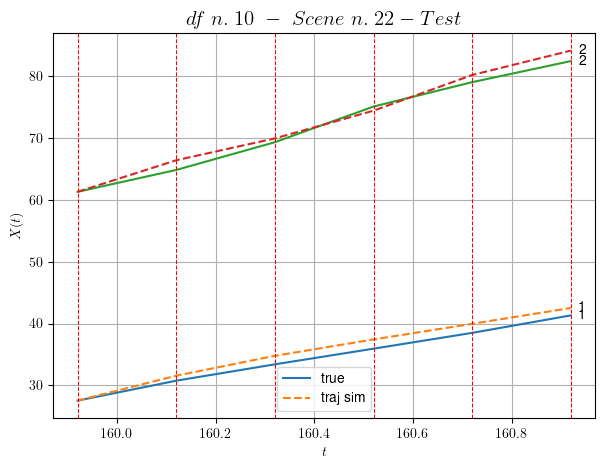

        For scene 22/67:
        * MSE = 1.3243984563074287
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.23/67


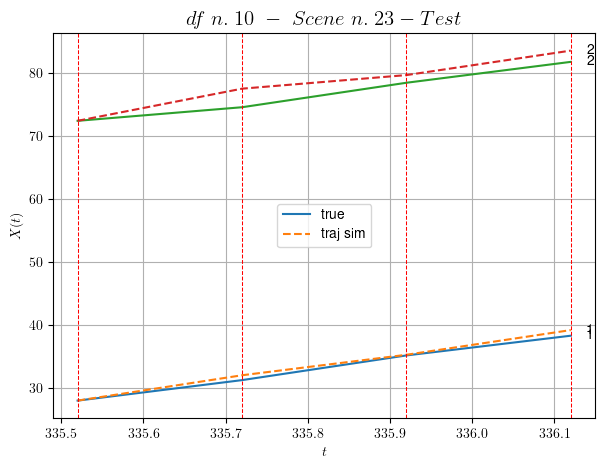

        For scene 23/67:
        * MSE = 1.847941197911911
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.24/67


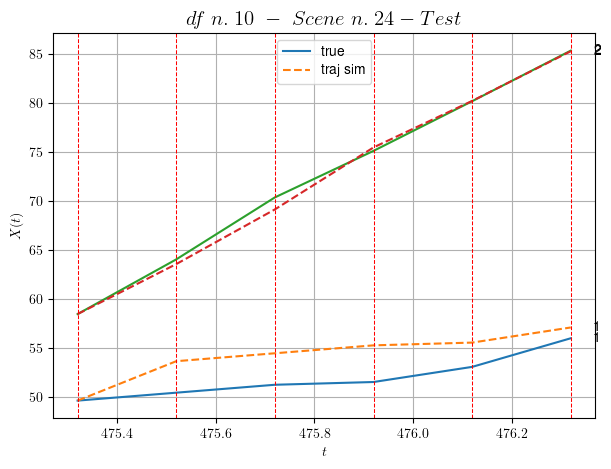

        For scene 24/67:
        * MSE = 3.6678031710267183
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.25/67


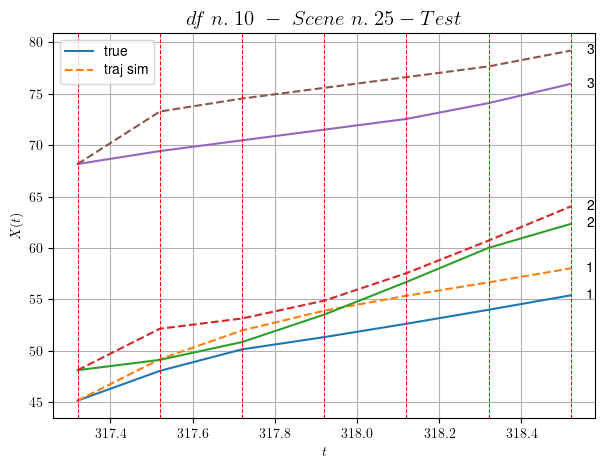

        For scene 25/67:
        * MSE = 6.701858829322986
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.26/67


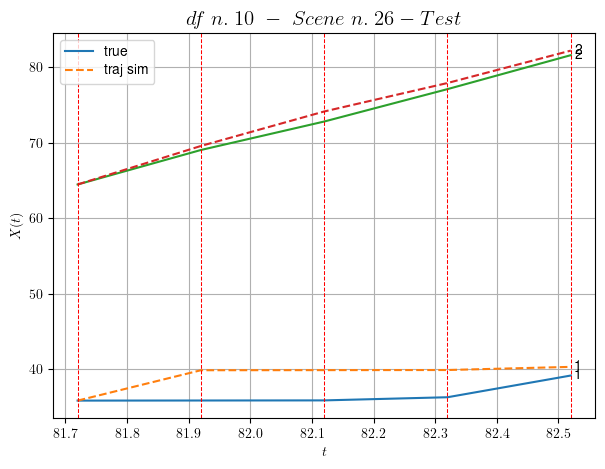

        For scene 26/67:
        * MSE = 4.9673243606522295
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.27/67


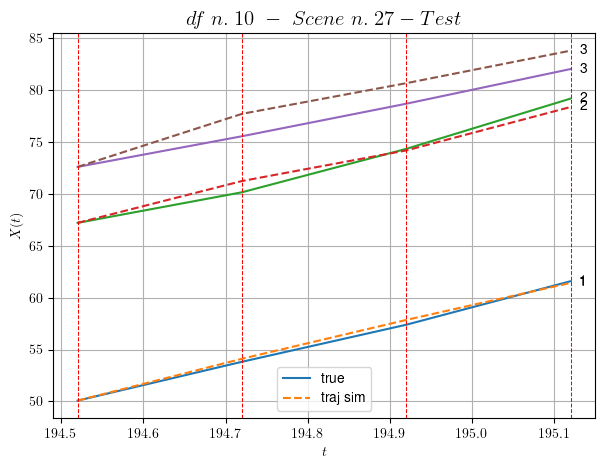

        For scene 27/67:
        * MSE = 1.155184491737456
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.28/67


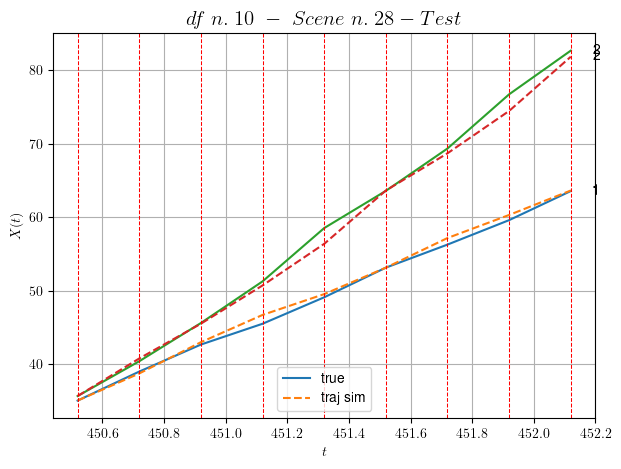

        For scene 28/67:
        * MSE = 0.7980011301199899
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.29/67


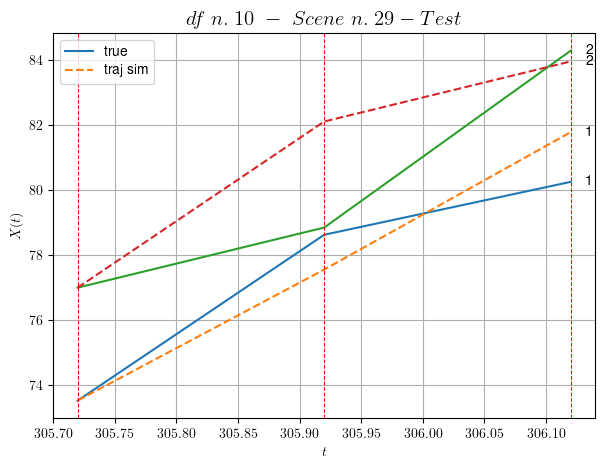

        For scene 29/67:
        * MSE = 2.3712523623167163
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.30/67


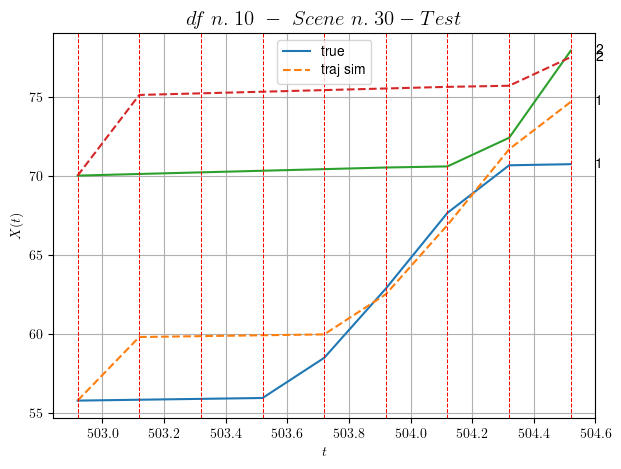

        For scene 30/67:
        * MSE = 12.702365679206002
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.31/67


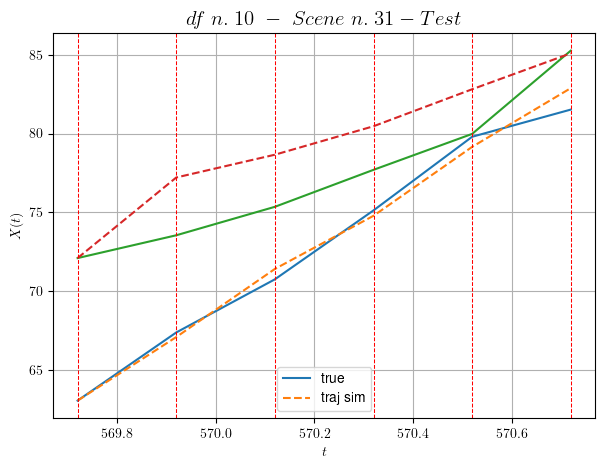

        For scene 31/67:
        * MSE = 3.576030363684646
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.32/67


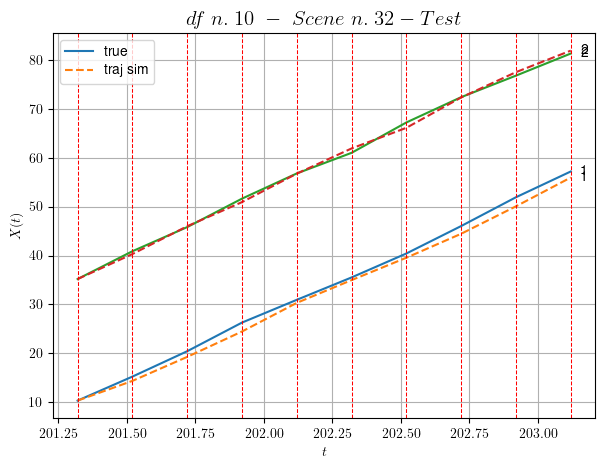

        For scene 32/67:
        * MSE = 0.9020478744098772
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.33/67


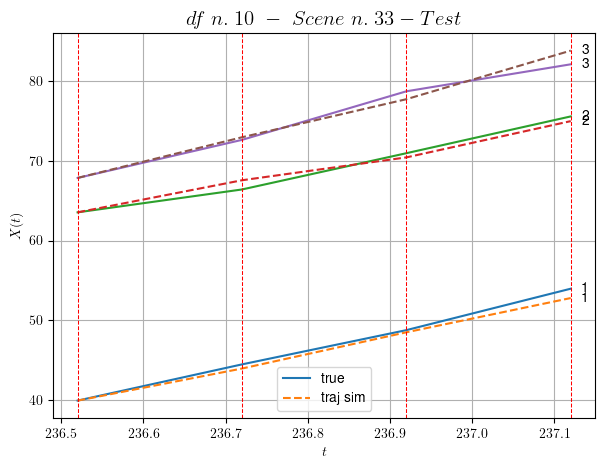

        For scene 33/67:
        * MSE = 0.6446790715218368
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.34/67


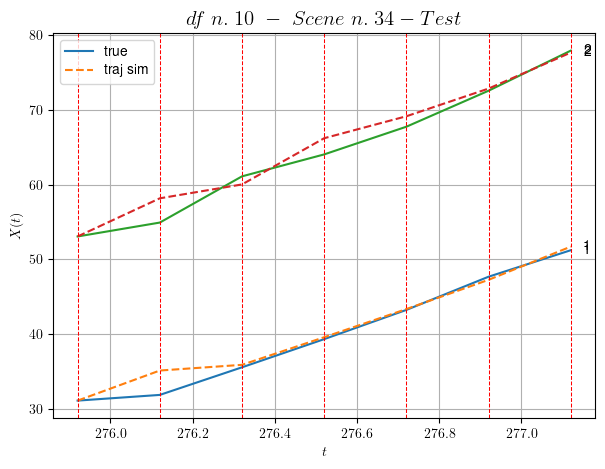

        For scene 34/67:
        * MSE = 2.1281276768829542
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.35/67


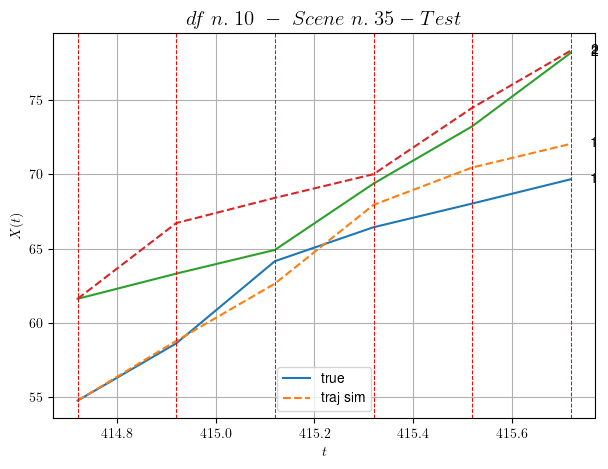

        For scene 35/67:
        * MSE = 3.5115941943481013
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.36/67


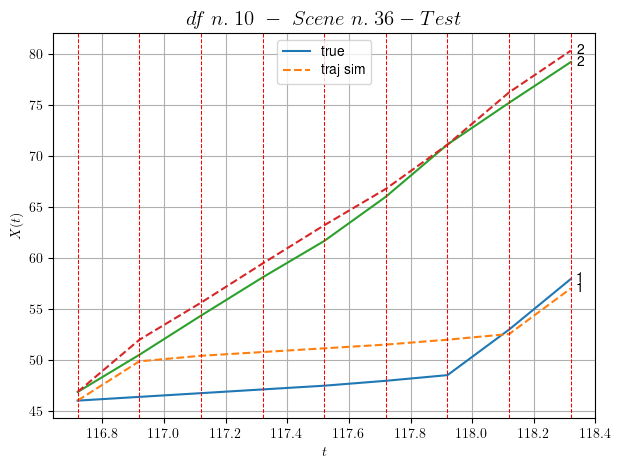

        For scene 36/67:
        * MSE = 4.943399519857085
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.37/67


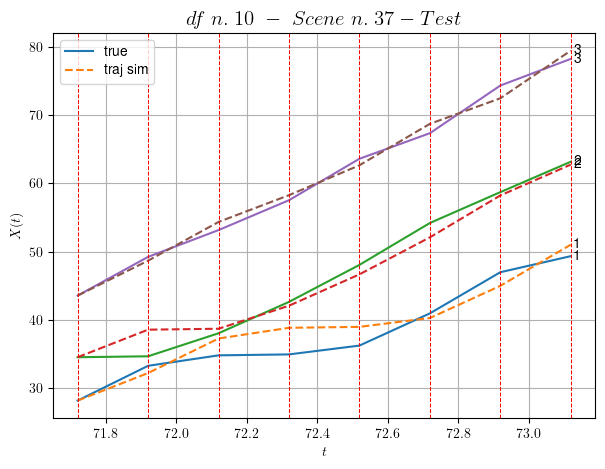

        For scene 37/67:
        * MSE = 2.9025080334544584
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.38/67


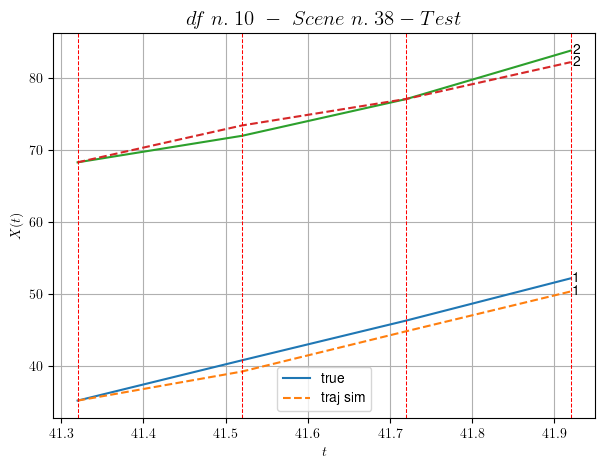

        For scene 38/67:
        * MSE = 1.5660265084547897
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.39/67


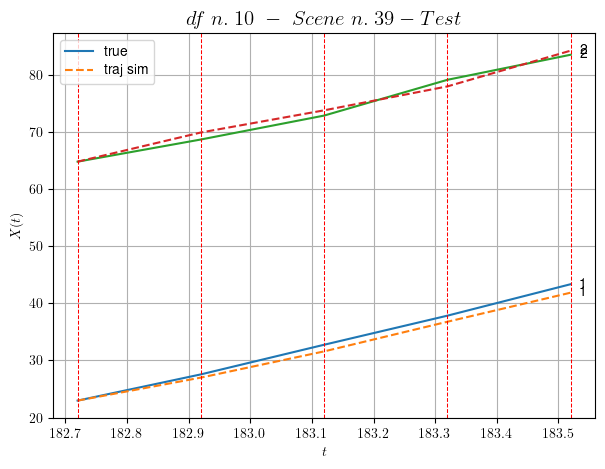

        For scene 39/67:
        * MSE = 0.9185000185836295
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.40/67


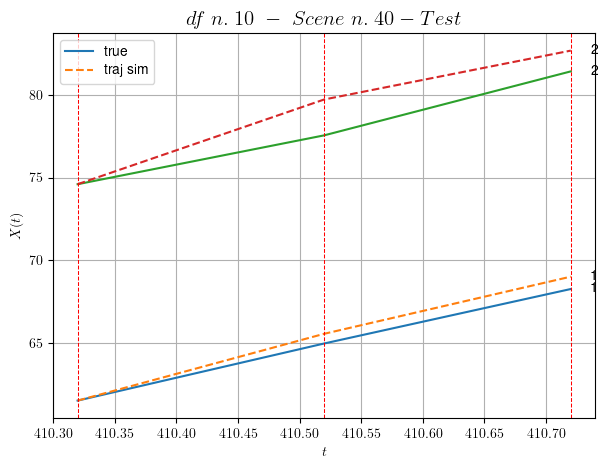

        For scene 40/67:
        * MSE = 1.1902755781019403
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.41/67


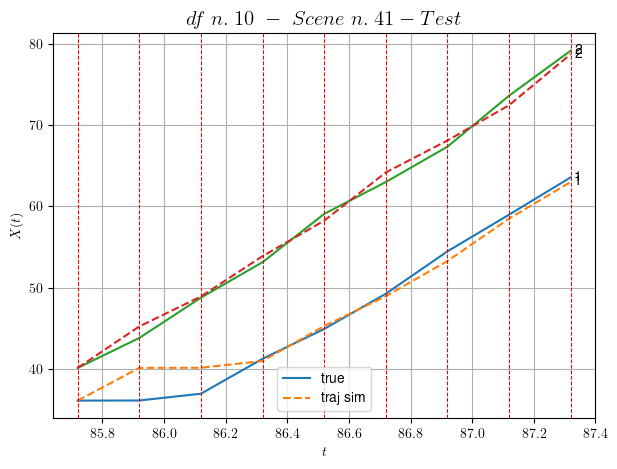

        For scene 41/67:
        * MSE = 1.9668872075601662
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.42/67


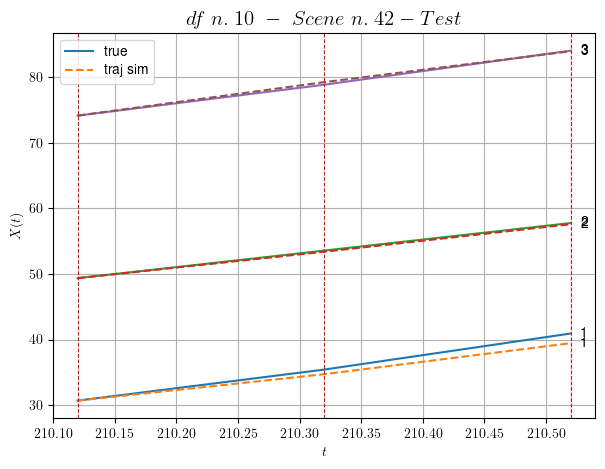

        For scene 42/67:
        * MSE = 0.3223664340967832
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.43/67


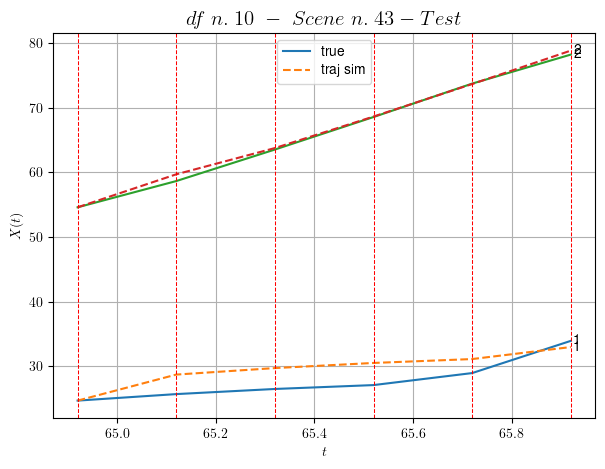

        For scene 43/67:
        * MSE = 3.207581149752069
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.44/67


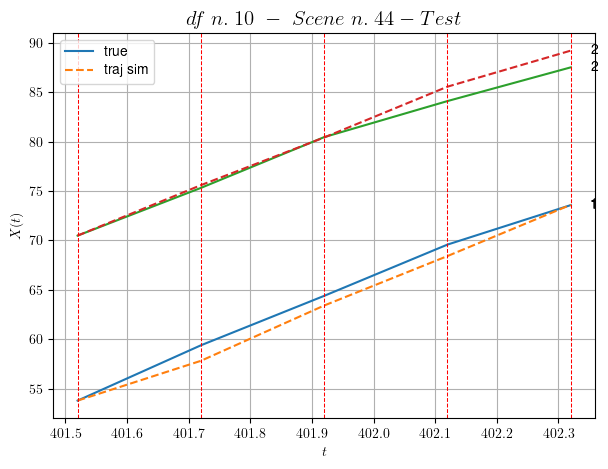

        For scene 44/67:
        * MSE = 0.9854862560802459
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.45/67


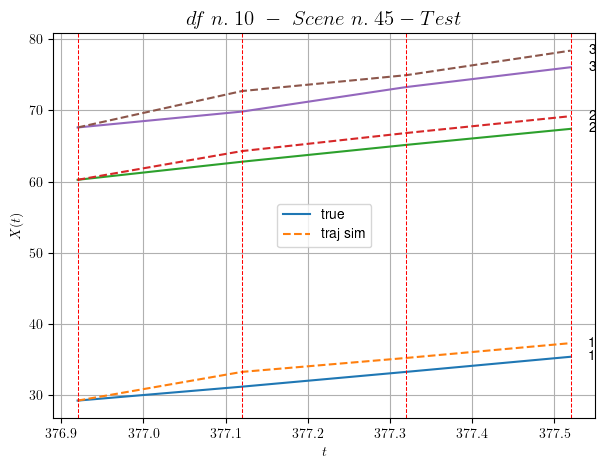

        For scene 45/67:
        * MSE = 3.0343446141545485
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.46/67


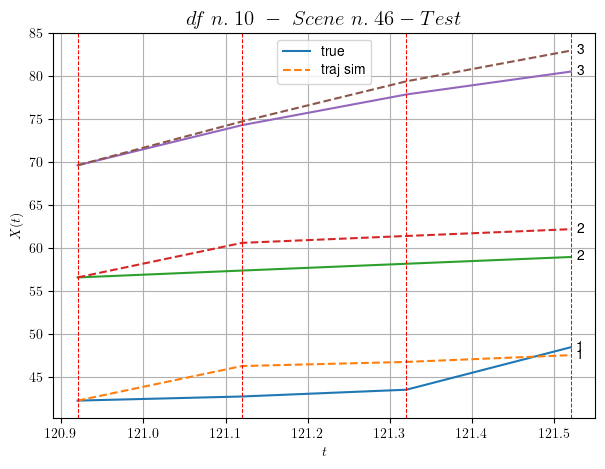

        For scene 46/67:
        * MSE = 5.320563111507064
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.47/67


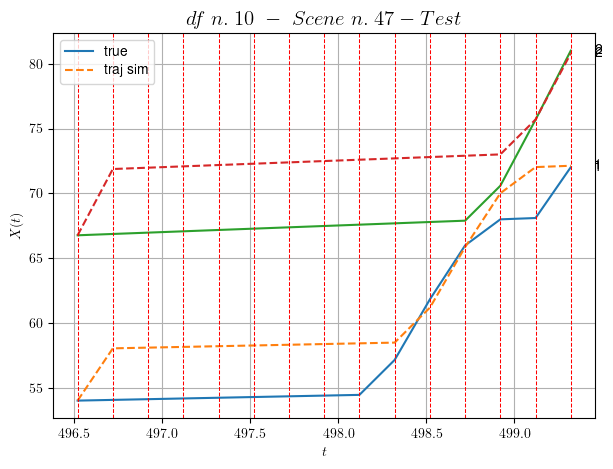

        For scene 47/67:
        * MSE = 14.320076555464794
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.48/67


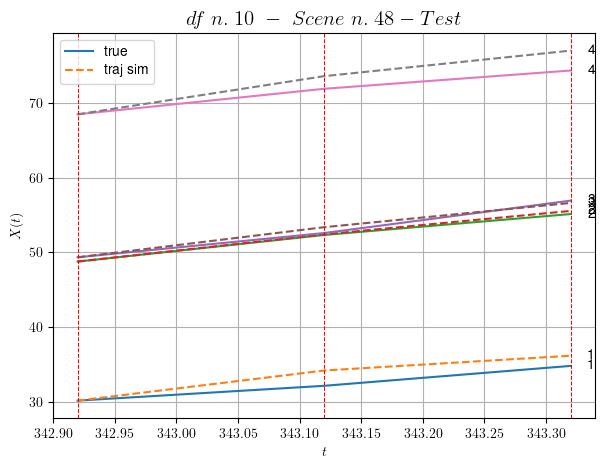

        For scene 48/67:
        * MSE = 1.4073082199114948
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.49/67


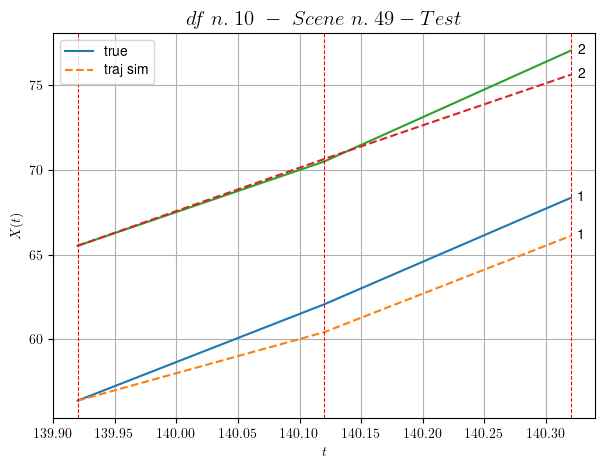

        For scene 49/67:
        * MSE = 1.6234041149436904
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.50/67


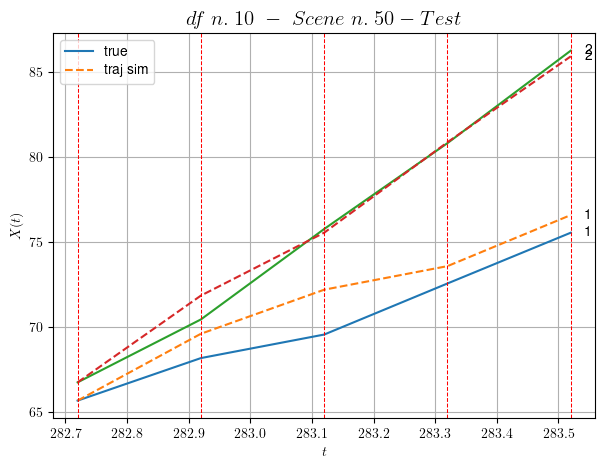

        For scene 50/67:
        * MSE = 1.3280081371076535
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.51/67


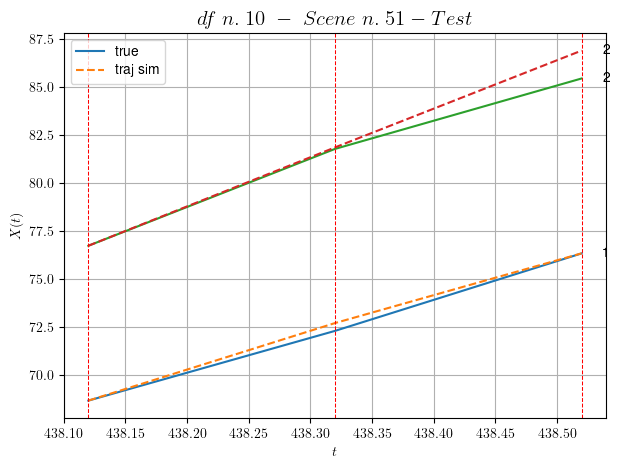

        For scene 51/67:
        * MSE = 0.37821580703181196
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.52/67


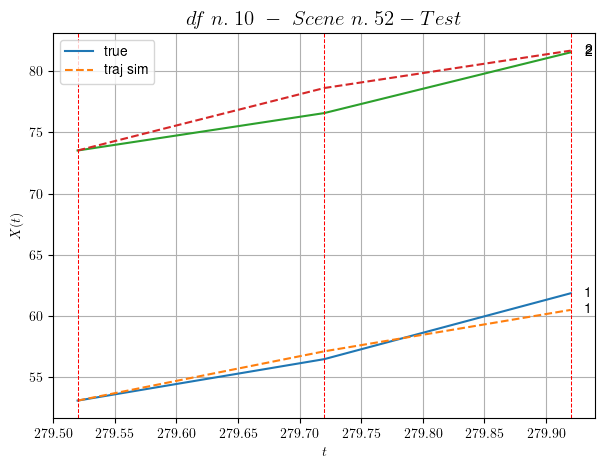

        For scene 52/67:
        * MSE = 1.0795095114794295
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.53/67


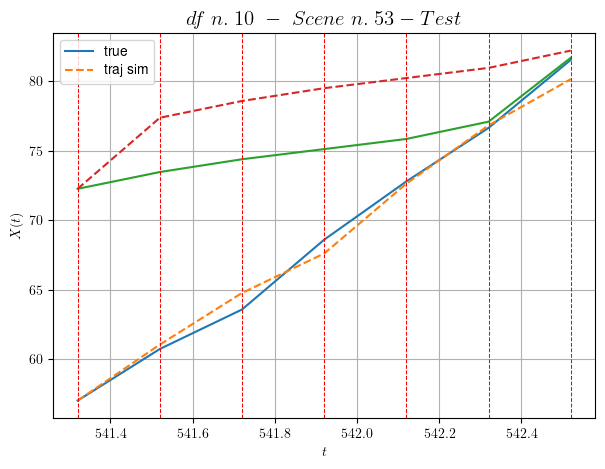

        For scene 53/67:
        * MSE = 6.487806377713342
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.54/67


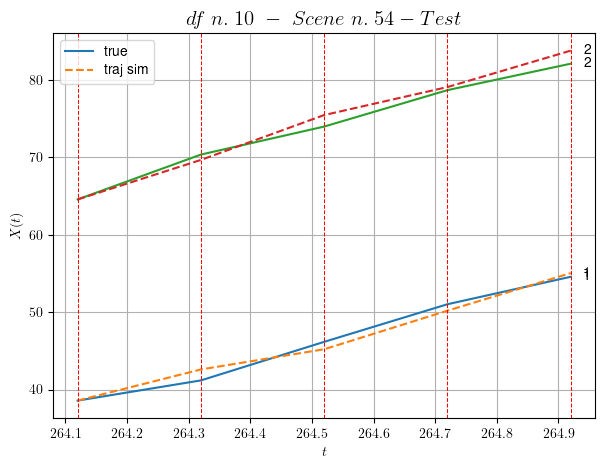

        For scene 54/67:
        * MSE = 0.9550470898993066
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.55/67


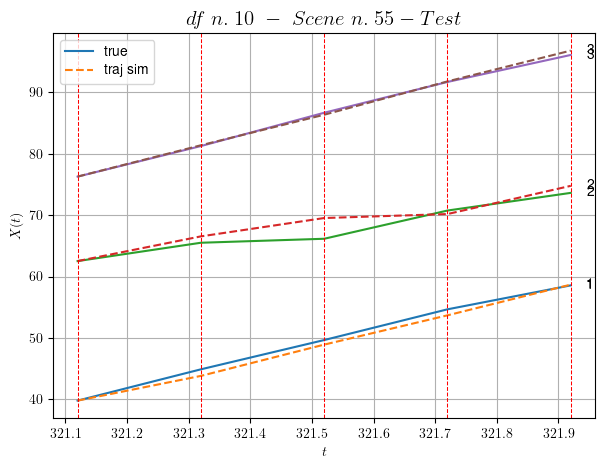

        For scene 55/67:
        * MSE = 1.1632543366004917
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.56/67


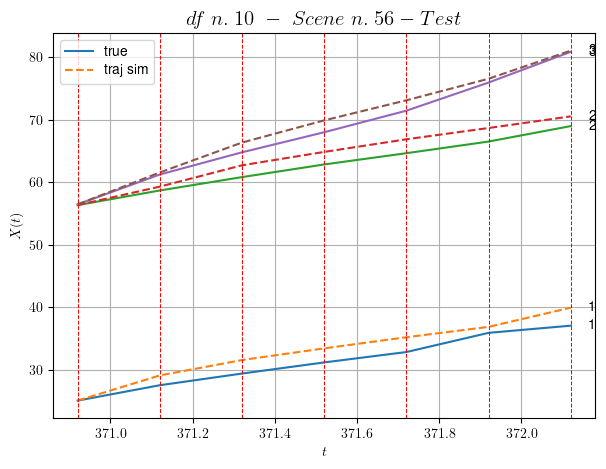

        For scene 56/67:
        * MSE = 2.6824204538542786
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.57/67


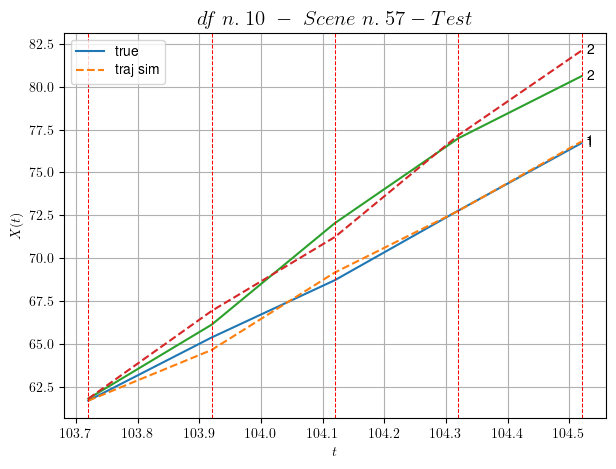

        For scene 57/67:
        * MSE = 0.4277477565092006
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.58/67


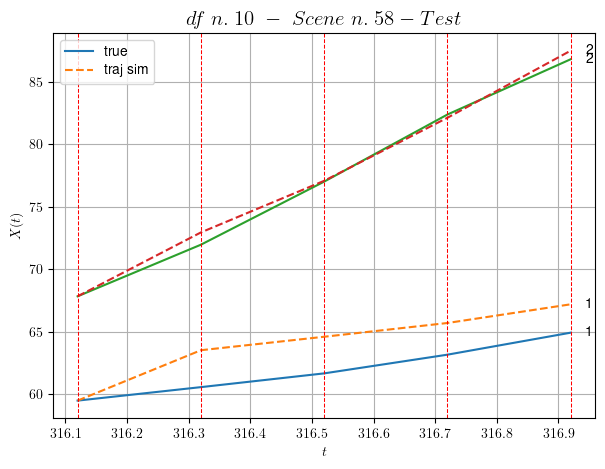

        For scene 58/67:
        * MSE = 3.035235792469373
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.59/67


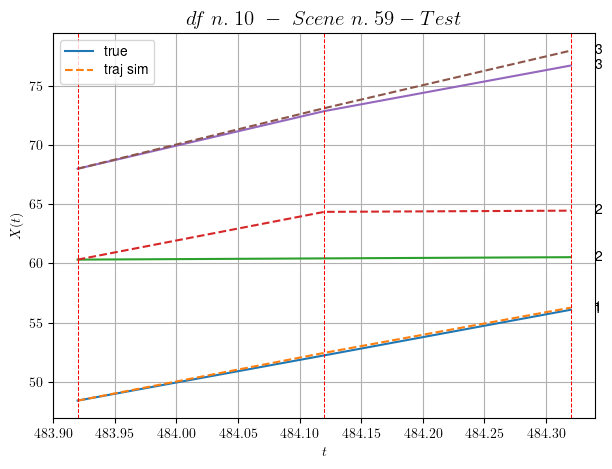

        For scene 59/67:
        * MSE = 3.617506264505106
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.60/67


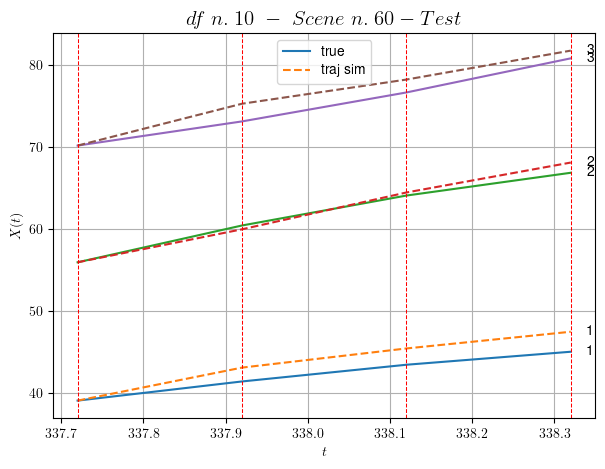

        For scene 60/67:
        * MSE = 1.892585574629991
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.61/67


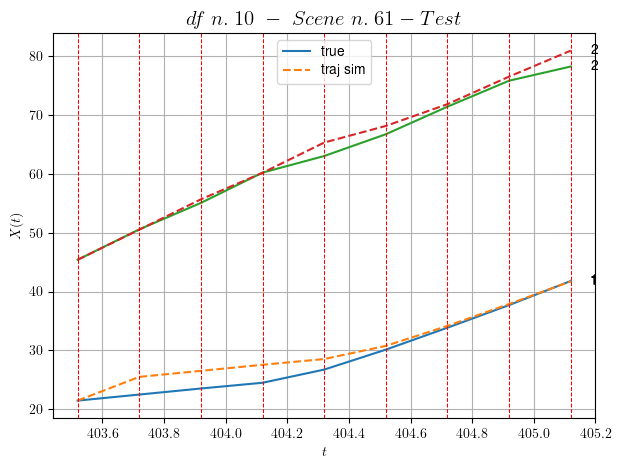

        For scene 61/67:
        * MSE = 2.5911136133253145
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.62/67


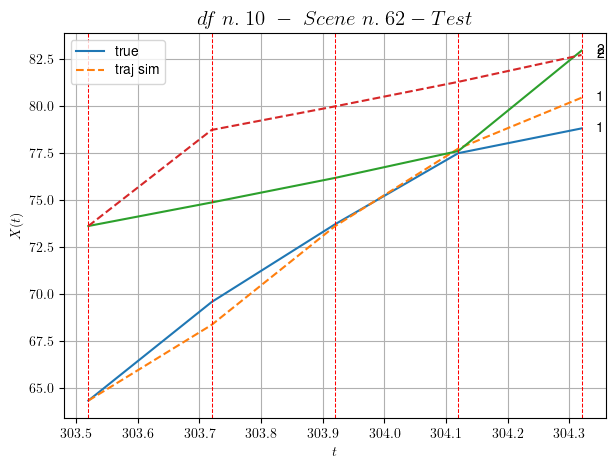

        For scene 62/67:
        * MSE = 4.714908195298405
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.63/67


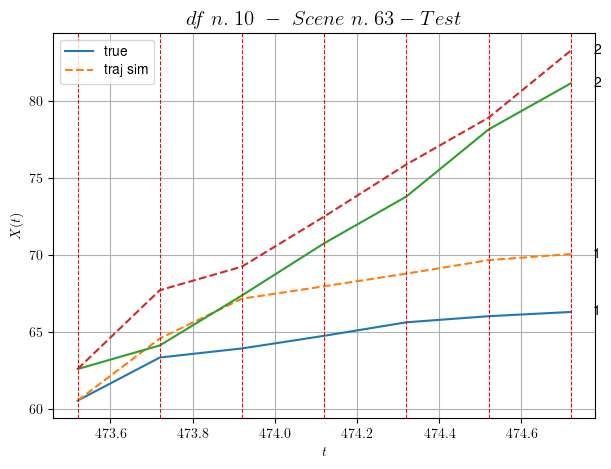

        For scene 63/67:
        * MSE = 6.296014416135774
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.64/67


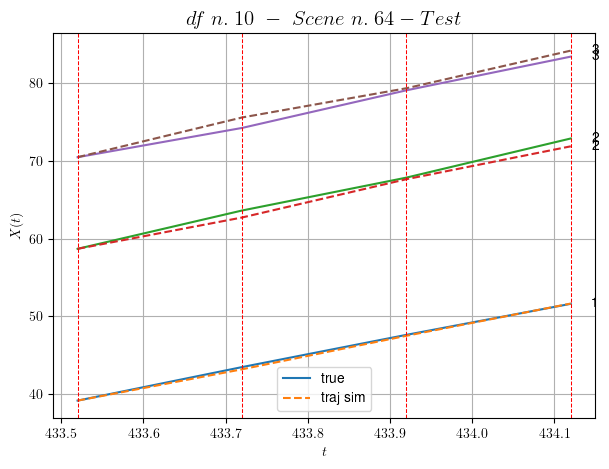

        For scene 64/67:
        * MSE = 0.3701064023084699
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.65/67


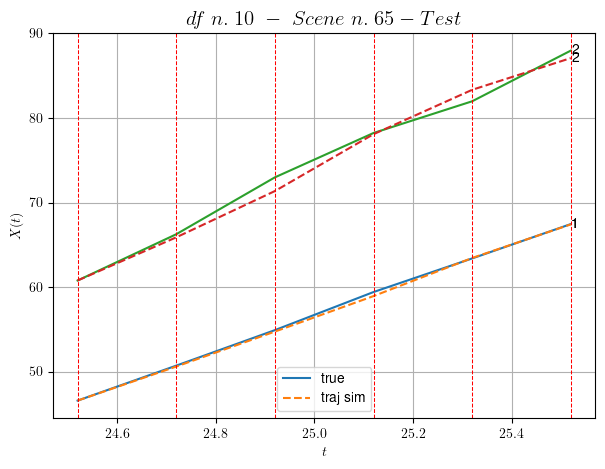

        For scene 65/67:
        * MSE = 0.47361768591230663
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.66/67


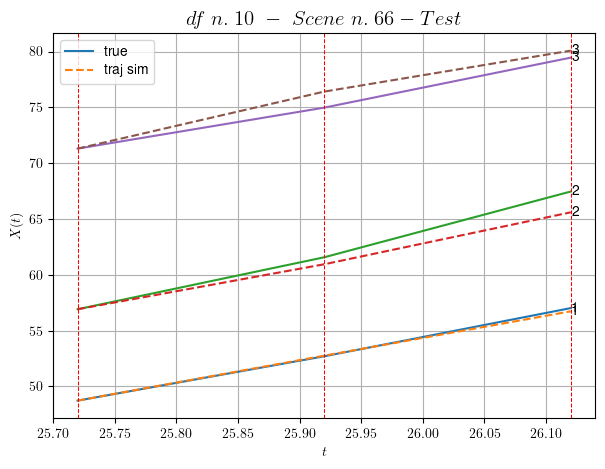

        For scene 66/67:
        * MSE = 0.7121287069900905
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.67/67


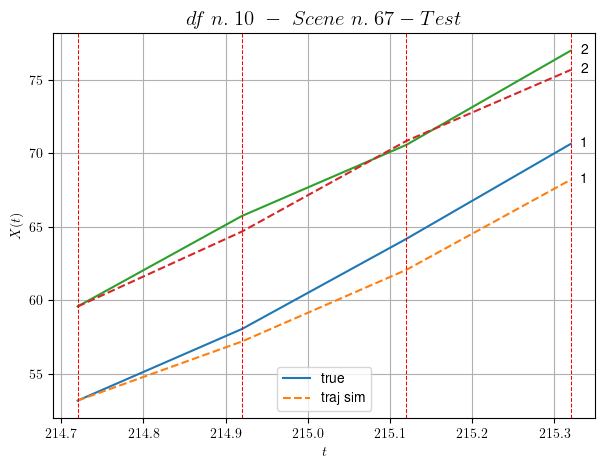

        For scene 67/67:
        * MSE = 1.7580193571924148
----------------------------------------------------------------------------------------------------


MSE test: 2.629463966630072

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.5076646784377113
          * MSE test: 2.629463966630072
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -






In [6]:
info_nn, model_trained = solve_nn_dataset(dataset, DOE, v0, processed_flag, NUM_ITER, LEARNING_RATE_v0,
                                           test, plot_flag)

In [27]:
get_stats(model_trained)


-------------------- Model Summary --------------------
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Hidden-Layer-1 (Dense)      (None, 2)                 4         
                                                                 
 Hidden-Layer-2 (Dense)      (None, 2)                 6         
                                                                 
 Output-Layer (Dense)        (None, 1)                 2         
                                                                 
Total params: 12 (48.00 Byte)
Trainable params: 12 (48.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________

-------------------- Weights and Biases --------------------
Layer:  Hidden-Layer-1
  --Kernels (Weights): 
[[-112.06341     -3.1353831]]
  --Biases: 
[-8.343152   1.0387237]

Layer:  Hidden-Layer-2
  --Kernels (Weights): 
[[-8.

## Plot

### Leading velocity $v_{0}$

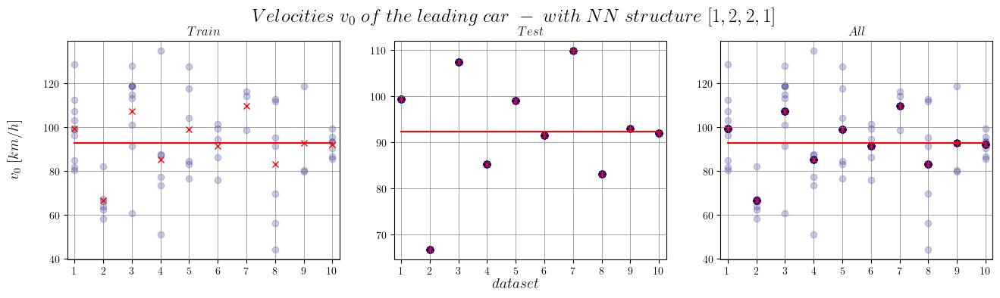

In [7]:
# Initialize the fig
nrow, ncol = 1, 3
width, height = 7, 5 # single subplot
fig, axes = plt.subplots(nrow,ncol,figsize=(width*ncol*.75,height*.75))

ms2kmh = 3.6

info_train = info_nn[info_nn["type"] == "train"]
info_test = info_nn[info_nn["type"] == "test"]
info_grouped = info_nn.groupby(['N. file', 'type']).mean(numeric_only=True)
info_grouped2 = info_nn.groupby(['N. file']).mean(numeric_only=True)
info_avg = info_nn.groupby(['type']).mean(numeric_only=True)

# For each scene, plot v0 mean
for _, scn in info_train.iterrows():
    axes[0].scatter(scn['N. file'], scn['v0']*ms2kmh, alpha = .2, color = 'darkblue');
    
for _, scn in info_test.iterrows():
    axes[1].scatter(scn['N. file'], scn['v0']*ms2kmh, alpha = .2, color = 'darkblue');

# Avg value
for (nf,typef), infof in info_grouped.iterrows():
    
    if typef == "train":
        axes[0].plot(nf, infof['v0']*ms2kmh, color = 'r', marker="x")
        
    if typef == "test":
        axes[1].plot(nf, infof['v0']*ms2kmh, color = 'r', marker="x")

# For each scene, plot v0 mean
for _, scn in info_nn.iterrows():
    axes[2].scatter(scn['N. file'], scn['v0']*ms2kmh, alpha = .2, color = 'darkblue');

# For a dataset, plot v0 mean (averaging v0 mean in all the scenes)
for nf, p in info_grouped2.iterrows():
    axes[2].plot(nf, p['v0']*ms2kmh, color = 'r', marker="x")

# Plot v0 mean over all dfs
alldfs = [a for a, _ in info_nn.groupby('N. file')]
v0_mean = np.mean([ infof['v0']*ms2kmh for _, infof in info_grouped.iterrows()])
axes[0].plot(alldfs, [info_avg['v0']['train']*ms2kmh]*len(alldfs), color = 'r')  
axes[1].plot(alldfs, [info_avg['v0']['test']*ms2kmh]*len(alldfs), color = 'r')  
axes[2].plot(alldfs, [v0_mean]*len(alldfs), color = 'r')  

# labeling     
axes[0].set_title(fr"$Train$",fontsize=12)
axes[1].set_title(fr"$Test$",fontsize=12)
axes[2].set_title(fr"$All$",fontsize=12)
fig.supxlabel(r"$data set$",fontsize=14, y=0.0005)
fig.supylabel(r"$v_{0}\ [km/h]$",fontsize=14, x = 0.075)
plt.suptitle(fr"$Velocities\ v_{0}\ of\ the\ leading\ car\ -\ with\ NN\ structure\ {str(DOE)}$",
             fontsize=18, y=1)

# Setting the values for all axes.
custom_xlim = (0.75,10.25)
custom_xticks = range(1,11)
plt.setp(axes, xlim=custom_xlim, xticks=custom_xticks)

axes[0].grid(color='grey', linestyle='-', linewidth=0.5);
axes[1].grid(color='grey', linestyle='-', linewidth=0.5);
axes[2].grid(color='grey', linestyle='-', linewidth=0.5);

plt.show()

### Test 1: `cons_dis` vs `velocities`

In [8]:
Nx = 10
Nt = 100
T = 0.5

In [9]:
# Intial positions and consecutive distances
## Space
rng = np.random.default_rng(12345)
a = rng.uniform(-1, 0, int(Nx/3)+1)
b = rng.uniform(0, 1, 2*int(Nx/3))

my_rnd = np.concatenate([a, b])

# Check if sorted
if all(my_rnd[i] <= my_rnd[i+1] for i in range(len(my_rnd) - 1)):
    print("All the vehicles are sorted")
    X = m_rnd
else:
    print("There's at least a vehicle not sorted")
    X = my_rnd.copy()
    X.sort()
    
cons_dis = np.diff(X, axis=0)  # Consecutive distances of vehicles in this scene

##Time
tspan = np.linspace(0,T,Nt)

There's at least a vehicle not sorted


In [10]:
## Compute the velocities
y_pred = model_trained(cons_dis, training=False)
v0 = y_pred.numpy().mean() # Approximate the velocity of the leading car ?
vel_nn = y_pred.numpy().flatten().tolist() + [v0]

# check
if all(i >= v0 for i in y_pred):
    print("There is at least a vehicle faster than the leading car")   

In [13]:
y_pred

<tf.Tensor: shape=(9, 1), dtype=float32, numpy=
array([[14.50452 ],
       [16.915512],
       [14.827699],
       [17.13109 ],
       [15.075405],
       [14.177959],
       [15.654474],
       [14.348511],
       [16.1988  ]], dtype=float32)>

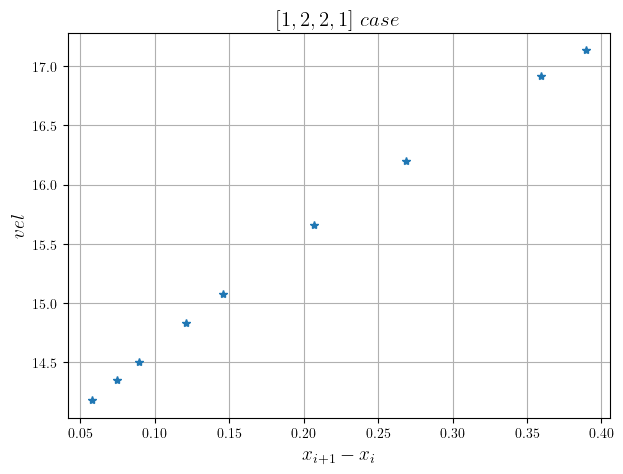

In [11]:
# Create a figure and axis for the plot
width, height = 7, 5
fig, ax = plt.subplots(1,1,figsize=(width, height))

# Plot
ax.plot(cons_dis,vel_nn[:-1], marker="*", linestyle='None') # there's no car in front of the leading one

ax.set_xlabel("$x_{i+1} - x_{i}$", fontsize=14)
ax.set_ylabel("$vel$", fontsize=14)
ax.set_title(fr"${str(DOE)}\ case$", fontsize=15)
ax.grid()
    
plt.show()

### Test 2: `cons_dis` vs `velocities`

In [18]:
Nx = 100
Nt = 100
T = 0.5

In [19]:
# Intial positions and consecutive distances
## Space
rng = np.random.default_rng(12345)
a = rng.uniform(-1, 0, int(Nx/3)+1)
b = rng.uniform(0, 1, 2*int(Nx/3))

my_rnd = np.concatenate([a, b])

# Check if sorted
if all(my_rnd[i] <= my_rnd[i+1] for i in range(len(my_rnd) - 1)):
    print("All the vehicles are sorted")
    X = m_rnd
else:
    print("There's at least a vehicle not sorted")
    X = my_rnd.copy()
    X.sort()
    
cons_dis = np.diff(X, axis=0)  # Consecutive distances of vehicles in this scene

##Time
tspan = np.linspace(0,T,Nt)

There's at least a vehicle not sorted


In [22]:
## Compute the velocities
y_pred = model_trained(cons_dis, training=False)
v0 = y_pred.numpy().mean() # Approximate the velocity of the leading car ?
vel_nn = y_pred.numpy().flatten().tolist() + [v0]

# check
if all(i >= v0 for i in y_pred):
    print("There is at least a vehicle faster than the leading car")   

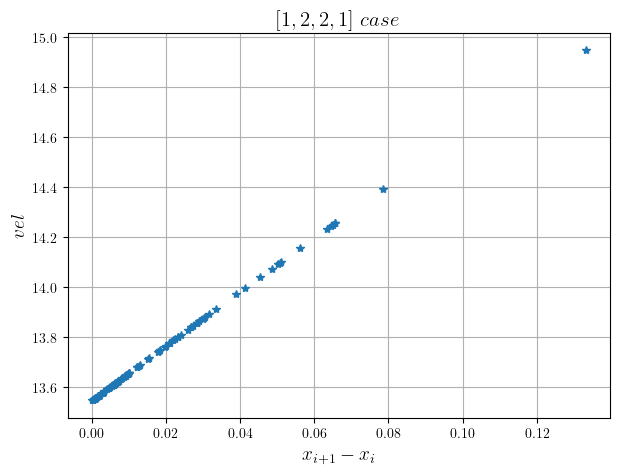

In [23]:
# Create a figure and axis for the plot
width, height = 7, 5
fig, ax = plt.subplots(1,1,figsize=(width, height))

# Plot
ax.plot(cons_dis,vel_nn[:-1], marker="*", linestyle='None') # there's no car in front of the leading one

ax.set_xlabel("$x_{i+1} - x_{i}$", fontsize=14)
ax.set_ylabel("$vel$", fontsize=14)
ax.set_title(fr"${str(DOE)}\ case$", fontsize=15)
ax.grid()
    
plt.show()

## Prepare the out dir

In [12]:
# Create the directory..
if flag_save:
    
    df_seen = [df['N. file'][0] for df in dataset]
    df_seen_str = '-'.join(str(x) for x in df_seen)
    
    # Create directory where to save the image
    now = datetime.now() 
    d = now.strftime(f"%Y-%m-%d_%H-%M-%S_df{df_seen_str}_{NUM_ITER}it-PRE-nn{str(DOE)}")
    
    path = 'out/' + d
    os.mkdir(path)
    
    # Save the solution in a file
    namefile = '/info_nn.txt'

    with open(path + namefile, 'w') as output:
        info_nn.to_csv(path + namefile, sep=',', index=False)
        
    # Save model in a file
    namefile_model = '/model_nn.keras'
    model_trained.compile(optimizer='SGD', loss='MAE')
    model_trained.save(path + namefile_model)  # The file needs to end with the .keras extension